In [2]:
#script written by Francesco on 02/04/2017 to analyze transport measurements
import numpy as np
import scipy.optimize as op
import matplotlib.pyplot as plt
from matplotlib import gridspec
import math
import cmath
import scipy as sci
from scipy.signal import savgol_filter
from scipy import signal
from scipy.fftpack import fft, ifft
from scipy.optimize import curve_fit
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, zoomed_inset_axes
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import scipy.special as sp
from mpl_toolkits.mplot3d import axes3d
from mpl_toolkits.axes_grid.inset_locator import inset_axes
import matplotlib.collections as collections
import scipy.optimize as op
import importlib

%matplotlib inline
title_font=14
axes_font=14
tick_font=14
marker_size=6
text_font=16
caption_font=18
legend_font = 10

sub_hspace=8    
sub_wspace=1

limit_fit = 800
phi_0 = 2.*2.0678e-15


#contact resistance
R_c = 8000

In [ ]:
importlib.reload(np)


<module 'numpy' from 'C:\\Users\\LocalAdmin\\AppData\\Local\\conda\\conda\\envs\\qcodes_env2\\lib\\site-packages\\numpy\\__init__.py'>

# Functions definition

In [ ]:
A2 = 0
B2 = 0
offset = 0

def single_trace(inputFiles, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name):
    
    fig = plt.figure(figsize=(8, 5))
    ax1 = plt.subplot2grid((1,1), (0,0), colspan=1)
    ax1.set_xlabel( str(label_x), fontsize=axes_font)
    ax1.set_ylabel( str(label_y), fontsize=axes_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)
    
    for inputFile in inputFiles:        
        x = []
        y = []
             
        data = np.loadtxt(inputFile)
        x = conversions_x[inputFiles.index(inputFile)]*np.array(data[1:,0])
        y = conversions_y[inputFiles.index(inputFile)]*np.array(data[1:,column])  
        ax1.plot(x, y,  linewidth=1, label = str(labels[inputFiles.index(inputFile)]))       
        ax1.legend(loc=0, fontsize = legend_font)
        
        
    fig.subplots_adjust(hspace=sub_hspace)    
    fig.subplots_adjust(wspace=sub_wspace)    
    fig.tight_layout() 
    fig.savefig(str(plot_name)+'.eps',format='eps',transparent = False)
    fig.savefig(str(plot_name)+'.png',format='png',transparent = False)
    
    return


def gate_dependance(inputFiles, gates, conversions, labels, plot_name):
    
    fig = plt.figure(figsize=(8,3))
    ax1 = plt.subplot2grid((1,2), (0,0), colspan=1)
    ax2 = plt.subplot2grid((1,2), (0,1), colspan=1)
        
    
    ax1.set_xlabel( 'V', fontsize=axes_font)
    ax1.set_ylabel('I ($\mu $ A)', fontsize=axes_font)
    #ax1.tick_params(axis='both', which='major', labelsize=tick_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)
    ax1.set_ylim(0, 0.130)


        
                
    
    ax2.set_xlabel( 'V', fontsize=axes_font)
    ax2.set_ylabel('G ($ 2e^2/h$)', fontsize=axes_font)
    #ax2.tick_params(axis='both', which='major', labelsize=tick_font)
    ax2.get_xaxis().get_major_formatter().set_useOffset(False)
    
 
    
    for inputFile in inputFiles:        
        Vg = []
        I = []
        G = []        
        data = np.loadtxt(inputFile)
        Vg = conversions[inputFiles.index(inputFile)]*np.array(data[1:,0]) 
        I = np.array(data[1:,4])
        G = 12906.0*np.array(data[1:,3])        

        #ax1.plot(Vg, I,  linewidth=2, label = gates[inputFiles.index(inputFile)]+' Vbias:'+ Vs[inputFiles.index(inputFile)])
        #ax2.plot(Vg, G,  linewidth=2, label = gates[inputFiles.index(inputFile)]+' Vbias:'+ Vs[inputFiles.index(inputFile)])
        ax1.plot(Vg, I,  linewidth=2, label = str(labels[inputFiles.index(inputFile)]))
        ax2.plot(Vg, G,  linewidth=2, label = str(labels[inputFiles.index(inputFile)]))        
        ax1.legend(loc=0, fontsize = legend_font)
        ax2.legend(loc=0, fontsize = legend_font)
        
    fig.subplots_adjust(hspace=sub_hspace)    
    fig.subplots_adjust(wspace=sub_wspace)    
    fig.tight_layout() 
    fig.savefig('gates'+str(plot_name)+'.eps',format='eps',transparent = False)
    fig.savefig('gates'+str(plot_name)+'.png',format='png',transparent = False)
    
    return

def cutter(a, b, x_l, x_r):
    #this function cuts arrays a and b according to the limits x_left and x_right defined for a and return the 2 cutted arrays
    a_new = []
    b_new = []
    for item in a:            
        if item<x_r and item>x_l:
            ind = list(a).index(item)
            a_new.append(item)            
            b_new.append(b[ind])                 
    a_new = np.array(a_new)    
    b_new = np.array(b_new)
    return a_new, b_new
    

def gaus(x,a,x0,sigma, offset):
    return offset + a*np.exp(-(x-x0)**2/(2*sigma**2))

def gaus2peaks(x,a_1, a_2, x0_1, x0_2 ,sigma_1, sigma_2, offset):
    return offset + a_1*np.exp(-(x-x0_1)**2/(2*sigma_1**2)) + a_2*np.exp(-(x-x0_2)**2/(2*sigma_2**2))

def decay(x, A, alpha):
    return A*np.exp(-alpha*x)

def power(x, A, B):
    return A*x**B

def special_function(x, x1, A1,  B1, offset):    
    y = offset + A1*np.exp(-B1*(np.sqrt(x)-np.sqrt(x1))**2)*x**(-0.5)
    return y

def special_function_twopeaks(x, x1, A1,  B1, x2, A2,  B2, offset):    
    y =  offset + A1*np.exp(-B1*(np.sqrt(x)-np.sqrt(x1))**2)*x**(-0.5) + A2*np.exp(-B2*(np.sqrt(x)-np.sqrt(x2))**2)*x**(-0.5)
    return y

def interpolation(x, y):
    xinterp = np.linspace(x[0], x[-1], len(x))
    yinterp = np.interp(xinterp, x, y)
    xinterp = np.array (xinterp)
    yinterp = np.array (yinterp)
    return xinterp, yinterp

def interpol(x, y, n):
    xinterp = np.linspace(x[0], x[-1], n)
    yinterp = np.interp(xinterp, x, y)
    xinterp = np.array (xinterp)
    yinterp = np.array (yinterp)
    return xinterp, yinterp

def residuals(y, window, order):
    #window must be a positive odd integer number
    #order must be less than the the window size
    y_smooth = sci.signal.savgol_filter(y, window, order)
    diff = np.array(y-y_smooth)
    return diff, y_smooth

def fitting_gaus(freq_fft, amplitude_fft, limit_fit, A1, mean1, sigma1):
    freq_fft_fit = []
    amplitude_fft_fit = []
    
    
    
    for item in freq_fft:            
                if item<limit_fit and item>0:
                    freq_fft_fit.append(item)
                    ind = list(freq_fft).index(item)
                    amplitude_fft_fit.append(amplitude_fft[ind])      
             
    popt, pcov = curve_fit(gaus, freq_fft_fit, amplitude_fft_fit, p0=[A1, mean1, sigma1])
    A1 = popt[0]        
    mean1 = popt[1]        
    sigma1 = popt[2]      
         
    return  A1,  mean1, sigma1

def fitting_gaus2peaks(freq_fft, amplitude_fft, limit_fit, A1, A2, mean1, mean2, sigma1, sigma2, offset):
    freq_fft_fit = []
    amplitude_fft_fit = []    
        
    freq_fft_fit, amplitude_fft_fit = cutter( freq_fft, amplitude_fft, 0, limit_fit)     
    popt, pcov = curve_fit(gaus2peaks, freq_fft_fit, amplitude_fft_fit, p0=[A1, A2, mean1, mean2, sigma1, sigma2, offset])
    
    A1 = popt[0]
    A2 = popt[1]
    mean1 = popt[2]
    mean2 = popt[3]
    sigma1 = popt[4]         
    sigma2 = popt[5] 
    offset = popt[6]
    
    perr = np.sqrt(np.diag(pcov))
    A1_err = perr[0]
    A2_err = perr[1]
    mean1_err = perr[2]
    mean2_err = perr[3]
    sigma1_err = perr[4]
    sigma2_err = perr[5]
    offset_err = perr[6]
    
    return  A1, A2, mean1, mean2, sigma1, sigma2, offset, A1_err, A2_err, mean1_err, mean2_err, sigma1_err, sigma2_err, offset_err


def fitting_special_function(freq_fft, amplitude_fft, limit_fit, x1, A1, B1, offset):
    freq_fft_fit = []
    amplitude_fft_fit = []    
        
    freq_fft_fit, amplitude_fft_fit = cutter( freq_fft, amplitude_fft, 0, limit_fit)
     
    popt, pcov = curve_fit(special_function, freq_fft_fit, amplitude_fft_fit, p0=[x1, A1, B1, offset])
    x1 = popt[0]
    A1 = popt[1]
    B1 = popt[2]
    offset = popt[3]
        
    perr = np.sqrt(np.diag(pcov))
    x1_err = perr[0]
    A1_err = perr[1]
    B1_err = perr[2]
    offset_err = perr[3]
        
    return  x1, A1, B1, offset, x1_err, A1_err, B1_err, offset_err

def fitting_special_function_twopeaks(freq_fft, amplitude_fft, limit_fit, x1, A1, B1, x2, A2, B2, offset):
    freq_fft_fit = []
    amplitude_fft_fit = []    
        
    freq_fft_fit, amplitude_fft_fit = cutter( freq_fft, amplitude_fft, 0, limit_fit)
     
    popt, pcov = curve_fit(special_function_twopeaks, freq_fft_fit, amplitude_fft_fit, p0=[x1, A1, B1, x2, A2, B2, offset])
    x1 = popt[0]
    A1 = popt[1]
    B1 = popt[2]
    x2 = popt[3]
    A2 = popt[4]
    B2 = popt[5]
    offset = popt[6]
    
        
    perr = np.sqrt(np.diag(pcov))
    x1_err = perr[0]
    A1_err = perr[1]
    B1_err = perr[2]
    x2_err = perr[3]
    A2_err = perr[4]
    B2_err = perr[5]
    offset_err = perr[6]
    
        
    return  x1, A1, B1, x2, A2, B2, offset, x1_err, A1_err, B1_err, x2_err, A2_err, B2_err, offset_err

def residuals_fit(params, x, fft, x1, x2):
    params = A1, B1, A2, B2, offset
    diff = (offset + A1*np.exp(-B1*(np.sqrt(x)-np.sqrt(x1))**2)*x**(-0.5) + A2*np.exp(-B2*(np.sqrt(x)-np.sqrt(x2))**2)*x**(-0.5)) - fft
    return diff 



def fitting_decay(x, y, sigma_y, A, alpha):
    # A, alpha are the initial guesses
    
    popt, pcov = curve_fit(decay, x, y, p0=[A, alpha], sigma = sigma_y)
    A, alpha = popt
    A_err, alpha_err = np.sqrt(np.diag(pcov))
    
    return A, alpha, A_err, alpha_err

def fitting_power(x, y, sigma_y, A, B):
    
    popt, pcov = curve_fit(power, x, y, p0 =[A, B], sigma = sigma_y)
    A, B = popt
    A_err, B_err = np.sqrt(np.diag(pcov))
    
    return A, B, A_err, B_err

    
def magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot = True , fitting = True):
    
    if plot is True:
        
    
        fig = plt.figure(figsize=(11,18))
        ax1 = plt.subplot2grid((4,2), (0,0), colspan=2)
        ax2 = plt.subplot2grid((4,2), (1,0), colspan=2)
        ax3 = plt.subplot2grid((4,2), (2,0), colspan=2, rowspan =1)

        #ax1.grid()
        ax1.set_xlabel( '$ B (T) $', fontsize=axes_font)
        ax1.set_ylabel('G ($ 2e^2/h$)', fontsize=axes_font)
        ax1.tick_params(axis='both', which='major', labelsize=tick_font)
        ax1.get_xaxis().get_major_formatter().set_useOffset(False)
        #ax1.set_xlim(0.1, 0.2)
        

        #ax2.grid()
        ax2.set_xlabel( ' $ B (T) $', fontsize=axes_font)
        ax2.set_ylabel('Residuals G ($ 2e^2/h$)', fontsize=axes_font)
        ax2.tick_params(axis='both', which='major', labelsize=tick_font)
        ax2.get_xaxis().get_major_formatter().set_useOffset(False)
        #ax2.set_xlim(0.1, 0.2)
        

        #ax3.grid()
        ax3.set_xlabel( '$ B^{-1} (T^{-1}) $', fontsize=axes_font)
        ax3.set_ylabel('Amplitude', fontsize=axes_font)
        ax3.tick_params(axis='both', which='major', labelsize=tick_font)
        ax3.get_xaxis().get_major_formatter().set_useOffset(False)
        ax3.set_xlim(0, 1200)
    
    A1s=[]
    A2s=[]
    mean1s=[]
    mean2s=[]
    sigma1s=[]
    sigma2s=[]
    offsets = []
    
    A1errs = []
    A2errs = []
    
    
    
    freq_all = []
    fft_all = []
    
    for inputFile in inputFiles:
        
        n = inputFiles.index(inputFile)        
        data = []
        B = []
        G = []
        B_interp = []
        G_interp = []
        diff = []
        freq_fft = []
        residuals_fft = []
        freq_fft_fit_AB = []
        amplitude_fft_fit_AB = []
        freq_fft_fit = []
        amplitude_fft_fit = []


        
        
        shift_ax2 = 0.04
        shift_ax3 = 0.5
                    
        data = np.loadtxt(inputFile)
        B = np.array(data[1:,0])
        G = 12906.0*np.array(data[1:,3])
        
              
        #flipping in  case of backward scan in field
        if B[0]>B[-1]:
            B = np.flipud(B)
            G = np.flipud(G)
            
       
        B_interp = interpolation(B, G)[0]
        G_interp = interpolation(B, G)[1]

        B_step = np.abs(B_interp[0] - B_interp[-1])/len(B_interp)                
        window = windows[inputFiles.index(inputFile)]
        order = orders[inputFiles.index(inputFile)]
        
        diff, G_smooth = residuals(G_interp, window, order)
        
        residuals_fft = np.fft.fft(diff)  #is a complex number 
        amplitude_fft = np.absolute(residuals_fft)
        freq_fft = np.fft.fftfreq(len(B_interp), d = B_step)
        
        if fitting is True:
        

            A1 = 1
            mean1 = 171                 
            sigma1 = 30    
            A2 = 0.1
            mean2 = mean1*2               
            sigma2 = 50   
            offset = 0

            A1, A2, mean1, mean2, sigma1, sigma2, offset, A1err, A2err, mean1_err, mean2_err, sigma1_err, sigma2_err, offset_err = fitting_gaus2peaks(freq_fft, amplitude_fft, limit_fit, A1, A2, mean1, mean2, sigma1, sigma2, offset) 

            #A1, A2, mean1, mean2, sigma1, sigma2, offset, A1_err, A2_err, mean1_err, mean2_err, sigma1_err, sigma2_err, offset_err

            freq = np.linspace(0, limit_fit, 2000)        
            fit = gaus2peaks(freq, A1, A2, mean1, mean2 ,sigma1, sigma2, offset)
            A1s.append(A1)
            A2s.append(A2)
            mean1s.append(mean1)
            mean2s.append(mean2)
            sigma1s.append(sigma1)
            sigma2s.append(sigma2)
            offsets.append(offset)

            A1errs.append(A1err)
            A2errs.append(A2err)

        #this is a way to cut only some part of the FFT      
        
        if fitting is False:
            A1s.append(0)
            A2s.append(0)
            mean1s.append(0)
            mean2s.append(0)
            sigma1s.append(0)
            sigma2s.append(0)
            offsets.append(0)

            A1errs.append(0)
            A2errs.append(0)
                
        freq_fft_fit, amplitude_fft_fit = cutter(freq_fft, amplitude_fft, 0, 1600) 
        
        freq_all.append(freq_fft_fit)
        fft_all.append(amplitude_fft_fit)
        
        if plot is True:
            

            ax1.plot(B_interp, G_interp,  linewidth=2, label = labels[n])
            #ax1.plot(B_interp, G_smooth, linewidth =2, label = 'smooth')
            ax2.plot(B_interp, diff + shift_ax2 * n ,  linewidth=1, label = labels[n])               
            ax3.plot(freq_fft_fit, amplitude_fft_fit + shift_ax3 * n , linewidth=2, label = labels[n])
            #ax3.plot(freq, fit + shift_ax3 * n, color = 'black')
            #ax3.axvline(x = mean1, linestyle = '--', color = 'k')        
            #ax3.axvline(x = mean2, linestyle = '--', color = 'y')


            ax1.legend(loc=0)
            ax2.legend(loc=0)
            ax3.legend(loc=0)
        
        if plot is True:
            fig.subplots_adjust(hspace=sub_hspace)    
            fig.subplots_adjust(wspace=sub_wspace)    
            fig.tight_layout()
            fig.savefig('magnetoconductance'+str(plot_name)+'.eps',format='eps',transparent = False)
            fig.savefig('magnetoconductance'+str(plot_name)+'.png',format='png',transparent = False)
 
    
    return freq_all, fft_all, A1s, mean1s, sigma1s, A2s, mean2s, sigma2s, offsets, A1errs, A2errs 

#magnetoconductance with range defined
def magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = True, fitting = True ):
    
    if plot is True:
        
    
        fig = plt.figure(figsize=(11,18))
        ax1 = plt.subplot2grid((4,2), (0,0), colspan=2)
        ax2 = plt.subplot2grid((4,2), (1,0), colspan=2)
        ax3 = plt.subplot2grid((4,2), (2,0), colspan=2, rowspan =1)

        #ax1.grid()
        ax1.set_xlabel( '$ B (T) $', fontsize=axes_font)
        ax1.set_ylabel('G ($ 2e^2/h$)', fontsize=axes_font)
        ax1.tick_params(axis='both', which='major', labelsize=tick_font)
        ax1.get_xaxis().get_major_formatter().set_useOffset(False)
        ax1.set_xlim(B_min, B_max)
        #ax1.set_ylim(0,1.3)
        

        #ax2.grid()
        ax2.set_xlabel( ' $ B (T) $', fontsize=axes_font)
        ax2.set_ylabel('Residuals G ($ 2e^2/h$)', fontsize=axes_font)
        ax2.tick_params(axis='both', which='major', labelsize=tick_font)
        ax2.get_xaxis().get_major_formatter().set_useOffset(False)
        ax2.set_xlim(B_min, B_max)
        

        #ax3.grid()
        ax3.set_xlabel( '$ B^{-1} (T^{-1}) $', fontsize=axes_font)
        ax3.set_ylabel('Amplitude', fontsize=axes_font)
        ax3.tick_params(axis='both', which='major', labelsize=tick_font)
        ax3.get_xaxis().get_major_formatter().set_useOffset(False)
        #ax3.set_xlim(0, 800)
    
    A1s=[]
    A2s=[]
    mean1s=[]
    mean2s=[]
    sigma1s=[]
    sigma2s=[]
    offsets = []
    
    A1errs = []
    A2errs = []
    
    freq_all = []
    fft_all = []
    
    for inputFile in inputFiles:
        
        n = inputFiles.index(inputFile)        
        data = []
        B = []
        G = []
        B_interp = []
        G_interp = []
        diff = []
        freq_fft = []
        residuals_fft = []
        freq_fft_fit_AB = []
        amplitude_fft_fit_AB = []
        freq_fft_fit = []
        amplitude_fft_fit = []


        
        
        shift_ax2 = 0.02
        shift_ax3 = 1
                    
        data = np.loadtxt(inputFile)
        B = np.array(data[1:,0])
        G = 12906.0*np.array(data[1:,5])/10.0
        
              
        #flipping in  case of backward scan in field
        if B[0]>B[-1]:
            B = np.flipud(B)
            G = np.flipud(G)
   
            
       
        B_interp = interpolation(B, G)[0]
        G_interp = interpolation(B, G)[1]
        
        B_interp, G_interp = cutter(B_interp, G_interp, B_min, B_max)
        
        B_step = np.abs(B_interp[0] - B_interp[-1])/len(B_interp)                
        window = windows[inputFiles.index(inputFile)]
        order = orders[inputFiles.index(inputFile)]
        
        diff, G_smooth = residuals(G_interp, window, order)
        
        residuals_fft = np.fft.fft(diff)  #is a complex number 
        amplitude_fft = np.absolute(residuals_fft)
        freq_fft = np.fft.fftfreq(len(B_interp), d = B_step)
        

        if fitting is True:
            #double FIT
            #limit_fit = 400
            A1 = 1
            mean1 = 171                 
            sigma1 = 30    
            A2 = 0.1
            mean2 = mean1*2               
            sigma2 = 50  
            offset = 0

            A1, A2, mean1, mean2, sigma1, sigma2, offset, A1err, A2err, mean1err, mean2err, sigma1err, sigma2err, offseterr = fitting_gaus2peaks(freq_fft, amplitude_fft, limit_fit, A1, A2, mean1, mean2, sigma1, sigma2, offset) 



            freq = np.linspace(0, limit_fit, 2000)        
            fit = gaus2peaks(freq, A1, A2, mean1, mean2 , sigma1, sigma2, offset)

            A1s.append(A1)
            A2s.append(A2)
            mean1s.append(mean1)
            mean2s.append(mean2)
            sigma1s.append(sigma1)
            sigma2s.append(sigma2)
            offsets.append(offset)
            A1errs.append(A1err)
            A2errs.append(A2err)
            
        if fitting is False:
            A1s.append(0)
            A2s.append(0)
            mean1s.append(0)
            mean2s.append(0)
            sigma1s.append(0)
            sigma2s.append(0)
            offsets.append(0)

            A1errs.append(0)
            A2errs.append(0)
                
            
        
        #this is a way to cut only some part of the FFT      
        

                
        freq_fft_fit, amplitude_fft_fit = cutter(freq_fft, amplitude_fft, 0, 1600) 
        
        freq_all.append(freq_fft_fit)
        fft_all.append(amplitude_fft_fit)
        
        if plot is True:
            

            ax1.plot(B_interp, G_interp,  linewidth=2, label = labels[n])
            ax1.plot(B_interp, G_smooth, linewidth =1, label = 'smooth')
            ax2.plot(B_interp, diff + shift_ax2 * n ,  linewidth=1, label = labels[n])               
            ax3.plot(freq_fft_fit, amplitude_fft_fit + shift_ax3 * n , linewidth=1, label = labels[n])
            #ax3.plot(freq, fit + shift_ax3 * n, color = 'black')
            #ax3.axvline(x = mean1, linestyle = '--', color = 'k')        
            #ax3.axvline(x = mean2, linestyle = '--', color = 'y')


            ax1.legend(loc=0)
            ax2.legend(loc=0)
            ax3.legend(loc=0)
        
        if plot is True:
            fig.subplots_adjust(hspace=sub_hspace)    
            fig.subplots_adjust(wspace=sub_wspace)    
            fig.tight_layout()
            fig.savefig( str(plot_name)+ '.eps',format='eps',transparent = False)
            fig.savefig( str(plot_name)+ '.png',format='png',transparent = True)
 
    
    return freq_all, fft_all, A1s, mean1s, sigma1s, A2s, mean2s, sigma2s, offsets, A1errs, A2errs 

#function that uses the new fitting function for the FFT (the special function)
#magnetoconductance with range defined
def magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = True , fitting = True):
    
    if plot is True:
        
    
        fig = plt.figure(figsize=(11,18))
        ax1 = plt.subplot2grid((4,2), (0,0), colspan=2)
        ax2 = plt.subplot2grid((4,2), (1,0), colspan=2)
        ax3 = plt.subplot2grid((4,2), (2,0), colspan=2, rowspan =1)

        #ax1.grid()
        ax1.set_xlabel( '$ B (T) $', fontsize=axes_font)
        ax1.set_ylabel('G ($ 2e^2/h$)', fontsize=axes_font)
        ax1.tick_params(axis='both', which='major', labelsize=tick_font)
        ax1.get_xaxis().get_major_formatter().set_useOffset(False)
        ax1.set_xlim(B_min, B_max)
        #ax1.set_ylim(0,1.3)
        

        #ax2.grid()
        ax2.set_xlabel( ' $ B (T) $', fontsize=axes_font)
        ax2.set_ylabel('Residuals G ($ 2e^2/h$)', fontsize=axes_font)
        ax2.tick_params(axis='both', which='major', labelsize=tick_font)
        ax2.get_xaxis().get_major_formatter().set_useOffset(False)
        ax2.set_xlim(B_min, B_max)
        

        #ax3.grid()
        ax3.set_xlabel( '$ B^{-1} (T^{-1}) $', fontsize=axes_font)
        ax3.set_ylabel('Amplitude', fontsize=axes_font)
        ax3.tick_params(axis='both', which='major', labelsize=tick_font)
        ax3.get_xaxis().get_major_formatter().set_useOffset(False)
        ax3.set_xlim(0, 800)
    
    x1s=[]
    A1s=[]
    B1s=[]
    x2s = []
    A2s =[]
    B2s = []
    offsets = []
    
    x1errs = []
    A1errs = []
    B1errs = []
    x2errs = []
    A2errs = []
    B2errs = []
    offseterrs = []
    
    freq_all = []
    fft_all = []
    
    for inputFile in inputFiles:
        
        n = inputFiles.index(inputFile)        
        data = []
        B = []
        G = []
        B_interp = []
        G_interp = []
        diff = []
        freq_fft = []
        residuals_fft = []
        freq_fft_fit_AB = []
        amplitude_fft_fit_AB = []
        freq_fft_fit = []
        amplitude_fft_fit = []


        
        
        shift_ax2 = 0.02
        shift_ax3 = 3
                    
        data = np.loadtxt(inputFile)
        B = np.array(data[1:,0])
        #column was here 3 for loops, coefficient in front was 12906
        G = 12906.0*np.array(data[1:,5])/10.
        
              
        #flipping in  case of backward scan in field
        if B[0]>B[-1]:
            B = np.flipud(B)
            G = np.flipud(G)
   
            
       
        B_interp = interpolation(B, G)[0]
        G_interp = interpolation(B, G)[1]
        
        B_interp, G_interp = cutter(B_interp, G_interp, B_min, B_max)
        
        B_step = np.abs(B_interp[0] - B_interp[-1])/len(B_interp)                
        window = windows[inputFiles.index(inputFile)]
        order = orders[inputFiles.index(inputFile)]
        
        diff, G_smooth = residuals(G_interp, window, order)
        
        residuals_fft = np.fft.fft(diff)  #is a complex number 
        amplitude_fft = np.absolute(residuals_fft)
        freq_fft = np.fft.fftfreq(len(B_interp), d = B_step)
        

        if fitting is True:
            
            #double FIT
            #limit_fit = 400
            x1 = 200
            A1 = 1
            B1 = 10 
            x2 = 300
            A2 = 0.2
            B2 = 15 
            offset = 0
        
                 
            x1, A1, B1, x2, A2, B2, offset, x1err, A1err, B1err, x2err, A2err, B2err, offseterr = fitting_special_function_twopeaks(freq_fft, amplitude_fft, limit_fit, x1, A1, B1, x2, A2, B2, offset) 



            freq = np.linspace(2, limit_fit, 2000)        
            fit = special_function_twopeaks(freq, x1, A1,  B1,  x2, A2,  B2, offset)
            x1s.append(x1)
            A1s.append(A1)
            B1s.append(B1)
            x2s.append(x2)
            A2s.append(A2)
            B2s.append(B2)
            offsets.append(offset)


            x1errs.append(x1err)
            A1errs.append(A1err)
            B1errs.append(B1err)
            x2errs.append(x2err)
            A2errs.append(A2err)
            B2errs.append(B2err)
            offseterrs.append(offseterr)
        
        
            #this is a way to cut only some part of the FFT   
            
        if fitting is False:
            x1s.append(0)
            A1s.append(0)
            B1s.append(0)
            x2s.append(0)
            A2s.append(0)
            B2s.append(0)
            offsets.append(0)


            x1errs.append(0)
            A1errs.append(0)
            B1errs.append(0)
            x2errs.append(0)
            A2errs.append(0)
            B2errs.append(0)
            offseterrs.append(0)
            
        

                
        freq_fft_fit, amplitude_fft_fit = cutter(freq_fft, amplitude_fft, 0, 1600) 
        
        freq_all.append(freq_fft_fit)
        fft_all.append(amplitude_fft_fit)
 
        if plot is True:
            

            ax1.plot(B_interp, G_interp,  linewidth=1, label = labels[n])
            ax1.plot(B_interp, G_smooth, linewidth =1, label = 'smooth')
            ax2.plot(B_interp, diff + shift_ax2 * n ,  linewidth=1, label = labels[n])               
            ax3.plot(freq_fft_fit, amplitude_fft_fit + shift_ax3 * n , linewidth=1, label = labels[n])
            ax3.plot(freq, fit + shift_ax3 * n, color = 'black')
            ax3.axvline(x = x1, linestyle = '--', color = 'k')
            ax3.axvline(x = x2, linestyle = '--', color = 'k')
            


            ax1.legend(loc=0)
            ax2.legend(loc=0)
            ax3.legend(loc=0)
        
        if plot is True:
            fig.subplots_adjust(hspace=sub_hspace)    
            fig.subplots_adjust(wspace=sub_wspace)    
            fig.tight_layout()
            fig.savefig('magnetoconductance'+str(plot_name)+'.eps',format='eps',transparent = False)
            fig.savefig('magnetoconductance'+str(plot_name)+'.png',format='png',transparent = False)
 
    
    return freq_all, fft_all, x1s, A1s, B1s, x2s, A2s, B2s, x1errs, A1errs, B1errs, x2errs, A2errs, B2errs


#define a function that just computes FFT of the signal on a defined range
def magnetoconductance_range_FFT(inputFiles,  labels, plot_name, B_min, B_max, plot = True ):
    
    if plot is True:        
    
        fig = plt.figure(figsize=(7,7))
        ax1 = plt.subplot2grid((2,1), (0,0), colspan=1)
        ax2 = plt.subplot2grid((2,1), (1,0), colspan=1)
       

        #ax1.grid()
        ax1.set_xlabel( '$ B (T) $', fontsize=axes_font)
        ax1.set_ylabel('G ($ 2e^2/h$)', fontsize=axes_font)
        ax1.tick_params(axis='both', which='major', labelsize=tick_font)
        ax1.get_xaxis().get_major_formatter().set_useOffset(False)
        ax1.set_xlim(B_min, B_max)
        #ax1.set_ylim(0,1.3)
        

        ax2.set_xlabel( '$ B^{-1} (T^{-1}) $', fontsize=axes_font)
        ax2.set_ylabel('Amplitude', fontsize=axes_font)
        ax2.tick_params(axis='both', which='major', labelsize=tick_font)
        ax2.get_xaxis().get_major_formatter().set_useOffset(False)
        ax2.set_xlim(0, 500)
        
    freq_all = []
    fft_all = []
    
    for inputFile in inputFiles:
        
        n = inputFiles.index(inputFile)        
        data = []
        B = []
        G = []
        B_interp = []
        G_interp = []
        diff = []
        freq_fft = []
        residuals_fft = []
        freq_fft_fit_AB = []
        amplitude_fft_fit_AB = []
        freq_fft_fit = []
        amplitude_fft_fit = []


        
        
        shift_ax2 = 0.02
        shift_ax3 = 1
                    
        data = np.loadtxt(inputFile)
        B = np.array(data[1:,0])
        G = 12906.0*np.array(data[1:,3])
        
              
        #flipping in  case of backward scan in field
        if B[0]>B[-1]:
            B = np.flipud(B)
            G = np.flipud(G)
   
            
       
        B_interp = interpolation(B, G)[0]
        G_interp = interpolation(B, G)[1]
        
        B_interp, G_interp = cutter(B_interp, G_interp, B_min, B_max)        
        B_step = np.abs(B_interp[0] - B_interp[-1])/len(B_interp)   
        
                
        conductance_fft = np.fft.fft(G_interp)  #conductance FFT is a complex array 
        amplitude_fft = np.absolute(conductance_fft)
        freq_fft = np.fft.fftfreq(len(B_interp), d = B_step)
    

        
                
        #this is a way to cut only some part of the FFT                   
        freq_fft_fit, amplitude_fft_fit = cutter(freq_fft, amplitude_fft, 0, 1600) 
        
       
        if plot is True:
            

            ax1.plot(B_interp, G_interp,  linewidth=2, label = labels[n])
            ax2.plot(freq_fft_fit, amplitude_fft_fit + shift_ax3 * n , linewidth=2, label = labels[n])
     

            ax1.legend(loc=0)
            ax2.legend(loc=0)
            ax3.legend(loc=0)
        
        if plot is True:
            fig.subplots_adjust(hspace=sub_hspace)    
            fig.subplots_adjust(wspace=sub_wspace)    
            fig.tight_layout()
            fig.savefig('magnetoconductance'+str(plot_name)+'.eps',format='eps',transparent = False)
            fig.savefig('magnetoconductance'+str(plot_name)+'.png',format='png',transparent = False)
 
    
    return freq_all, fft_all

#trying to nice a decent function for averaging over different number of scan
def magnetconductance_average(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max):
    # A min and A max are given in um2, they are used for calculate the expected limit of AB
    B_1 = 2*2.067e-15*1e12/A_min
    B_center = 2*2.067e-15*1e12/A_center
    B_2 = 2*2.067e-15*1e12/A_max
    
    f_1 = 1.0/B_1
    f_center = 1./B_center
    f_2 = 1.0/B_2
     
    

    parameters = magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot = False, fitting =  False)

    freq_all = parameters[0]
    fft_all = parameters[1]

    #need to interpolate each fft cause they have different dimensions sometimes
    n = len(freq_all[0])

    freq_all_interp = []
    fft_all_interp = []

    for index in range(0, len(freq_all)):
        freq_all_interp.append(interpol(freq_all[index], fft_all[index], n)[0])
        fft_all_interp.append(interpol(freq_all[index], fft_all[index], n)[1])

    freq_all_interp = np.array(freq_all_interp)
    fft_all_interp = np.array(fft_all_interp)

    somma = 0    
    for index in range(0, len(freq_all)):
        somma = somma + fft_all_interp[index]
        
    freq_all_average = freq_all_interp[0]
   
    fft_all_average = somma/(len(freq_all))
    
    #fitting the average
            
    #limit_fit = 400
    A1 = 1
    mean1 = 171                 
    sigma1 = 30    
    A2 = 0.1
    mean2 = mean1*2               
    sigma2 = 50    
    offset = 0
    A1, A2, mean1, mean2, sigma1, sigma2, offset, A1err, A2err, mean1err, mean2err, sigma1err, sigma2err, offseterr = fitting_gaus2peaks(freq_all_average, fft_all_average, limit_fit, A1, A2, mean1, mean2, sigma1, sigma2, offset) 
        

        
    freq = np.linspace(0, limit_fit, 2000)        
    fit = gaus2peaks(freq, A1, A2, mean1, mean2 ,sigma1, sigma2, offset)
    
    #ax.fill_between(x, 0, 1, where=y > theta, facecolor='green', alpha=0.5, transform=trans)
    #ax.fill_between(x, 0, 1, where=y < -theta, facecolor='red', alpha=0.5, transform=trans)
   
    #to see the separate contribution
    fit_AB = gaus(freq, A1, mean1, sigma1, offset) 
    fit_AAS = gaus(freq, A2, mean2, sigma2, offset) 
   
    
    
    
    fig = plt.figure(figsize=(12,6))
    ax1 = plt.subplot2grid((1,1), (0,0), colspan=1)
    
    ax1.set_xlabel( '$ B^{-1} (T^{-1})  $', fontsize=axes_font)
    ax1.set_ylabel(' Amplitude ', fontsize=axes_font)
    ax1.tick_params(axis='both', which='major', labelsize=tick_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)
    ax1.set_xlim(0,1000)
    ax1.plot(freq_all_average, fft_all_average , linewidth=1)
    ax1.plot(freq, fit , linewidth=2, color = 'black')
    ax1.plot(freq, fit_AB, color = 'grey')
    ax1.plot(freq, fit_AAS, color = 'grey')
    #ax1.axvline( f_1, linestyle = '--', color = 'k')        
    #ax1.axvline( f_center, linestyle = '--', color = 'k')
    #ax1.axvline( 2*f_center, linestyle = '--', color = 'k')
    ax1.axvspan(f_1, f_2, facecolor='g', alpha=0.5)
    #ax1.axvspan(f_1*2, f_2*2, facecolor='yellow', alpha=0.5)
    fig.savefig(str(plot_name)+'.eps',format='eps',transparent = False)
    fig.savefig(str(plot_name)+'.png',format='png',transparent = False)
    
    
    print('f AB from design:', f_center)
    print('f_AAS from design:', 2*f_center)
    print('limit from design for AB effect', f_1, f_2)
    print('FIT PARAMETERS FOR AB:')
    print('f:', mean1, mean1err)
    print('Amplitude:', A1, A1err)
    print('Sigma:', sigma1, sigma1err)
    print('FIT PARAMETERS FOR AAS:')
    print('f:', mean2, mean2err)
    print('Amplitude:', A2, A2err)
    print('Sigma:', sigma2, sigma2err)
    print('offset:', offset, offseterr)
    
    return freq_all_average, fft_all_average, A1, A2, mean1, mean2, sigma1, sigma2, offset,  A1err, A2err 


#defining function that averages over different FFTs with the new fitting function
def magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max):
    # A min and A max are given in um2, they are used for calculate the expected limit of AB
    #B_min and B_max indicate the range of the data points in which compute the FFT of the data
    B_1 = 2*2.067e-15*1e12/A_min
    B_center = 2*2.067e-15*1e12/A_center
    B_2 = 2*2.067e-15*1e12/A_max    
    
    f_1 = 1.0/B_1
    f_center = 1./B_center
    f_2 = 1.0

    parameters = magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = False , fitting = False)
    freq_all = parameters[0]
    fft_all = parameters[1]

    #need to interpolate each fft cause they have different dimensions sometimes
    n = len(freq_all[0])

    freq_all_interp = []
    fft_all_interp = []

    for index in range(0, len(freq_all)):
        freq_all_interp.append(interpol(freq_all[index], fft_all[index], n)[0])
        fft_all_interp.append(interpol(freq_all[index], fft_all[index], n)[1])

    freq_all_interp = np.array(freq_all_interp)
    fft_all_interp = np.array(fft_all_interp)

    somma = 0    
    for index in range(0, len(freq_all)):
        somma = somma + fft_all_interp[index]
        
    freq_all_average = freq_all_interp[0]
    fft_all_average = somma/(len(freq_all))
    
    #fitting the average with the special function       
    x1 = f_center
    A1 = 10
    B1 = 0.3     
    x2 = 2*f_center
    A2 = 5
    B2 = 0.4
    offset = 0
    
                 
    x1, A1, B1, x2, A2, B2, offset, x1err, A1err, B1err, x2err, A2err, B2err, offset_err = fitting_special_function_twopeaks(freq_all_average, fft_all_average, limit_fit, x1, A1, B1,  x2, A2, B2, offset) 

        
    freq = np.linspace(2, limit_fit, 2000)        
    fit = special_function_twopeaks(freq, x1, A1,  B1, x2, A2,  B2, offset)
    
    #to see the separate contribution
    fit_AB = special_function(freq, x1, A1, B1, offset) 
    fit_AAS = special_function(freq, x2, A2, B2, offset) 
    
    #plotting    
    fig = plt.figure(figsize=(12,6))
    ax1 = plt.subplot2grid((1,1), (0,0), colspan=1)
    
    ax1.set_xlabel( '$ B^{-1} (T^{-1})  $', fontsize=axes_font)
    ax1.set_ylabel(' Amplitude ', fontsize=axes_font)
    ax1.tick_params(axis='both', which='major', labelsize=tick_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)
    ax1.set_xlim(0,800)
    ax1.plot(freq_all_average, fft_all_average , linewidth=1)
    ax1.plot(freq, fit , linewidth=2, color = 'black')
    ax1.plot(freq, fit_AB, linewidth =1, color ='grey')
    ax1.plot(freq, fit_AAS, linewidth =1, color ='grey')
    ax1.axvline( x1, linestyle = '--', color = 'k', label='AB from fit')
    ax1.axvline( x2, linestyle = '--', color = 'k', label='AAS from fit')
    ax1.axvspan(f_1, f_2, facecolor='g', alpha=0.5)
    ax1.legend(loc=0)   
         
    
    fig.savefig( str(plot_name) +'.eps',format='eps',transparent = False)
    fig.savefig(str(plot_name) + '.png',format='png',transparent = False)
    
    print('f AB from design:', f_center)
    print('f_AAS from design:', 2*f_center)
    print('limit from design for AB effect', f_1, f_2)
    print('FIT PARAMETERS FOR AB:')
    print('f:', x1, x1err)
    print('Amplitude:', A1, A1err)
    print('B parameter:', B1, B1err)
    print('FIT PARAMETERS FOR AAS:')
    print('f:', x2, x2err)
    print('Amplitude:', A2, A2err)
    print('B parameter:', B2, B2err)
    print('offset:', offset, offset_err)
    
    return freq_all_average, fft_all_average, x1, A1, B1, x2, A2, B2, offset, x1err, A1err, B1err, x2err, A2err, B2err, offset_err

def magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max):
    # A min and A max are given in um2, they are used for calculate the expected limit of AB
    #B_min and B_max indicate the range of the data points in which compute the FFT of the data
    B_1 = 2*2.067e-15*1e12/A_min
    B_center = 2*2.067e-15*1e12/A_center
    B_2 = 2*2.067e-15*1e12/A_max
    

    f_1 = 1.0/B_1
    f_center = 1./B_center
    f_2 = 1.0/B_2
    #print f_1, f_2
    
     
    parameters = magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = False , fitting = False)

    freq_all = parameters[0]
    fft_all = parameters[1]

    #need to interpolate each fft cause they have different dimensions sometimes
    n = len(freq_all[0])

    freq_all_interp = []
    fft_all_interp = []

    for index in range(0, len(freq_all)):
        freq_all_interp.append(interpol(freq_all[index], fft_all[index], n)[0])
        fft_all_interp.append(interpol(freq_all[index], fft_all[index], n)[1])

    freq_all_interp = np.array(freq_all_interp)
    fft_all_interp = np.array(fft_all_interp)

    somma = 0    
    for index in range(0, len(freq_all)):
        somma = somma + fft_all_interp[index]
        
    freq_all_average = freq_all_interp[0]
    #fft_all_average = somma/(len(freq_all) + 1)
    fft_all_average = somma/(len(freq_all) )
    
    #fitting the average with the special function         
  
    #x1 = 60
    x1 = f_center
    A1 = 1
    B1 = 0.3  
    offset = 0

                 
    x1, A1, B1, offset, x1err, A1err, B1err, offset_err = fitting_special_function(freq_all_average, fft_all_average, limit_fit, x1, A1, B1, offset) 

        
    freq = np.linspace(2, limit_fit, 2000)        
    fit = special_function(freq, x1, A1,  B1, offset)
   

    
    fig = plt.figure(figsize=(12,6))
    ax1 = plt.subplot2grid((1,1), (0,0), colspan=1)
    
    ax1.set_xlabel( '$ B^{-1} (T^{-1})  $', fontsize=axes_font)
    ax1.set_ylabel(' Amplitude ', fontsize=axes_font)
    ax1.tick_params(axis='both', which='major', labelsize=tick_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)
    ax1.set_xlim(0, 800)
    ax1.plot(freq_all_average, fft_all_average , linewidth=1)
    ax1.plot(freq, fit , linewidth=2, color = 'black')   
    ax1.axvline( x1, linestyle = '--', color = 'k', label='AB from fit')   
    ax1.axvspan(f_1, f_2, facecolor='g', alpha=0.5)
    ax1.legend(loc=0)
    
    print('f AB from design:', f_center)
    print('f_AAS from design:', 2*f_center)
    print('limit from design for AB effect', f_1, f_2)
    print('FIT PARAMETERS FOR AB:')
    print('f:', x1, x1err)
    print('Amplitude:', A1, A1err)
    print('B parameter:', B1, B1err)
    print('offset:', offset)

   
    fig.savefig(str(plot_name) + '.eps',format='eps', transparent = False)
    fig.savefig(str(plot_name) + '.png',format='png', transparent = False)
    
    return freq_all_average, fft_all_average, x1, A1, B1, offset, x1err, A1err, B1err, offset_err



#defining fitting function with defined peak positions for the first and second harmonic
def magnetconductance_average_special_fixedpeaks(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max):
    # A min and A max are given in um2, they are used for calculate the expected limit of AB
    #B_min and B_max indicate the range of the data points in which compute the FFT of the data
    B_1 = 2*2.067e-15*1e12/A_min
    B_center = 2*2.067e-15*1e12/A_center
    B_2 = 2*2.067e-15*1e12/A_max    
    f_1 = 1.0/B_1
    f_center = 1./B_center
    f_2 = 1.0/B_2
     

    parameters = magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = False , fitting = False)
    freq_all = parameters[0]
    fft_all = parameters[1]

    #need to interpolate each fft cause they have different dimensions sometimes
    n = len(freq_all[0])

    freq_all_interp = []
    fft_all_interp = []

    for index in range(0, len(freq_all)):
        freq_all_interp.append(interpol(freq_all[index], fft_all[index], n)[0])
        fft_all_interp.append(interpol(freq_all[index], fft_all[index], n)[1])

    freq_all_interp = np.array(freq_all_interp)
    fft_all_interp = np.array(fft_all_interp)

    somma = 0    
    for index in range(0, len(freq_all)):
        somma = somma + fft_all_interp[index]
        
    freq_all_average = freq_all_interp[0]
    fft_all_average = somma/(len(freq_all))
    
    #fitting the average with the special function  fixing the 2 peaks positions     
    x1 = f_center
    x2 = 2*f_center
    
    A1 = 10
    B1 = 0.3    
    A2 = 5.0
    B2 = 0.4
    offset = 0
    
    p_guess =  A1, B1, A2, B2, offset
    optparameter = op.leastsq(residuals_fit, p_guess, args = (freq_all_average, fft_all_average, x1, x2), full_output = 1)[0]
    cov =  op.leastsq(residuals_fit, p_guess, args = (freq_all_average, fft_all_average, x1, x2), full_output = 1)[1]       
    #aggiungere varianza e continuare a sistemare
    
    print('optimal parameter', optparameter)
    print('covariance', cov)
        
    freq = np.linspace(2, limit_fit, 2000)
    
    fit = special_function_twopeaks(freq, x1, A1,  B1, x2, A2,  B2, offset)
    
    #to see the separate contribution
    fit_AB = special_function(freq, x1, A1, B1, offset) 
    fit_AAS = special_function(freq, x2, A2, B2, offset) 
    
    #plotting    
    fig = plt.figure(figsize=(12,6))
    ax1 = plt.subplot2grid((1,1), (0,0), colspan=1)
    
    ax1.set_xlabel( '$ B^{-1} (T^{-1})  $', fontsize=axes_font)
    ax1.set_ylabel(' Amplitude ', fontsize=axes_font)
    ax1.tick_params(axis='both', which='major', labelsize=tick_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)
    ax1.set_xlim(0,1200)
    ax1.plot(freq_all_average, fft_all_average , linewidth=1)
    ax1.plot(freq, fit , linewidth=2, color = 'black')
    ax1.plot(freq, fit_AB, linewidth =1, color ='grey')
    ax1.plot(freq, fit_AAS, linewidth =1, color ='grey')
    ax1.axvline( x1, linestyle = '--', color = 'k', label='AB from fit')
    ax1.axvline( x2, linestyle = '--', color = 'k', label='AAS from fit')
    ax1.axvspan(f_1, f_2, facecolor='g', alpha=0.5)
    ax1.legend(loc=0)   
         
    
    fig.savefig( str(plot_name) +'.eps',format='eps',transparent = False)
    fig.savefig(str(plot_name) + '.png',format='png',transparent = False)
    
    print('f AB from design:', f_center)
    print('f_AAS from design:', 2*f_center)
    print('limit from design for AB effect', f_1, f_2)
    print('FIT PARAMETERS FOR AB:')
    print('f:', x1)
    print('Amplitude:', A1)
    print('B parameter:', B1)
    print('FIT PARAMETERS FOR AAS:')
    print('f:', x2)
    print('Amplitude:', A2)
    print('B parameter:', B2)
    print('offset:', offset)
    
    return freq_all_average, fft_all_average, x1, A1, B1, x2, A2, B2, offset
    
        
def colorplot_data(inputFile, label_x, conversion_x, label_y, conversion_y,  conversion_z, column, plot_name, points_list):
    #column =  3 conductance
    #column = 4 current
    #point list is a list of single points that need to be plotted 
    #point list i.e. [(0,0), (1,0)] in the raw data - with no conversions
    
    #loading data file
    data = np.loadtxt(inputFile)
    
    #extract values from metadata
    metadat=open(inputFile[:-4]+'.meta.txt','r')
    metadat=metadat.readlines()
    
    xpoints=int(metadat[0])
    xstart=float(metadat[1])
    xend=float(metadat[2])
    x = conversion_x*np.linspace(xstart,xend,xpoints)
    
    ypoints=int(metadat[4])
    yend=float(metadat[5])
    ystart=float(metadat[6])        
    y = conversion_y * np.linspace(ystart,yend,ypoints)
    

    z = conversion_z * np.array(data[:,column])   
    Z = np.reshape(z, [  len(y), len(x),])

    
    
    fig2D = plt.figure()
    im = plt.imshow(Z, cmap=plt.cm.seismic, interpolation='none', origin='lower', extent=[x[1],x[-1],y[0],y[-1]], aspect="auto")
    
    cbar = plt.colorbar(im, orientation='vertical')
    plt.xlabel(str(label_x),fontsize=axes_font)
    plt.ylabel(str(label_y), fontsize=axes_font)
    
    if len(points_list)>0:
        for point in points_list:
            x_p = point[0]
            y_p = point[1]
            plt.plot(conversion_x*x_p, conversion_y * y_p,  'o', color = 'yellow')
    
    if column==3:
            cbar.set_label('I ($ \mu A $)',size=axes_font)
    if column==4:
            cbar.set_label('G ( $ 2e^2 /h $)', size=axes_font)
    
    
    fig2D.savefig(str(plot_name)+'.png', bbox_inches='tight')
    
    return


def cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias, conversions_AB_x, conversions_AB_y, label_AB, 
                B_min, B_max, G_min, G_max, plot_name):
    
    fig = plt.figure(figsize=(10,4))
    ax1 = plt.subplot2grid((1,2), (0,0), colspan=1)
    ax2 = plt.subplot2grid((1,2), (0,1), colspan=1)
        
    
    ax1.set_xlabel( '$ V_{SD} $ (mV)', fontsize=axes_font)
    ax1.set_ylabel('G ($ 2e^2 /h $ )', fontsize=axes_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)

          
                
    
    ax2.set_xlabel( 'B (T)', fontsize=axes_font)
    ax2.set_ylabel('G ($ 2e^2/h$)', fontsize=axes_font)
    ax2.get_xaxis().get_major_formatter().set_useOffset(False)
    ax2.set_xlim(B_min, B_max)
    ax2.set_ylim(G_min, G_max)
 
    
            
    Vbias = []
    G = []        
    data = np.loadtxt(inputFile_bias)
    Vbias = conversions_bias_x*np.array(data[:,0])
    G = conversions_bias_y*np.array(data[:,3])
    ax1.set_ylim(0, max(G)*1.2) 
    
    
    B = []
    G_AB = []
    data_AB = np.loadtxt(inputFile_AB)
    B = conversions_AB_x*np.array(data_AB[:,0])
    G_AB = conversions_AB_y*np.array(data_AB[:,3])

       
    ax1.plot(Vbias, G,  linewidth=1, label = str(label_bias))
    ax2.plot(B, G_AB,  linewidth=1, label = str(label_AB))        
    ax1.legend(loc=0, fontsize = legend_font)
    ax2.legend(loc=0, fontsize = legend_font)
        
    fig.subplots_adjust(hspace=sub_hspace)    
    fig.subplots_adjust(wspace=sub_wspace)    
    fig.tight_layout() 
    fig.savefig(str(plot_name)+'.eps',format='eps',transparent = False)
    fig.savefig(str(plot_name)+'.png',format='png',transparent = False)
    
    return
        
    
def WAL_plot(inputFile, conversion_x, conversion_y, conversion_z, label_x, label_y, label_z, y_values, plot_name):
    
    #y_values is a list of the values that you want to plot - not converted
    
    
    
    fig = plt.figure(figsize=(10,4))
    ax1 = plt.subplot2grid((1,2), (0,0), colspan=1)
    ax2 = plt.subplot2grid((1,2), (0,1), colspan=1)
        
    
    ax1.set_xlabel( str(label_x) , fontsize=axes_font)
    ax1.set_ylabel(str(label_z), fontsize=axes_font)
    ax1.get_xaxis().get_major_formatter().set_useOffset(False)

    ax2.set_xlabel( str(label_x), fontsize=axes_font)
    ax2.set_ylabel(str(label_z), fontsize=axes_font)
    ax2.get_xaxis().get_major_formatter().set_useOffset(False)      
    
    length = []
    
    
    for y in y_values:  
        
        ind = list(y_values).index(y) 
        data = np.loadtxt(inputFile)        
        data=data[data[:,1]==y]
        
        x = data[1: , 0]
        z = data[1: , 3]
        

        
        #correction for series resistance
        z =np.array(z)        
        z = z /(1. - R_c*z)
        
        x = conversion_x*np.array(x)
        z = conversion_z*np.array(z)
        
        n = len(x)
        length.append(n)
        
        
        ax1.plot(x, z,  linewidth=1, label =  str(label_y) + str(np.round(y*conversion_y, 2)) + str(' V'))        
        #ax1.legend(loc=0, fontsize = legend_font)
       
        
    n_min = min(length)
    z_tot = np.zeros(n_min)
    
    for y in y_values:
        xinterp = []
        zinterp = []
        
        ind = list(y_values).index(y) 
        data = np.loadtxt(inputFile)        
        data=data[data[:,1]==y]
        
        x = data[1: , 0]
        z = data[1: , 3]
        
        #correction for series resistance
        z =np.array(z)        
        z = z /(1. - R_c*z)
        
        x = conversion_x*np.array(x)
        z = conversion_z*np.array(z)
        
        #flipping in  case of backward scan in field
        if x[0]>x[-1]:
            x = np.flipud(x)
            z = np.flipud(z)
        
        
        xvals = np.linspace(x[0], x[-1], n_min)
        zinterp = np.interp(xvals, x, z)
        
        #average the first 50 and last 50 points
        z_mean = (np.mean(zinterp[0:50])+np.mean(zinterp[-51:-1]))/2.0
        zinterp = zinterp-z_mean
        
        z_tot =  z_tot + zinterp
    
    z_average =  z_tot/len(y_values)
    
    #ax2.plot(x, z,  linewidth=1, label =  str(label_y) + str(np.round(y*conversion_y, 2)) + str(' V'))        
    ax2.plot(xvals, z_average,  linewidth=1, label =  str(label_y) + str(np.round(y*conversion_y, 2)) + str(' V'))        
    #ax2.legend(loc=0, fontsize = legend_font)
        
        
        
        
        
    
    
    
        
    fig.subplots_adjust(hspace=sub_hspace)    
    fig.subplots_adjust(wspace=sub_wspace)    
    fig.tight_layout() 
    fig.savefig(str(plot_name)+'.eps',format='eps',transparent = False)
    fig.savefig(str(plot_name)+'.png',format='png',transparent = False)
    
    
    
    return
    


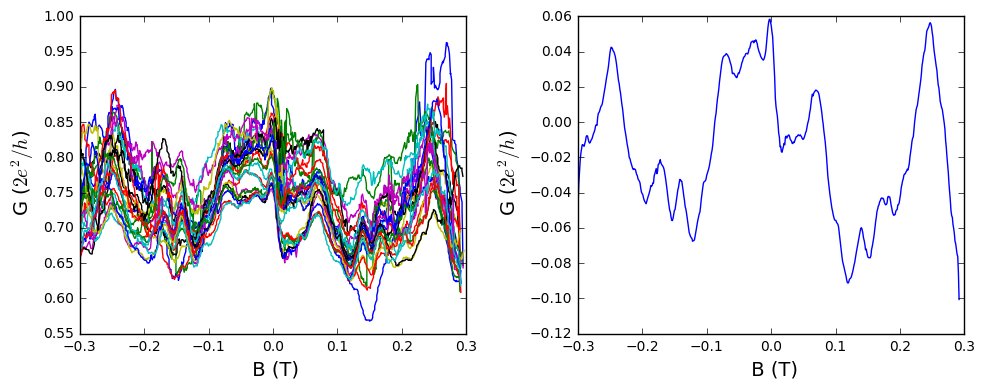

In [465]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\data_weak.dat'

conversion_x = 1
conversion_y = 0.005
conversion_z = 12906

label_x = ' B (T)'
label_y = ' $ V_{BG} = $'
label_z = ' G ($ 2e^2/h $)'

y_values = [2.85e+2, 2.748214285714e+02, 2.697321428571e+02,  2.595535714286e+02 , 2.493750000000e+02, 2.391964285714e+02, 2.341071428571e+02, 
            2.188392857143e+02,  2.086607142857e+02, 1.984821428571e+02, 1.883035714286e+02, 
           1.730357142857e+02, 1.628571428571e+02,1.475892857143e+02, 1.374107142857e+02, 1.272321428571e+02,
           1.221428571429e+02, 1.119642857143e+02, 1.017857142857e+02, 9.160714285714e+01, 8.142857142857e+01,
           7.633928571429e+01, 2.035714285714e+01, 1.017857142857e+01, 0]

plot_name = 'weak'

WAL_plot(inputFile, conversion_x, conversion_y, conversion_z, label_x, label_y, label_z, y_values, plot_name)



# LOOP 1 - Fully top-gated

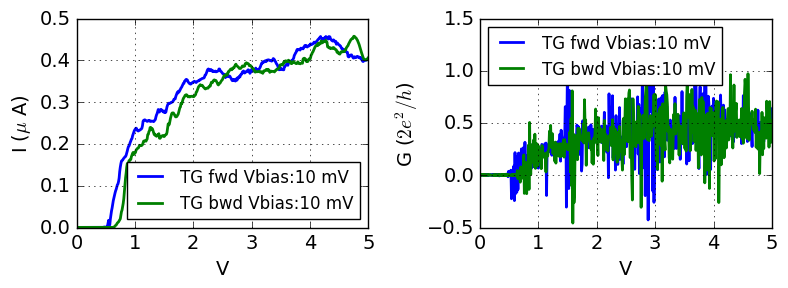

In [314]:
#Top gate dependence

inputFileTGf ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_TG_sweep_5.dat'
inputFileTGb ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_TG_sweep_6.dat'

inputFilesTG = [inputFileTGf, inputFileTGb]
gates = ('TG fwd', 'TG bwd')
conversions = (0.005, 0.005)
Vs = ( '10 mV', '10 mV')

gate_dependance(inputFilesTG, gates, conversions, Vs, plot_name)

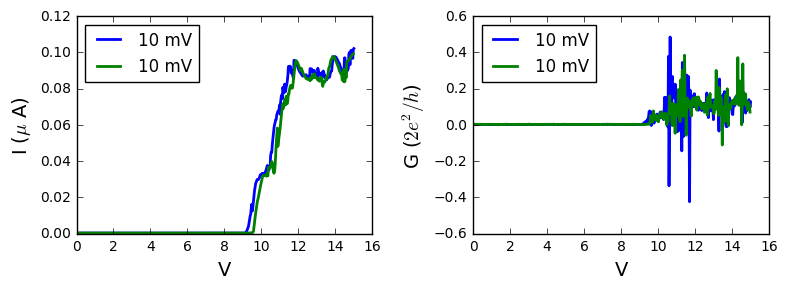

In [1053]:
# Bottom gate dependence

inputFileBGf ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_TG_sweep_9.dat'
inputFileBGb ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_TG_sweep_10.dat'

inputFilesBG = [inputFileBGf, inputFileBGb]
gates = ('BG fwd', 'BG bwd')
conversions = (0.015, 0.015)
labels = ( '10 mV', '10 mV')

gate_dependance(inputFilesBG, gates, conversions, labels, plot_name)


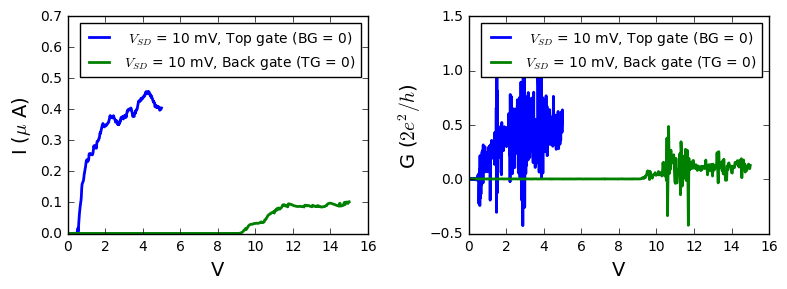

In [1075]:
# Bottom and Top gate dependance together
inputFilesG = [inputFileTGf, inputFileBGf]
gates = ('TG', 'BG')
conversions = (0.005, 0.015)
labels = ( ' $ V_{SD} $ = 10 mV, Top gate (BG = 0)', '$ V_{SD} $ = 10 mV, Back gate (TG = 0)')
plot_name = 'Top_and_bottom_gates'

gate_dependance(inputFilesG, gates, conversions, labels, plot_name)


In [ ]:
inputFileT2_vs_T1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_TG_vs_BG_sweep_1.dat'
label_x = 'T2 (V)'
conversion_x = 0.005
label_y = 'T1 (V)'
conversion_y = 0.025
label_z = 'G ( $ 2e^2/h $)'
conversion_z = 1
column = 4
plot_name = 'T1_vs_T2'
#points_list =[(0,0)]

T2 = 25

m = 0.51
q = -459.1
T1 = m*T2 + q

print 'T2 =', T2, ', T1 =', T1

points_list =[(75, -420), (-37, -478), (T2, T1 )]

# m = Deltax/Delta y 0.51

colorplot_data(inputFileT2_vs_T1, label_x, conversion_x, label_y, conversion_y,  conversion_z, column, plot_name, points_list)

# Loop1 - Examples of oscillations

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 157.367994513 1.23338284232
Amplitude: 10.8995237577 0.3152887775
B parameter: 0.424732625898 0.0346546763473
FIT PARAMETERS FOR AAS:
f: 282.44903876 14.2395072217
Amplitude: 1.70973798826 0.290380578008
B parameter: 0.169880359552 0.0972099854564
offset: 0.0519427494545 0.00619155005794


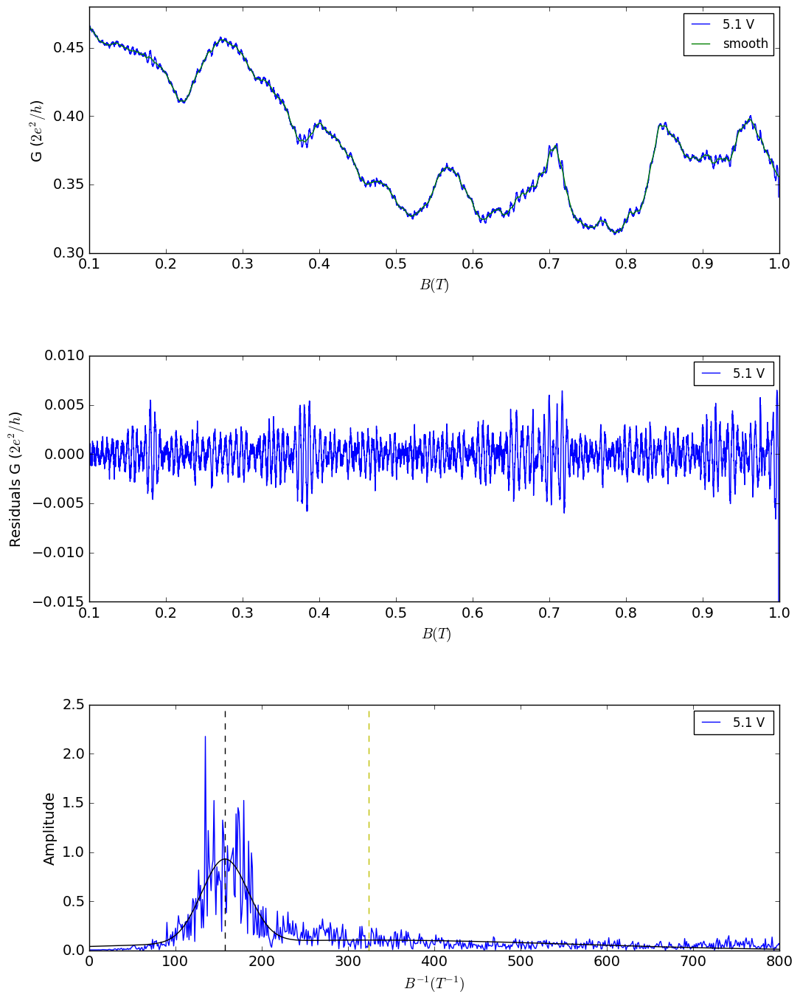

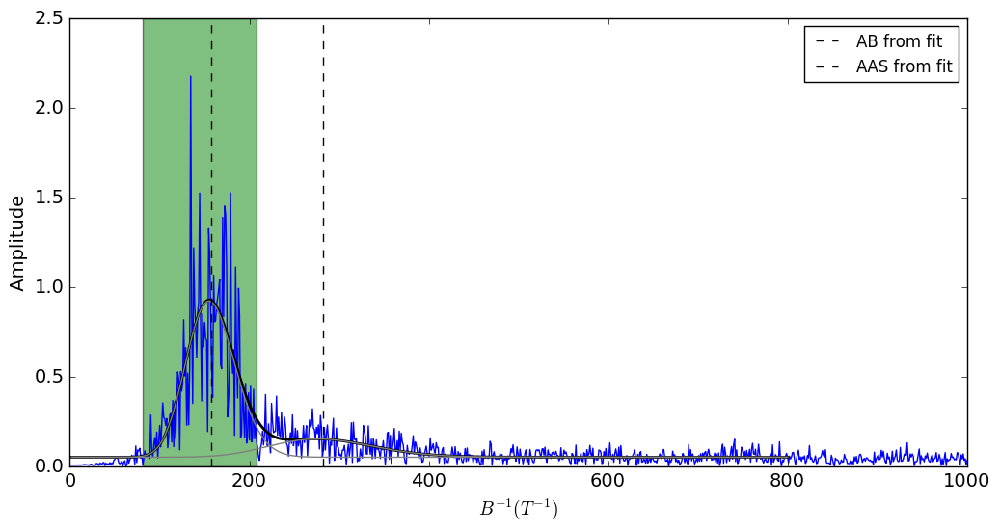

In [1621]:
inputFile_oscillations_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_1Tto0T_1.dat'

inputFiles = [inputFile_oscillations_1 ]
labels =  ['5.1 V ']
windows = [83]
#105
orders = [2]
plot_name = 'AB_long_range'
B_min = 0.1
B_max = 1.
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620



magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 151.924431252 1.09919444163
Amplitude: 9.74143635275 0.475141523661
B parameter: 0.786818158298 0.0898528854217
offset: 0.0360555819773


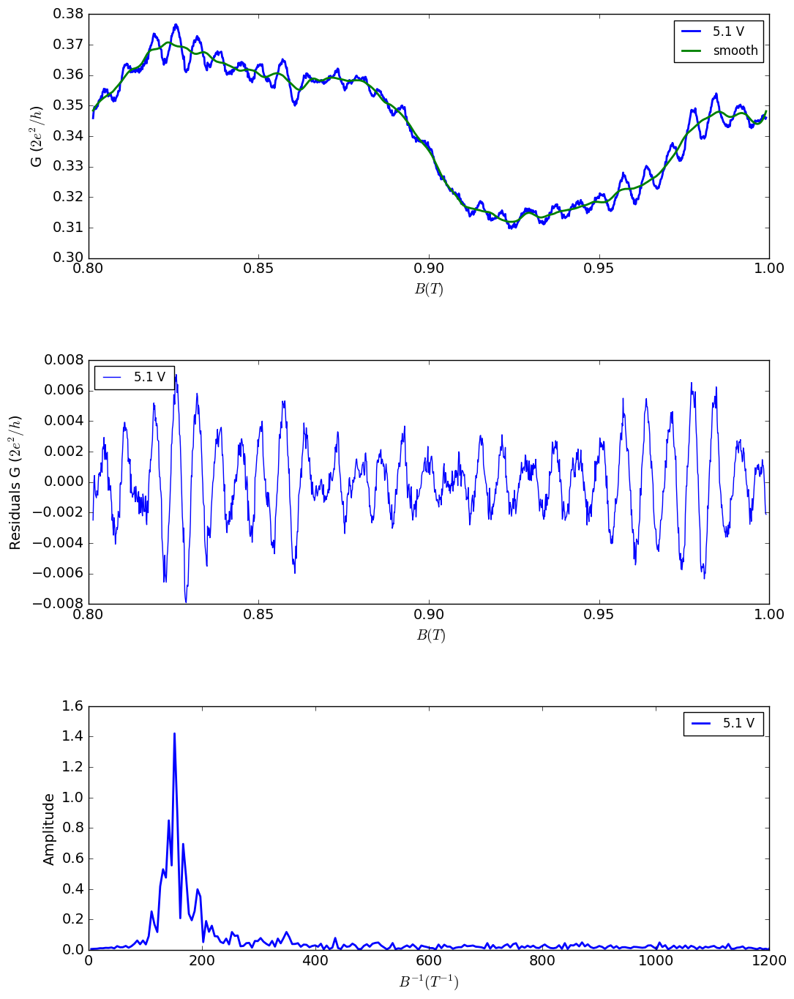

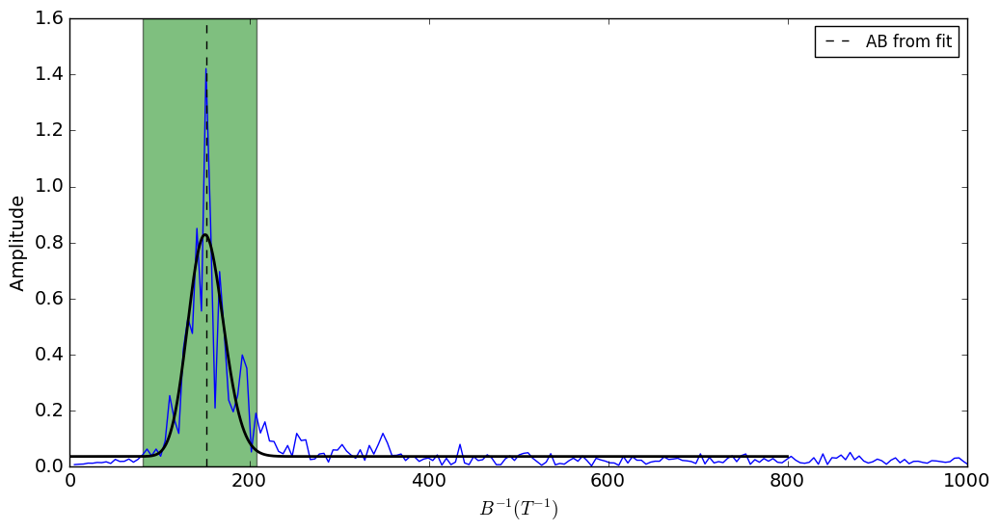

In [1623]:
inputFile_oscillations_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_4.dat'
inputFiles = [inputFile_oscillations_2 ]
labels =  ['5.1 V ']
windows = [83]
#121 is nice
orders = [3]
plot_name = 'AB_short_range'
magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True);
B_min = 0.8
B_max = 1.0
#magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max,plot=True);
T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620
magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Loop 1 - Files for TG scan

In [1624]:
inputFileTG1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_B_vs_TG_6.dat'
inputFileTG2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_2.dat'
inputFileTG3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_3.dat'
inputFileTG4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_4.dat'
inputFileTG5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_5.dat'
inputFileTG6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_6.dat'
inputFileTG7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_7.dat'

#  Loop1 - Top gate 5.1 V

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 157.367994513 1.23338284232
Amplitude: 10.8995237577 0.3152887775
B parameter: 0.424732625898 0.0346546763473
FIT PARAMETERS FOR AAS:
f: 282.44903876 14.2395072217
Amplitude: 1.70973798826 0.290380578008
B parameter: 0.169880359552 0.0972099854564
offset: 0.0519427494545 0.00619155005794


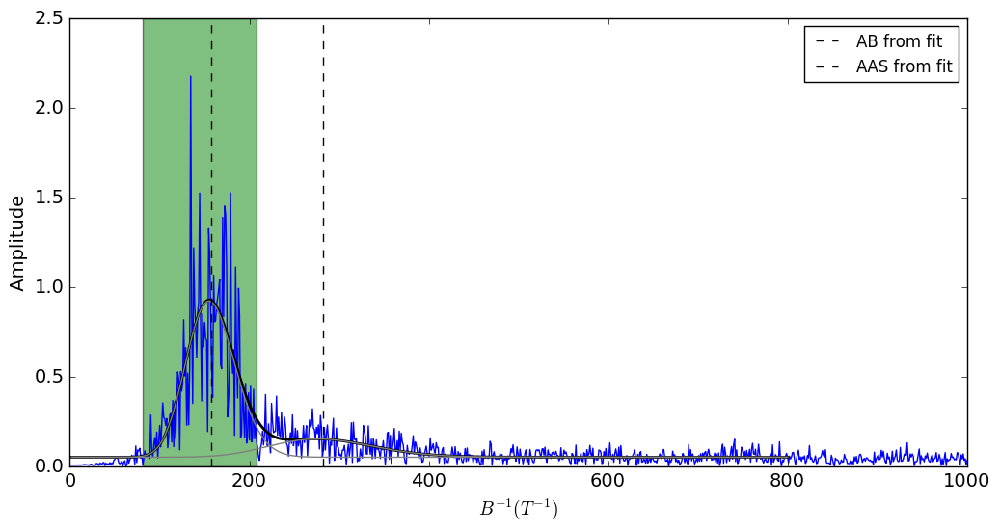

In [1628]:
inputFile_oscillations_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_1Tto0T_1.dat'
inputFiles = [inputFile_oscillations_1]
labels =  ['5.1 V ']
windows = [83]

orders = [2]
plot_name = 'oscillations_TG_5.1V'

#magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True);
B_min = 0.1
B_max = 1

T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620
magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Loop1 - Top Gate  4 V


f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 162.968161792 2.88145850358
Amplitude: 3.73955797646 0.325929920201
B parameter: 0.708647893148 0.178307436219
FIT PARAMETERS FOR AAS:
f: 258.898793486 6.17315399697
Amplitude: 2.84052446642 0.304933666344
B parameter: 0.310243120975 0.107081035694
offset: 0.074700117437 0.00531506914392


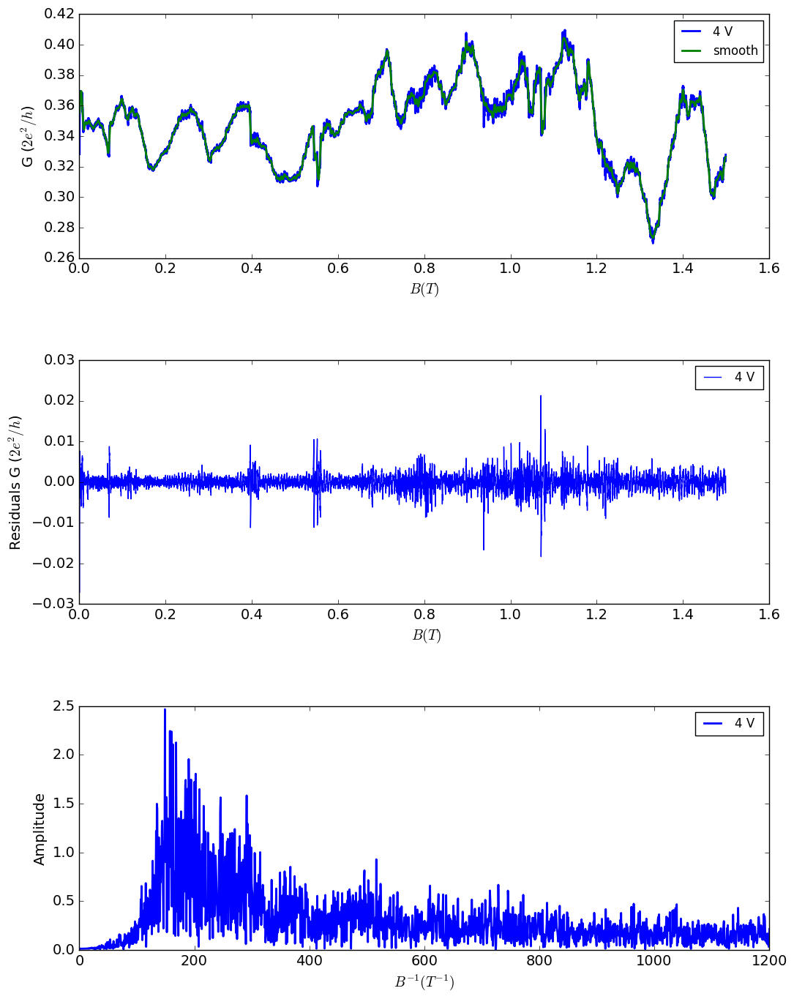

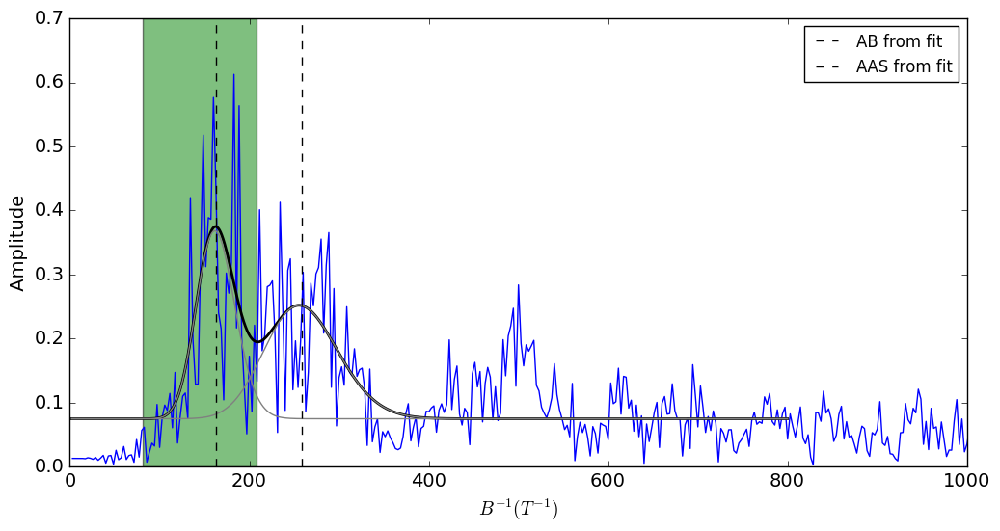

In [1636]:
inputFiles = [inputFileTG2]
labels =  ['4 V ']
windows = [83]
orders = [2]
plot_name = 'oscillations_TG_4V'
B_min = 0.180
B_max = 0.530
magnetoconductance(inputFiles, windows, orders, labels, plot_name);




T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620
magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);



# Loop1 - Top Gate  3.0 V

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 148.800220101 1.60561668305
Amplitude: 4.42712382705 0.322425025459
B parameter: 0.972918423873 0.175919495071
FIT PARAMETERS FOR AAS:
f: 241.26341754 20.4857825942
Amplitude: 0.778415428355 0.225398260728
B parameter: 0.202857749552 0.199594500133
offset: 0.0277748606058 0.00446256666233


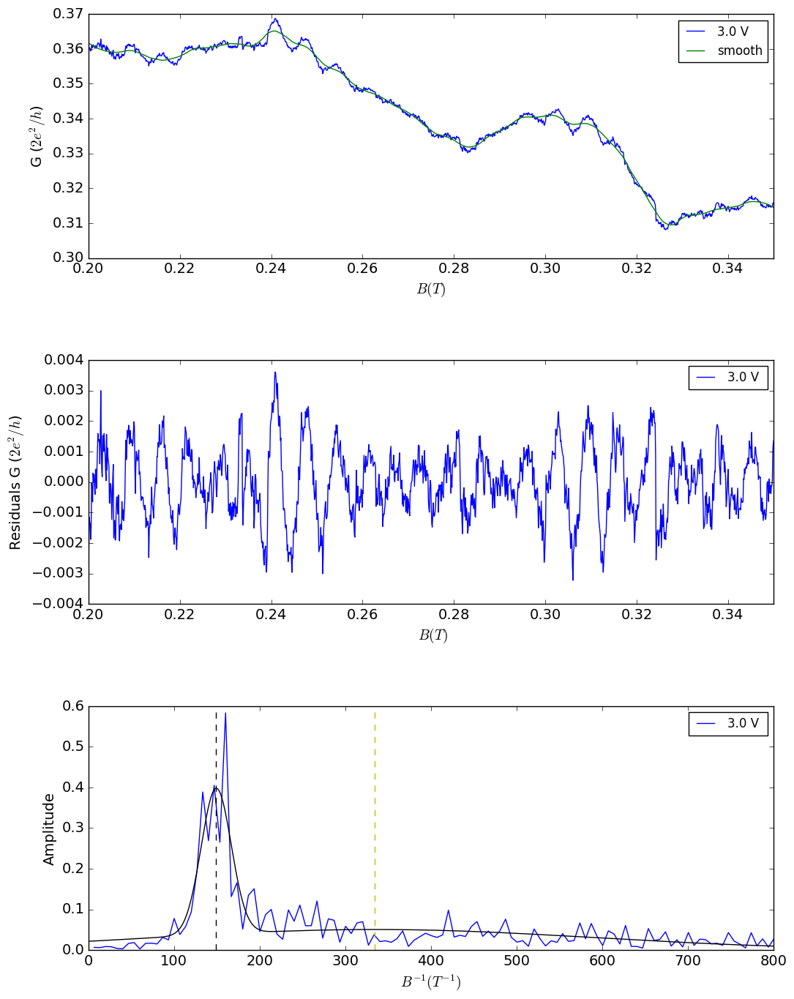

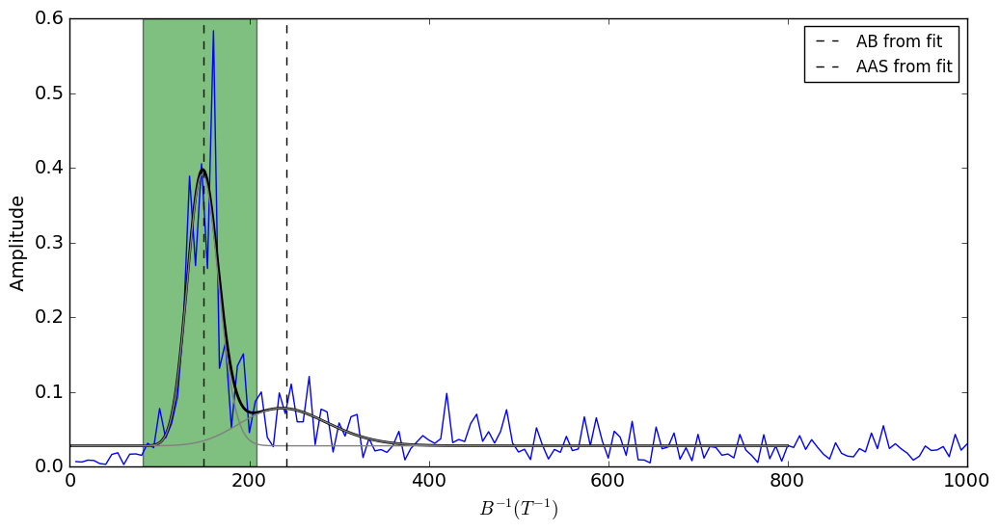

In [1643]:
inputFiles = [inputFileTG4]
labels =  ['3.0 V ']
windows = [101]
orders = [2]
plot_name = 'oscillations_TG_3V'

B_min = 0.2
B_max = 0.35
magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max);


T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620
magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Loop1 - Top Gate  2 V

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 190.177500865 6.34302321377
Amplitude: 3.49044504279 0.457630096149
B parameter: 0.158313178595 0.0462542215694
FIT PARAMETERS FOR AAS:
f: 491.590491364 522.893732427
Amplitude: 2.40089043261 9.01864052408
B parameter: 0.00858784424393 0.0336959794004
offset: -0.00588821659588 0.404527162284


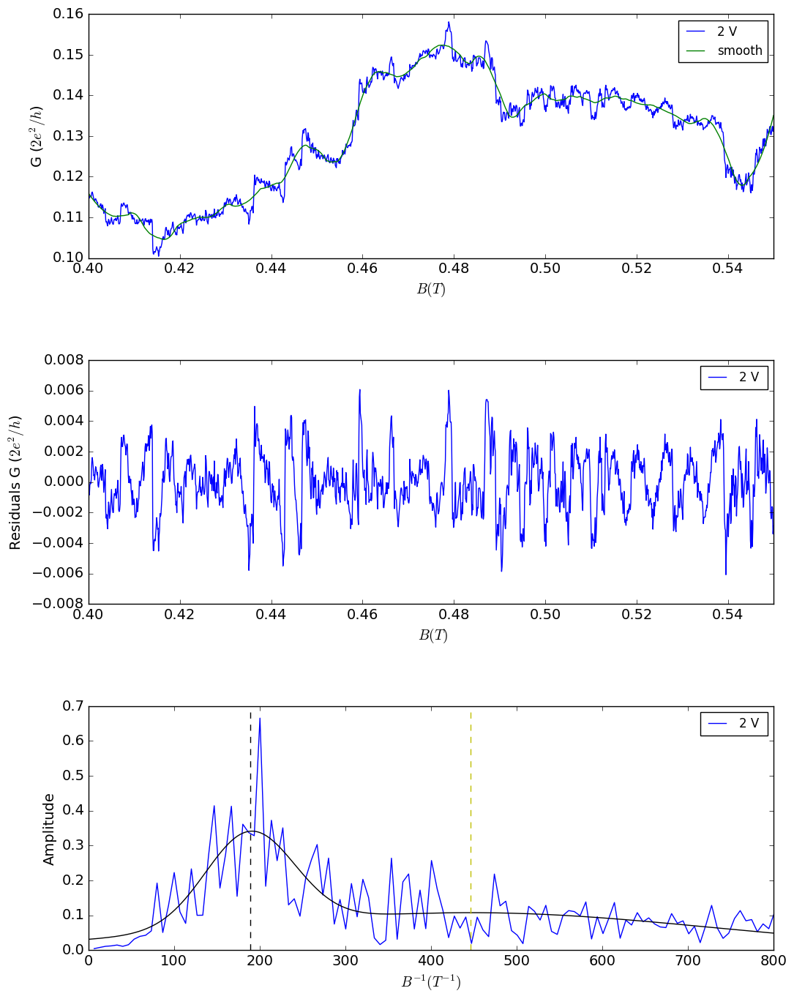

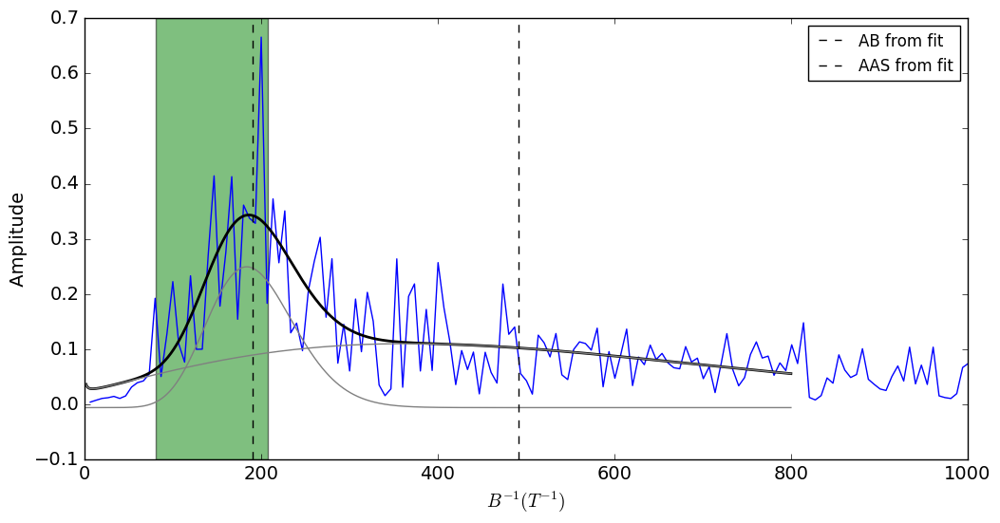

In [1645]:
inputFiles = [inputFileTG6]
labels =  ['2 V ']
windows = [101]
orders = [2]
plot_name = 'oscillations_TG_2V'



B_min = 0.4
B_max = 0.55
magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max);


T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620
magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Loop1 - Top Gate 1.5 V

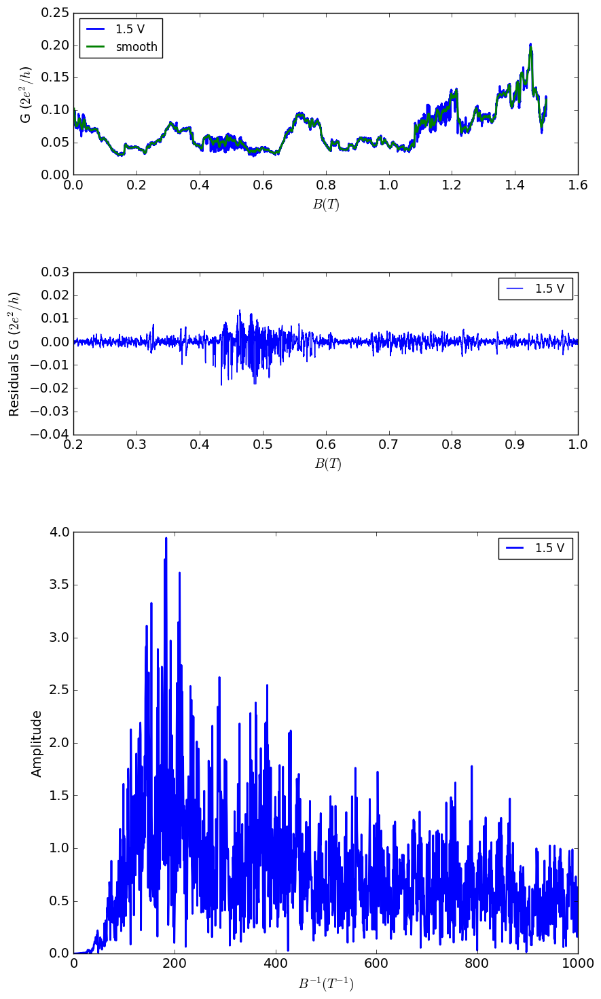

In [1158]:
inputFiles = [inputFileTG7]
labels =  ['1.5 V ']
windows = [105]
orders = [3]
plot_name = 'oscillations_TG_1.5V'
magnetoconductance(inputFiles, windows, orders, labels, plot_name);

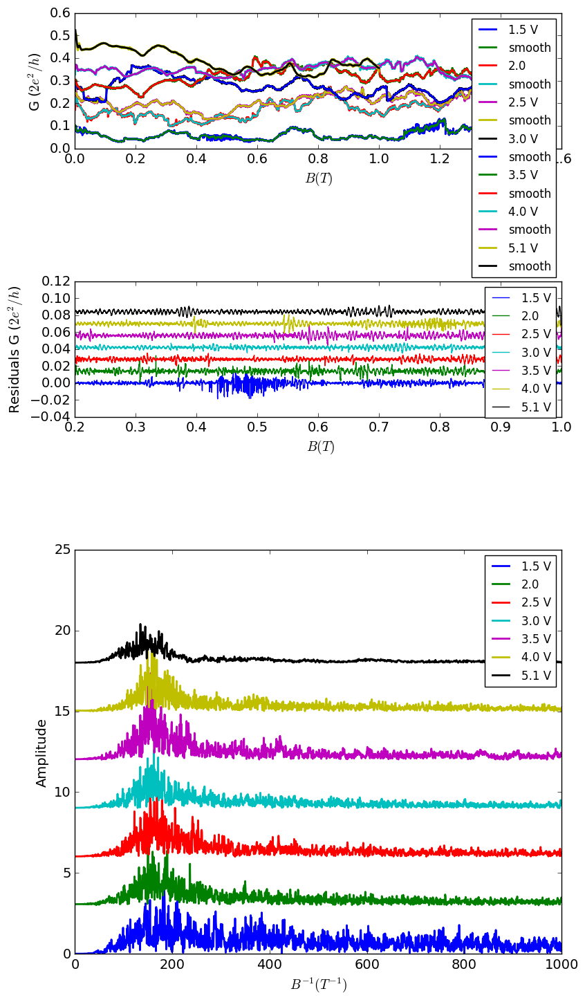

In [1169]:
inputFiles = [inputFileTG7, inputFileTG6,  inputFileTG5,  inputFileTG4,   inputFileTG3, inputFileTG2,  inputFile_oscillations_1]
labels = ( '1.5 V', '2.0', '2.5 V', '3.0 V', '3.5 V', '4.0 V', '5.1 V' )
windows = (105, 105, 105, 105, 105, 105, 105)
orders = (3, 3, 3, 3, 3, 3, 3 )
plot_name = 'FFT_different_TG'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True);




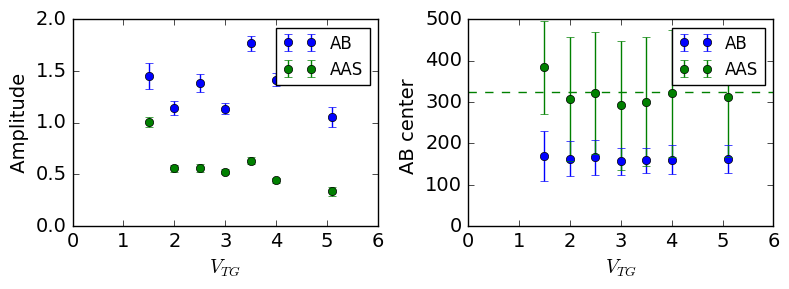

In [923]:
inputFiles = [inputFileTG7, inputFileTG6,  inputFileTG5,  inputFileTG4,   inputFileTG3, inputFileTG2,  inputFileTG1]
labels = ( '1.5 V', '2.0', '2.5 V', '3.0 V', '3.5 V', '4.0 V', '5.1 V' )
windows = (105, 105, 105, 105, 105, 105, 105)
orders = (3, 3, 3, 3, 3, 3, 3 )

parameters = magnetoconductance(inputFiles, windows, orders, labels, plot = False)


A1s = parameters[2]
mean1s = parameters[3]
sigma1s = parameters[4]
A2s = parameters[5]
mean2s = parameters[6]
sigma2s = parameters[7]
A1errs = parameters[8]
A2errs = parameters[9]

TGs = np.array([1.5, 2.0, 2.5, 3.0, 3.5, 4.0, 5.1])

fig = plt.figure(figsize=(8,3))
ax1 = plt.subplot2grid((1,2), (0,0), colspan=1)
ax2 = plt.subplot2grid((1,2), (0,1), colspan=1)
        
    
ax1.set_xlabel( '$ V_{TG} $', fontsize=axes_font)
ax1.set_ylabel(' Amplitude ', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_ylim(0,2)
ax1.set_xlim(0, 6)
        
                
ax2.set_xlabel( '$ V_{TG} $', fontsize=axes_font)
ax2.set_ylabel('AB center ', fontsize=axes_font)
ax2.tick_params(axis='both', which='major', labelsize=tick_font)
ax2.get_xaxis().get_major_formatter().set_useOffset(False)
ax2.set_ylim(0,500)
ax2.set_xlim(0, 6)

ax1.errorbar(TGs, A1s, yerr=A1errs, fmt ='o', label = 'AB')
ax1.errorbar(TGs, A2s, yerr=A2errs, fmt ='o', label = 'AAS')
ax2.errorbar(TGs, mean1s, yerr = sigma1s,  fmt= 'o', label = 'AB')
ax2.errorbar(TGs, mean2s, yerr = sigma2s,  fmt= 'o', label = 'AAS')
ax2.axhline(np.mean(np.array(mean1s))*2, linestyle = '--', color ='green')

ax1.legend(loc=0)
ax2.legend(loc=0)
fig.subplots_adjust(hspace=sub_hspace)    
fig.subplots_adjust(wspace=sub_wspace)    
fig.tight_layout() 
  

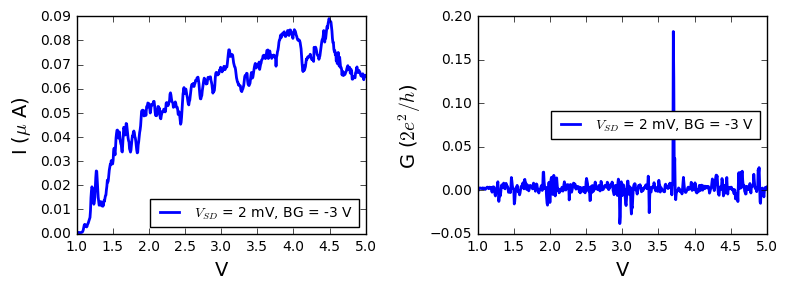

In [1066]:
#Top gate dependence referred to the previous scans in field.

inputFileTG9 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_Bz_9.dat'


inputFilesTG9 = [inputFileTG9]
gates = ['TG']
conversions = [0.005]
labels = ['$ V_{SD} $ = 2 mV, BG = -3 V']
plot_name = 'Topgate_sweep_negative_BG'
gate_dependance(inputFilesTG9, gates, conversions, labels, plot_name)





# AAS for loop1 7491

At 79mk, in the file loop1_sweep_base_1.dat there is a clear signature of second armonic AAS with  periodicity 3 mT, the main frequency is clearly 7 mT. //
At 152 mk, in the file loop1_sweep_150mK_4.dat there is another signature of AAS.
In the file loop1_sweep_base_1Tto0T_1.dat the FFT shows kind of a peak (at 79 mK)

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 157.482679628 1.77813726966
Amplitude: 9.55284923806 0.361114469608
B parameter: 0.364108698945 0.0378232595162
FIT PARAMETERS FOR AAS:
f: 286.319849781 19.0254090794
Amplitude: 1.64762112195 0.311715420239
B parameter: 0.147722759016 0.102011977866
offset: 0.0481326931307 0.007028030852


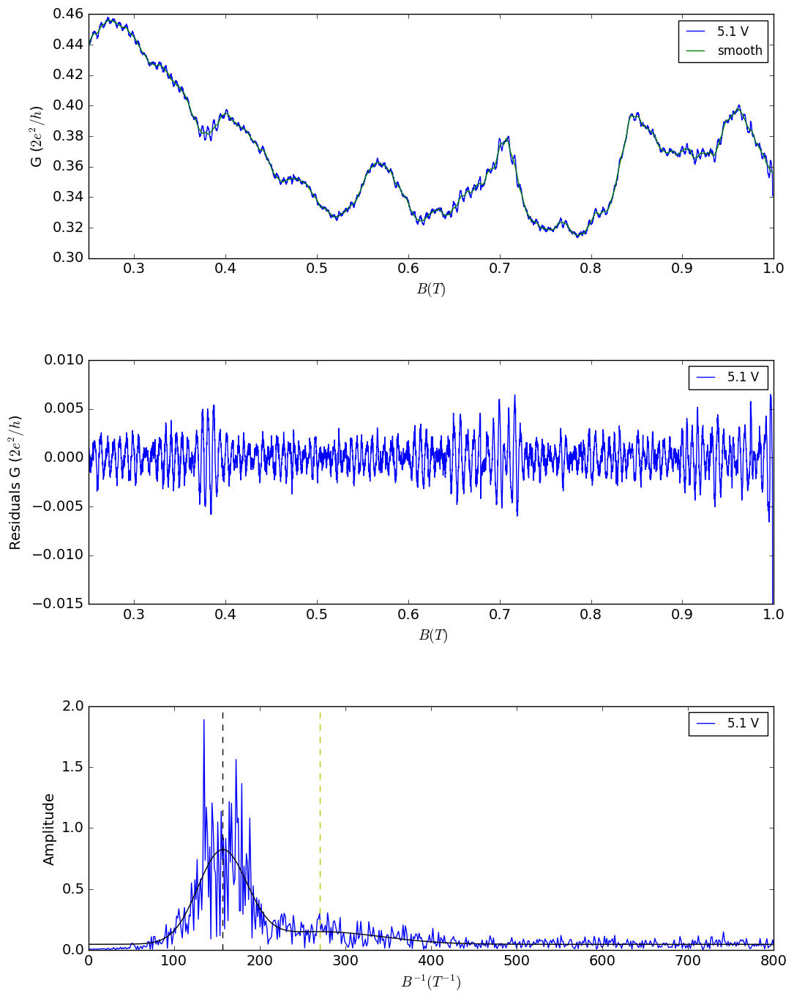

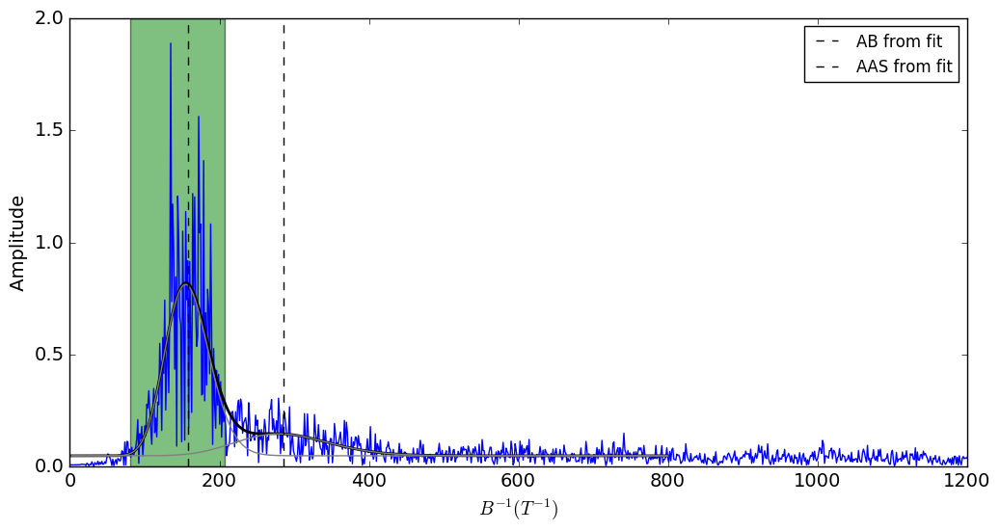

In [2083]:
inputFile79mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_1Tto0T_1.dat'
inputFiles79mk = [inputFile79mk_1]

orders = [2]
plot_name = 'AAS effect loop1 7491'
labels =  ['5.1 V ']
windows = [83]

B_min = 0.25
B_max = 1.
T = '80 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620

magnetoconductance_range(inputFiles79mk, windows, orders, labels, plot_name, B_min, B_max);
average79mk_AAS_1 = magnetconductance_average_special(inputFiles79mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 140.993563524 1.49098470064
Amplitude: 3.54642656497 0.438578730371
B parameter: 2.95234813191 0.823210761386
FIT PARAMETERS FOR AAS:
f: 197.021941349 10.1515858922
Amplitude: 1.88838289277 0.215578030705
B parameter: 0.0757944823537 0.0193794736929
offset: 0.0257456327954 0.00596873421964


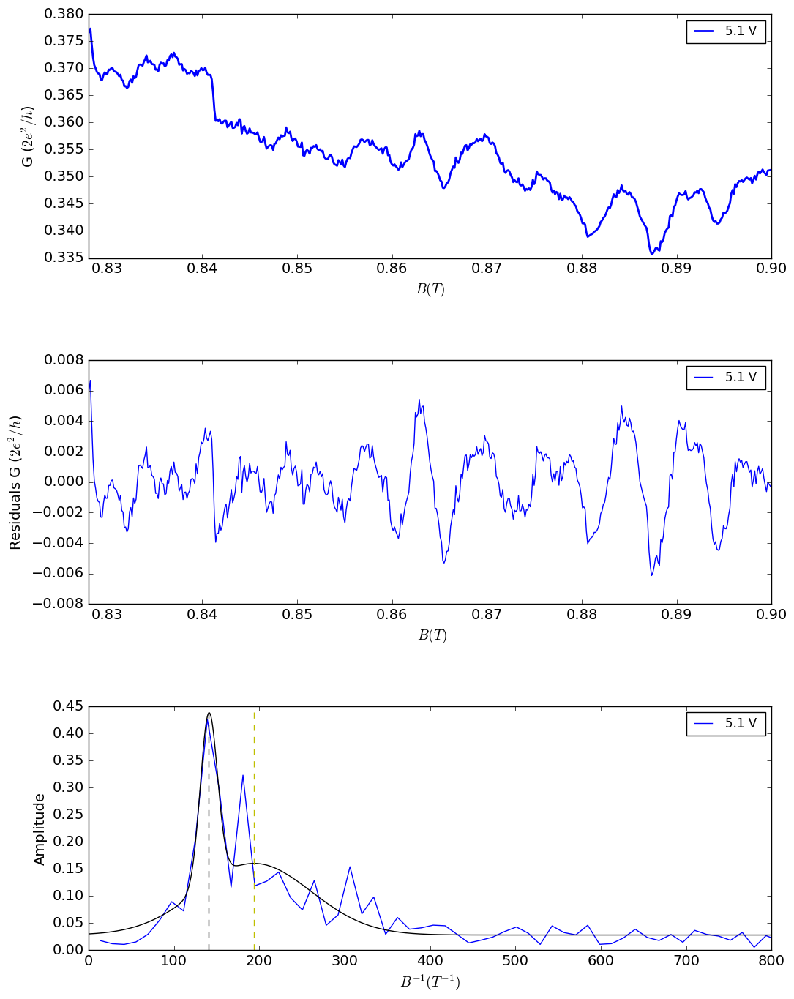

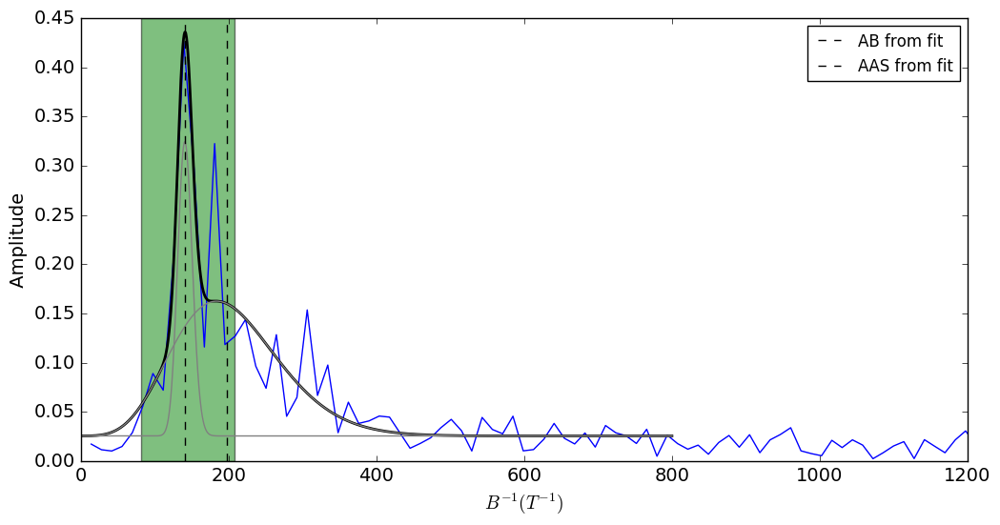

In [2088]:
#clear double oscillations at 0.835 T
inputFile79mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_1.dat'
inputFiles79mk = [inputFile79mk_2]
label = ['1']
window = 109
window = [window]
order = 2
orders = [2]
plot_name = 'AAS example loop1 7491'
A_min = 0.336
A_max = 0.858
A_center = 0.620
B_min = 0.828
B_max = 0.9

magnetoconductance_range(inputFiles79mk, windows, orders, labels, plot_name, B_min, B_max);
plot_name = 'AAS effect loop1 7491'
average79mk_AAS = magnetconductance_average_special(inputFiles79mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

([array([    5.0365401 ,    10.0730802 ,    15.1096203 ,    20.14616039,
            25.18270049,    30.21924059,    35.25578069,    40.29232079,
            45.32886089,    50.36540098,    55.40194108,    60.43848118,
            65.47502128,    70.51156138,    75.54810148,    80.58464157,
            85.62118167,    90.65772177,    95.69426187,   100.73080197,
           105.76734207,   110.80388217,   115.84042226,   120.87696236,
           125.91350246,   130.95004256,   135.98658266,   141.02312276,
           146.05966285,   151.09620295,   156.13274305,   161.16928315,
           166.20582325,   171.24236335,   176.27890344,   181.31544354,
           186.35198364,   191.38852374,   196.42506384,   201.46160394,
           206.49814403,   211.53468413,   216.57122423,   221.60776433,
           226.64430443,   231.68084453,   236.71738463,   241.75392472,
           246.79046482,   251.82700492,   256.86354502,   261.90008512,
           266.93662522,   271.97316531,   277.0097

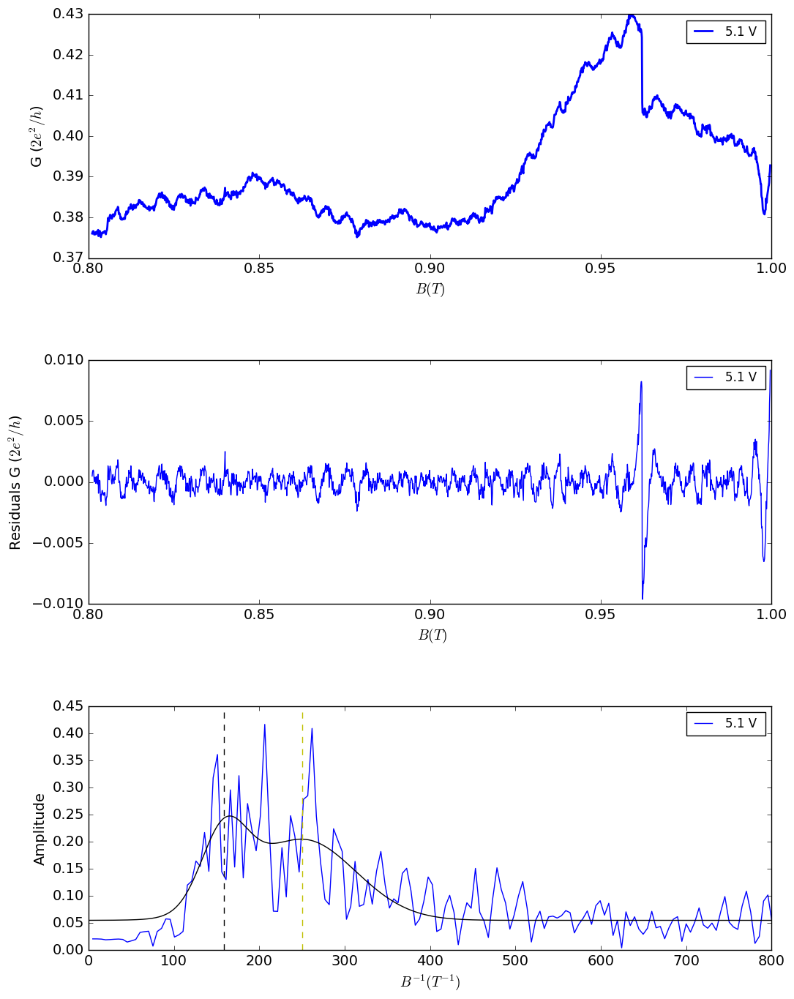

In [2092]:
inputFile152mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_4.dat'
inputFiles152mk = [inputFile152mk_4]
label = ['1']
window = 107
window = [window]
order = 2
orders = [2]
plot_name = 'AAS effect loop1 7491 150 mK'
A_min = 0.336
A_max = 0.858
A_center = 0.620
#B_min = 0.828
#B_max = 0.9
B_min = 0.8
B_max  = 1.0

magnetoconductance_range(inputFiles152mk, windows, orders, labels, plot_name, B_min, B_max);
#average79mk_AAS = magnetconductance_average_special(inputFiles79mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Loop 1 7491 - Temperature dependence

# T = 79 mk

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 151.773135398 0.837124109007
Amplitude: 8.41395005165 0.338859469877
B parameter: 0.768679538684 0.077278447798
FIT PARAMETERS FOR AAS:
f: 215.470301812 13.7378769131
Amplitude: 1.85786297565 0.22778166587
B parameter: 0.0413857852084 0.0100718869069
offset: 0.0405364451596 0.00687133870208


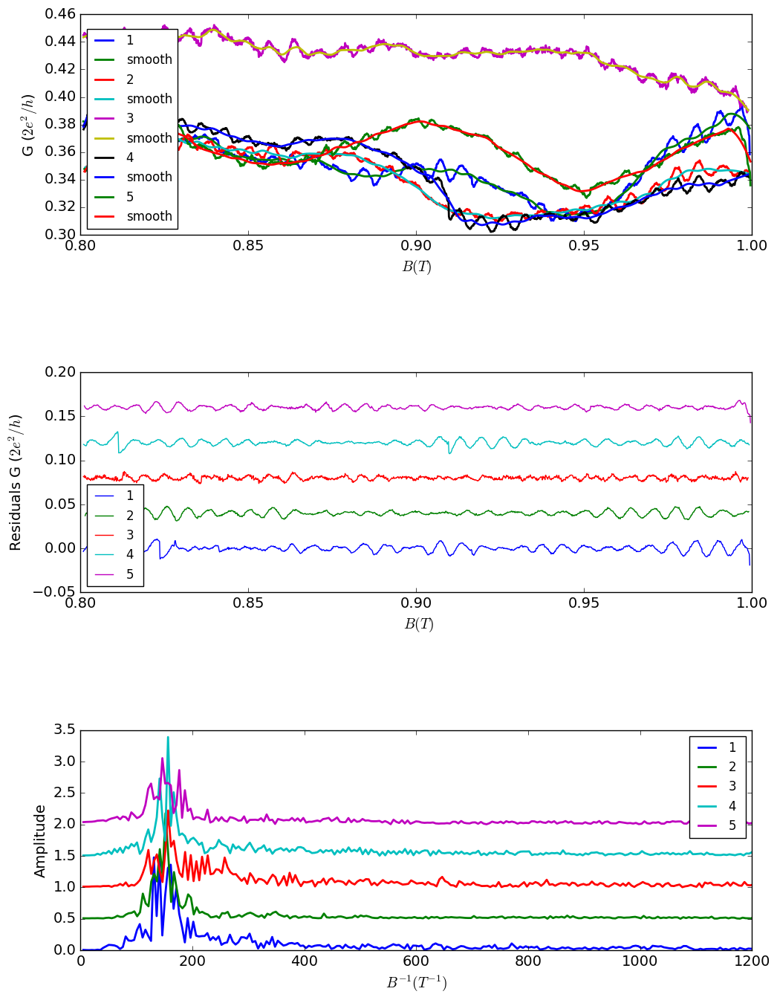

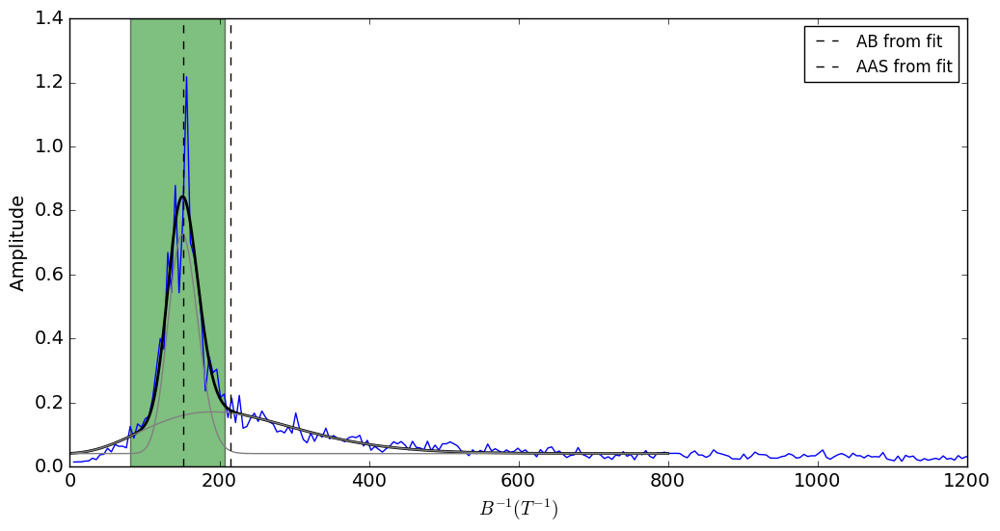

In [2077]:
inputFile79mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_B_vs_TG_tau100_1.dat'
inputFile79mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_1.dat'
inputFile79mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_2.dat'
inputFile79mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_3.dat'
inputFile79mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_base_4.dat'



inputFiles79mk = [inputFile79mk_2,  inputFile79mk_5, inputFile79mk_1, inputFile79mk_3, inputFile79mk_4]

T=0.079
labels =  ['1 ', '2 ','3 ', '4 ', '5 ' ]
#107
window = 97
windows = [window, window, window, window, window]
orders = [2, 2, 2, 2, 2]
plot_name = 'average_79mk'
magnetoconductance(inputFiles79mk, windows, orders, labels, plot_name);
#average79mk = magnetconductance_average(inputFiles79mk, windows, orders, labels, T);


A_min = 0.336
A_max = 0.858
A_center = 0.620
B_min = 0.8
B_max = 1.0
#average79mk_7491_1 = magnetconductance_average(inputFiles79mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);


average_79mk_loop2_7491 = magnetconductance_average_special(inputFiles79mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max)



# T = 152 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 158.906525608 1.52327590374
Amplitude: 3.6410781177 0.146052741458
B parameter: 0.287339556445 0.0272263579603
offset: 0.0571481049592


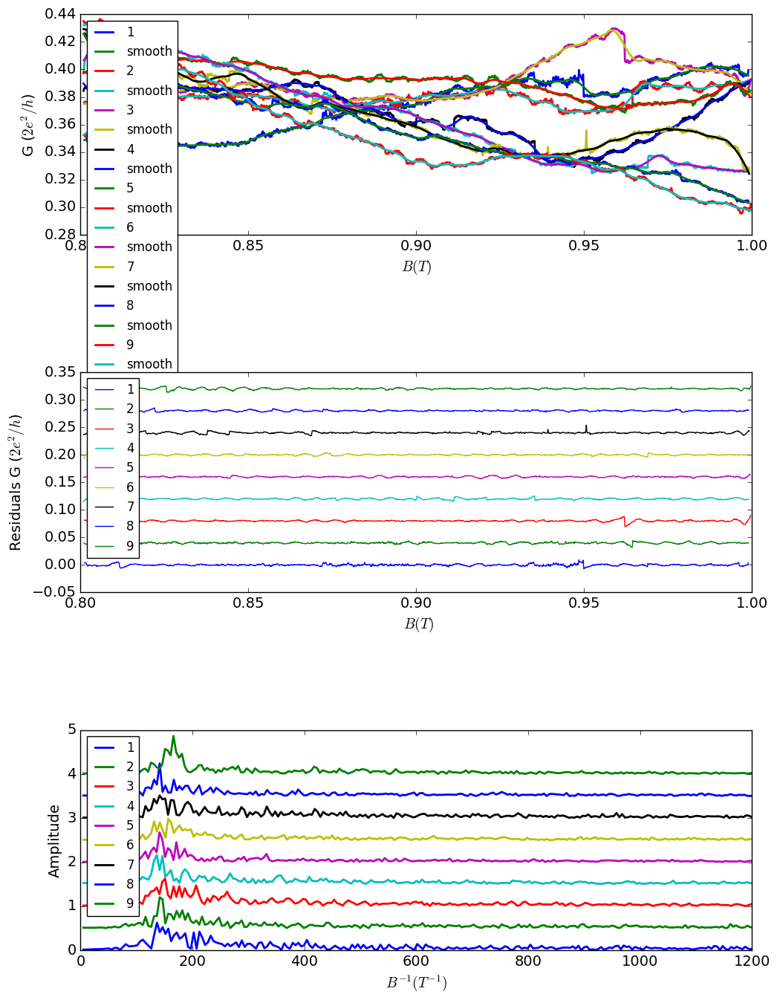

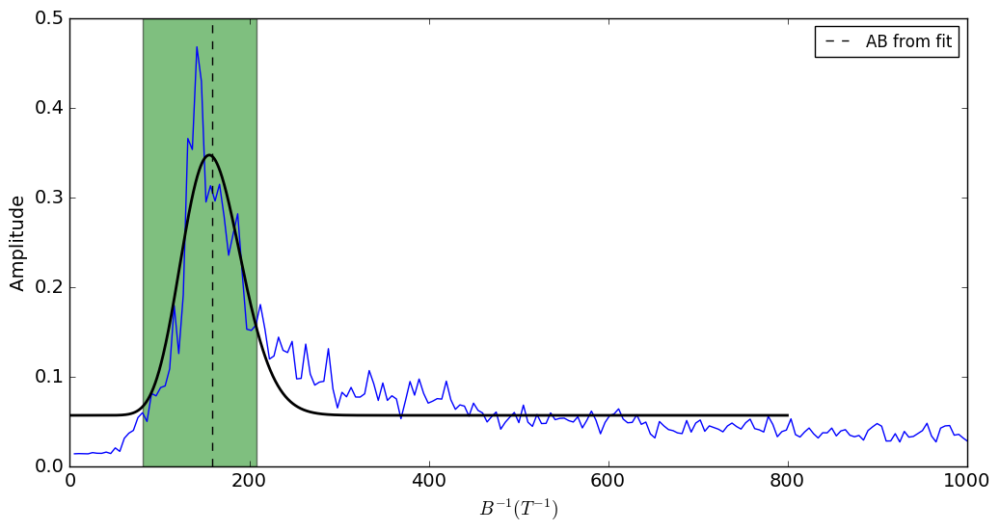

In [2079]:
inputFile152mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_1.dat'
inputFile152mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_2.dat'
inputFile152mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_3.dat'
inputFile152mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_4.dat'
inputFile152mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_5.dat'
inputFile152mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_6.dat'
inputFile152mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_7.dat'
inputFile152mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_8.dat'
inputFile152mk_9 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_9.dat'
inputFile152mk_10 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_150mK_10.dat'


inputFiles152mk = [ inputFile152mk_2, inputFile152mk_3, inputFile152mk_4, inputFile152mk_5,
                  inputFile152mk_6, inputFile152mk_7, inputFile152mk_8, inputFile152mk_9, inputFile152mk_10]
T = 0.152
labels =  ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']
windows = [107, 107, 107, 107,107,107,107,107, 95, 91]
orders = [2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'average152mk'
#parameters = magnetoconductance(inputFiles152mk, windows, orders, labels, plot_name, plot = True)


B_min = 0.8
B_max = 1.


magnetoconductance(inputFiles152mk, windows, orders, labels, plot_name);

A_min = 0.336
A_max = 0.858
A_center = 0.620
#average152mk = magnetconductance_average(inputFiles152mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

average152mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles152mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


# T = 190 mk
    
    


f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 157.65845325 2.03112033551
Amplitude: 2.36516234571 0.16141909365
B parameter: 0.466200112255 0.0748182222073
offset: 0.0591803081977


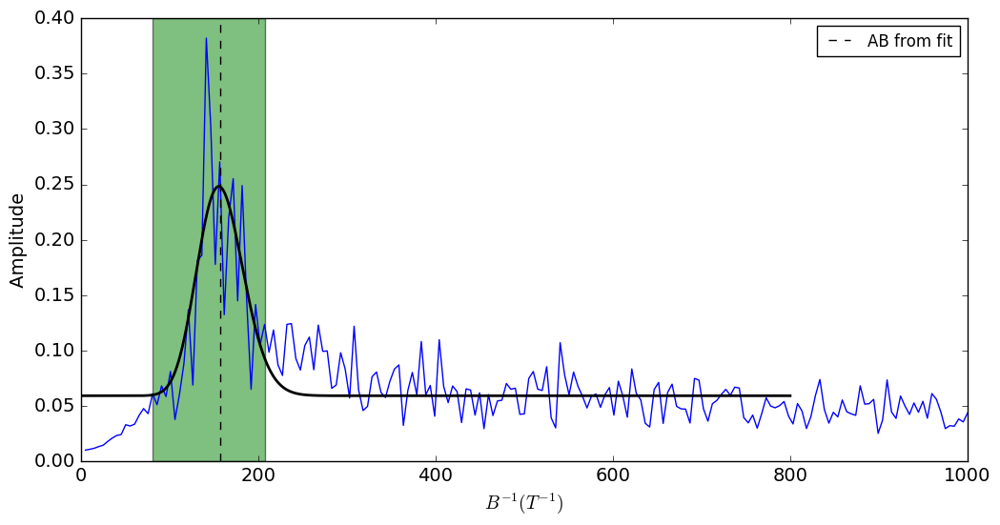

In [1688]:
inputFile190mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_190mK_1.dat'
inputFile190mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_190mK_2.dat'
inputFile190mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_190mK_3.dat'



inputFiles190mk = [inputFile190mk_1, inputFile190mk_2,inputFile190mk_3]
T=0.19
labels =  [ '1', '2', '3']
windows = [107, 107, 107]
orders = [ 2,2 ,2]
#parameters = magnetoconductance(inputFiles190mk, windows, orders, labels, plot = True)
#average190mk = magnetconductance_average(inputFiles190mk, windows, orders, labels, T);


A_min = 0.336
A_max = 0.858
A_center = 0.620
#average190mk = magnetconductance_average(inputFiles190mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

B_min = 0.8
B_max = 1.
average190mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles190mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);




# T = 260 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 149.347539701 1.53129106672
Amplitude: 2.49984775564 0.11933203484
B parameter: 0.379858409912 0.0426718554224
offset: 0.071629718466


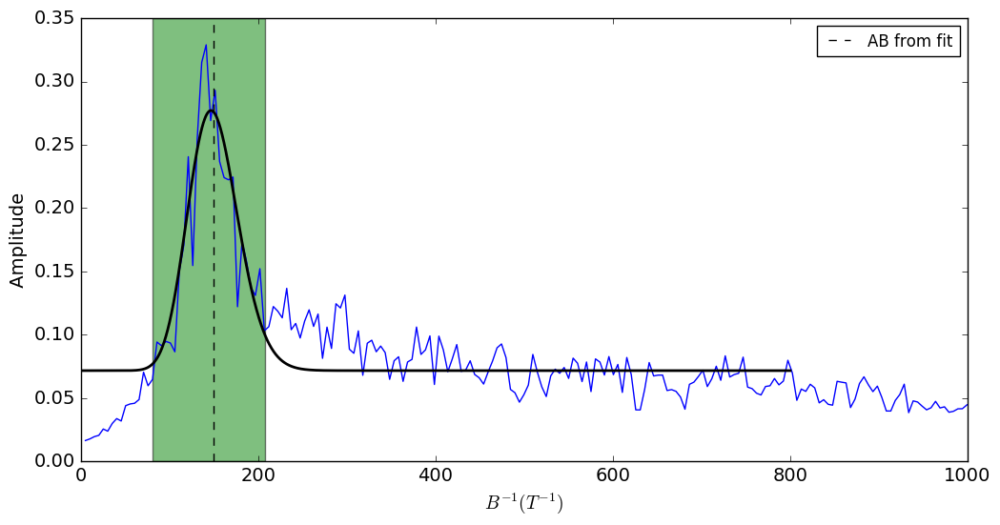

In [1689]:
inputFile260mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_1.dat'
inputFile260mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_2.dat'
inputFile260mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_3.dat'
inputFile260mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_4.dat'
inputFile260mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_5.dat'
inputFile260mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_6.dat'
inputFile260mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_7.dat'
inputFile260mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_8.dat'
inputFile260mk_9 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_9.dat'
inputFile260mk_10 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_10.dat'
inputFile260mk_11 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_11.dat'
inputFile260mk_12 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_260mk_12.dat'

T = 0.260
inputFiles260mk = [inputFile260mk_1, inputFile260mk_2, inputFile260mk_3, inputFile260mk_4, inputFile260mk_5,
                  inputFile260mk_6, inputFile260mk_7, inputFile260mk_8, inputFile260mk_9, inputFile260mk_10,
                  inputFile260mk_11, inputFile260mk_12]

labels =  ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12']
windows = [107, 107, 107, 107,107,107,107,107, 107, 107, 107, 107]
orders = [2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_260mk'



#parameters = magnetoconductance(inputFiles260mk, windows, orders, labels, plot_name, plot = True)
#average260mk =magnetconductance_average(inputFiles260mk, windows, orders, labels, T, plot_name);



A_min = 0.336
A_max = 0.858
A_center = 0.620
#average260mk = magnetconductance_average(inputFiles260mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
B_min = 0.8
B_max = 1.0

average260mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles260mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);




# T = 337 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 148.417688857 0.998921190274
Amplitude: 1.90726740622 0.0766624880259
B parameter: 0.631338115506 0.0594854563997
offset: 0.0382482824131


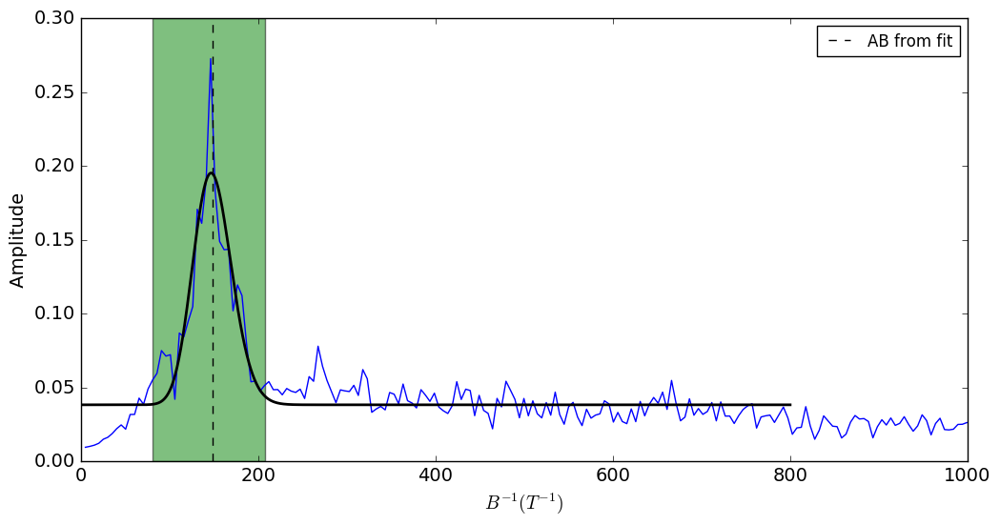

In [1690]:
inputFile337mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_337mK_1.dat'
inputFile337mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_337mK_2.dat'
inputFile337mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_337mK_3.dat'
inputFile337mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_337mK_4.dat'
inputFile337mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_337mK_5.dat'
inputFile337mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_337mK_6.dat'

inputFiles337mk = [inputFile337mk_1, inputFile337mk_2, inputFile337mk_3, inputFile337mk_4, inputFile337mk_5,
                  inputFile337mk_6]
T = 0.337
labels =  ['1', '2', '3', '4', '5', '6']
windows = [107, 107, 107, 107,107,107]
orders = [2, 2, 2, 2, 2, 2]
#parameters = magnetoconductance(inputFiles337mk, windows, orders, labels, plot = True)
#average337mk =magnetconductance_average(inputFiles337mk, windows, orders, labels, T);


A_min = 0.336
A_max = 0.858
A_center = 0.620
#average337mk = magnetconductance_average(inputFiles337mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
B_min = 0.8
B_max = 1.
average337mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles337mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);




# T = 430 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 142.100883424 2.0296700402
Amplitude: 1.12422189719 0.056393557048
B parameter: 0.226596889891 0.0268321188335
offset: 0.0346604666389


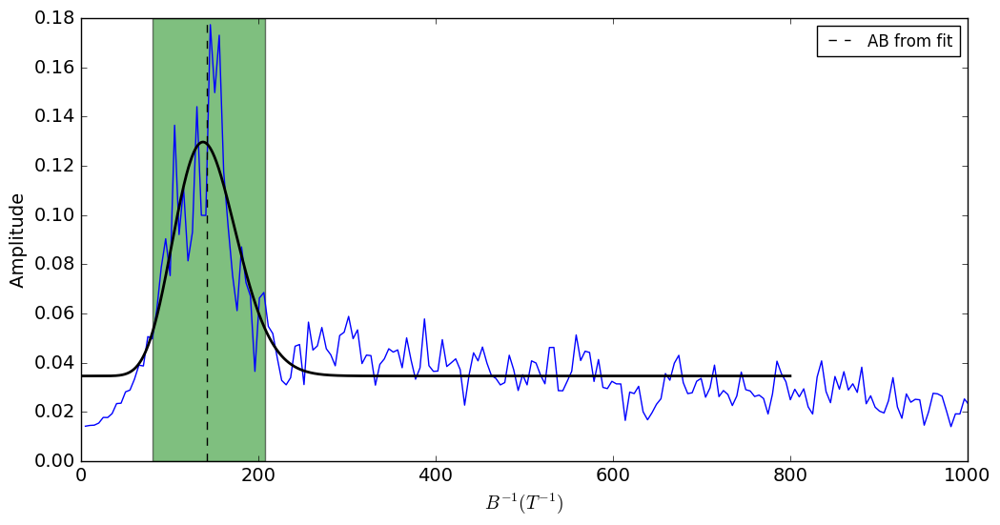

In [1691]:
inputFile430mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_430mk_1.dat'
inputFile430mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_430mk_2.dat'
inputFile430mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_430mk_3.dat'
inputFile430mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_430mk_4.dat'
inputFile430mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_430mk_5.dat'
inputFile430mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_430mk_6.dat'

inputFiles430mk = [inputFile430mk_1, inputFile430mk_2, inputFile430mk_3, inputFile430mk_4, inputFile430mk_5,
                  inputFile430mk_6]
T = 0.43
labels =  ['1', '2', '3', '4', '5', '6']
windows = [107, 107, 107, 107,107,107]
orders = [2, 2, 2, 2, 2, 2]
#parameters = magnetoconductance(inputFiles430mk, windows, orders, labels, plot = True)
#average430mk =magnetconductance_average(inputFiles430mk, windows, orders, labels, T);

A_min = 0.336
A_max = 0.858
A_center = 0.620
#average430mk = magnetconductance_average(inputFiles430mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

B_min = 0.8
B_max = 1.
average430mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles430mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 515 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 143.379595672 2.56052988861
Amplitude: 0.759076415249 0.0450825117853
B parameter: 0.201254925458 0.0282410157354
offset: 0.0336071655392


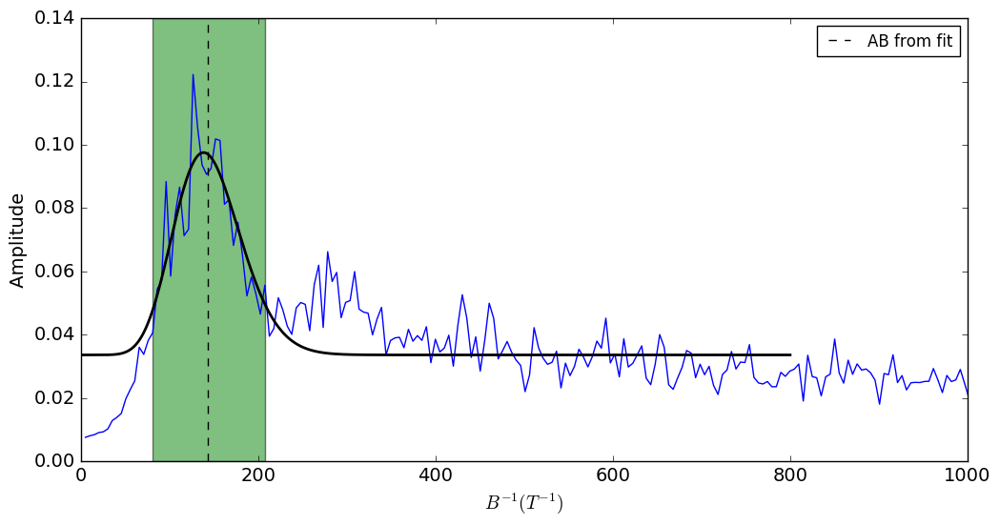

In [1692]:
inputFile515mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_1.dat'
inputFile515mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_2.dat'
inputFile515mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_3.dat'
inputFile515mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_4.dat'
inputFile515mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_5.dat'
inputFile515mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_6.dat'
inputFile515mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_7.dat'
inputFile515mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_515mk_8.dat'

inputFiles515mk = [inputFile515mk_1, inputFile515mk_2, inputFile515mk_3, inputFile515mk_4, inputFile515mk_5,
                  inputFile515mk_6, inputFile515mk_7, inputFile515mk_8]
T = 0.515
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [107, 107, 107, 107,107,107,107,107]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
#parameters = magnetoconductance(inputFiles515mk, windows, orders, labels, plot = True)
#average515mk =magnetconductance_average(inputFiles515mk, windows, orders, labels, T);

A_min = 0.336
A_max = 0.858
A_center = 0.620
B_min = 0.8
B_max = 1.
average515mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles515mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


# T = 600 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 145.911080708 3.12333765647
Amplitude: 0.643315427712 0.0425972452959
B parameter: 0.170761227859 0.0267736207314
offset: 0.0291807446485


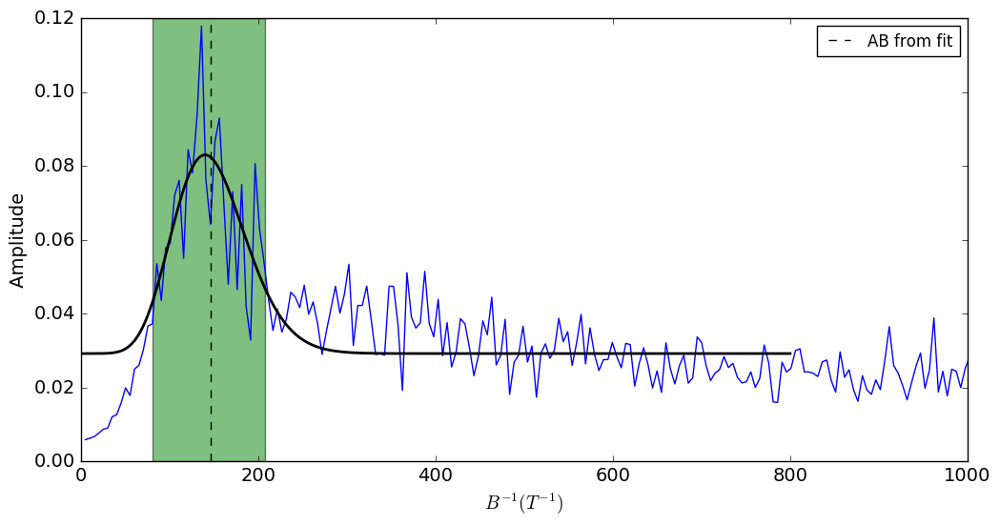

In [1693]:
inputFile600mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_1.dat'
inputFile600mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_2.dat'
inputFile600mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_3.dat'
inputFile600mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_4.dat'
inputFile600mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_5.dat'
inputFile600mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_6.dat'
inputFile600mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_7.dat'
inputFile600mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_600mk_8.dat'

inputFiles600mk = [inputFile600mk_1, inputFile600mk_2, inputFile600mk_3, inputFile600mk_4, 
                   inputFile600mk_7, inputFile600mk_8]
T = 0.6
labels =  ['1', '2', '3', '4', '7', '8']
windows = [107, 107, 107, 107,107,107]
orders = [2, 2, 2, 2, 2, 2]
#parameters = magnetoconductance(inputFiles600mk, windows, orders, labels, plot = True)
#average600mk =magnetconductance_average(inputFiles600mk, windows, orders, labels, T);


A_min = 0.336
A_max = 0.858
A_center = 0.620
B_min = 0.8
B_max = 1.
average600mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles600mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 650 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 155.499396335 2.97234140122
Amplitude: 0.584958115445 0.0357944950884
B parameter: 0.171163931186 0.0248588320821
offset: 0.0253535697598


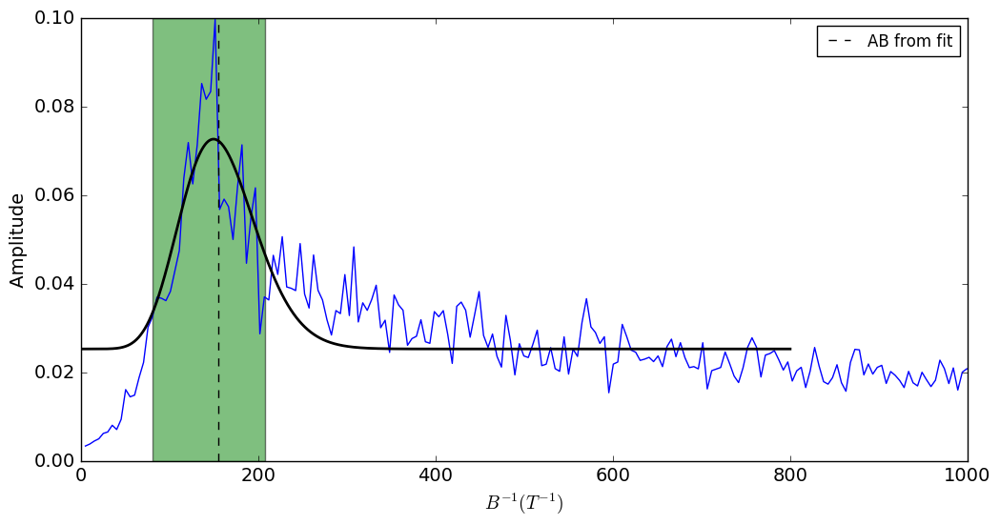

In [1694]:
inputFile650mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_1.dat'
inputFile650mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_2.dat'
inputFile650mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_3.dat'
inputFile650mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_4.dat'
inputFile650mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_5.dat'
inputFile650mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_6.dat'
inputFile650mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_7.dat'
inputFile650mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_650mk_8.dat'

inputFiles650mk = [inputFile650mk_1, inputFile650mk_2, inputFile650mk_3, inputFile650mk_4, inputFile650mk_5,
                  inputFile650mk_6, inputFile650mk_7, inputFile650mk_8]
T = 0.65
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [107, 107, 107, 107,107,107,107,107]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperarature_dependence_650mk'


#parameters = magnetoconductance(inputFiles650mk, windows, orders, labels, plot_name, plot = True)
#average650mk =magnetconductance_average(inputFiles650mk, windows, orders, labels, T, plot_name);


A_min = 0.336
A_max = 0.858
A_center = 0.620
B_min = 0.8
B_max = 1.
average650mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles650mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 700 mK

f AB from design: 149.975810353
f_AAS from design: 299.951620706
limit from design for AB effect 81.2772133527 207.547169811
FIT PARAMETERS FOR AB:
f: 150.713540672 3.39061983614
Amplitude: 0.613300286357 0.0373598707634
B parameter: 0.126324878891 0.0182879026255
offset: 0.0313653846083


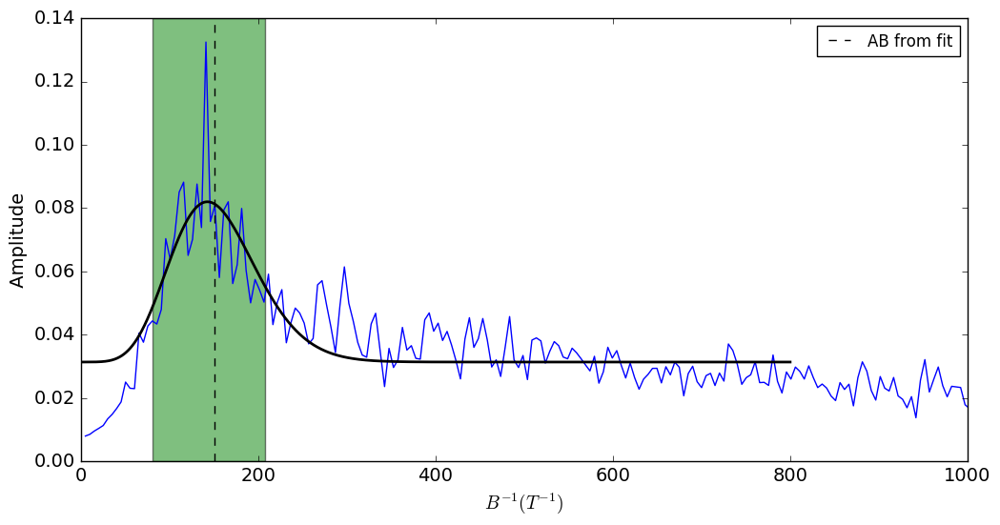

In [1695]:
inputFile700mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_1.dat'
inputFile700mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_2.dat'
inputFile700mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_3.dat'
inputFile700mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_4.dat'
inputFile700mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_5.dat'
inputFile700mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_6.dat'
inputFile700mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_7.dat'
inputFile700mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop1_sweep_700mk_8.dat'

inputFiles700mk = [inputFile700mk_1, inputFile700mk_2, inputFile700mk_3, inputFile700mk_4, inputFile700mk_5,
                  inputFile700mk_6, inputFile700mk_7, inputFile700mk_8]
T = 0.7
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [107, 107, 107, 107,107,107,107,107]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_700mk'
#parameters = magnetoconductance(inputFiles700mk, windows, orders, labels, plot_name, plot = True)
#average700mk =magnetconductance_average(inputFiles700mk, windows, orders, labels, T, plot_name);
A_min = 0.336
A_max = 0.858
A_center = 0.620
B_min = 0.8
B_max = 1.
average700mk_7491_1 = magnetconductance_average_special_singlepeak(inputFiles700mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Summary T dependance

In [2173]:
Ts = [0.079, 0.152, 0.190, 0.260, 0.337, 0.430, 0.515, 0.600, 0.650, 0.700]



#freq_all_average_850mk, fft_all_average_850mk, x1_850mk, A1_850mk, B1_850mk,  x1err_850mk, A1err_850mk, B1err_850mk  = average850mk

freq_all_average_79mk, fft_all_average_79mk, x1_79mk, A1_79mk, B1_79mk, offset_79mk,  x1err_79mk, A1err_79mk, B1err_79mk, offseterr_79mk = average79mk_7491_1
freq_all_average_152mk, fft_all_average_152mk, x1_152mk, A1_152mk, B1_152mk,  offset_152mk, x1err_152mk, A1err_152mk, B1err_152mk,  offseterr_152mk = average152mk_7491_1
freq_all_average_190mk, fft_all_average_190mk, x1_190mk, A1_190mk, B1_190mk,  offset_190mk, x1err_190mk, A1err_190mk, B1err_190mk,  offseterr_190mk = average190mk_7491_1
freq_all_average_260mk, fft_all_average_260mk, x1_260mk, A1_260mk, B1_260mk,  offset_260mk, x1err_260mk, A1err_260mk, B1err_260mk,  offseterr_260mk = average260mk_7491_1
freq_all_average_337mk, fft_all_average_337mk, x1_337mk, A1_337mk, B1_337mk,  offset_337mk, x1err_337mk, A1err_337mk, B1err_337mk,  offseterr_337mk = average337mk_7491_1
freq_all_average_430mk, fft_all_average_430mk, x1_430mk, A1_430mk, B1_430mk,  offset_430mk, x1err_430mk, A1err_430mk, B1err_430mk,  offseterr_430mk = average430mk_7491_1
freq_all_average_515mk, fft_all_average_515mk, x1_515mk, A1_515mk, B1_515mk,  offset_515mk, x1err_515mk, A1err_515mk, B1err_515mk,  offseterr_515mk = average515mk_7491_1
freq_all_average_600mk, fft_all_average_600mk, x1_600mk, A1_600mk, B1_600mk,  offset_600mk, x1err_600mk, A1err_600mk, B1err_600mk,  offseterr_600mk = average600mk_7491_1
freq_all_average_650mk, fft_all_average_650mk, x1_650mk, A1_650mk, B1_650mk,  offset_650mk, x1err_650mk, A1err_650mk, B1err_650mk,  offseterr_650mk = average650mk_7491_1
freq_all_average_700mk, fft_all_average_700mk, x1_700mk, A1_700mk, B1_700mk,  offset_700mk, x1err_700mk, A1err_700mk, B1err_700mk,  offseterr_700mk = average700mk_7491_1



#freq_all_average_152mk, fft_all_average_152mk, A1_152mk, A2_152mk, mean1_152mk, mean2_152mk, sigma1_152mk, sigma2_152mk, A1err_152mk, A2err_152mk = average152mk_7491_1
#freq_all_average_190mk, fft_all_average_190mk, A1_190mk, A2_190mk, mean1_190mk, mean2_190mk, sigma1_190mk, sigma2_190mk, A1err_190mk, A2err_190mk = average190mk_7491_1
#freq_all_average_260mk, fft_all_average_260mk, A1_260mk, A2_260mk, mean1_260mk, mean2_260mk, sigma1_260mk, sigma2_260mk, A1err_260mk, A2err_260mk = average260mk_7491_1
#freq_all_average_337mk, fft_all_average_337mk, A1_337mk, A2_337mk, mean1_337mk, mean2_337mk, sigma1_337mk, sigma2_337mk, A1err_337mk, A2err_337mk = average337mk_7491_1
#freq_all_average_430mk, fft_all_average_430mk, A1_430mk, A2_430mk, mean1_430mk, mean2_430mk, sigma1_430mk, sigma2_430mk, A1err_430mk, A2err_430mk = average430mk_7491_1
#freq_all_average_515mk, fft_all_average_515mk, A1_515mk, A2_515mk, mean1_515mk, mean2_515mk, sigma1_515mk, sigma2_515mk, A1err_515mk, A2err_515mk = average515mk_7491_1
#freq_all_average_600mk, fft_all_average_600mk, A1_600mk, A2_600mk, mean1_600mk, mean2_600mk, sigma1_600mk, sigma2_600mk, A1err_600mk, A2err_600mk = average600mk_7491_1
#freq_all_average_650mk, fft_all_average_650mk, A1_650mk, A2_650mk, mean1_650mk, mean2_650mk, sigma1_650mk, sigma2_650mk, A1err_650mk, A2err_650mk = average650mk_7491_1
#freq_all_average_700mk, fft_all_average_700mk, A1_700mk, A2_700mk, mean1_700mk, mean2_700mk, sigma1_700mk, sigma2_700mk, A1err_700mk, A2err_700mk = average700mk_7491_1


freqs = [freq_all_average_79mk, freq_all_average_152mk, freq_all_average_190mk, freq_all_average_260mk, freq_all_average_337mk,
        freq_all_average_430mk, freq_all_average_515mk, freq_all_average_600mk, freq_all_average_650mk, freq_all_average_700mk]
ffts = [fft_all_average_79mk, fft_all_average_152mk, fft_all_average_190mk, fft_all_average_260mk, fft_all_average_337mk,
        fft_all_average_430mk, fft_all_average_515mk, fft_all_average_600mk, fft_all_average_650mk, fft_all_average_700mk]

x1s = [x1_79mk, x1_152mk, x1_190mk, x1_260mk, x1_337mk, x1_430mk, x1_515mk, x1_600mk, x1_650mk, x1_700mk]
A1s = [A1_79mk, A1_152mk, A1_190mk, A1_260mk, A1_337mk, A1_430mk, A1_515mk, A1_600mk, A1_650mk, A1_700mk]
B1s = [B1_79mk, B1_152mk, B1_190mk, B1_260mk, B1_337mk, B1_430mk, B1_515mk, B1_600mk, B1_650mk, B1_700mk]
offsets = [offset_79mk, offset_152mk, offset_190mk, offset_260mk, offset_337mk, offset_430mk, offset_515mk, offset_600mk, offset_650mk, offset_700mk]

x1errs = [x1err_79mk, x1err_152mk, x1err_190mk, x1err_260mk, x1err_337mk, x1err_430mk, x1err_515mk, x1err_600mk, x1err_650mk, x1err_700mk]
A1errs = [A1err_79mk, A1err_152mk, A1err_190mk, A1err_260mk, A1err_337mk, A1err_430mk, A1err_515mk, A1err_600mk, A1err_650mk, A1err_700mk]
B1errs = [B1err_79mk, B1err_152mk, B1err_190mk, B1err_260mk, B1err_337mk, B1err_430mk, B1err_515mk, B1err_600mk, B1err_650mk, B1err_700mk]
offseterrs = [offseterr_79mk, offseterr_152mk, offseterr_190mk, offseterr_260mk, offseterr_337mk, offseterr_430mk, offseterr_515mk, offseterr_600mk, offseterr_650mk, offseterr_700mk]



T_fit = np.linspace(0.01, 2, 1000) 


#decay fit
A =1
alpha = 1
A_AB, alpha_AB, A_err_AB, alpha_err_AB = fitting_decay(Ts, A1s, A1errs, A, alpha)
fit_AB = decay(T_fit, A_AB, alpha_AB)

A = 1
alpha = 1

#A_AAS, alpha_AAS, A_err_AAS, alpha_err_AAS = fitting_decay(Ts, A2s, A2errs, A, alpha)
#fit_AAS = decay(T_fit, A_AAS, alpha_AAS)

#power fit
#A =1
#B = 1
#A_AB_powerfit, B_AB_powerfit, A_AB_powerfit_err, B_AB_powerfit_err = fitting_power(Ts, A1s, A1errs, A, B)
#fit_AB_power = power(T_fit, A_AB_powerfit, B_AB_powerfit)


#defining fitted function to plot in the big one
fit_79mk = special_function(freq_all_average_79mk, x1_79mk, A1_79mk,  B1_79mk, offset_79mk)
fit_152mk = special_function(freq_all_average_152mk, x1_152mk, A1_152mk,  B1_152mk, offset_152mk)
fit_190mk = special_function(freq_all_average_190mk, x1_190mk, A1_190mk,  B1_190mk, offset_190mk)
fit_260mk = special_function(freq_all_average_260mk, x1_260mk, A1_260mk,  B1_260mk, offset_260mk)
fit_337mk = special_function(freq_all_average_337mk, x1_337mk, A1_337mk,  B1_337mk, offset_337mk)
fit_430mk = special_function(freq_all_average_430mk, x1_430mk, A1_430mk,  B1_430mk, offset_430mk)
fit_515mk = special_function(freq_all_average_515mk, x1_515mk, A1_515mk,  B1_515mk, offset_515mk)
fit_600mk = special_function(freq_all_average_600mk, x1_600mk, A1_600mk,  B1_600mk, offset_600mk)
fit_650mk = special_function(freq_all_average_650mk, x1_650mk, A1_650mk,  B1_650mk, offset_650mk)
fit_700mk = special_function(freq_all_average_700mk, x1_700mk, A1_700mk,  B1_700mk, offset_700mk)


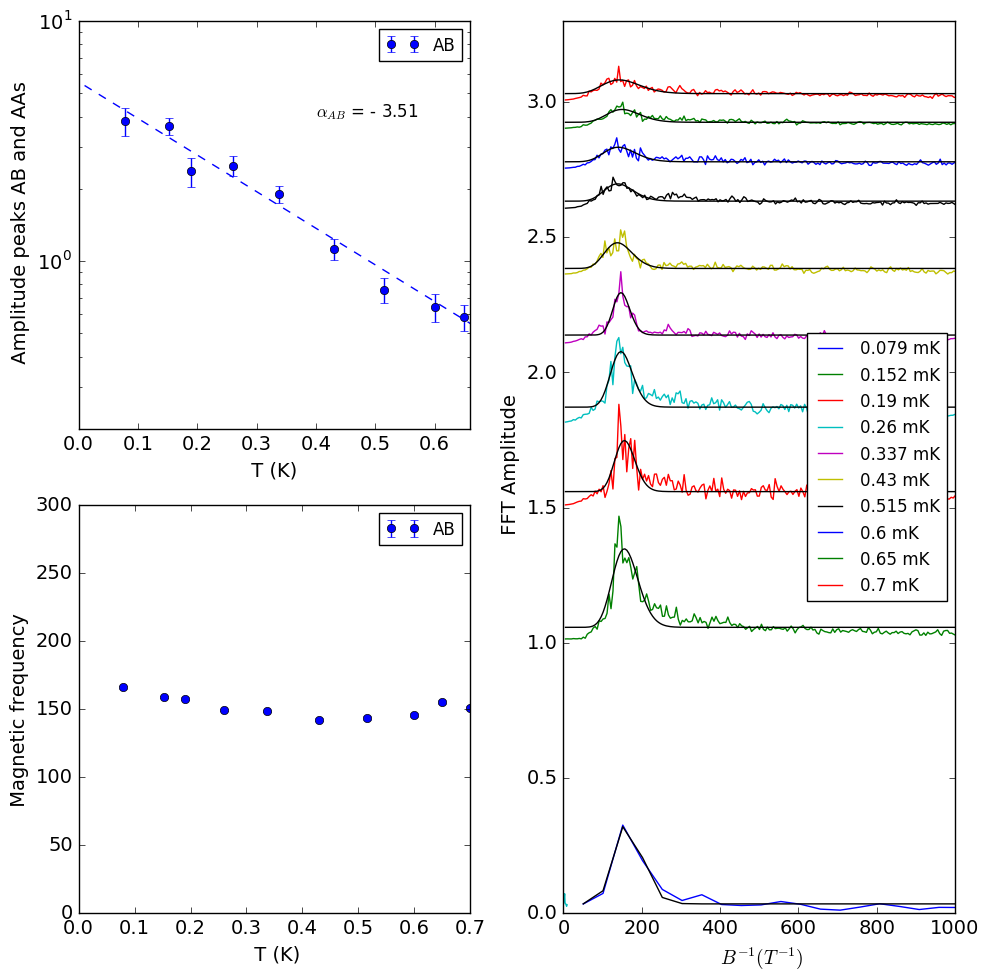

In [2174]:
fig = plt.figure(figsize=(10,10))
ax1 = plt.subplot2grid((2,2), (0,0), colspan=1)
ax2 = plt.subplot2grid((2,2), (1,0), colspan=1)
ax3 = plt.subplot2grid((2,2), (0,1), rowspan=2)        
    
ax1.set_xlabel( ' T (K) ', fontsize=axes_font)
ax1.set_ylabel(' Amplitude peaks AB and AAs', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_ylim(0.2,10)
ax1.set_xlim(0, 0.66)
ax1.text( 0.4 , 4, '$\\alpha_{AB}$ = - ' + str(np.round(alpha_AB,2)), fontsize = 12 )
#ax1.text( 0.4 , 0.15, '$\\alpha_{AAS}$ = - ' + str(np.round(alpha_AAS,2)), fontsize = 12 )
ax1.set_yscale('log')
        

                
ax2.set_xlabel( ' T (K)', fontsize=axes_font)
ax2.set_ylabel(' Magnetic frequency ', fontsize=axes_font)
ax2.tick_params(axis='both', which='major', labelsize=tick_font)
ax2.get_xaxis().get_major_formatter().set_useOffset(False)
ax2.set_ylim(0,300)

#ax2.set_ylim(0,500)
#ax2.set_xlim(0, 6)

ax3.set_xlabel( ' $ B ^{-1} ( T^{-1}) $', fontsize=axes_font)
ax3.set_ylabel(' FFT Amplitude', size=axes_font)
ax3.tick_params(axis='both', which='major', labelsize=tick_font)
ax3.get_xaxis().get_major_formatter().set_useOffset(False)
ax3.set_ylim(0,3.3)
ax3.set_xlim(0, 1000)



ax1.errorbar(Ts, A1s, yerr = 2*np.array(A1errs), fmt = 'o', label = 'AB')
ax1.plot(T_fit, fit_AB, linestyle = '--', color = 'b')
#ax1.plot(T_fit, fit_AAS, linestyle = '--', color = 'green')
#ax1.errorbar(Ts, A2s, yerr = 2*np.array(A2errs), fmt = 'o', label = 'AAS')

#ax1.plot(T_fit, fit_AB_power, linestyle = '--', color = 'r')

ax2.errorbar(Ts, x1s, yerr = np.array(x1errs)*0.5, fmt = 'o', label = 'AB')


#for index in range(0, len(Ts)):
#    ax3.plot(freqs[index], ffts[index] + index , label = str(Ts[index]) + ' mK')

ax3.plot(freqs[0], ffts[0], label = str(Ts[0]) + ' mK')
ax3.plot(freq_all_average_79mk, fit_79mk, color ='black')

ax3.plot(freqs[1], ffts[1] + 1.0, label = str(Ts[1]) + ' mK')
ax3.plot(freq_all_average_152mk, fit_152mk + 1.0, color ='black')

ax3.plot(freqs[2], ffts[2]+ 1.5, label = str(Ts[2]) + ' mK')
ax3.plot(freq_all_average_190mk, fit_190mk + 1.5, color ='black')

ax3.plot(freqs[3], ffts[3] + 1.8, label = str(Ts[3]) + ' mK')
ax3.plot(freq_all_average_260mk, fit_260mk + 1.8, color ='black')

ax3.plot(freqs[4], ffts[4] + 2.1, label = str(Ts[4]) + ' mK')
ax3.plot(freq_all_average_337mk, fit_337mk + 2.1, color ='black')

ax3.plot(freqs[5], ffts[5] +2.35,  label = str(Ts[5]) + ' mK')
ax3.plot(freq_all_average_430mk, fit_430mk + 2.35, color ='black')

ax3.plot(freqs[6], ffts[6] +2.6, label = str(Ts[6]) + ' mK')
ax3.plot(freq_all_average_515mk, fit_515mk + 2.6, color ='black')

ax3.plot(freqs[7], ffts[7] +2.75, label = str(Ts[7]) + ' mK')
ax3.plot(freq_all_average_600mk, fit_600mk + 2.75, color ='black')

ax3.plot(freqs[8], ffts[8] + 2.9, label = str(Ts[8]) + ' mK')
ax3.plot(freq_all_average_650mk, fit_650mk + 2.9, color ='black')

ax3.plot(freqs[9], ffts[9] +3.0, label = str(Ts[9]) + ' mK')
ax3.plot(freq_all_average_700mk, fit_700mk + 3.0, color ='black')

ax1.legend(loc=0)
ax2.legend(loc=0)
ax3.legend(loc=5)

fig.subplots_adjust(hspace=sub_hspace-7)    
fig.subplots_adjust(wspace=sub_wspace)   
fig.tight_layout() 

fig.savefig('loop7491_1'+str(limit_fit)+'.eps',format='eps',transparent = False)
fig.savefig('loop'+str(limit_fit)+'.png',format='png',transparent = False)

 

              
               


# Loop 1 -  Coherence length evaluation 

In [1756]:
L = 3.3
l_phi = L/(alpha_AAS * 0.08)
print l_phi
l_phi = 0.5*L/(alpha_AB * 0.08)
print l_phi

15.4364994115
5.8044421447


# Loop 2 

# gates dependence


In [1185]:
inputFile_T2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_sweep_TG2_1.dat'

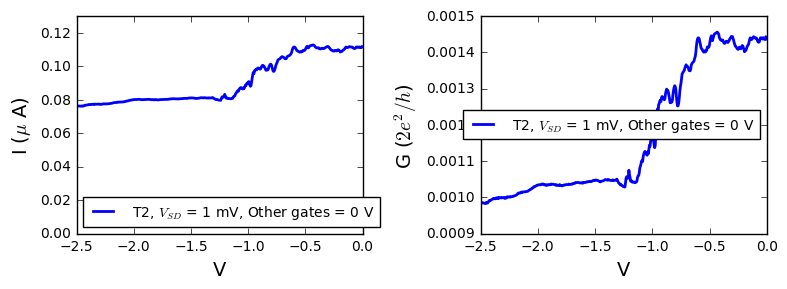

In [1205]:
# T2 gate dependance 
inputFiles = [inputFile_T2]
gates = ['T2']
conversions = [0.005]
labels = [' T2, $ V_{SD} $ = 1 mV, Other gates = 0 V'] 
plot_name = ('T2_pinchoff')
gate_dependance(inputFiles, gates, conversions, labels, plot_name)


In [1189]:
inputFile_RG = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_sweep_RG_11.dat'

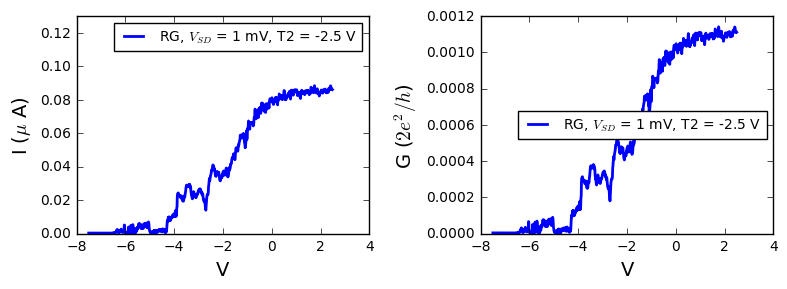

In [1206]:
# RG gate dependance 
inputFiles = [inputFile_RG]
gates = ['RG']
conversions = [0.005]
labels = ['RG, $ V_{SD} $ = 1 mV, T2 = -2.5 V'] 
plot_name = ('RG_pinchoff')
gate_dependance(inputFiles, gates, conversions, labels, plot_name)


In [1207]:
inputFile_T2_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_sweep_RG_12.dat'

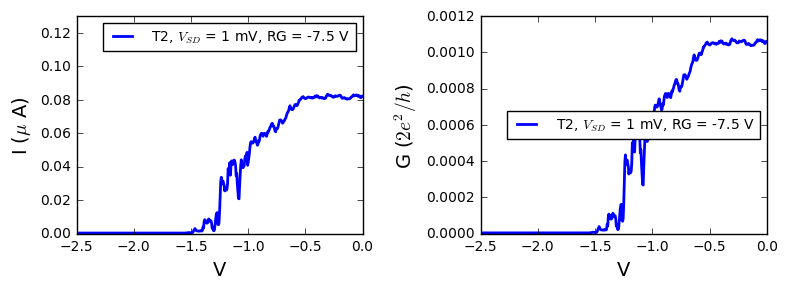

In [1208]:
# T2 gate dependance with RG closed, we reopen one arm
inputFiles = [inputFile_T2_2]
gates = ['T2']
conversions = [0.005]
labels = [' T2, $ V_{SD} $ = 1 mV, RG = -7.5 V'] 
plot_name = ('T2_reopen')
gate_dependance(inputFiles, gates, conversions, labels, plot_name)


In [1209]:
inputFile_T1= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_sweep_T1_5.dat'

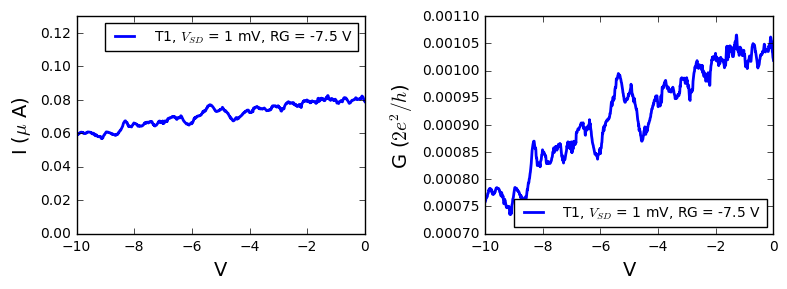

In [1210]:
# T1 gate dependance with RG closed, and T2 open
inputFiles = [inputFile_T1]
gates = ['T1']
conversions = [0.005]
labels = [' T1, $ V_{SD} $ = 1 mV, RG = -7.5 V'] 
plot_name = ('T1_effect')
gate_dependance(inputFiles, gates, conversions, labels, plot_name)

In [1211]:
inputFile_PG= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_sweep_PG_3.dat'

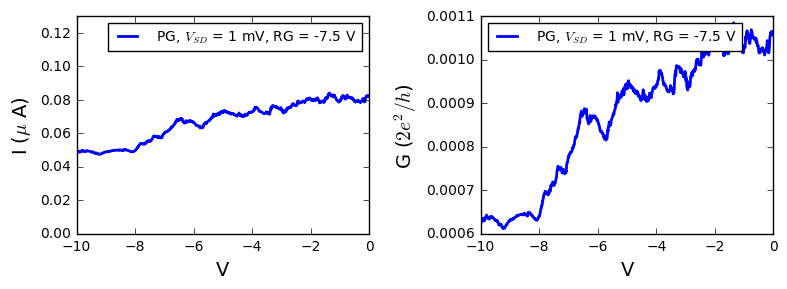

In [1213]:
# T1 gate dependance with RG closed, and T2 open
inputFiles = [inputFile_PG]
gates = ['PG']
conversions = [0.005]
labels = [' PG, $ V_{SD} $ = 1 mV, RG = -7.5 V'] 
plot_name = ('PG_effect')
gate_dependance(inputFiles, gates, conversions, labels, plot_name)

# Loop2 - Examples of oscillations

In [1214]:
inputFile_example = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balanced_long_scan_tau100_3.dat'

([array([  6.26037657e-01,   1.25207531e+00,   1.87811297e+00, ...,
           1.59827414e+03,   1.59890018e+03,   1.59952621e+03])],
 [array([ 0.01541719,  0.01596253,  0.0168767 , ...,  0.10272517,
          0.07804371,  0.00155327])],
 [1.7048746174286529],
 [87.981623422894927],
 [55.976443425220154],
 [0.18329759277191851],
 [344.96142732434168],
 [154.13070845313044],
 [0.1382657569257473],
 [0.043311065866895135])

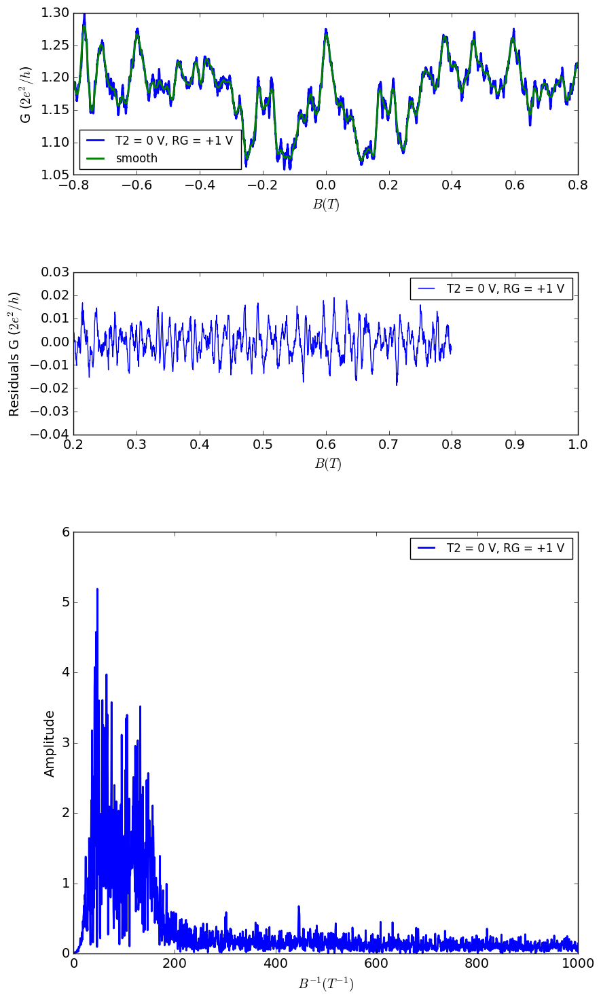

In [1215]:
inputFiles = [inputFile_example ]
labels =  ['T2 = 0 V, RG = +1 V ']
windows = [105]
#105
orders = [3]
plot_name = 'AB_long_range_loop2'
magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True)

([array([  6.26037657e-01,   1.25207531e+00,   1.87811297e+00, ...,
           1.59827414e+03,   1.59890018e+03,   1.59952621e+03])],
 [array([ 0.01129863,  0.01131122,  0.01133263, ...,  0.11066426,
          0.08142977,  0.0026306 ])],
 [1.0743579097692888],
 [140.46659080996852],
 [31.770058240968076],
 [0.18569010304306829],
 [331.30252065295286],
 [187.33077970461514],
 [0.03400496553800534],
 [0.013751199049119832])

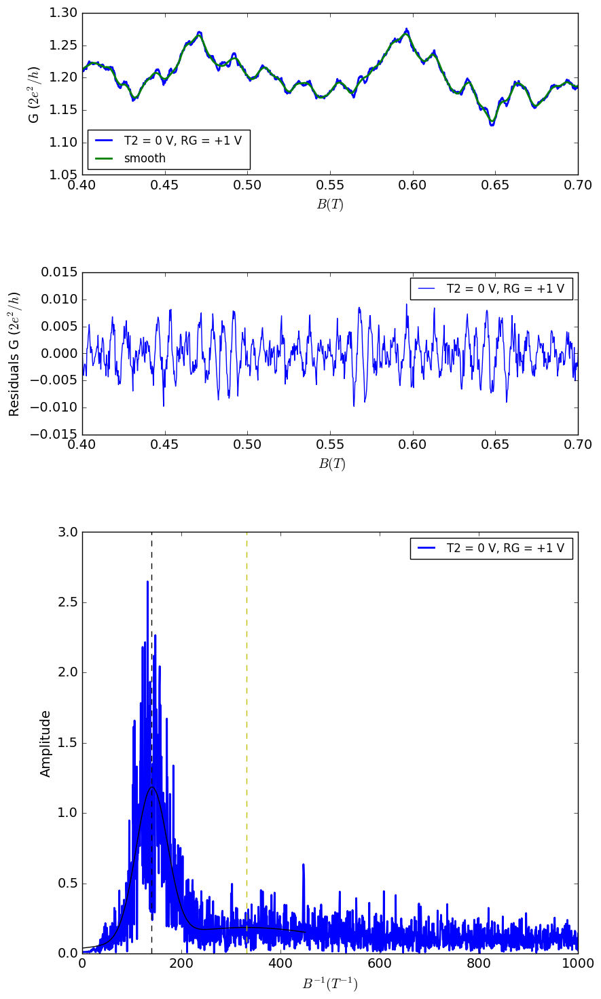

In [1248]:
inputFiles = [inputFile_example ]
labels =  ['T2 = 0 V, RG = +1 V ']
windows = [41]
#51 gives nice AB
#121 131 gives two peaks
orders = [3]
plot_name = 'AB_long_range_loop2_zoom400-700mT'
magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True)

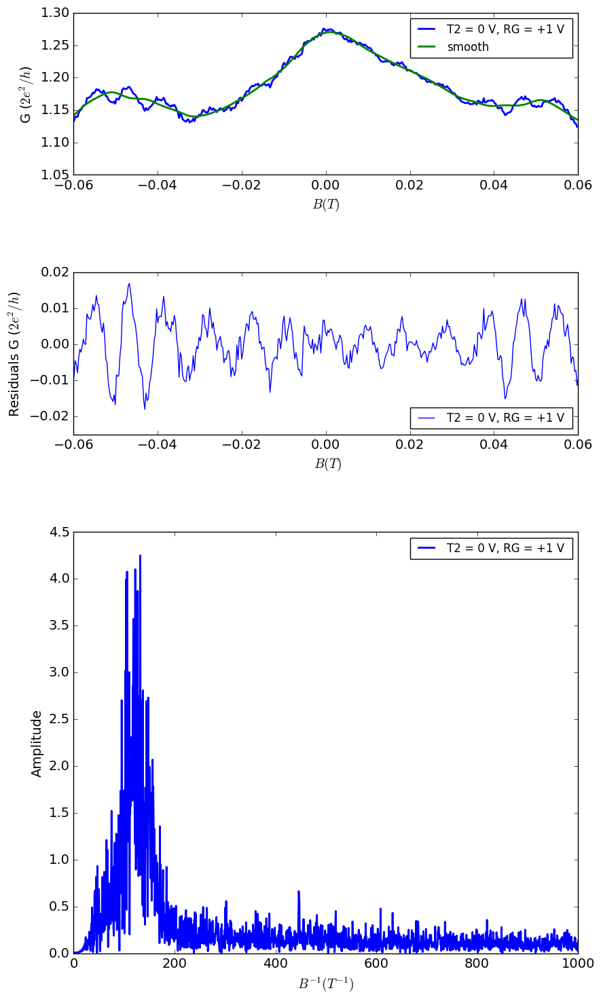

In [1238]:
inputFiles = [inputFile_example ]
labels =  ['T2 = 0 V, RG = +1 V ']
windows = [61]
#51 gives nice AB
#121 131 gives two peaks
orders = [3]
plot_name = 'AB_long_range_loop2_zoom_around0T'
magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True);

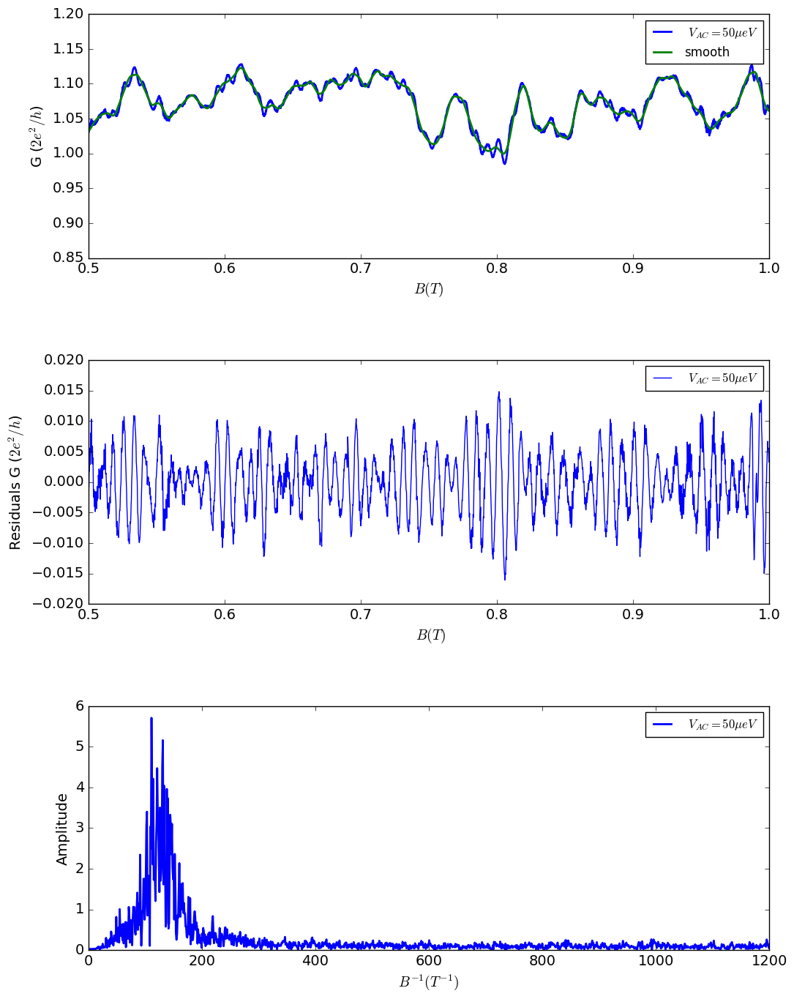

In [489]:
#T = 16 mK example of oscillations


inputFile_example = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__4.dat'


inputFiles = [inputFile_example ]
labels =  [' $ V_{AC} = 50 \mu eV $']
windows = [85]
#51 gives nice AB
#121 131 gives two peaks
orders = [3]
plot_name = 'loop2_AB_16mk'

magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True);



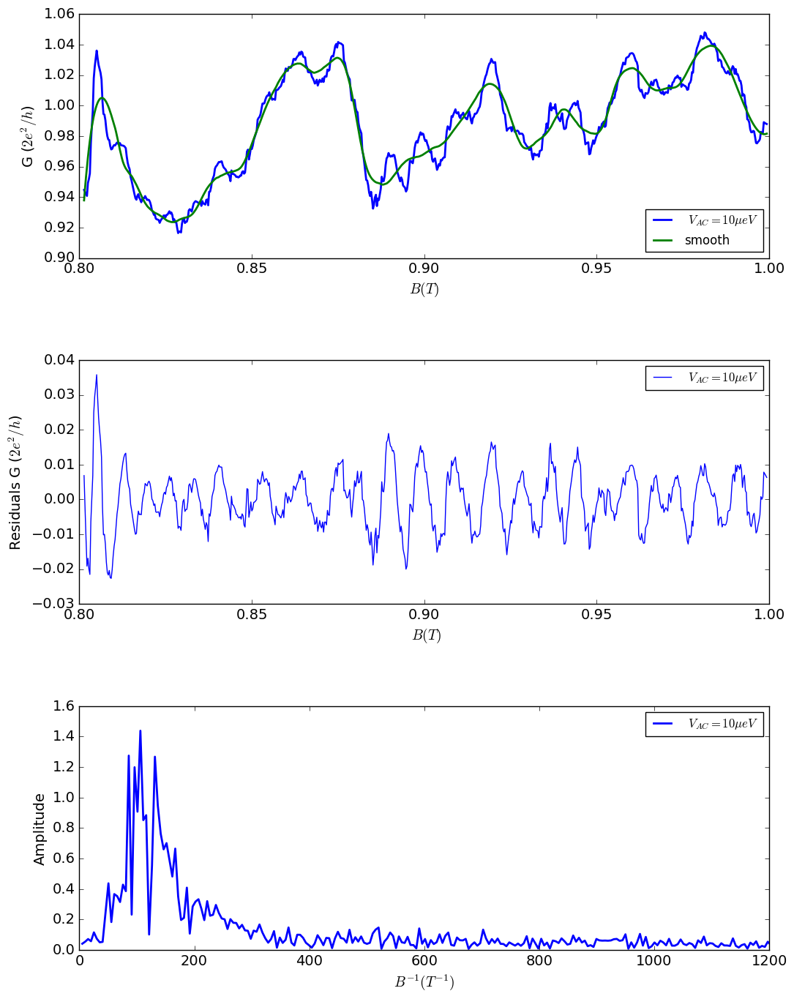

In [521]:


#T = 16 mK example of oscillations - short range V _AC = 10 ueV
inputFile_example = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_16mK__11.dat'


inputFiles = [inputFile_example ]
labels =  [' $ V_{AC} = 10 \mu eV $']
windows = [61]
#51 gives nice AB
#121 131 gives two peaks
orders = [3]
plot_name = 'loop2_AB_16mk_Vac_10ueV'

magnetoconductance(inputFiles, windows, orders, labels,  plot_name, plot=True);



# oscillation suppression via gate


# Series 1 -  Keep open T2, vary RG from -5 V to 0 V

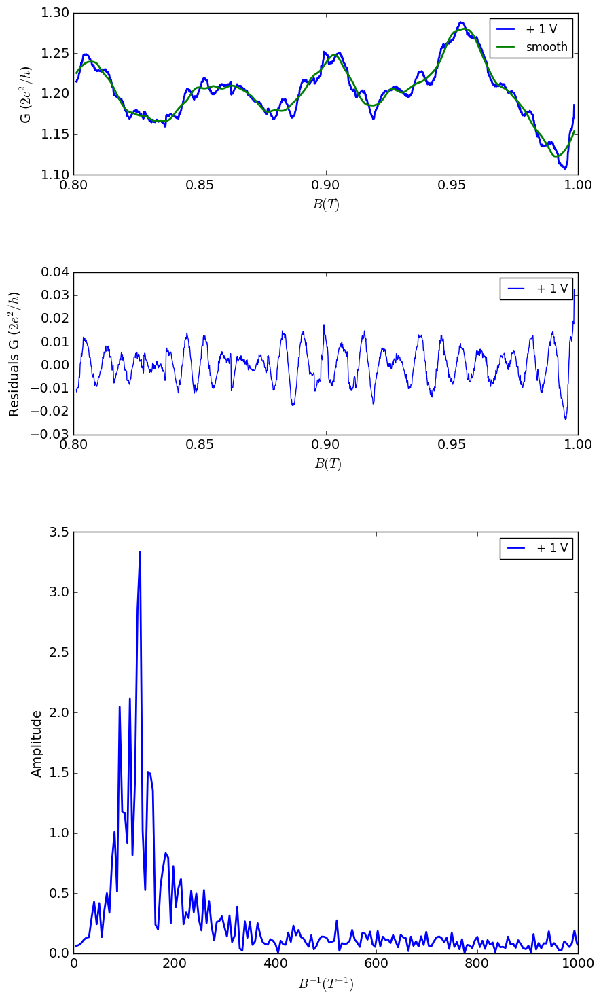

In [1266]:

inputFile_balance12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_12.dat'

inputFiles_balance  = [ inputFile_balance12]
#107
windows = [117]
#91 is nice peaks
orders = [2]
labels = ['+ 1 V']
plot_name = 'AB_RG_1V'
magnetoconductance(inputFiles_balance, windows, orders, labels, plot_name, plot = True);

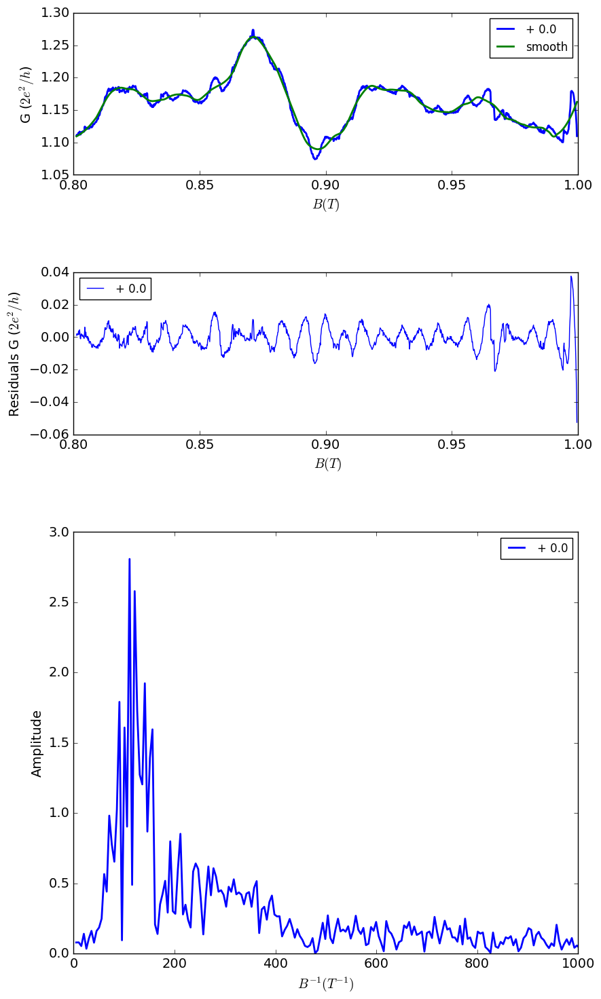

In [1267]:
inputFile_balance10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_10.dat'

inputFiles_balance  = [ inputFile_balance10]
#107
windows = [117]
orders = [2]
labels = ['+ 0.0']
plot_name = 'AB_RG_0V'
magnetoconductance(inputFiles_balance, windows, orders, labels,plot_name, plot = True);

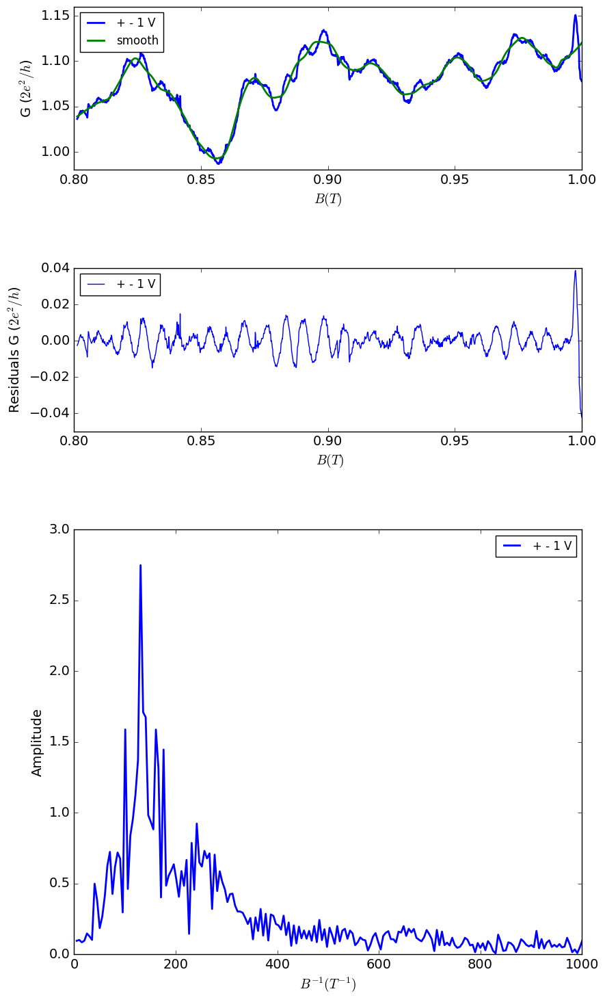

In [1269]:
inputFile_balance8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_8.dat'

inputFiles_balance  = [ inputFile_balance8]
#107
windows = [117]
orders = [2]
labels = ['+ - 1 V']
plot_name = 'AB_RG_-1V'
magnetoconductance(inputFiles_balance, windows, orders, labels,plot_name, plot = True);

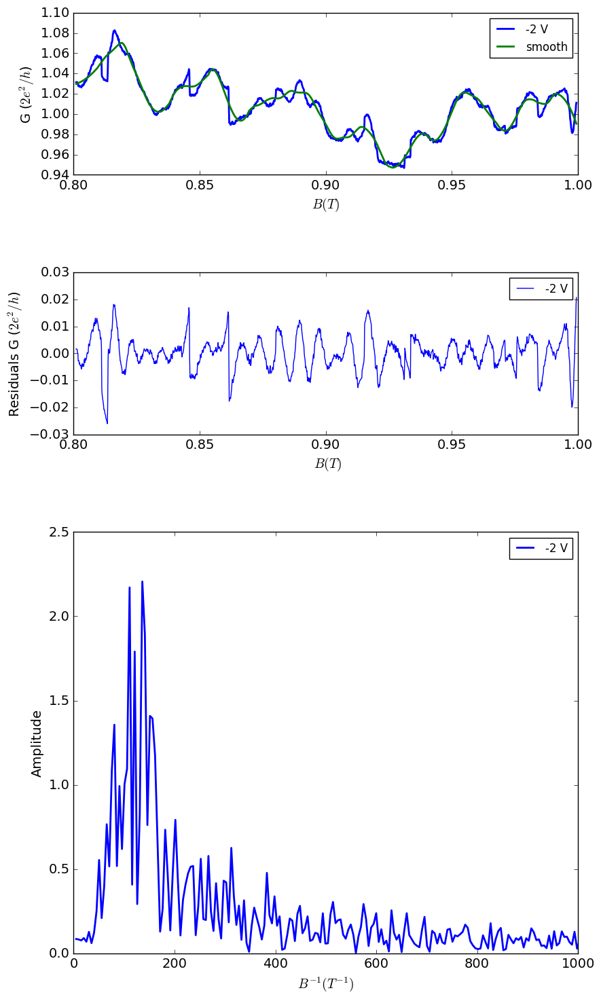

In [1271]:
inputFile_balance6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_6.dat'

inputFiles_balance  = [ inputFile_balance6]
#107
windows = [117]
orders = [2]
labels = ['-2 V']
plot_name = 'AB_RG_-2V'
magnetoconductance(inputFiles_balance, windows, orders, labels, plot_name, plot = True);

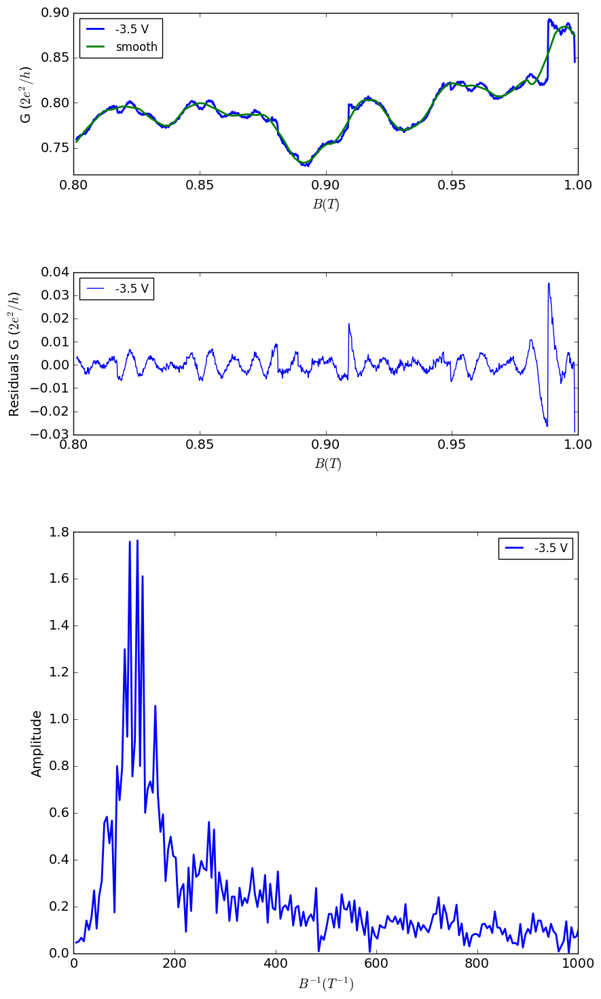

In [1272]:
inputFile_balance4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_4.dat'

inputFiles_balance  = [ inputFile_balance4]
#107
windows = [117]
orders = [2]
labels = ['-3.5 V']
plot_name = 'AB_RG_-3.5V'
magnetoconductance(inputFiles_balance, windows, orders, labels, plot_name, plot = True);

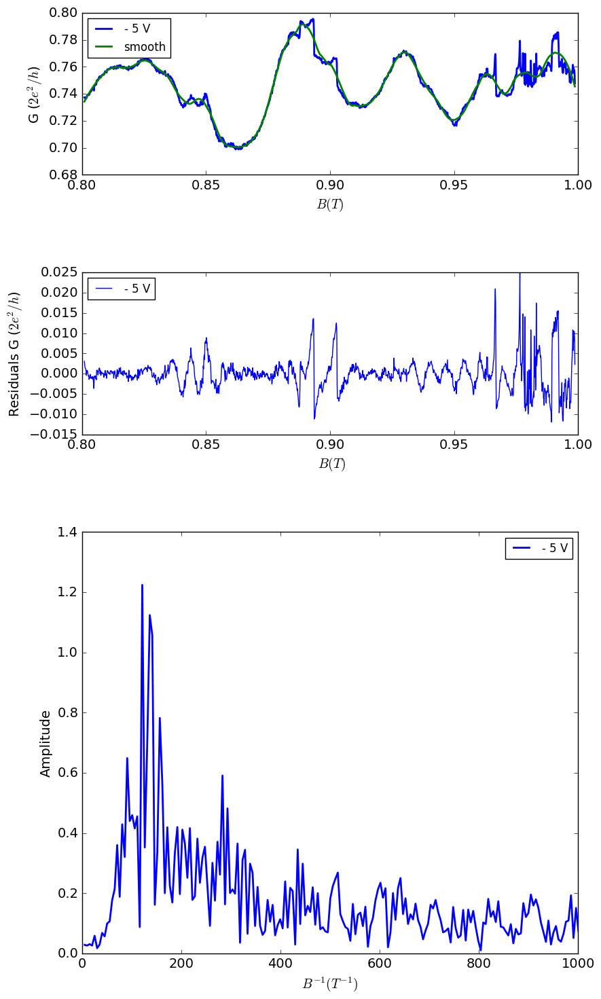

In [1274]:
inputFile_balance2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_2.dat'

inputFiles_balance  = [ inputFile_balance2]
#107
windows = [101]
orders = [2]
labels = ['- 5 V']
plot_name = 'AB_RG_-5V'
magnetoconductance(inputFiles_balance, windows, orders, labels, plot_name, plot = True);

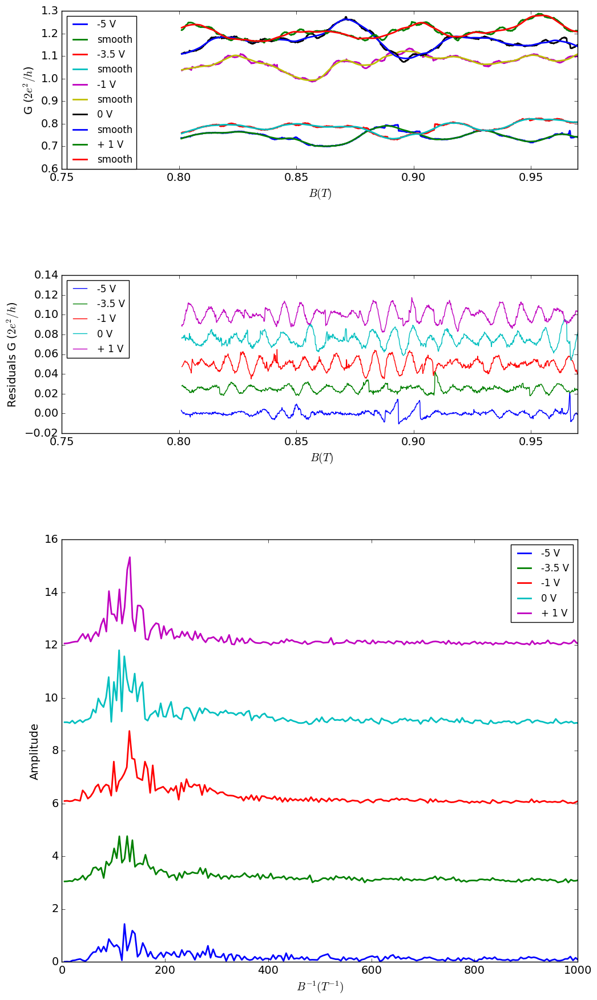

In [1378]:
inputFile_balance2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_2.dat'

inputFile_balance4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_4.dat'

#inputFile_balance6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_6.dat'

inputFile_balance8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_8.dat'

inputFile_balance10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_10.dat'

inputFile_balance12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_B_sweep_RG_balancing_12.dat'

inputFiles_balance  = [ inputFile_balance2, inputFile_balance4,  
                       inputFile_balance8, inputFile_balance10, inputFile_balance12]

windows = [117 , 117, 117, 117, 117]
orders = [2, 2, 2, 2, 2]
labels = ['-5 V' ,  '-3.5 V',  '-1 V', '0 V', '+ 1 V']
plot_name = 'oscillations_balance'

magnetoconductance(inputFiles_balance, windows, orders, labels, plot_name, plot = True);

# Series 2 -  Keep open T2, vary RG from -5 V to 0 V

In [1303]:
#+1 V
inputFile_RGclosing_0 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_1.dat'



#-2 V
inputFile_RGclosing_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_1.dat'
inputFile_RGclosing_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_2.dat'
inputFile_RGclosing_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_3.dat'
inputFile_RGclosing_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_4.dat'

#-3.5 V
inputFile_RGclosing_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_5.dat'
inputFile_RGclosing_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_6.dat'
inputFile_RGclosing_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_7.dat'
inputFile_RGclosing_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_8.dat'

#-5 V
inputFile_RGclosing_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_9.dat'
inputFile_RGclosing_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_10.dat'
inputFile_RGclosing_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_11.dat'
inputFile_RGclosing_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_12.dat'

#-8 V
inputFile_RGclosing_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_13.dat'
inputFile_RGclosing_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_14.dat'
inputFile_RGclosing_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_15.dat'
inputFile_RGclosing_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_closingRG_16.dat'

inputFile_RGclosing_1set = [inputFile_RGclosing_1]
inputFile_RGclosing_2set = [ inputFile_RGclosing_6,  inputFile_RGclosing_8]
inputFile_RGclosing_3set = [ inputFile_RGclosing_12]
inputFile_RGclosing_4set = [inputFile_RGclosing_13, inputFile_RGclosing_14, inputFile_RGclosing_16]

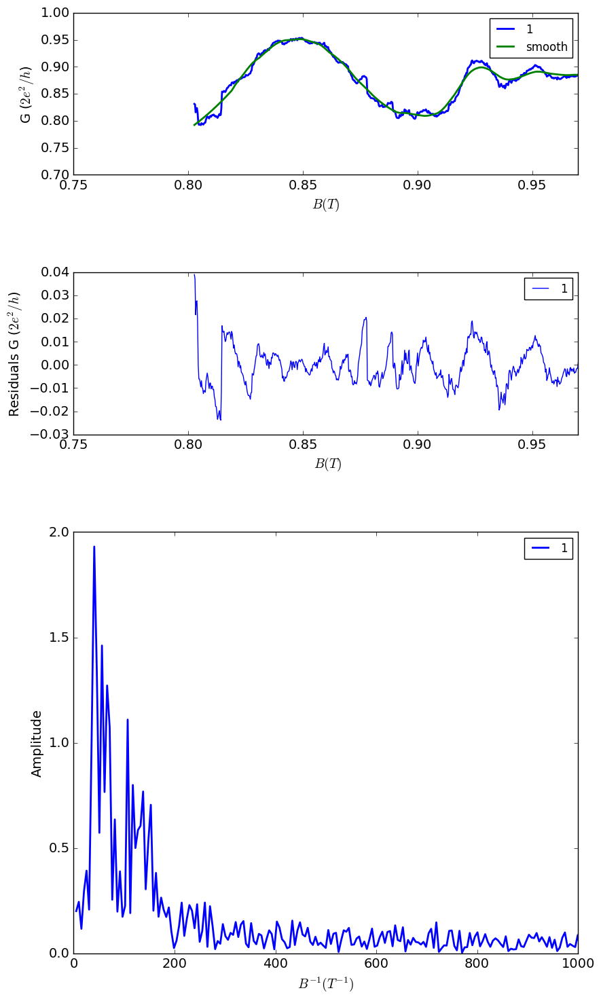

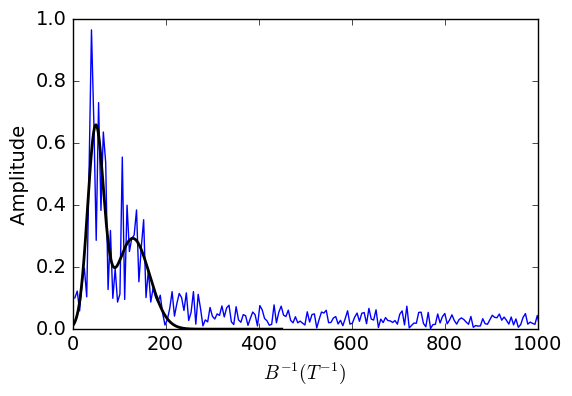

In [1302]:
T = 0.080
labels =  ['1', ]
windows = [117]
orders = [2]

plot_name = 'closingRG_1set'
parameters = magnetoconductance(inputFile_RGclosing_1set , windows, orders, labels, plot_name, plot = True)
average1set =magnetconductance_average(inputFile_RGclosing_1set, windows, orders, labels, T, plot_name);

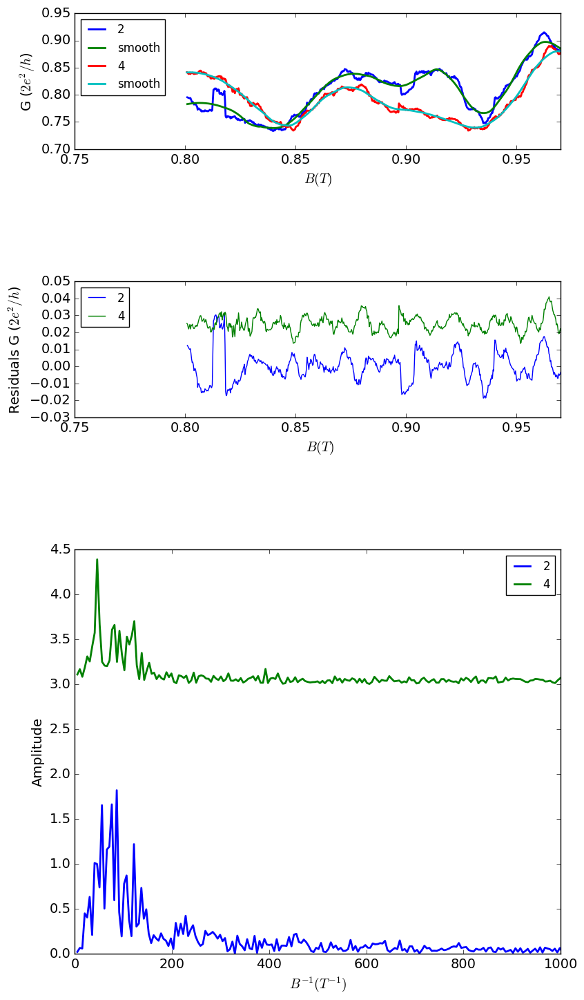

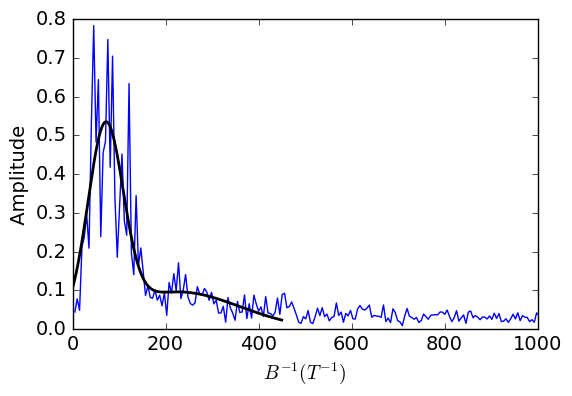

In [1301]:
T = 0.080
labels =  [ '2', '4']
windows = [117, 117]
orders = [2, 2]

plot_name = 'closingRG_2set'
parameters = magnetoconductance(inputFile_RGclosing_2set , windows, orders, labels, plot_name, plot = True)
average1set =magnetconductance_average(inputFile_RGclosing_2set, windows, orders, labels, T, plot_name);

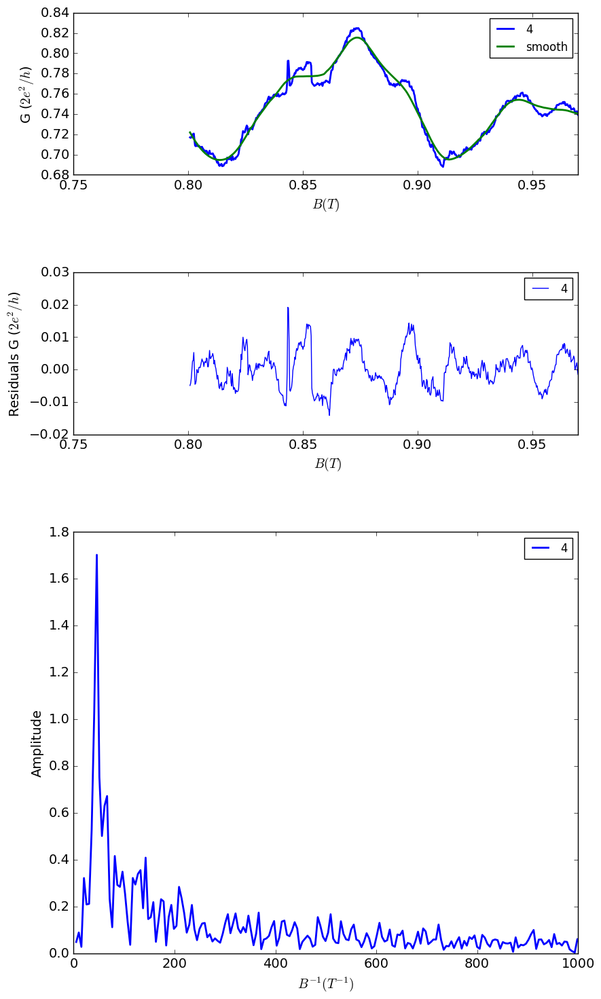

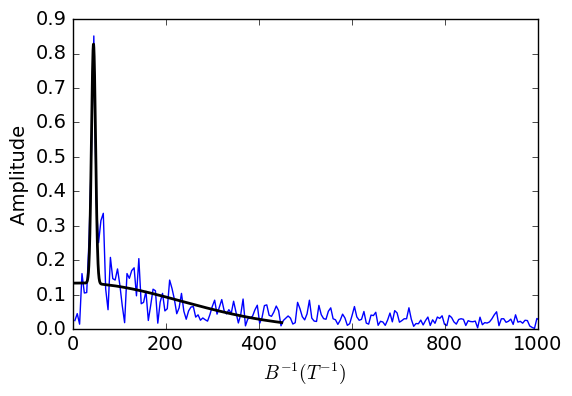

In [1300]:
T = 0.080
labels =  [ '4']
windows = [ 117]
orders = [ 2]



plot_name = 'closingRG_3set'
parameters = magnetoconductance(inputFile_RGclosing_3set , windows, orders, labels, plot_name, plot = True)
average1set =magnetconductance_average(inputFile_RGclosing_3set, windows, orders, labels, T, plot_name);

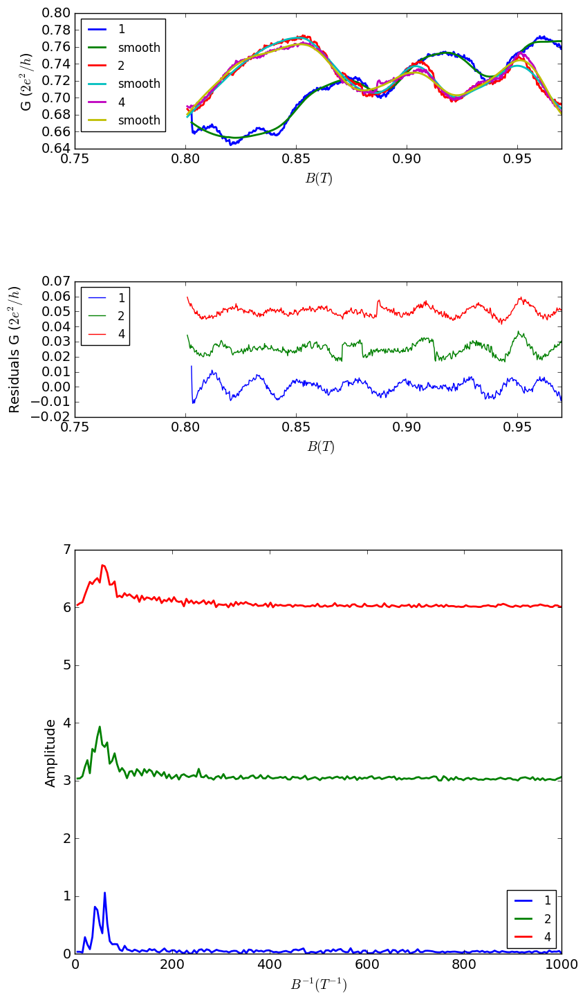

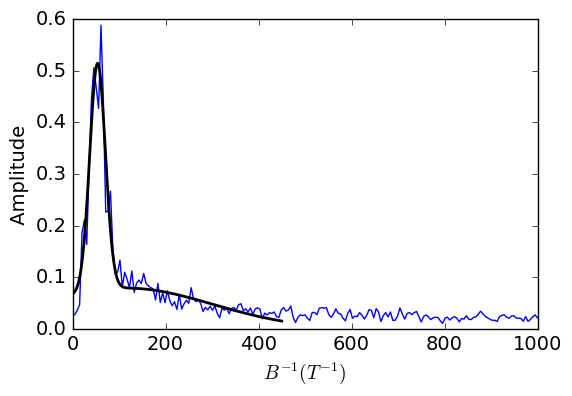

In [1299]:
T = 0.080
labels =  ['1', '2',  '4']
windows = [117, 117, 117]
orders = [2, 2, 2]

plot_name = 'closingRG_4set'
parameters = magnetoconductance(inputFile_RGclosing_4set , windows, orders, labels, plot_name, plot = True)
average1set =magnetconductance_average(inputFile_RGclosing_4set, windows, orders, labels, T, plot_name);

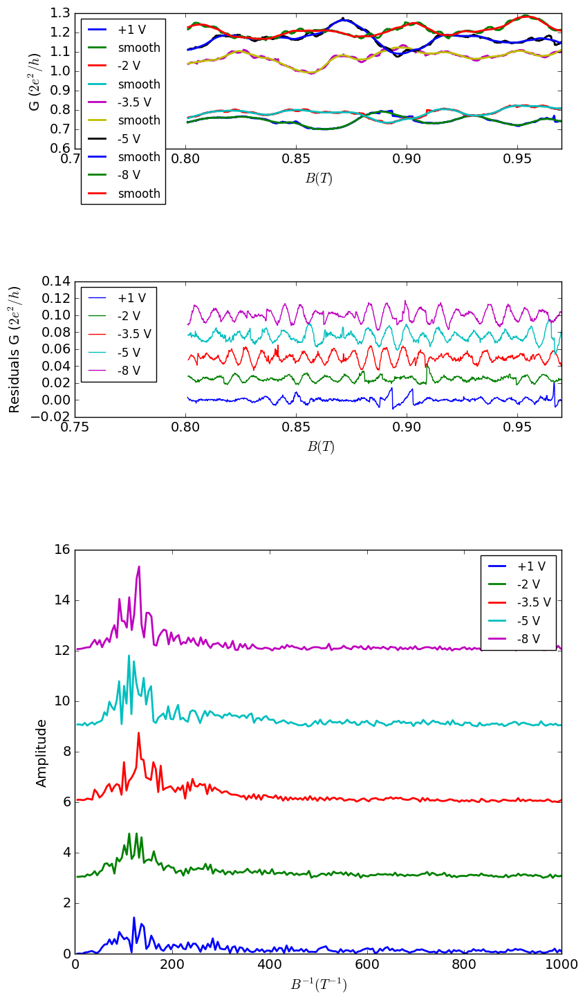

In [1304]:


inputFiles_balance_2  = [ inputFile_RGclosing_0 , inputFile_RGclosing_1, inputFile_RGclosing_6, inputFile_RGclosing_12,
                        inputFile_RGclosing_16]

windows = [117 , 117, 117, 117, 117]
orders = [2, 2, 2, 2, 2]
labels = ['+1 V',   '-2 V',  '-3.5 V', '-5 V', '-8 V']
plot_name = 'oscillations_balance_2'

magnetoconductance(inputFiles_balance, windows, orders, labels, plot_name, plot = True);

# Loop 2 7491 - Temperature dependence 

# 16 mk

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 121.384899942 1.46993547664
Amplitude: 0.506309451635 0.0683752365575
Sigma: 29.7528742737 2.83672381509
FIT PARAMETERS FOR AAS:
f: 200.35515722 26.3227314972
Amplitude: 0.160362770988 0.025424904758
Sigma: 66.2084447027 16.3527965937
offset: 0.0996647623833 0.00501661090273


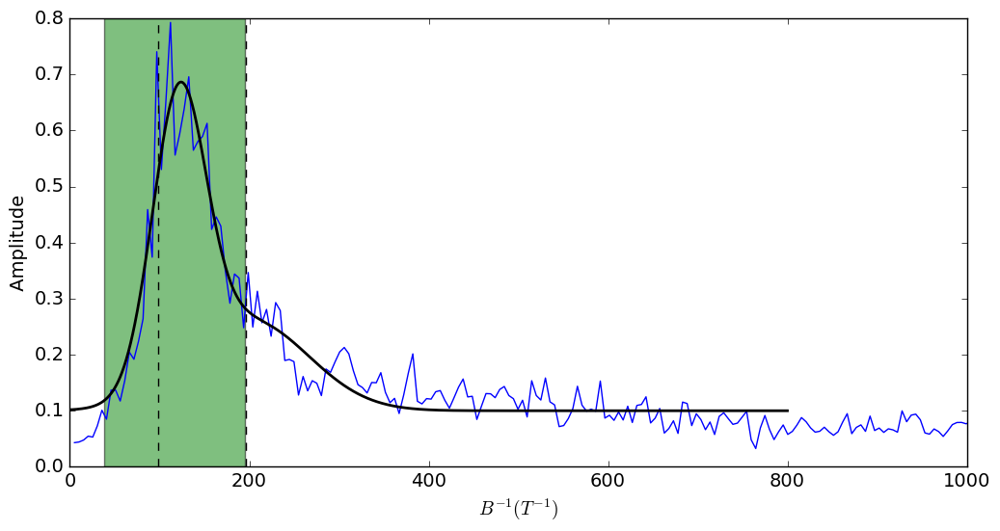

In [1962]:
inputFile16mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__9.dat'
inputFile16mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__10.dat'
inputFile16mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__11.dat'
inputFile16mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__12.dat'
inputFile16mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__13.dat'
inputFile16mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\Loop2_Bsweep_16mK__14.dat'


inputFiles16mk = [ inputFile16mk_1,inputFile16mk_2, inputFile16mk_3, inputFile16mk_4,
                  inputFile16mk_6]
T = 0.016
labels =  ['1', '2', '3', '4', '6']
window = 51
# window = 51
windows = [window, window, window, window,  window]
order = 2
orders = [ order,  order,  order,  order,   order]
plot_name = 'temperature_dependence_16mk'
#parameters = magnetoconductance(inputFiles16mk, windows, orders, labels, plot_name, plot = True)





plot_name = 'average_loop2_16mk'
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_16mk_loop2_7491 = magnetconductance_average(inputFiles16mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# 80 mk

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 131.165658812 0.947651464021
Amplitude: 0.594630458013 0.0206781770945
Sigma: 30.0748544 1.30039874008
FIT PARAMETERS FOR AAS:
f: 289.4247072 103.722852371
Amplitude: 0.019353825311 0.00991944506552
Sigma: 132.287551636 119.480423723
offset: 0.0439388615564 0.00748480053264


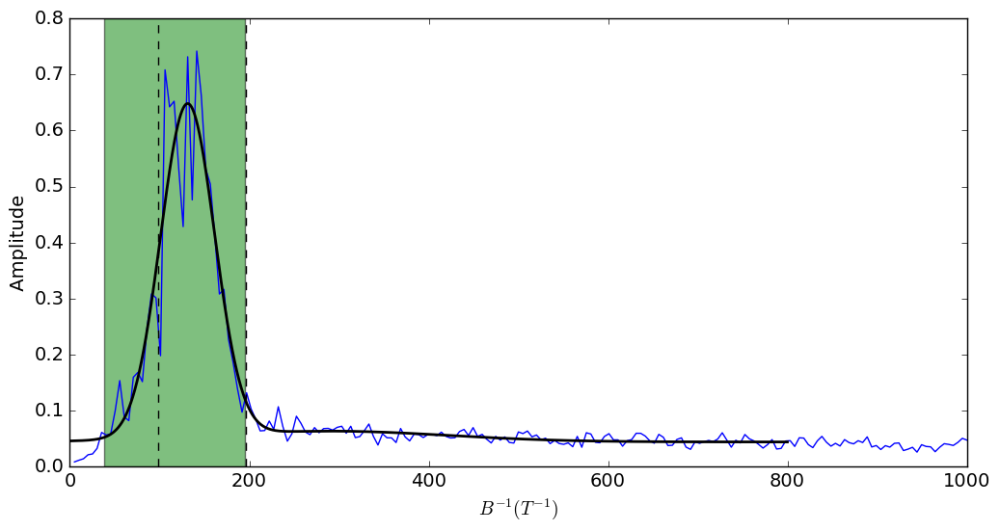

In [1964]:
inputFile80mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_1.dat'
inputFile80mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_2.dat'
inputFile80mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_3.dat'
inputFile80mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_4.dat'
inputFile80mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_5.dat'
inputFile80mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_6.dat'
inputFile80mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_7.dat'
inputFile80mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_8.dat'

inputFiles80mk = [inputFile80mk_1, inputFile80mk_2, inputFile80mk_3, inputFile80mk_4, inputFile80mk_5,
                  inputFile80mk_6, inputFile80mk_7, inputFile80mk_8]
T = 0.080
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 51
windows = [window, window,  window, window,  window,  window,  window,  window]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_80mk'
#parameters = magnetoconductance(inputFiles80mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807

average_80mk_loop2_7491 =magnetconductance_average(inputFiles80mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 145 mK

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 129.614220074 1.27224134425
Amplitude: 0.396016127212 0.0188719830414
Sigma: 31.9746889133 1.81980188703
FIT PARAMETERS FOR AAS:
f: 290.333294232 78.088637576
Amplitude: 0.0228816452507 0.00834675911143
Sigma: 121.30052149 87.5948186284
offset: 0.0436726192361 0.00589805363934


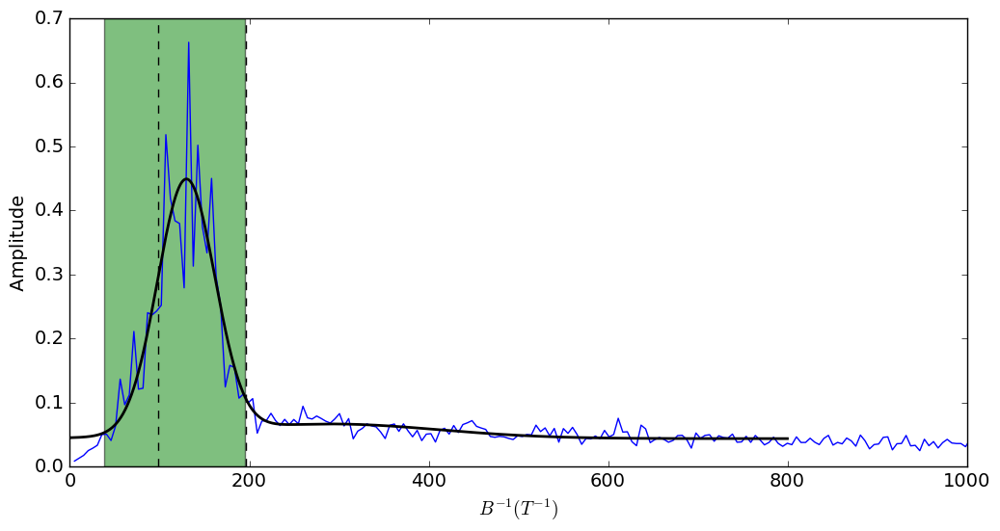

In [1965]:
inputFile145mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_1.dat'
inputFile145mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_2.dat'
inputFile145mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_3.dat'
inputFile145mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_4.dat'
inputFile145mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_5.dat'
inputFile145mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_6.dat'
inputFile145mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_7.dat'
inputFile145mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_145mk_8.dat'

inputFiles145mk = [inputFile145mk_1, inputFile145mk_2, inputFile145mk_3, inputFile145mk_4, inputFile145mk_5,
                  inputFile145mk_6, inputFile145mk_7, inputFile145mk_8]
T = 0.145
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 51
windows = [window, window,  window, window,  window,  window,  window,  window]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_145mk'
#parameters = magnetoconductance(inputFiles145mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_145mk_loop2_7491 =magnetconductance_average(inputFiles145mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 180 mK

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 128.010942594 1.05087765419
Amplitude: 0.357674874365 0.0111752163333
Sigma: 29.5450155648 1.09529078303
FIT PARAMETERS FOR AAS:
f: 417.822944025 9.56050602753
Amplitude: 0.0179771322525 0.0241694299446
Sigma: 6.18123152695 9.64503841797
offset: 0.0476266419296 0.00264396088318


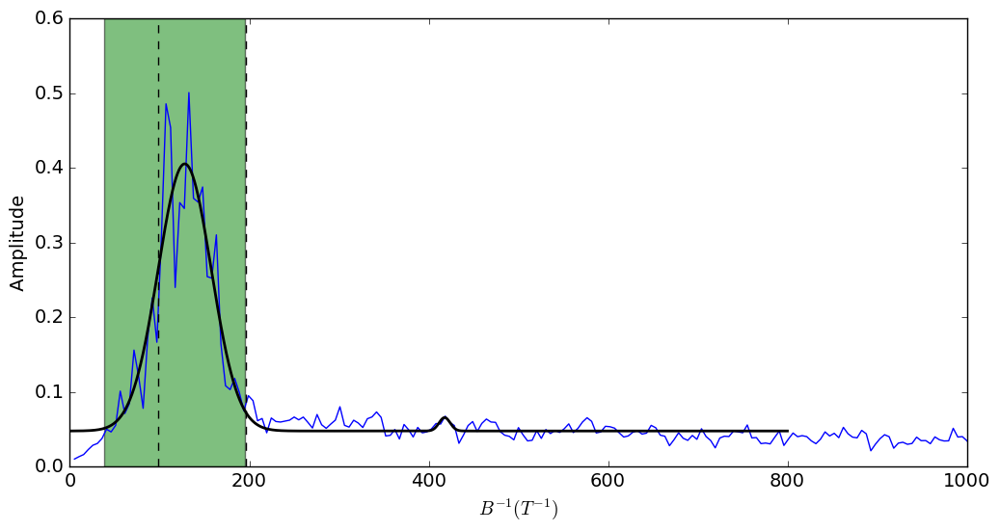

In [1966]:
inputFile180mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_1.dat'
inputFile180mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_2.dat'
inputFile180mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_3.dat'
inputFile180mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_4.dat'

inputFile180mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_6.dat'
inputFile180mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_7.dat'
inputFile180mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_180mk_8.dat'

inputFiles180mk = [inputFile180mk_1, inputFile180mk_2, inputFile180mk_3, inputFile180mk_4,
                  inputFile180mk_6, inputFile180mk_7, inputFile180mk_8]
T = 0.180
labels =  ['1', '2', '3', '4',  '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_180mk'
#parameters = magnetoconductance(inputFiles180mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_180mk_loop2_7491 = magnetconductance_average(inputFiles180mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 248 mK

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 130.718670171 1.24578209569
Amplitude: 0.234808788259 0.0110321578242
Sigma: 28.3592674062 1.64946263976
FIT PARAMETERS FOR AAS:
f: 240.91877026 36.6174179071
Amplitude: 0.0271154884149 0.00567328886254
Sigma: 113.98616187 32.255783388
offset: 0.0429244567136 0.0030347204462


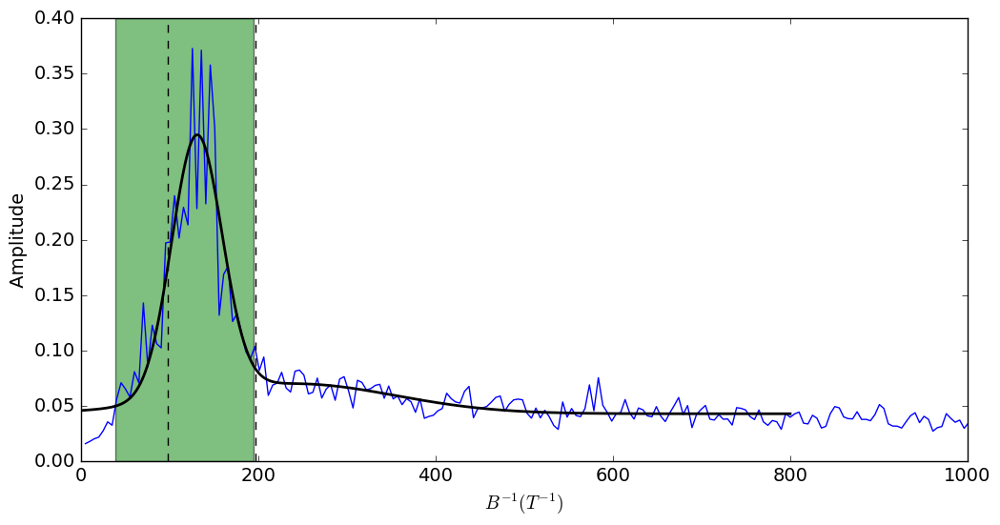

In [1967]:
inputFile248mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_1.dat'
inputFile248mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_2.dat'
inputFile248mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_3.dat'
inputFile248mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_4.dat'
inputFile248mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_5.dat'
inputFile248mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_6.dat'
inputFile248mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_7.dat'
inputFile248mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_248mk_8.dat'

inputFiles248mk = [inputFile248mk_1, inputFile248mk_2, inputFile248mk_3, inputFile248mk_4, inputFile248mk_5,
                  inputFile248mk_6, inputFile248mk_7]
T = 0.248
labels =  ['1', '2', '3', '4', '5', '6', '7']
windows = [51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_248mk'
#parameters = magnetoconductance(inputFiles248mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_248mk_loop2_7491 =magnetconductance_average(inputFiles248mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 300 mK

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 143.171343602 0.607452610433
Amplitude: 0.205637249872 0.0220246521034
Sigma: 5.18344792159 0.689747816079
FIT PARAMETERS FOR AAS:
f: 133.359034112 2.48301623002
Amplitude: 0.145576333842 0.0103245355874
Sigma: 40.6649607919 2.80169973006
offset: 0.0437815530149 0.00211778608064


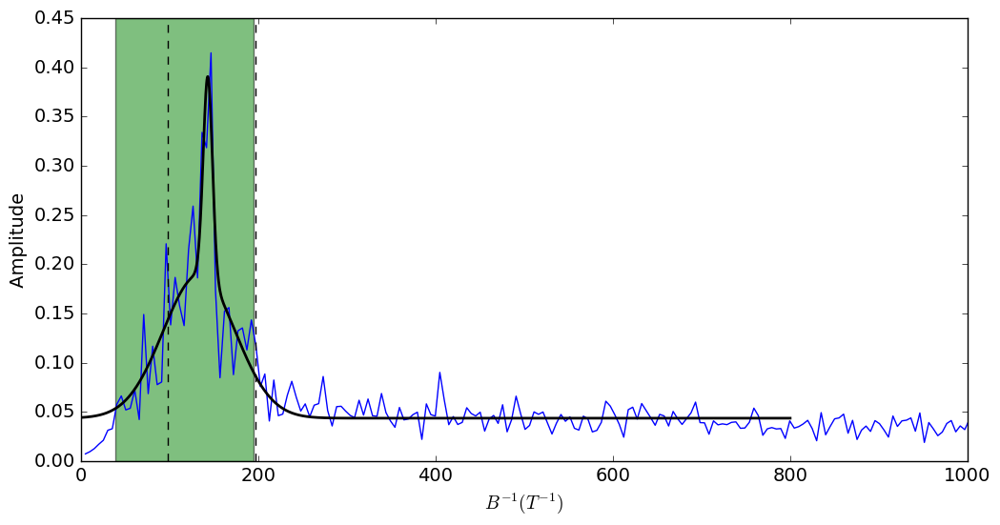

In [2004]:
inputFile300mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_1.dat'
inputFile300mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_2.dat'
inputFile300mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_3.dat'
inputFile300mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_4.dat'
inputFile300mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_5.dat'
inputFile300mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_6.dat'
inputFile300mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_7.dat'
inputFile300mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_300mk_8.dat'

inputFiles300mk = [inputFile300mk_2,  inputFile300mk_4, inputFile300mk_5,
                  inputFile300mk_6 ]
T = 0.300
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_300mk'
#parameters = magnetoconductance(inputFiles300mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_300mk_loop2_7491 =magnetconductance_average(inputFiles300mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 350 mK

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 127.636383338 1.26345253708
Amplitude: 0.181519395057 0.00966915116803
Sigma: 23.0271035497 1.55397400569
FIT PARAMETERS FOR AAS:
f: 289.51677491 41.3313156516
Amplitude: 0.0189660124581 0.00460195571093
Sigma: 137.35414432 53.3726199553
offset: 0.0394211307962 0.00365447892975


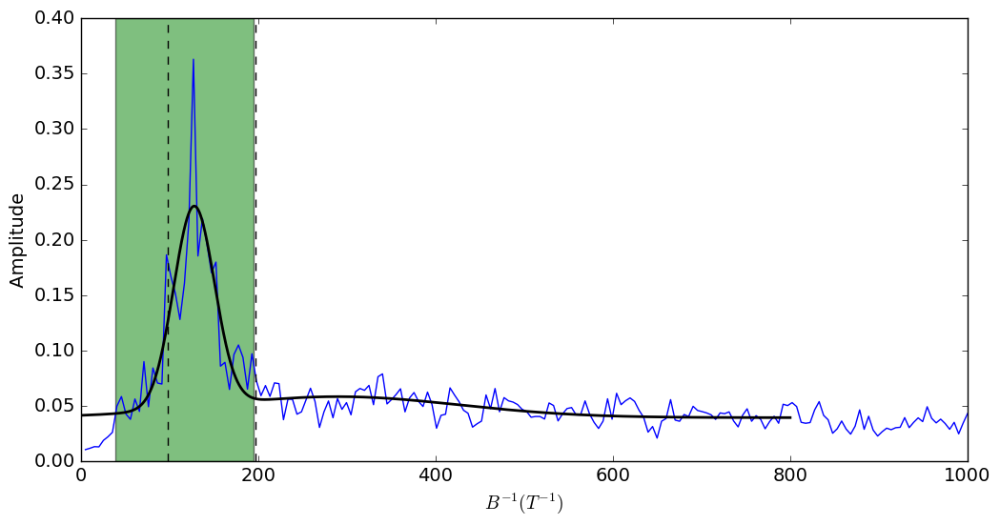

In [1990]:
inputFile350mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_1.dat'
inputFile350mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_2.dat'
inputFile350mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_3.dat'
inputFile350mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_4.dat'
inputFile350mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_5.dat'
inputFile350mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_6.dat'
inputFile350mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_7.dat'
inputFile350mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_350mk_8.dat'

inputFiles350mk = [inputFile350mk_1,  inputFile350mk_5,
                  inputFile350mk_6, inputFile350mk_7, inputFile350mk_8]
T = 0.350
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_350mk'
#parameters = magnetoconductance(inputFiles350mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_350mk_loop2_7491 =magnetconductance_average(inputFiles350mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 400 mK

C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:166: RuntimeWarning: invalid value encountered in sqrt


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 129.557627163 1.44296886872
Amplitude: 0.14881688116 0.00570620353012
Sigma: 33.4541417335 1.70698340205
FIT PARAMETERS FOR AAS:
f: 426.966708569 25.1535111994
Amplitude: 72.6819867278 nan
Sigma: 16644.5484881 nan
offset: -72.6313157326 nan


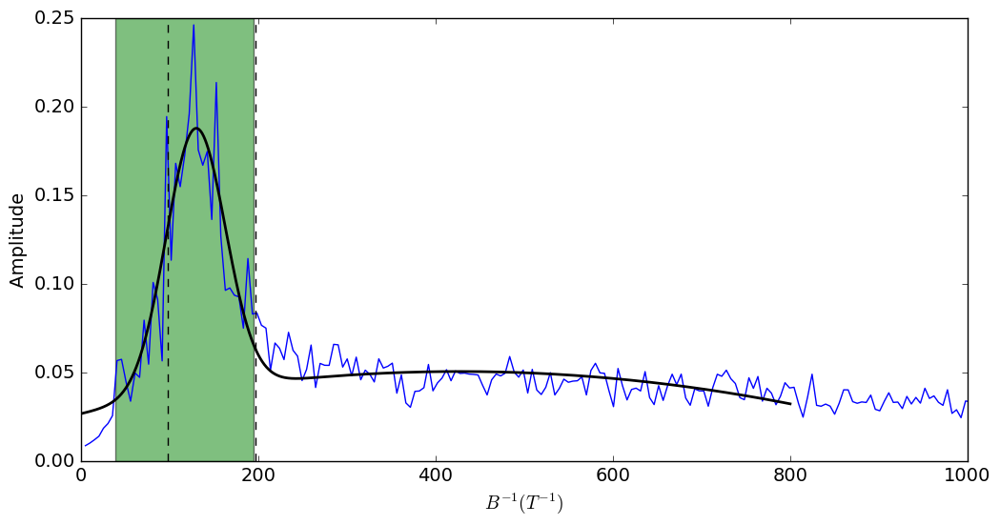

In [1971]:
inputFile400mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_1.dat'
inputFile400mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_2.dat'
inputFile400mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_3.dat'
inputFile400mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_4.dat'
inputFile400mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_5.dat'
inputFile400mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_6.dat'
inputFile400mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_7.dat'
inputFile400mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_400mk_8.dat'

inputFiles400mk = [inputFile400mk_1, inputFile400mk_2, inputFile400mk_3, inputFile400mk_4, inputFile400mk_5,
                  inputFile400mk_6, inputFile400mk_7, inputFile400mk_8]
T = 0.400
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_400mk'
#parameters = magnetoconductance(inputFiles400mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807
average_400mk_loop2_7491 =magnetconductance_average(inputFiles400mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 450 mK

C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:166: RuntimeWarning: invalid value encountered in sqrt


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 132.86468652 1.55489901027
Amplitude: 0.136022739431 0.00558070763158
Sigma: 33.6011925085 1.81088998603
FIT PARAMETERS FOR AAS:
f: 431.602738939 17.200370029
Amplitude: 106.465432107 nan
Sigma: 16918.5748285 nan
offset: -106.412883801 nan


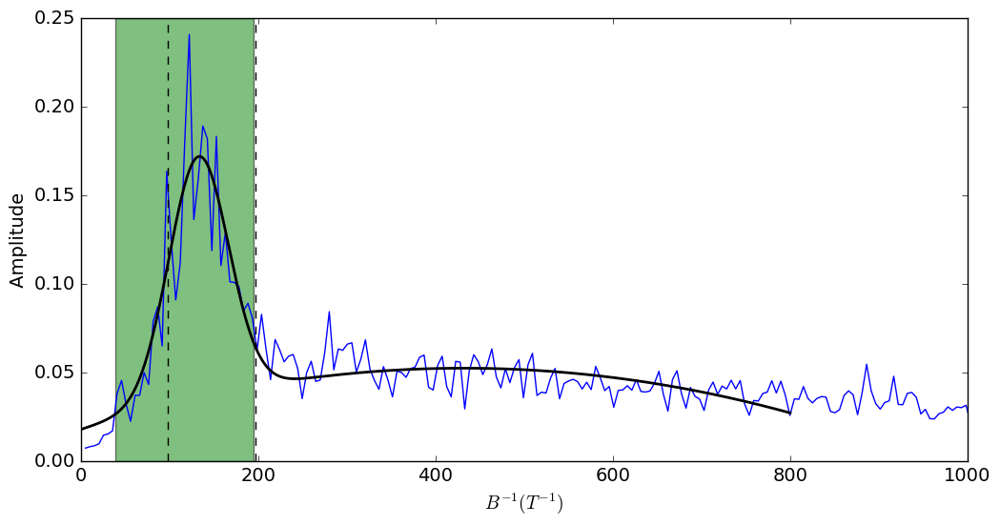

In [1972]:
inputFile450mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_1.dat'
inputFile450mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_2.dat'
inputFile450mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_3.dat'
inputFile450mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_4.dat'
inputFile450mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_5.dat'
inputFile450mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_6.dat'
inputFile450mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_7.dat'
inputFile450mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_450mk_8.dat'

inputFiles450mk = [inputFile450mk_1, inputFile450mk_2, inputFile450mk_3, inputFile450mk_4, inputFile450mk_5,
                  inputFile450mk_6, inputFile450mk_7, inputFile450mk_8]
T = 0.450
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_450mk'
#parameters = magnetoconductance(inputFiles450mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807 
average_450mk_loop2_7491 =magnetconductance_average(inputFiles450mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 500 mK

C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:166: RuntimeWarning: invalid value encountered in sqrt


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 131.962362738 1.49855177183
Amplitude: 0.124208675609 0.00496483988021
Sigma: 33.6391097865 1.76116147636
FIT PARAMETERS FOR AAS:
f: 437.402963955 16.277807067
Amplitude: 131.064016791 nan
Sigma: 19235.2217149 nan
offset: -131.013389518 nan


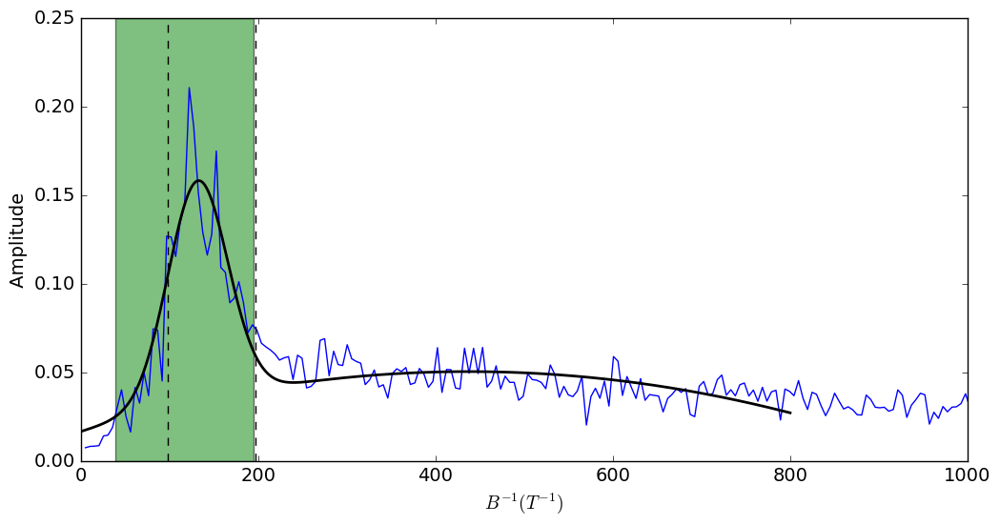

In [1973]:
inputFile500mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_1.dat'
inputFile500mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_2.dat'
inputFile500mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_3.dat'
inputFile500mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_4.dat'
inputFile500mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_5.dat'
inputFile500mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_6.dat'
inputFile500mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_7.dat'
inputFile500mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_500mk_8.dat'

inputFiles500mk = [  inputFile500mk_1, inputFile500mk_2, inputFile500mk_3, inputFile500mk_5,
                  inputFile500mk_6, inputFile500mk_7, inputFile500mk_8]
T = 0.5
labels =  ['1', '2', '3',  '5', '6', '7', '8']
windows = [51, 51, 51,  51, 51, 51, 51]

orders = [2, 2, 2, 2,  2, 2, 2]
plot_name = 'temperature_dependence_500mk'
#parameters = magnetoconductance(inputFiles500mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807 

average_500mk_loop2_7491 =magnetconductance_average(inputFiles500mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 550 mK

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 131.291440051 1.43765164328
Amplitude: 0.111302673282 0.00554245645989
Sigma: 26.9474706333 1.6575299622
FIT PARAMETERS FOR AAS:
f: 308.022050392 20.1087240355
Amplitude: 0.0190716044695 0.00287038275133
Sigma: 100.794920057 25.5350787651
offset: 0.037310532625 0.00168447652113


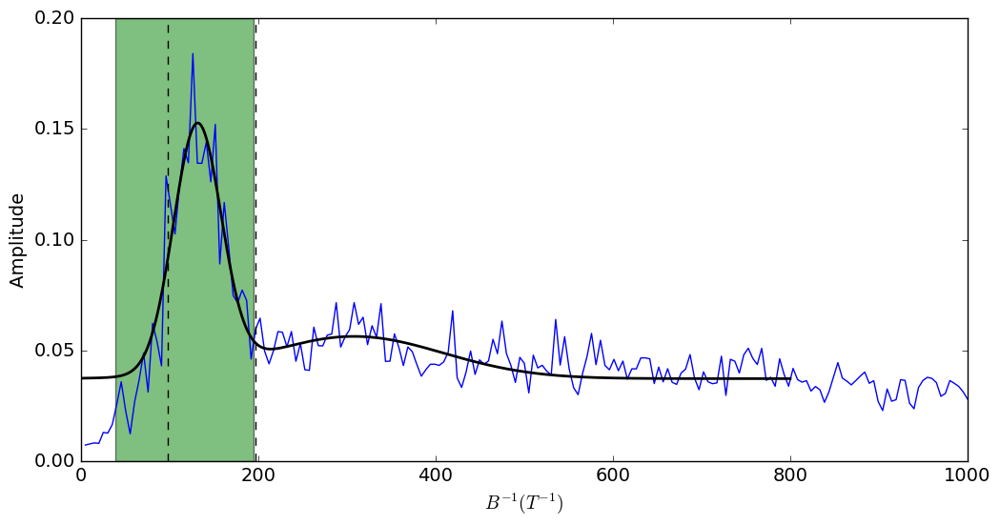

In [1974]:
inputFile550mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_1.dat'
inputFile550mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_2.dat'
inputFile550mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_3.dat'
inputFile550mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_4.dat'
inputFile550mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_5.dat'
inputFile550mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_6.dat'
inputFile550mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_7.dat'
inputFile550mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_550mk_8.dat'

inputFiles550mk = [inputFile550mk_1, inputFile550mk_2, inputFile550mk_3, inputFile550mk_4, inputFile550mk_5,
                  inputFile550mk_6, inputFile550mk_7]
T = 0.550
labels =  ['1', '2', '3', '4', '5', '6', '7']
windows = [51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_550mk'

A_min = 0.160
A_center = 0.406
A_max = 0.807 

#parameters = magnetoconductance(inputFiles550mk, windows, orders, labels, plot_name, plot = True)
average_550mk_loop2_7491 =magnetconductance_average(inputFiles550mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 600 mK

C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:166: RuntimeWarning: invalid value encountered in sqrt


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 130.130069975 1.6642227446
Amplitude: 0.0986797172725 0.00458093222513
Sigma: 31.5478785132 1.88246838267
FIT PARAMETERS FOR AAS:
f: 417.997142811 13.2979460371
Amplitude: 130.752127463 nan
Sigma: 18515.7237457 nan
offset: -130.698741233 nan


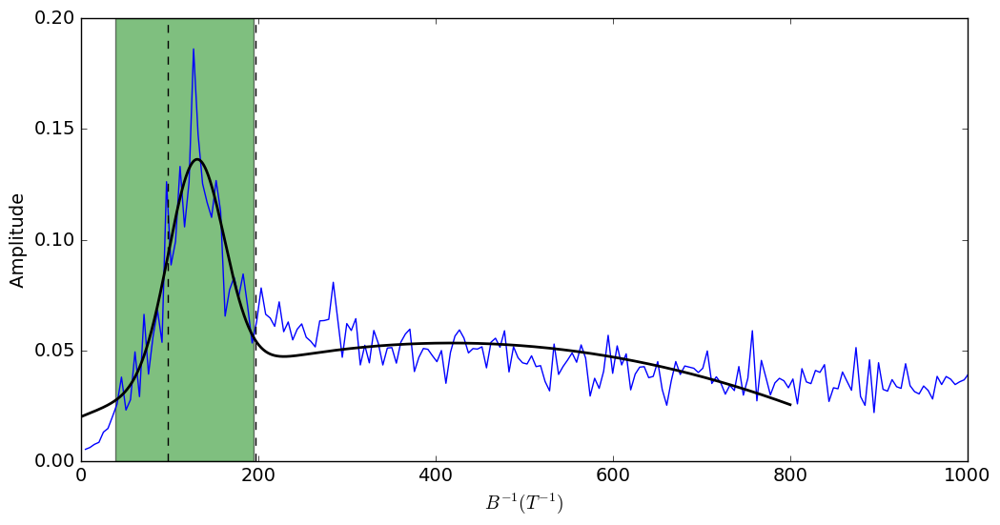

In [1975]:
inputFile600mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_1.dat'
inputFile600mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_2.dat'
inputFile600mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_3.dat'
inputFile600mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_4.dat'
inputFile600mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_5.dat'
inputFile600mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_6.dat'
inputFile600mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_7.dat'
inputFile600mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_600mk_8.dat'

inputFiles600mk = [inputFile600mk_2, inputFile600mk_3, inputFile600mk_4, inputFile600mk_5,
                  inputFile600mk_6, inputFile600mk_7, inputFile600mk_8]
T = 0.600
labels =  ['1', '2', '3', '4', '5', '6', '7']
window = 51
windows = [window, window, window, window, window, window, window]
orders = [2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_600mk'
#parameters = magnetoconductance(inputFiles600mk, windows, orders, labels, plot_name, plot = True)

A_min = 0.160
A_center = 0.406
A_max = 0.807 
average_600mk_loop2_7491 =magnetconductance_average(inputFiles600mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 650 mK

C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:166: RuntimeWarning: invalid value encountered in sqrt


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 133.554641265 1.44867541588
Amplitude: 0.0948591341366 0.00372972373516
Sigma: 32.8680905975 1.68787232053
FIT PARAMETERS FOR AAS:
f: 457.414746663 11.9711103166
Amplitude: 202.786212741 nan
Sigma: 23572.3469006 nan
offset: -202.737153253 nan


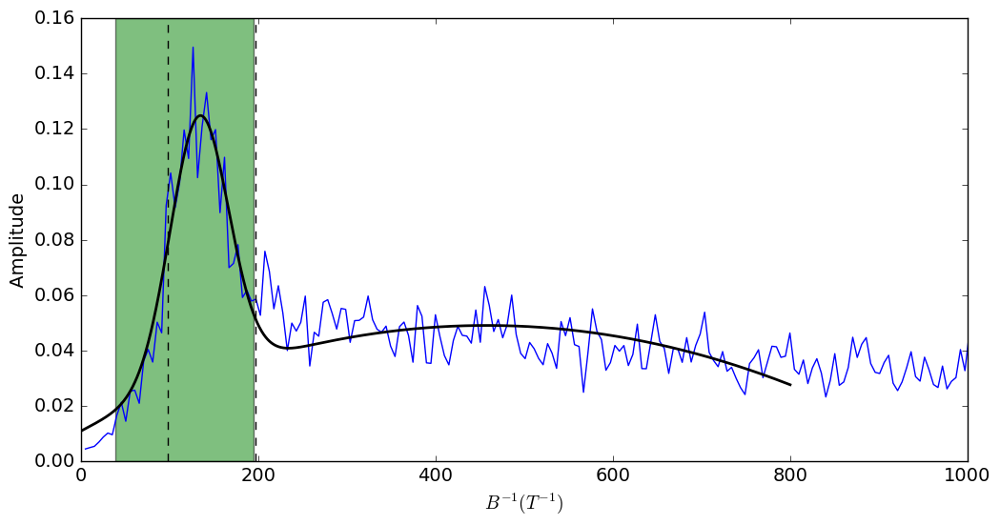

In [1976]:
inputFile650mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_1.dat'
inputFile650mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_2.dat'
inputFile650mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_3.dat'
inputFile650mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_4.dat'
inputFile650mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_5.dat'
inputFile650mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_6.dat'
inputFile650mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_7.dat'
inputFile650mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_650mk_8.dat'

inputFiles650mk = [inputFile650mk_1, inputFile650mk_2, inputFile650mk_3, inputFile650mk_4, inputFile650mk_5,
                  inputFile650mk_6, inputFile650mk_7, inputFile650mk_8]
T = 0.650
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_650mk'
#parameters = magnetoconductance(inputFiles650mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807 
average_650mk_loop2_7491 =magnetconductance_average(inputFiles650mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# T = 700 mK

C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:166: RuntimeWarning: invalid value encountered in sqrt


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 133.762932596 1.38555860806
Amplitude: 0.10145315489 0.00419397300132
Sigma: 29.9157672869 1.57630148306
FIT PARAMETERS FOR AAS:
f: 444.688072385 11.7370286944
Amplitude: 311.965971507 nan
Sigma: -28273.2879103 nan
offset: -311.915700611 nan


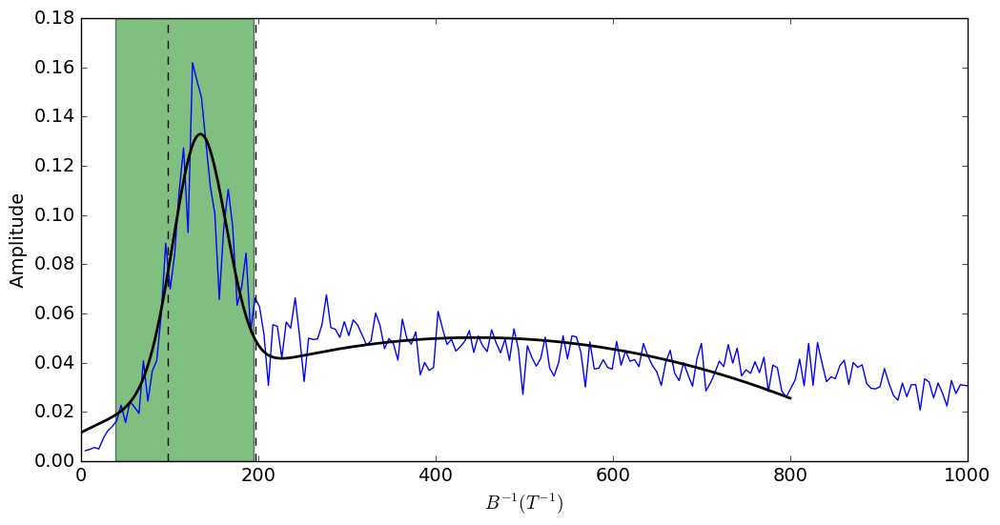

In [1977]:
inputFile700mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_1.dat'
inputFile700mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_2.dat'
inputFile700mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_3.dat'
inputFile700mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_4.dat'
inputFile700mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_5.dat'
inputFile700mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_6.dat'
inputFile700mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_7.dat'
inputFile700mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_700mk_8.dat'

inputFiles700mk = [inputFile700mk_1, inputFile700mk_2, inputFile700mk_3, inputFile700mk_4, inputFile700mk_5,
                  inputFile700mk_6, inputFile700mk_7, inputFile700mk_8]
T = 0.700
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
windows = [51, 51, 51, 51, 51, 51, 51, 51]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_700mk'
#parameters = magnetoconductance(inputFiles700mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807 
average_700mk_loop2_7491 =magnetconductance_average(inputFiles700mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

# Temperature dependence summary - loop 2 7491

In [2011]:
Ts = [0.016, 0.080, 0.145, 0.180, 0.248, 0.300, 0.350, 0.400, 0.450, 0.500, 0.550, 0.600, 0.650, 0.700]


freq_all_average_16mk, fft_all_average_16mk, A1_16mk, A2_16mk, mean1_16mk, mean2_16mk, sigma1_16mk, sigma2_16mk, offset_16mk, A1err_16mk, A2err_16mk = average_16mk_loop2_7491
freq_all_average_80mk, fft_all_average_80mk, A1_80mk, A2_80mk, mean1_80mk, mean2_80mk, sigma1_80mk, sigma2_80mk,  offset_80mk, A1err_80mk, A2err_80mk = average_80mk_loop2_7491
freq_all_average_145mk, fft_all_average_145mk, A1_145mk, A2_145mk, mean1_145mk, mean2_145mk, sigma1_145mk, sigma2_145mk,  offset_145mk,A1err_145mk, A2err_145mk = average_145mk_loop2_7491
freq_all_average_180mk, fft_all_average_180mk, A1_180mk, A2_180mk, mean1_180mk, mean2_180mk, sigma1_180mk, sigma2_180mk,  offset_180mk,A1err_180mk, A2err_180mk = average_180mk_loop2_7491
freq_all_average_248mk, fft_all_average_248mk, A1_248mk, A2_248mk, mean1_248mk, mean2_248mk, sigma1_248mk, sigma2_248mk,  offset_248mk,A1err_248mk, A2err_248mk = average_248mk_loop2_7491
freq_all_average_300mk, fft_all_average_300mk, A1_300mk, A2_300mk, mean1_300mk, mean2_300mk, sigma1_300mk, sigma2_300mk,  offset_300mk,A1err_300mk, A2err_300mk = average_300mk_loop2_7491
freq_all_average_350mk, fft_all_average_350mk, A1_350mk, A2_350mk, mean1_350mk, mean2_350mk, sigma1_350mk, sigma2_350mk,  offset_350mk,A1err_350mk, A2err_350mk = average_350mk_loop2_7491
freq_all_average_400mk, fft_all_average_400mk, A1_400mk, A2_400mk, mean1_400mk, mean2_400mk, sigma1_400mk, sigma2_400mk,  offset_400mk,A1err_400mk, A2err_400mk = average_400mk_loop2_7491
freq_all_average_450mk, fft_all_average_450mk, A1_450mk, A2_450mk, mean1_450mk, mean2_450mk, sigma1_450mk, sigma2_450mk,  offset_450mk,A1err_450mk, A2err_450mk = average_450mk_loop2_7491
freq_all_average_500mk, fft_all_average_500mk, A1_500mk, A2_500mk, mean1_500mk, mean2_500mk, sigma1_500mk, sigma2_500mk,  offset_500mk,A1err_500mk, A2err_500mk = average_500mk_loop2_7491
freq_all_average_550mk, fft_all_average_550mk, A1_550mk, A2_550mk, mean1_550mk, mean2_550mk, sigma1_550mk, sigma2_550mk,  offset_550mk,A1err_550mk, A2err_550mk = average_550mk_loop2_7491
freq_all_average_600mk, fft_all_average_600mk, A1_600mk, A2_600mk, mean1_600mk, mean2_600mk, sigma1_600mk, sigma2_600mk,  offset_600mk,A1err_600mk, A2err_600mk = average_600mk_loop2_7491
freq_all_average_650mk, fft_all_average_650mk, A1_650mk, A2_650mk, mean1_650mk, mean2_650mk, sigma1_650mk, sigma2_650mk,  offset_650mk,A1err_650mk, A2err_650mk = average_650mk_loop2_7491
freq_all_average_700mk, fft_all_average_700mk, A1_700mk, A2_700mk, mean1_700mk, mean2_700mk, sigma1_700mk, sigma2_700mk,  offset_700mk,A1err_700mk, A2err_700mk = average_700mk_loop2_7491

freqs = [freq_all_average_16mk,freq_all_average_80mk, freq_all_average_145mk, freq_all_average_180mk, freq_all_average_248mk, freq_all_average_300mk,
        freq_all_average_350mk, freq_all_average_400mk, freq_all_average_450mk, freq_all_average_500mk, freq_all_average_550mk,
        freq_all_average_550mk, freq_all_average_600mk, freq_all_average_650mk, freq_all_average_700mk]

ffts = [fft_all_average_16mk, fft_all_average_80mk, fft_all_average_145mk, fft_all_average_180mk, fft_all_average_248mk, fft_all_average_300mk,
        fft_all_average_350mk, fft_all_average_400mk, fft_all_average_450mk, fft_all_average_500mk, fft_all_average_550mk,
        fft_all_average_550mk, fft_all_average_600mk, fft_all_average_650mk, fft_all_average_700mk]

A1s = [A1_16mk, A1_80mk, A1_145mk, A1_180mk, A1_248mk, A1_300mk, A1_350mk, A1_400mk, A1_450mk, A1_500mk, A1_550mk, A1_600mk, A1_650mk, A1_700mk]
A2s = [A2_16mk, A2_80mk, A2_145mk, A2_180mk, A2_248mk, A2_300mk, A2_350mk, A2_400mk, A2_450mk, A2_500mk, A2_550mk, A2_600mk, A2_650mk, A2_700mk]
mean1s = [mean1_16mk,mean1_80mk, mean1_145mk, mean1_180mk, mean1_248mk, mean1_300mk, mean1_350mk, mean1_400mk, mean1_450mk, mean1_500mk, mean1_550mk, mean1_600mk, mean1_650mk, mean1_700mk]
mean2s = [mean2_16mk,mean2_80mk, mean2_145mk, mean2_180mk, mean2_248mk, mean2_300mk, mean2_350mk, mean2_400mk, mean2_450mk, mean2_500mk, mean2_550mk, mean2_600mk, mean2_650mk, mean2_700mk]
sigma1s = [sigma1_16mk,sigma1_80mk, sigma1_145mk, sigma1_180mk, sigma1_248mk, sigma1_300mk, sigma1_350mk, sigma1_400mk, sigma1_450mk, sigma1_500mk, sigma1_550mk, sigma1_600mk, sigma1_650mk, sigma1_700mk]
sigma2s = [sigma2_16mk, sigma2_80mk, sigma2_145mk, sigma2_180mk, sigma2_248mk, sigma2_300mk, sigma2_350mk, sigma2_400mk, sigma2_450mk, sigma2_500mk, sigma2_550mk, sigma2_600mk, sigma2_650mk, sigma2_700mk]
offsets = [offset_16mk, offset_80mk, offset_145mk, offset_180mk, offset_248mk, offset_300mk, offset_350mk, offset_400mk, offset_450mk, offset_500mk, offset_550mk, offset_600mk, offset_650mk, offset_700mk]
A1errs = [A1err_16mk, A1err_80mk, A1err_145mk, A1err_180mk, A1err_248mk, A1err_300mk, A1err_350mk, A1err_400mk, A1err_450mk, A1err_500mk, A1err_550mk, A1err_600mk, A1err_650mk, A1err_700mk]
A2errs = [A2err_16mk, A2err_80mk, A2err_145mk, A2err_180mk, A2err_248mk, A2err_300mk, A2err_350mk, A2err_400mk, A2err_450mk, A2err_500mk, A2err_550mk, A2err_600mk, A2err_650mk, A2err_700mk]

T_fit = np.linspace(0.01, 2, 1000) 

#decay fit
A =1
alpha = 1
A_AB, alpha_AB, A_err_AB, alpha_err_AB = fitting_decay(Ts, A1s, A1errs, A, alpha)
fit_AB = decay(T_fit, A_AB, alpha_AB)

#A = 1
#alpha = 1

#A_AAS, alpha_AAS, A_err_AAS, alpha_err_AAS = fitting_decay(Ts, A2s, A2errs, A, alpha)
#fit_AAS = decay(T_fit, A_AAS, alpha_AAS)


#defining fitted function to plot in the big one


fit_16mk = gaus2peaks(freq_all_average_16mk, A1_16mk, A2_16mk, mean1_16mk, mean2_16mk, sigma1_16mk, sigma2_16mk, offset_16mk)
fit_80mk = gaus2peaks(freq_all_average_80mk, A1_80mk, A2_80mk, mean1_80mk, mean2_80mk, sigma1_80mk, sigma2_80mk, offset_80mk)
fit_145mk = gaus2peaks(freq_all_average_145mk, A1_145mk, A2_145mk, mean1_145mk, mean2_145mk, sigma1_145mk, sigma2_145mk, offset_145mk)
fit_180mk = gaus2peaks(freq_all_average_180mk, A1_180mk, A2_180mk, mean1_180mk, mean2_180mk, sigma1_180mk, sigma2_180mk, offset_180mk)
fit_248mk = gaus2peaks(freq_all_average_248mk, A1_248mk, A2_248mk, mean1_248mk, mean2_248mk, sigma1_248mk, sigma2_248mk, offset_248mk)
fit_300mk = gaus2peaks(freq_all_average_300mk, A1_300mk, A2_300mk, mean1_300mk, mean2_300mk, sigma1_300mk, sigma2_300mk, offset_300mk)
fit_350mk = gaus2peaks(freq_all_average_350mk, A1_350mk, A2_350mk, mean1_350mk, mean2_350mk, sigma1_350mk, sigma2_350mk, offset_350mk)
fit_400mk = gaus2peaks(freq_all_average_400mk, A1_400mk, A2_400mk, mean1_400mk, mean2_400mk, sigma1_400mk, sigma2_400mk, offset_400mk)
fit_450mk = gaus2peaks(freq_all_average_450mk, A1_450mk, A2_450mk, mean1_450mk, mean2_450mk, sigma1_450mk, sigma2_450mk, offset_450mk)
fit_500mk = gaus2peaks(freq_all_average_500mk, A1_500mk, A2_500mk, mean1_500mk, mean2_500mk, sigma1_500mk, sigma2_500mk, offset_500mk)
fit_550mk = gaus2peaks(freq_all_average_550mk, A1_550mk, A2_550mk, mean1_550mk, mean2_550mk, sigma1_550mk, sigma2_550mk, offset_550mk)
fit_600mk = gaus2peaks(freq_all_average_600mk, A1_600mk, A2_600mk, mean1_600mk, mean2_600mk, sigma1_600mk, sigma2_600mk, offset_600mk)
fit_650mk = gaus2peaks(freq_all_average_650mk, A1_650mk, A2_650mk, mean1_650mk, mean2_650mk, sigma1_650mk, sigma2_650mk, offset_650mk)
fit_700mk = gaus2peaks(freq_all_average_700mk, A1_700mk, A2_700mk, mean1_700mk, mean2_700mk, sigma1_700mk, sigma2_700mk, offset_700mk)



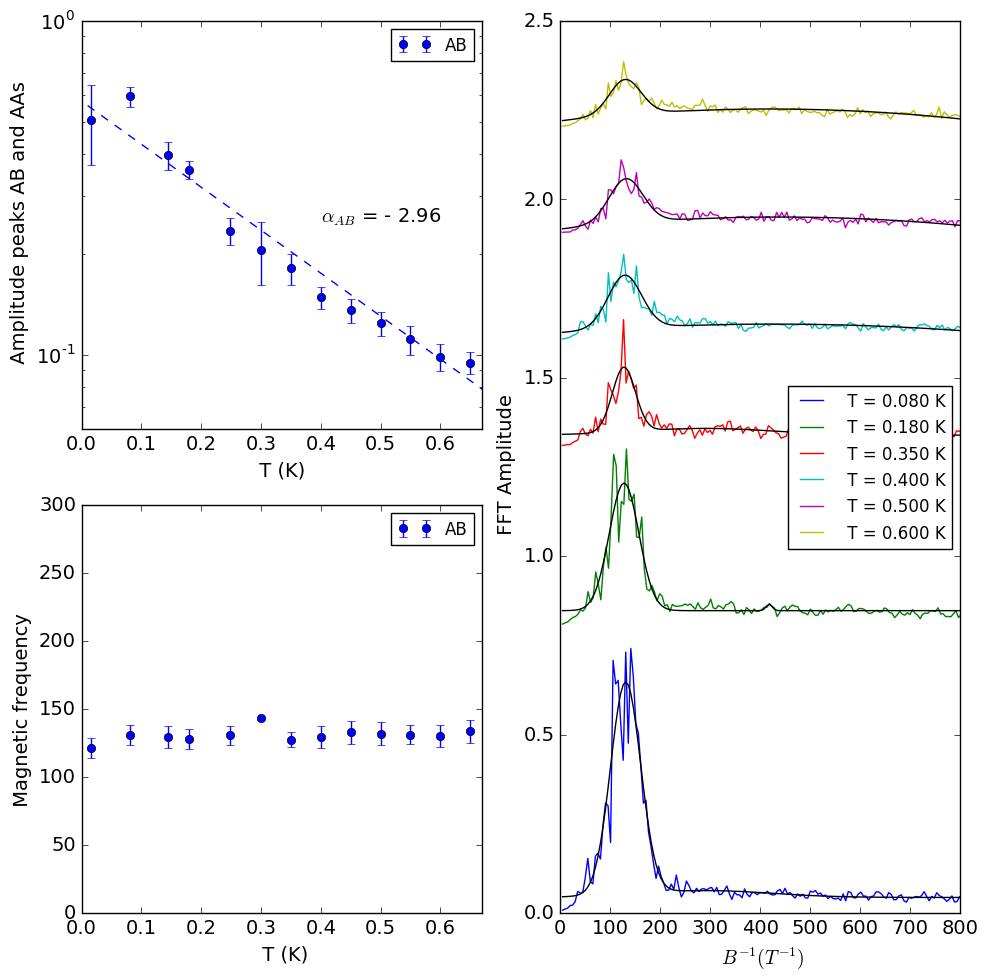

In [2023]:
fig = plt.figure(figsize=(10,10))
ax1 = plt.subplot2grid((2,2), (0,0), colspan=1)
ax2 = plt.subplot2grid((2,2), (1,0), colspan=1)
ax3 = plt.subplot2grid((2,2), (0,1), rowspan=2)        
    
ax1.set_xlabel( ' T (K) ', fontsize=axes_font)
ax1.set_ylabel(' Amplitude peaks AB and AAs', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_ylim(0.06,1)
ax1.set_xlim(0, 0.67)
ax1.text( 0.4 , 0.25, '$\\alpha_{AB}$ = - ' + str(np.round(alpha_AB,2)), fontsize = 14 )
#ax1.text( 0.4 , 0.2, '$\\alpha_{AAS}$ = - ' + str(np.round(alpha_AAS,2)), fontsize = 14 )
ax1.set_yscale('log')
        

                
ax2.set_xlabel( ' T (K)', fontsize=axes_font)
ax2.set_ylabel(' Magnetic frequency ', fontsize=axes_font)
ax2.tick_params(axis='both', which='major', labelsize=tick_font)
ax2.get_xaxis().get_major_formatter().set_useOffset(False)
ax2.set_ylim(0,300)
ax2.set_xlim(0, 0.67)

#ax2.set_xlim(0, 6)

ax3.set_xlabel( ' $ B ^{-1} ( T^{-1}) $', fontsize=axes_font)
ax3.set_ylabel(' FFT Amplitude', size=axes_font)
ax3.tick_params(axis='both', which='major', labelsize=tick_font)
ax3.get_xaxis().get_major_formatter().set_useOffset(False)
#ax3.set_ylim(0,3.3)
ax3.set_xlim(0, 800)



ax1.errorbar(Ts, A1s, yerr = 2*np.array(A1errs), fmt = 'o', label = 'AB')
ax1.plot(T_fit, fit_AB, linestyle = '--', color = 'b')
#ax1.plot(T_fit, fit_AAS, linestyle = '--', color = 'green')
#ax1.errorbar(Ts, A2s, yerr = 2*np.array(A2errs), fmt = 'o', label = 'AAS')

#ax1.plot(T_fit, fit_AB_power, linestyle = '--', color = 'r')

ax2.errorbar(Ts, mean1s, yerr = np.array(sigma1s)*0.25, fmt = 'o', label = 'AB')
#ax2.errorbar(Ts, mean2s, yerr = np.array(sigma2s)*0.5, fmt = 'o', label = 'AAS')
#ax2.axhline(y = np.mean(mean1s) * 2, linestyle = '--', color = 'green')  

#for index in range(0, len(Ts)):
#    ax3.plot(freqs[index], ffts[index] + index , label = str(Ts[index]) + ' mK')

#ax3.plot(freqs[0], ffts[0], label = str(Ts[0]) + ' mK')


ax3.plot(freq_all_average_80mk, fft_all_average_80mk , label = ' T = 0.080 K')
ax3.plot(freq_all_average_80mk, fit_80mk , color = 'black')


ax3.plot(freq_all_average_180mk, fft_all_average_180mk + 0.8, label = ' T = 0.180 K')
ax3.plot(freq_all_average_180mk, fit_180mk + 0.8, color = 'black')

ax3.plot(freq_all_average_350mk, fft_all_average_350mk + 1.3, label = ' T = 0.350 K')
ax3.plot(freq_all_average_350mk, fit_350mk +1.3, color = 'black')

ax3.plot(freq_all_average_400mk, fft_all_average_400mk + 1.6, label = ' T = 0.400 K')
ax3.plot(freq_all_average_400mk, fit_400mk +1.6, color = 'black')

ax3.plot(freq_all_average_500mk, fft_all_average_500mk + 1.9, label = ' T = 0.500 K')
ax3.plot(freq_all_average_500mk, fit_500mk + 1.9, color = 'black')

ax3.plot(freq_all_average_600mk, fft_all_average_600mk + 2.2, label = ' T = 0.600 K')
ax3.plot(freq_all_average_600mk, fit_600mk + 2.2, color = 'black')

ax1.legend(loc=0)
ax2.legend(loc=0)
ax3.legend(loc=5)

fig.subplots_adjust(hspace=sub_hspace-7)    
fig.subplots_adjust(wspace=sub_wspace)   
fig.tight_layout() 

fig.savefig('loop2_7491.eps', format='eps',transparent = False)
fig.savefig('loop2_7491.png', format='png',transparent = False)


# Coherence length evaluation - loop 2

In [1983]:
L = 2.82
l_phi = 0.5*L/(alpha_AB * 0.08)
print l_phi

6.03691396052


# Loop 2 - Gates dependence

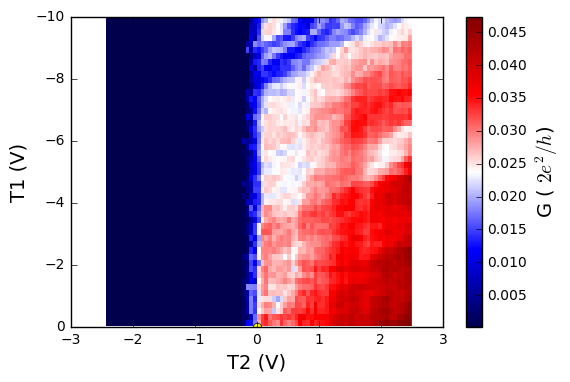

In [236]:

inputFileT2_vs_T1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_T2_vs_T1_1.dat'
label_x = 'T2 (V)'
conversion_x = 0.005
label_y = 'T1 (V)'
conversion_y = 0.005

conversion_z = 1

column = 4
plot_name = 'T1_vs_T2'
points_list =[(0,0)]
colorplot_data(inputFileT2_vs_T1, label_x, conversion_x, label_y, conversion_y,  conversion_z, column, plot_name, points_list)

T2 = 25 , T1 = -446.35


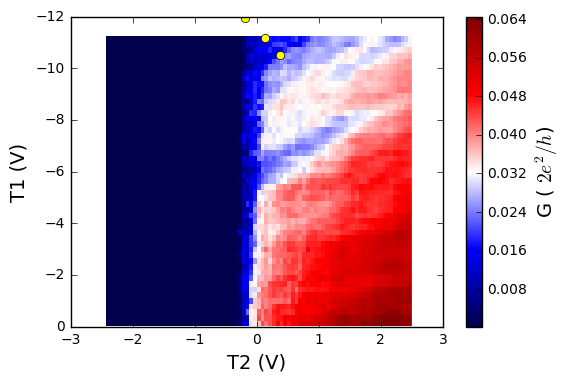

In [237]:
inputFileT2_vs_T1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_T2_vs_T1_2.dat'
label_x = 'T2 (V)'
conversion_x = 0.005
label_y = 'T1 (V)'
conversion_y = 0.025
label_z = 'G ( $ 2e^2/h $)'
conversion_z = 1
column = 4
plot_name = 'T1_vs_T2'
points_list =[(0,0)]

T2 = 25

m = 0.51
q = -459.1
T1 = m*T2 + q

print 'T2 =', T2, ', T1 =', T1

points_list =[(75, -420), (-37, -478), (T2, T1 )]

# m = Deltax/Delta y 0.51

colorplot_data(inputFileT2_vs_T1, label_x, conversion_x, label_y, conversion_y,  conversion_z, column, plot_name, points_list)

T2 = 25 , T1 = -446.35


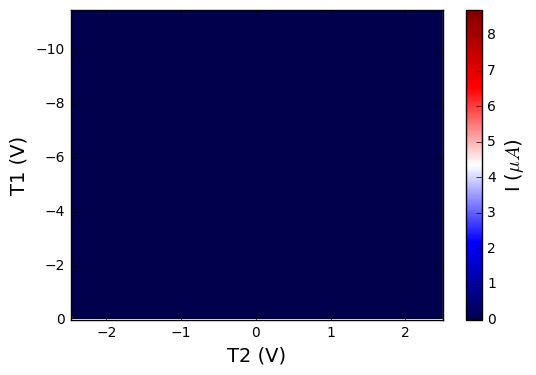

In [238]:
inputFileT2_vs_T1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_T1_vs_T2_2.dat'
label_x = 'T2 (V)'
conversion_x = 0.005
label_y = 'T1 (V)'
conversion_y = 0.025
label_z = 'G ( $ 2e^2/h $)'
conversion_z = 1
column = 3
plot_name = 'T1_vs_T2'
points_list =[(0,0)]

T2 = 25

m = 0.51
q = -459.1
T1 = m*T2 + q

print 'T2 =', T2, ', T1 =', T1
points_list =[]
#points_list =[(75, -420), (-37, -478), (T2, T1 )]

# m = Deltax/Delta y 0.51

colorplot_data(inputFileT2_vs_T1, label_x, conversion_x, label_y, conversion_y,  conversion_z, column, plot_name, points_list)



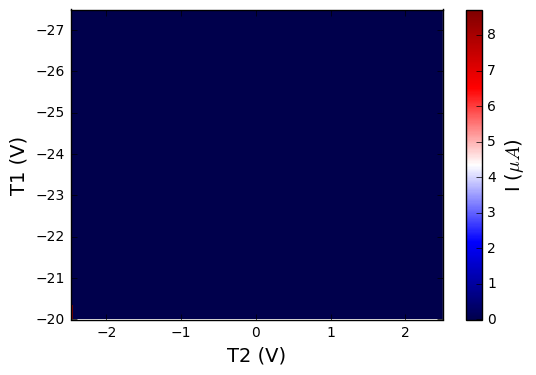

In [239]:
inputFileT2_vs_T1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_PG_sweep_11.dat'
label_x = 'T2 (V)'
conversion_x = 0.005
label_y = 'T1 (V)'
conversion_y = 0.025
label_z = 'G ( $ 2e^2/h $)'
conversion_z = 1
column = 3
plot_name = 'T1_vs_T2_BG-10V'
points_list =[]



colorplot_data(inputFileT2_vs_T1, label_x, conversion_x, label_y, conversion_y,  conversion_z, column, plot_name, points_list)


# Loop 2 - Field sweep in blockade

# RG = -1700 mV (x5)

In [69]:

inputFiles_bias1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Vbias_sweep_1.dat'
inputFiles_bias2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_4.dat'



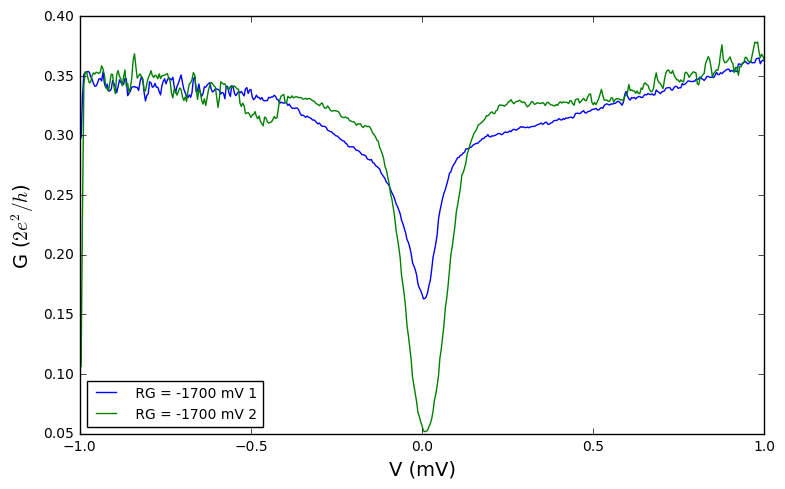

In [232]:
inputFiles_bias = [inputFiles_bias1 , inputFiles_bias2]
label_x = 'V (mV)'
conversions_x = [1e-3, 1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [12906.0, 12906.0]
labels = [' RG = -1700 mV 1', ' RG = -1700 mV 2']
column = 3
plot_name = 'Vbias_RG-1700'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

In [75]:
inputFile_blockade1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_1.dat'
inputFile_blockade2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_2.dat'
inputFile_blockade3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_3.dat'

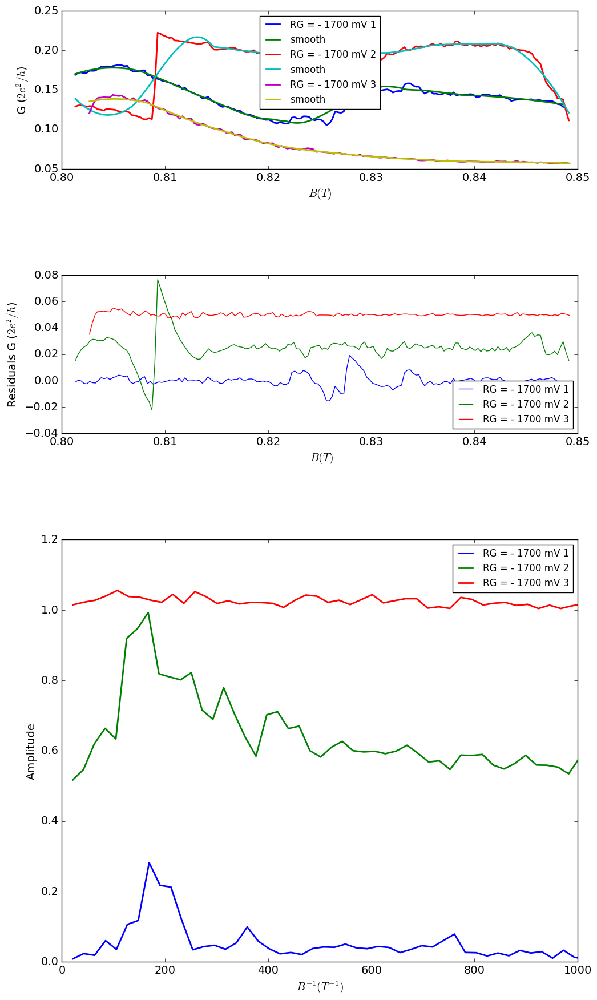

In [76]:
inputFiles_blockade = [inputFile_blockade1, inputFile_blockade2, inputFile_blockade3 ]
T = 0.080
labels =  ['RG = - 1700 mV 1' , 'RG = - 1700 mV 2' , 'RG = - 1700 mV 3']
windows = [41, 41, 41]
orders = [2, 2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-1700'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# RG -1500 mV (x5)

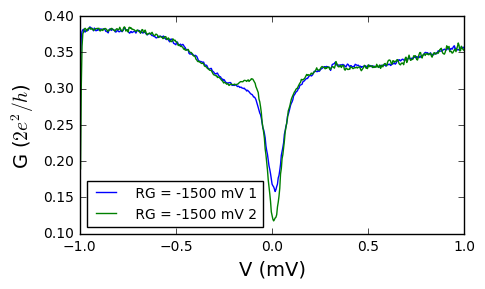

In [87]:

inputFiles_bias = [inputFiles_bias7 , inputFiles_bias11]
label_x = 'V (mV)'
conversions_x = [1e-3, 1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [12906.0, 12906.0]
labels = [' RG = -1500 mV 1', ' RG = -1500 mV 2']
column = 3
plot_name = 'Vbias_RG-1500'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

In [84]:

inputFile_blockade9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_9.dat'
inputFile_blockade10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_10.dat'

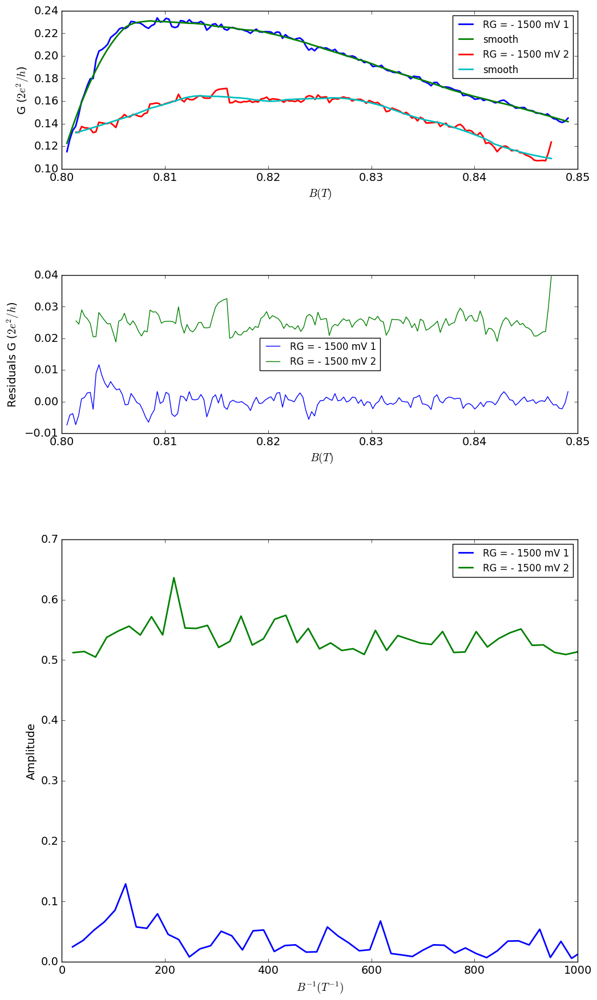

In [85]:
inputFiles_blockade = [ inputFile_blockade9,  inputFile_blockade10 ]
T = 0.080
labels =  ['RG = - 1500 mV 1' , 'RG = - 1500 mV 2' ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-1500'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# RG -1300 mV (x5)

In [88]:
inputFiles_bias12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_12.dat'
inputFiles_bias15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_15.dat'

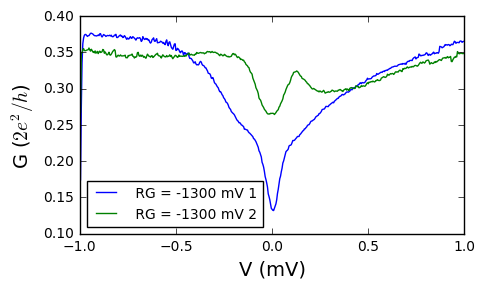

In [89]:
inputFiles_bias = [inputFiles_bias12 , inputFiles_bias15]
label_x = 'V (mV)'
conversions_x = [1e-3, 1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [12906.0, 12906.0]
labels = [' RG = -1300 mV 1', ' RG = -1300 mV 2']
column = 3
plot_name = 'Vbias_RG-1300'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

In [91]:
inputFile_blockade13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_13.dat'
inputFile_blockade14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_14.dat'

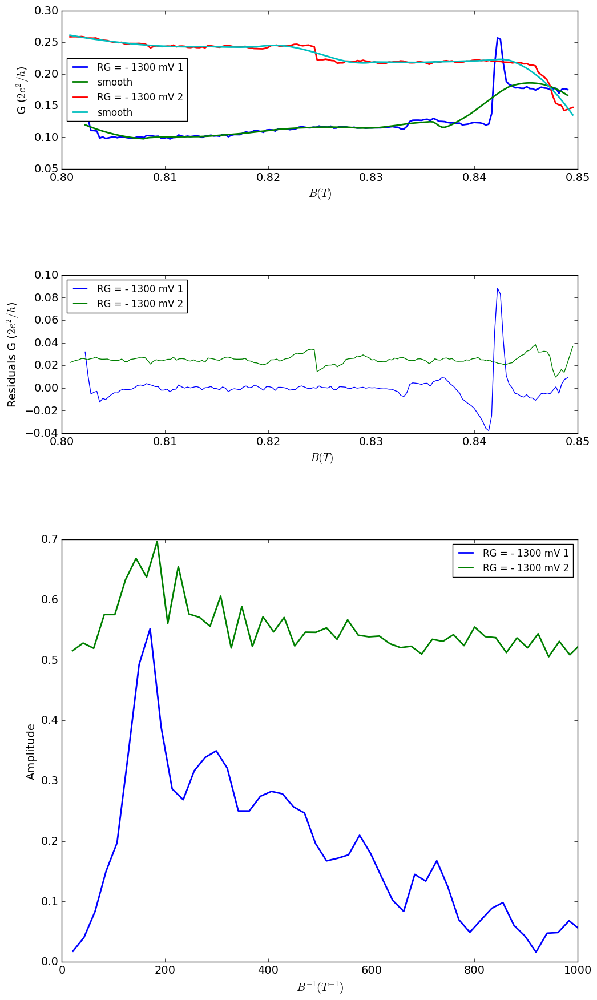

In [92]:
inputFiles_blockade = [ inputFile_blockade13,  inputFile_blockade14 ]
T = 0.080
labels =  ['RG = - 1300 mV 1' , 'RG = - 1300 mV 2' ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-1300'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# RG -1200 (x5) mV

In [109]:
inputFiles_bias16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_16.dat'
inputFiles_bias19 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_19.dat'

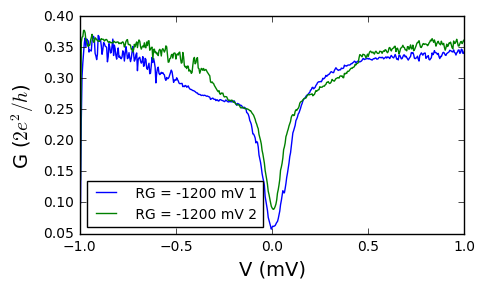

In [112]:
inputFiles_bias = [inputFiles_bias16 , inputFiles_bias19]
label_x = 'V (mV)'
conversions_x = [1e-3, 1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [12906.0, 12906.0]
labels = [' RG = -1200 mV 1', ' RG = -1200 mV 2']
column = 3
plot_name = 'Vbias_RG-1200'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

In [113]:
inputFile_blockade17 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_17.dat'
inputFile_blockade18 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_18.dat'

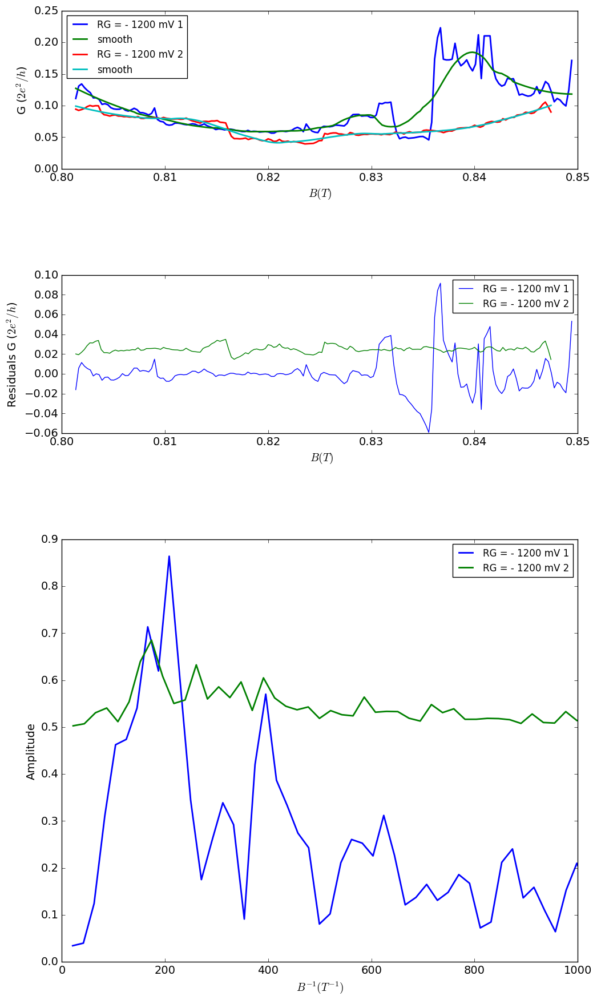

In [114]:
inputFiles_blockade = [ inputFile_blockade17,  inputFile_blockade18 ]
T = 0.080
labels =  ['RG = - 1200 mV 1' , 'RG = - 1200 mV 2' ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-1200'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

In [129]:
#Vbias 70 uV
inputFile_blockade20 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_20.dat'
inputFile_blockade21 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_21.dat'

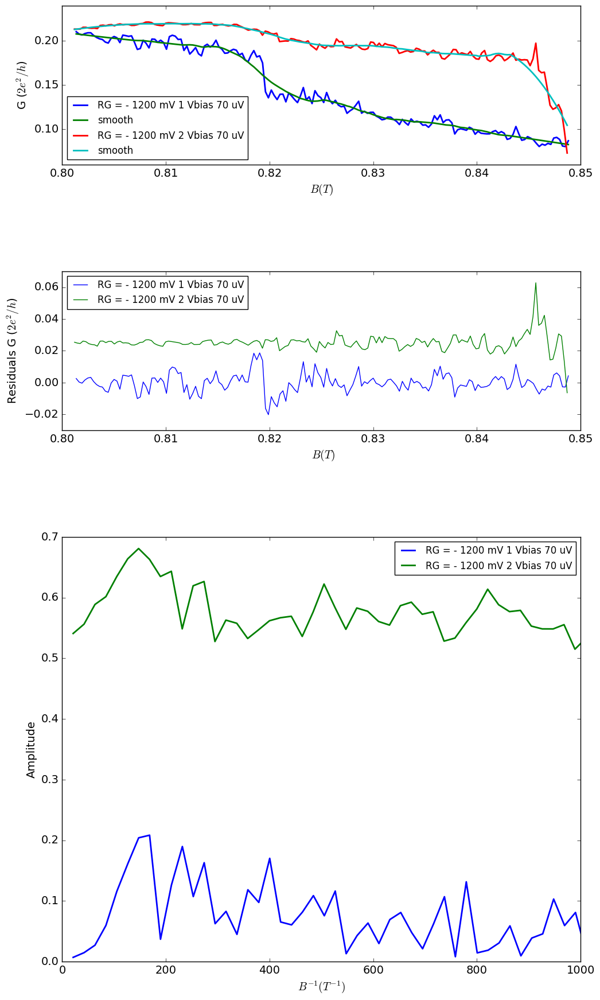

In [140]:
inputFiles_blockade = [ inputFile_blockade20,  inputFile_blockade21 ]
T = 0.080
labels =  ['RG = - 1200 mV 1 Vbias 70 uV' , 'RG = - 1200 mV 2 Vbias 70 uV' ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-1200_Vbias70uV'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# RG -1000 (x5) mV

In [142]:
inputFiles_bias22 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_22.dat'

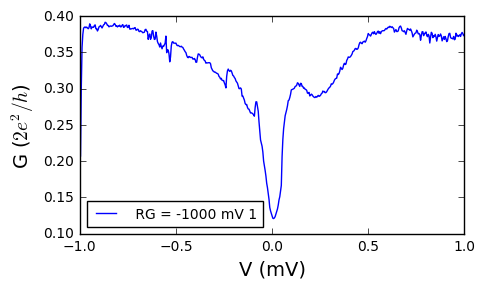

In [143]:

inputFiles_bias = [inputFiles_bias22]
label_x = 'V (mV)'
conversions_x = [1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [ 12906.0]
labels = [' RG = -1000 mV 1']
column = 3
plot_name = 'Vbias_RG-1000'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

In [144]:
#Vbias 70 uV
inputFile_blockade23 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_23.dat'
inputFile_blockade24 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_24.dat'


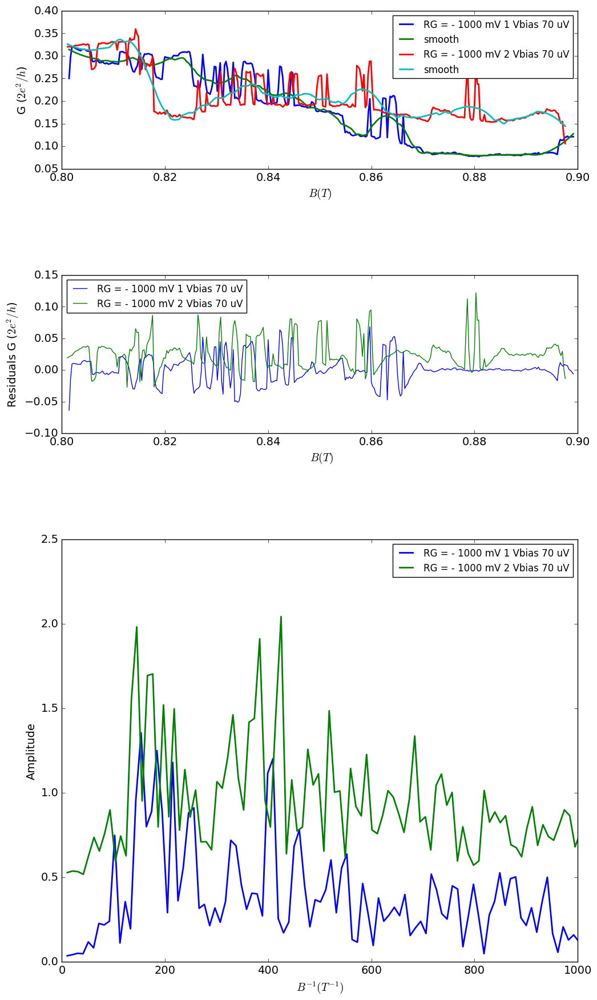

In [145]:
inputFiles_blockade = [ inputFile_blockade23,  inputFile_blockade24 ]
labels =  ['RG = - 1000 mV 1 Vbias 70 uV' , 'RG = - 1000 mV 2 Vbias 70 uV' ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-1000_Vbias70uV'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# RG -900 (x5) mV

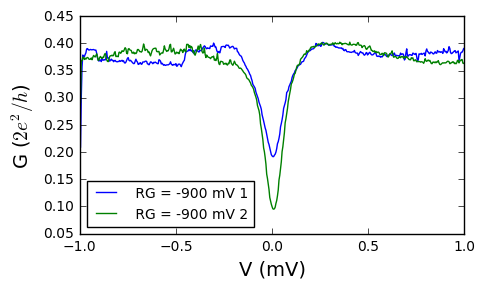

In [169]:
inputFiles_bias25 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_25.dat'
inputFiles_bias28 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_28.dat'

inputFiles_bias = [inputFiles_bias25, inputFiles_bias28]
label_x = 'V (mV)'
conversions_x = [1e-3, 1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [ 12906.0, 12906]
labels = [' RG = -900 mV 1', ' RG = -900 mV 2']
column = 3
plot_name = 'Vbias_RG-9000'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

In [166]:
#Vbias 70 uV
inputFile_blockade26 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_26.dat'
inputFile_blockade27 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_27.dat'

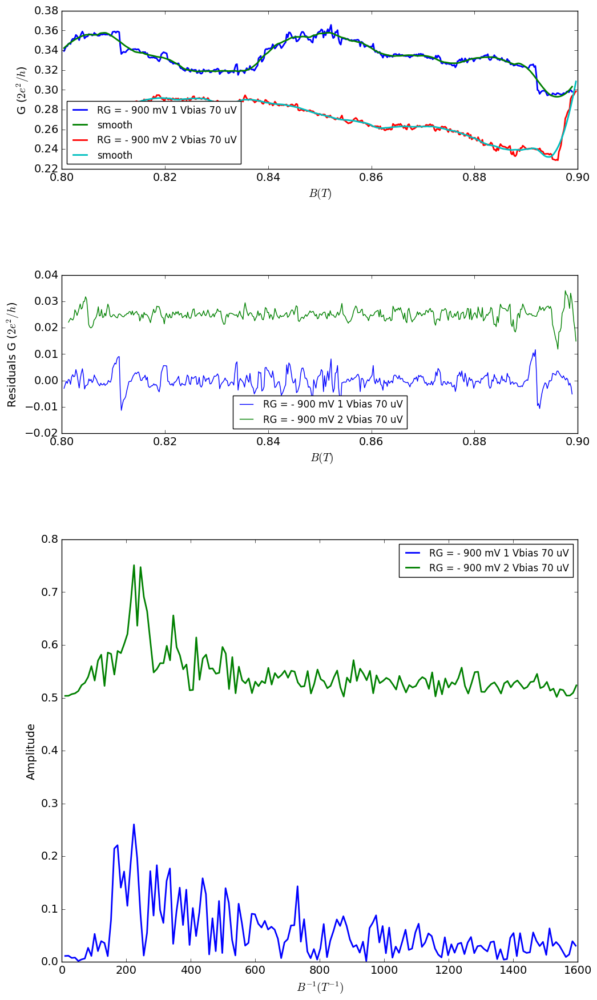

In [168]:
inputFiles_blockade = [ inputFile_blockade26,  inputFile_blockade27 ]
labels =  ['RG = - 900 mV 1 Vbias 70 uV' , 'RG = - 900 mV 2 Vbias 70 uV' ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-900_Vbias70uV'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# RG -800 (x5) mV

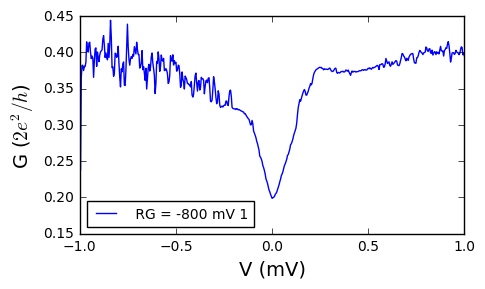

In [185]:
inputFiles_bias29 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_29.dat'


inputFiles_bias = [inputFiles_bias29]
label_x = 'V (mV)'
conversions_x = [1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [ 12906.0]
labels = [' RG = -800 mV 1']
column = 3
plot_name = 'Vbias_RG-800'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

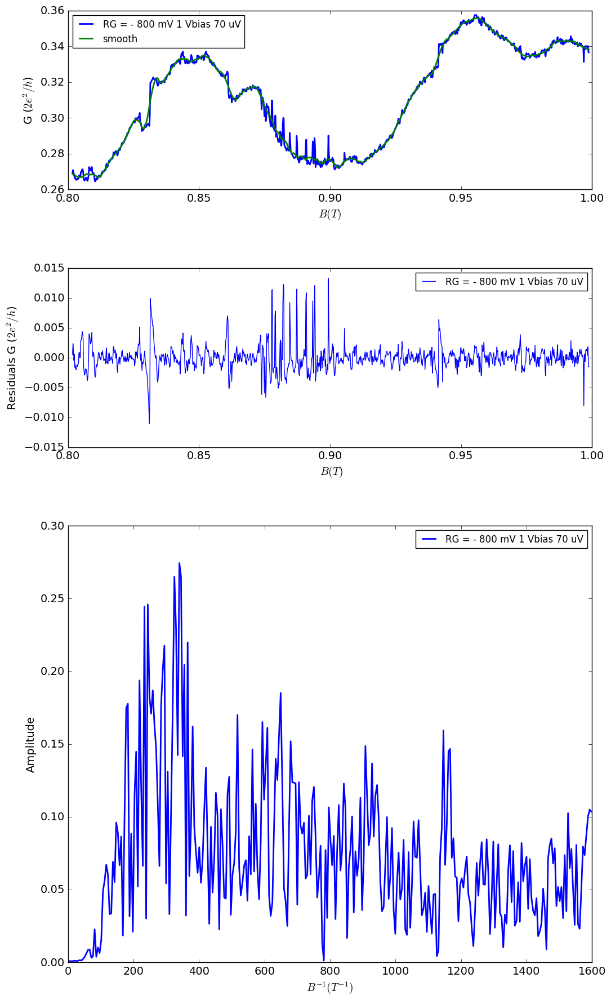

In [184]:
#Vbias 70 uV
inputFile_blockade30 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_30.dat'


inputFiles_blockade = [ inputFile_blockade30 ]
labels =  ['RG = - 800 mV 1 Vbias 70 uV'  ]
windows = [41, 41]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-800_Vbias70uV'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

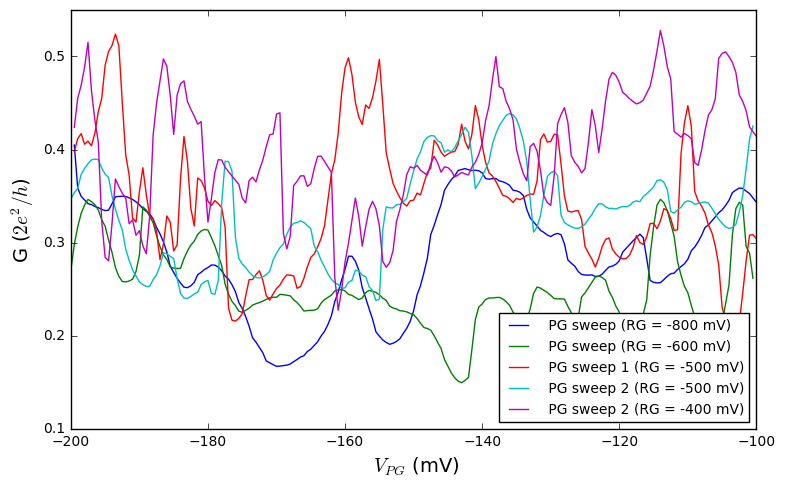

In [197]:
inputFiles_PGsweep_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_PG_sweep_15.dat'
inputFiles_PGsweep_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_PG_sweep_16.dat'
inputFiles_PGsweep_17 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_PG_sweep_17.dat'
inputFiles_PGsweep_18 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_PG_sweep_18.dat'
inputFiles_PGsweep_19 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_PG_sweep_19.dat'


inputFiles_bias = [inputFiles_PGsweep_15, inputFiles_PGsweep_16, inputFiles_PGsweep_17,
                   inputFiles_PGsweep_18, inputFiles_PGsweep_19]
label_x = ' $V_{PG} $ (mV)'
conversions_x = [1, 1, 1, 1, 1]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [ 12906.0, 12906,12906, 12906, 12906]
labels = [' PG sweep (RG = -800 mV) ', ' PG sweep (RG = -600 mV)', ' PG sweep 1 (RG = -500 mV)',
          ' PG sweep 2 (RG = -500 mV)', ' PG sweep 2 (RG = -400 mV)']
column = 3
plot_name = 'PGsweep_RG-800'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

# RG -400 (x5) mV

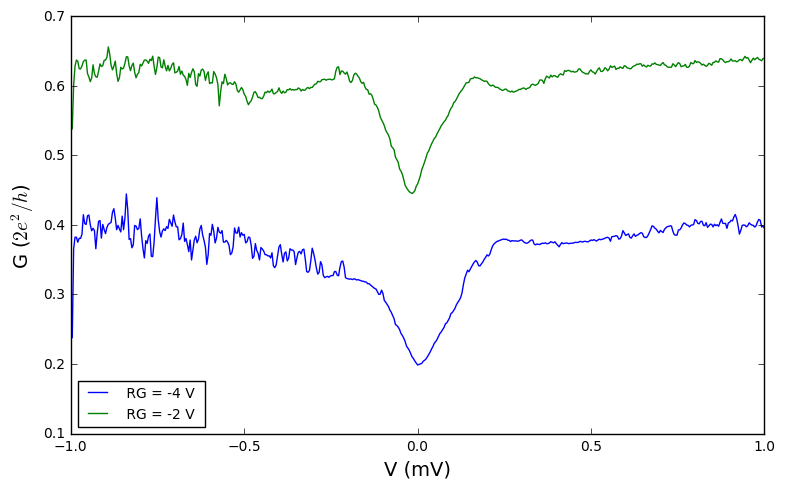

In [329]:
inputFiles_bias32 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_32.dat'
inputFiles_bias36 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_36.dat'

inputFiles_bias = [inputFiles_bias29, inputFiles_bias36]
label_x = 'V (mV)'
conversions_x = [ 1e-3, 1e-3]
label_y = 'G ($ 2 e^2 / h $)'
conversions_y = [  12906, 12906]
labels = [ ' RG = -4 V ', ' RG = -2 V']
column = 3
plot_name = 'Vbias_RG-400'

single_trace(inputFiles_bias, label_x, conversions_x, label_y, conversions_y, labels, column, plot_name)

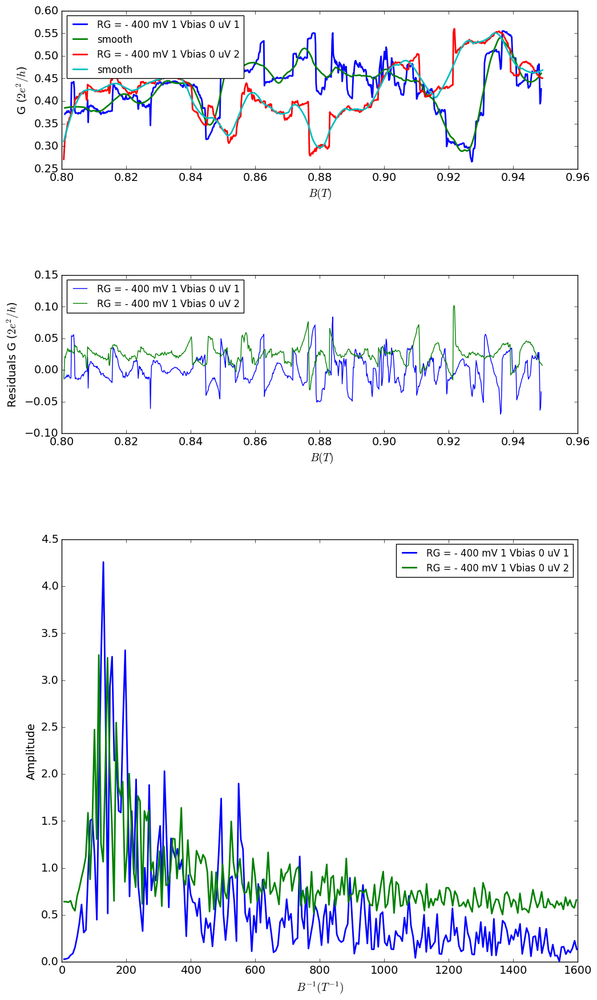

In [242]:
#Vbias 0 uV
inputFile_blockade34 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_34.dat'
inputFile_blockade35 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_35.dat'


inputFiles_blockade = [ inputFile_blockade34,  inputFile_blockade35 ]
labels =  ['RG = - 400 mV 1 Vbias 0 uV 1', 'RG = - 400 mV 1 Vbias 0 uV 2' ] 
windows = [71, 71]
orders = [2, 2]
plot_name = 'loop2_field_sweep_blockade_RG-400_Vbias0uV'
parameters = magnetoconductance(inputFiles_blockade, windows, orders, labels, plot_name, plot = True)

# Cotunnelling interference

# Series 1

the scan seems taken close to resonance of the dot.

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 105.665196875 0.538157823128
Amplitude: 14.6882571729 0.833301553869
B parameter: 2.90631819962 0.392702940488


C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:104: RuntimeWarning: overflow encountered in exp


(array([   10.0976795 ,    20.19535901,    30.29303851,    40.39071802,
           50.48839752,    60.58607703,    70.68375653,    80.78143603,
           90.87911554,   100.97679504,   111.07447455,   121.17215405,
          131.26983355,   141.36751306,   151.46519256,   161.56287207,
          171.66055157,   181.75823108,   191.85591058,   201.95359008,
          212.05126959,   222.14894909,   232.2466286 ,   242.3443081 ,
          252.44198761,   262.53966711,   272.63734661,   282.73502612,
          292.83270562,   302.93038513,   313.02806463,   323.12574413,
          333.22342364,   343.32110314,   353.41878265,   363.51646215,
          373.61414166,   383.71182116,   393.80950066,   403.90718017,
          414.00485967,   424.10253918,   434.20021868,   444.29789819,
          454.39557769,   464.49325719,   474.5909367 ,   484.6886162 ,
          494.78629571,   504.88397521,   514.98165471,   525.07933422,
          535.17701372,   545.27469323,   555.37237273,   565.47

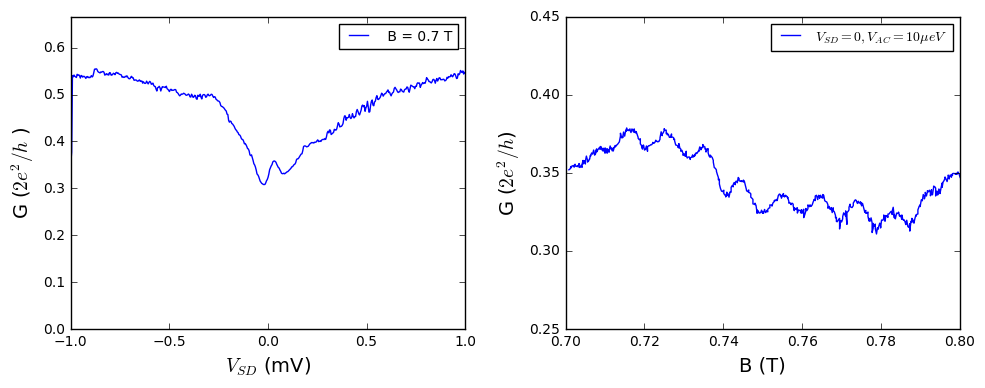

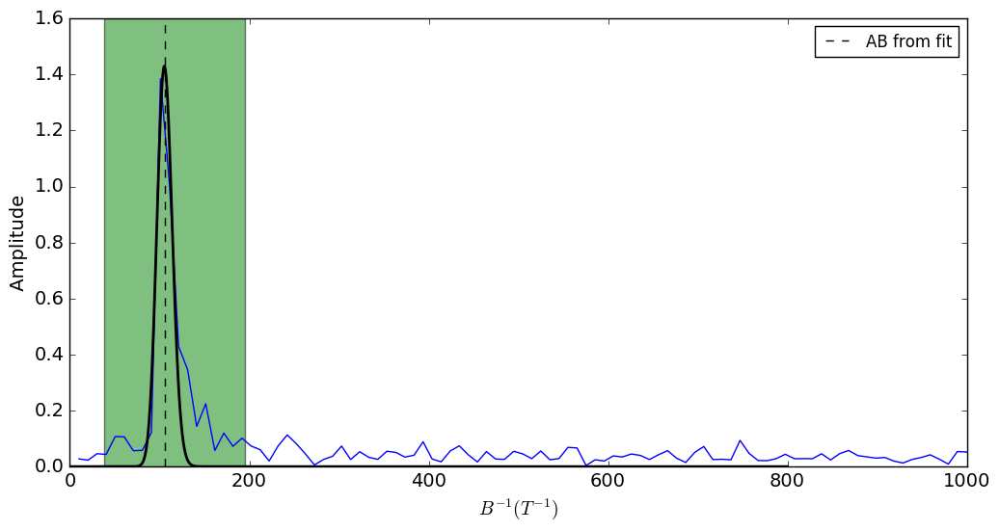

In [1378]:



inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_41.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_40.dat'


inputFiles = [inputFile_AB]

conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.7 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.7
B_max = 0.8
G_min = 0.25
G_max = 0.45

plot_name = 'cotunneling_resonance'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]
labels =  ['AB in resonance' ] 
windows = [101]
orders = [2]
plot_name = 'AB_resonance'
#magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot = True);
T = '16 mK'
A_min = 0.16
A_max = 0.807
A_center = 0.406

#magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = True , fitting = True)

magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

#cotunneling_loop2 = magnetconductance_average(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

the scan seems taken off resonance of the dot.

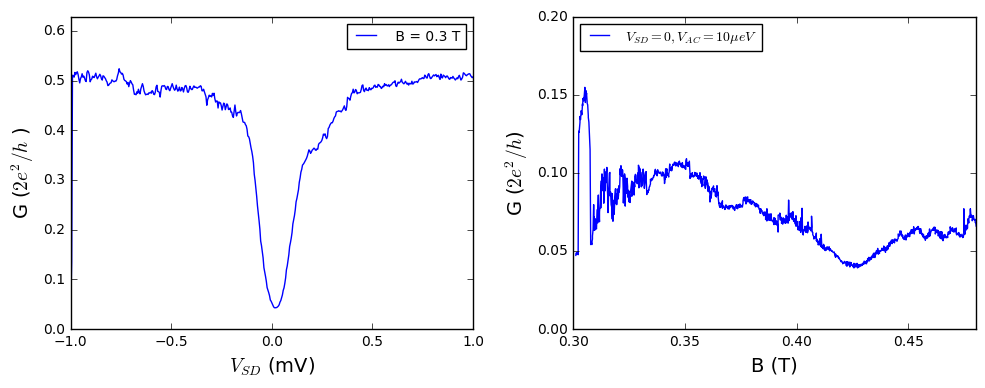

In [1379]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_45.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_44.dat'




conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.3 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.3
B_max = 0.48
G_min = 0.
G_max = 0.2

plot_name = 'cotunneling_44_45'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

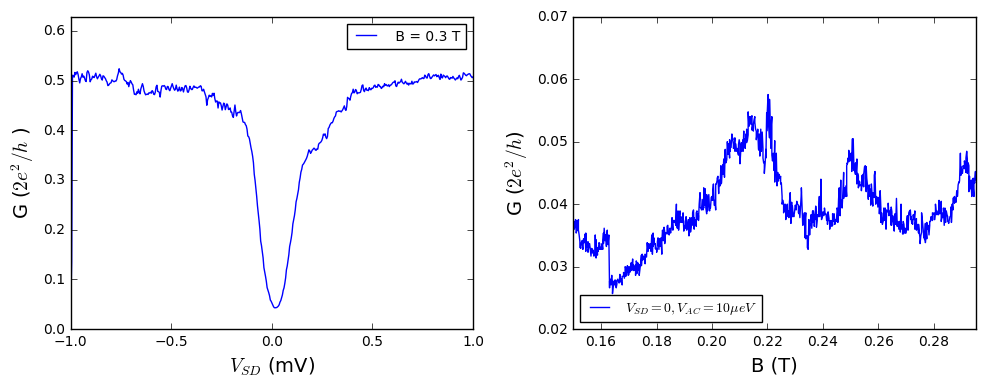

In [1380]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_45.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_46.dat'




conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.3 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.15
B_max = 0.295
G_min = 0.02
G_max = 0.07

plot_name = 'cotunneling_45_46'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

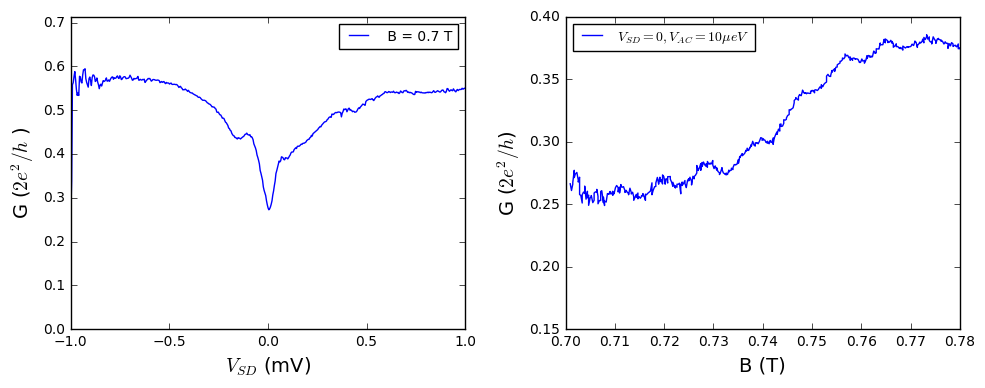

In [1381]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_51.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_50.dat'




conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.7 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.7
B_max = 0.78
G_min = 0.15
G_max = 0.4

plot_name = 'cotunneling_51_50'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

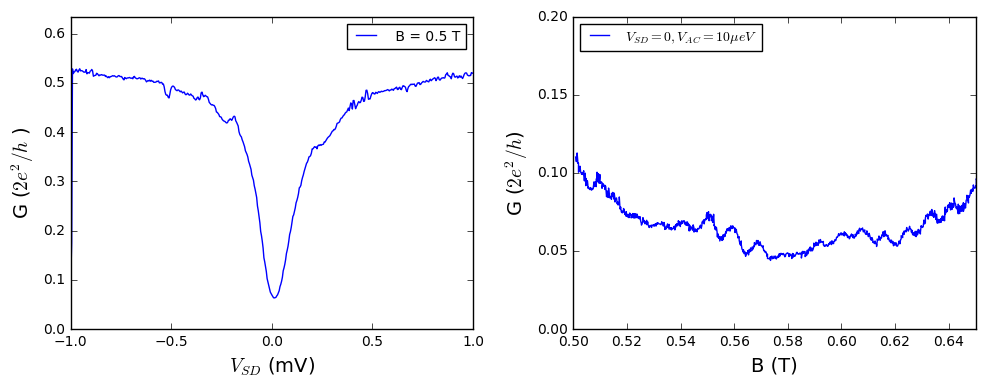

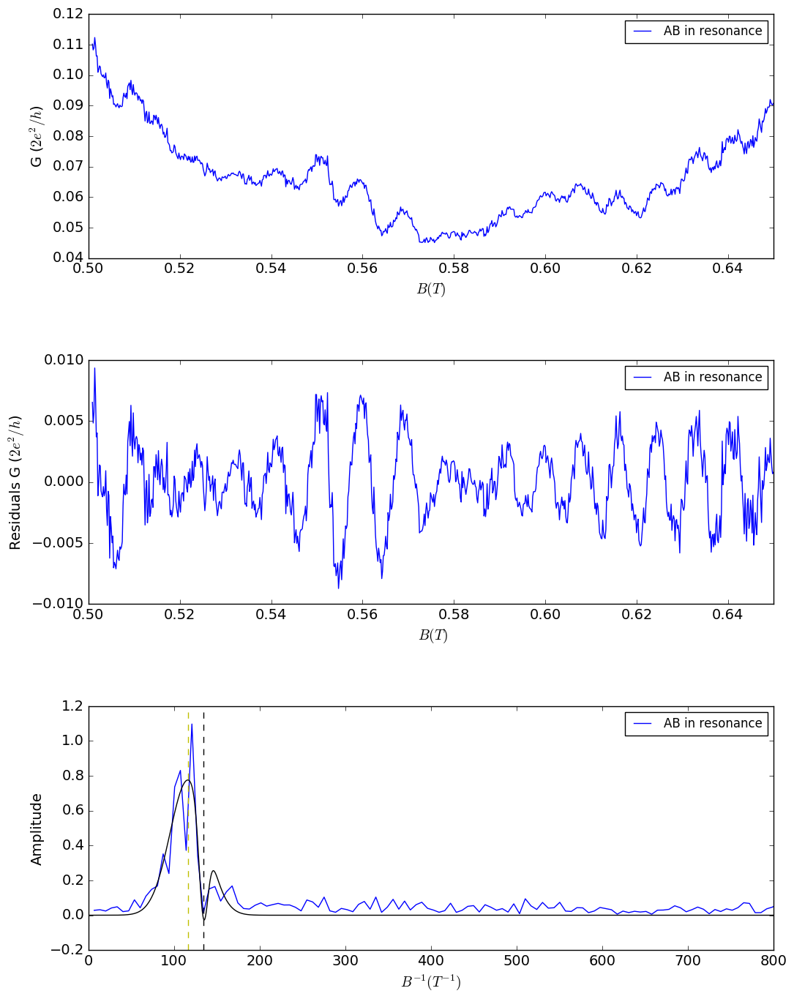

In [1382]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_53.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_52.dat'




conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.5 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.5
B_max = 0.65
G_min = 0.
G_max = 0.2

plot_name = 'cotunneling_53_52'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]
labels =  ['AB in resonance' ] 
windows = [109]
orders = [2]
plot_name = 'AB_coulomb_blockade'
B_min = 0.5
B_max = 0.65
magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max,plot = True);



f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 118.738305795 0.799089397732
Amplitude: 9.80170095766 0.434201385597
B parameter: 0.975280356921 0.0995523520118


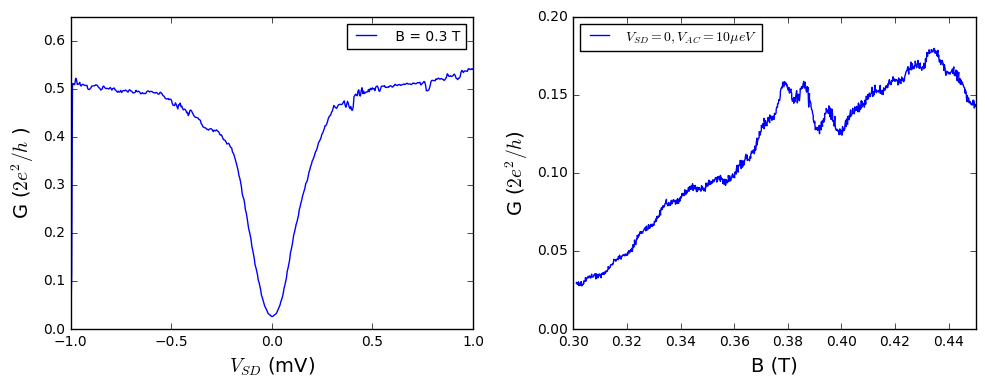

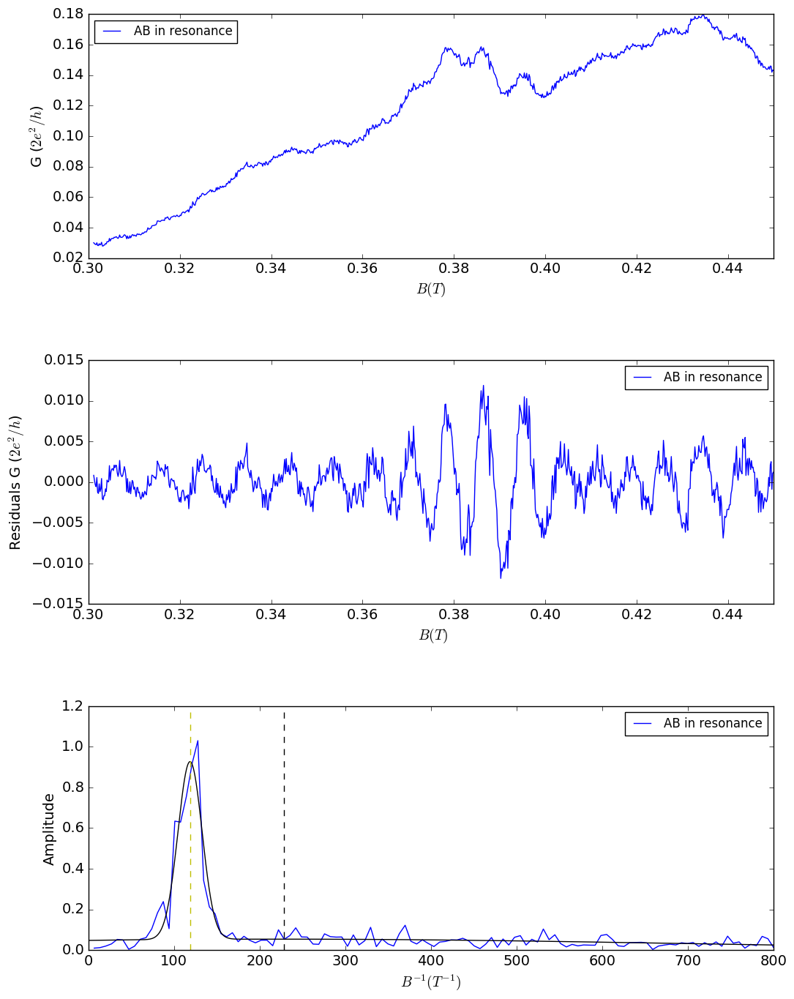

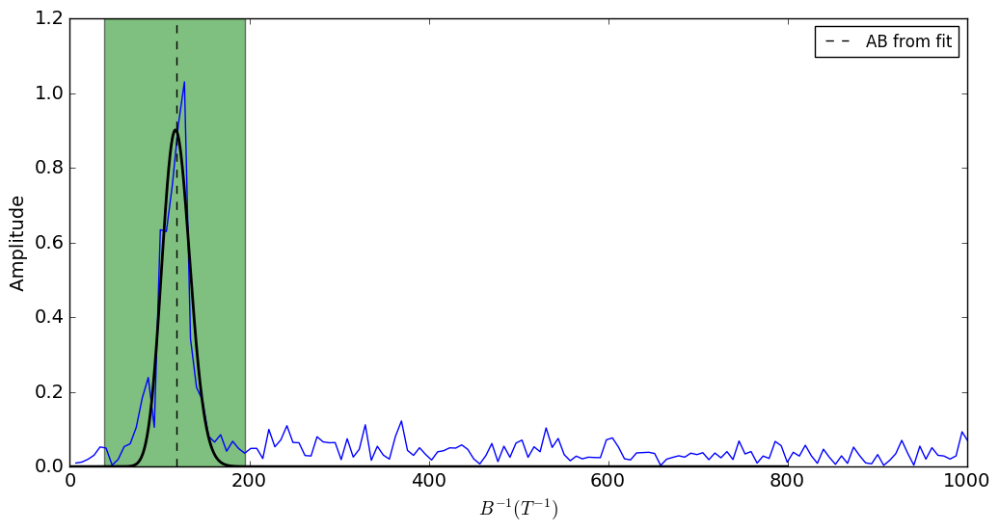

In [1383]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_55.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_54.dat'
inputFiles = [inputFile_AB]

conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.3 T'
conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'
B_min = 0.3
B_max = 0.45
G_min = 0.
G_max = 0.2
plot_name = 'cotunneling_blockade'
cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]
labels =  ['AB in resonance' ] 
windows = [101]
orders = [2]
plot_name = 'AB_blockade'
B_min = 0.3
B_max = 0.45
magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max,plot = True);
A_min = 0.16
A_max = 0.807
A_center = 0.406

magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 110.329580935 0.824536260078
Amplitude: 4.47846053177 0.179811266436
B parameter: 0.699955572041 0.0646860955146


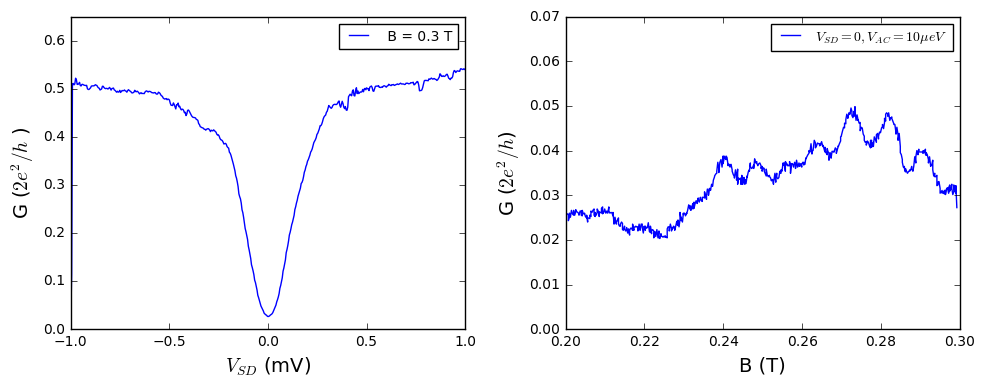

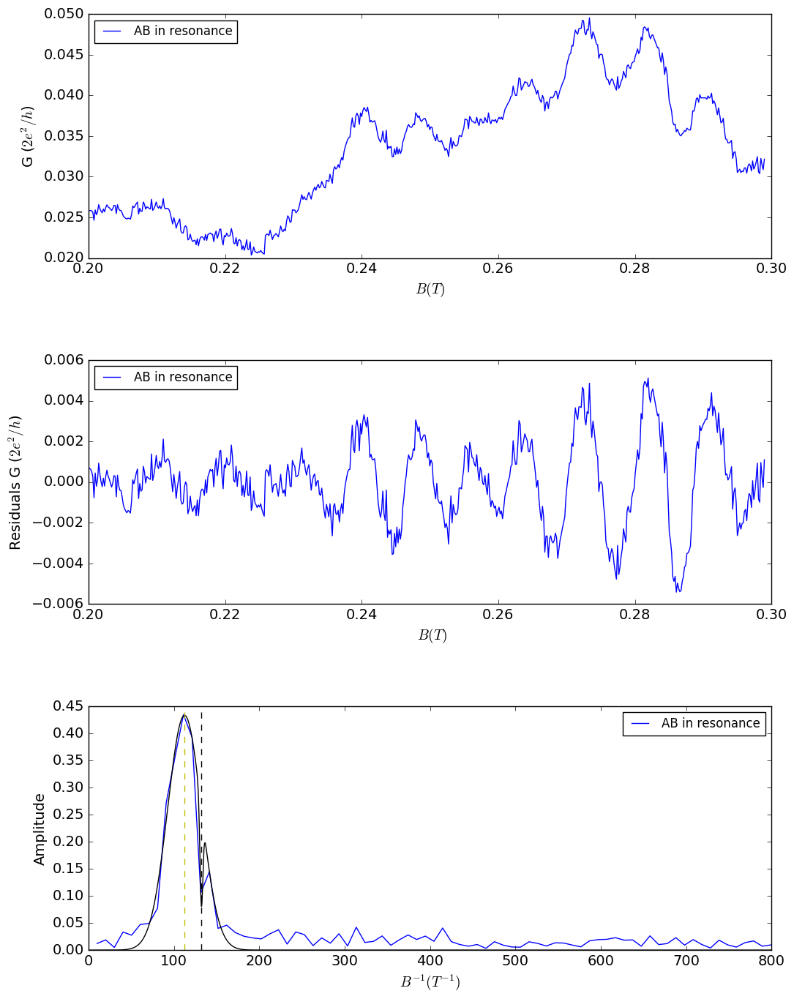

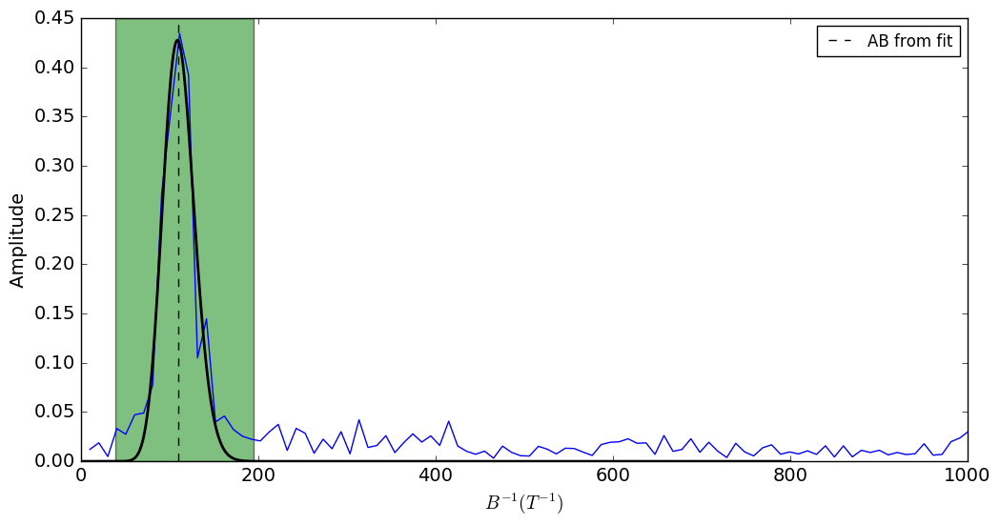

In [1384]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_55.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_56.dat'
inputFiles = [inputFile_AB]
conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.3 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.2
B_max = 0.3
G_min = 0.
G_max = 0.07

plot_name = 'cotunneling_55_56'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]
labels =  ['AB in resonance' ] 
windows = [101]
orders = [2]
plot_name = 'AB_coulomb_blockade_1'
B_min = 0.2
B_max = 0.3
magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max,plot = True); 
A_min = 0.16
A_max = 0.807
A_center = 0.406
plot_name  = 'cotunneling_AB_1'
magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 110.329580935 0.824536260078
Amplitude: 4.47846053177 0.179811266436
B parameter: 0.699955572041 0.0646860955146


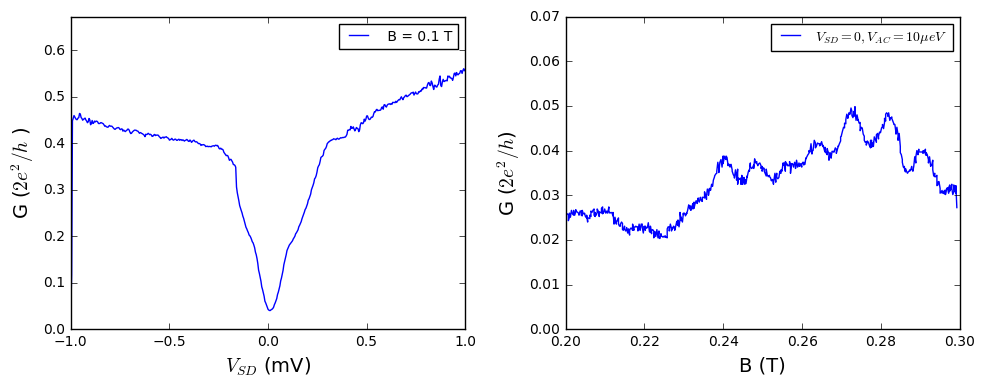

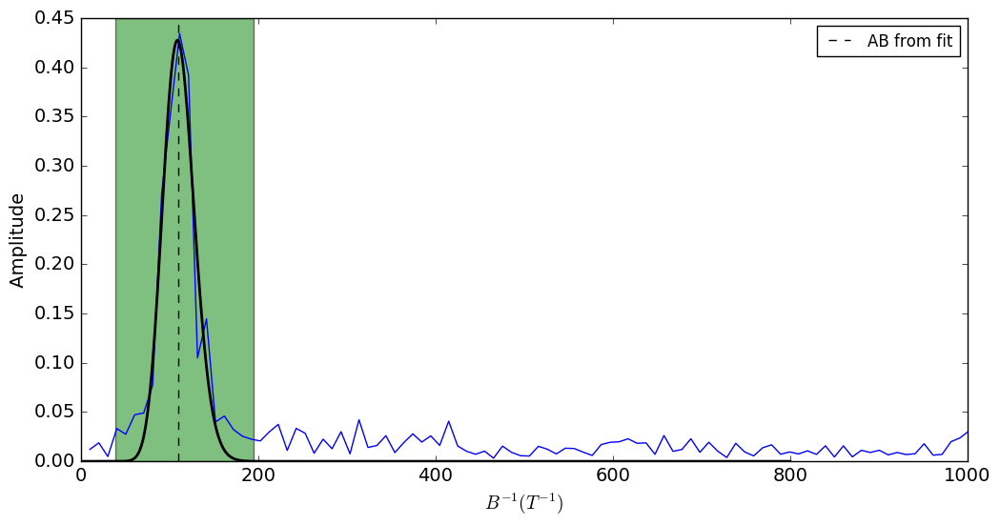

In [1385]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_57.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_56.dat'




conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.1 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.2
B_max = 0.3
G_min = 0.
G_max = 0.07

plot_name = 'cotunneling_57_56'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]

A_min = 0.16
A_max = 0.807
A_center = 0.406
plot_name  = 'cotunneling_AB_2'

magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 98.2099661345
f_AAS from design: 196.419932269
limit from design for AB effect 38.7034349299 195.210449927
FIT PARAMETERS FOR AB:
f: 108.534987775 0.855034206742
Amplitude: 6.32288154411 0.365444822448
B parameter: 1.35634615151 0.178544485714


(array([   13.44370616,    26.88741232,    40.33111848,    53.77482464,
           67.2185308 ,    80.66223697,    94.10594313,   107.54964929,
          120.99335545,   134.43706161,   147.88076777,   161.32447393,
          174.76818009,   188.21188625,   201.65559241,   215.09929857,
          228.54300474,   241.9867109 ,   255.43041706,   268.87412322,
          282.31782938,   295.76153554,   309.2052417 ,   322.64894786,
          336.09265402,   349.53636018,   362.98006634,   376.42377251,
          389.86747867,   403.31118483,   416.75489099,   430.19859715,
          443.64230331,   457.08600947,   470.52971563,   483.97342179,
          497.41712795,   510.86083411,   524.30454028,   537.74824644,
          551.1919526 ,   564.63565876,   578.07936492,   591.52307108,
          604.96677724,   618.4104834 ,   631.85418956,   645.29789572,
          658.74160188,   672.18530805,   685.62901421,   699.07272037,
          712.51642653,   725.96013269,   739.40383885,   752.84

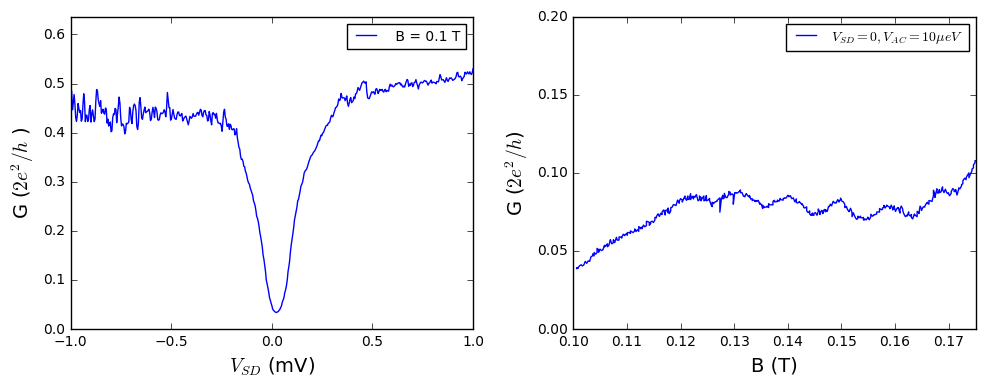

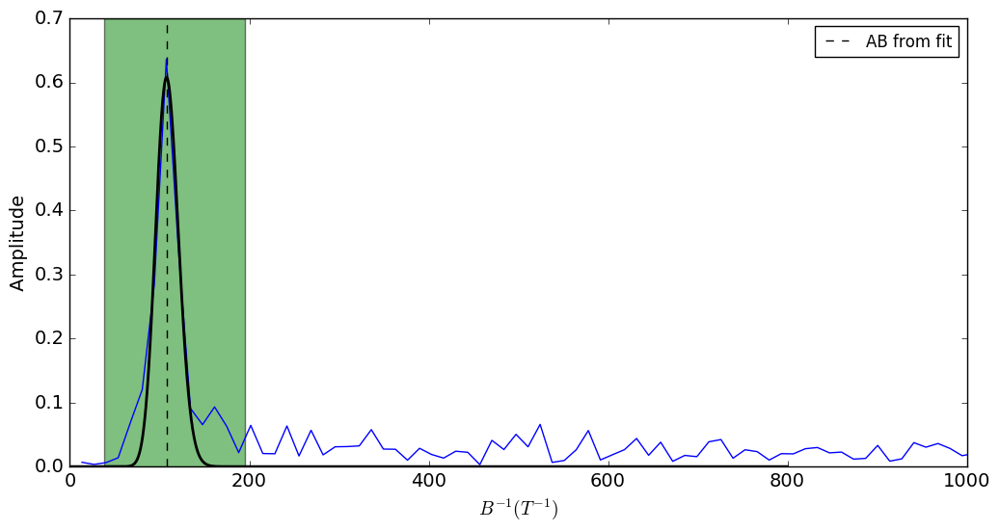

In [1386]:
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_58.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_59.dat'


inputFiles = [inputFile_AB]

conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.1 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.1
B_max = 0.175
G_min = 0.
G_max = 0.2

plot_name = 'cotunneling_58_59'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

A_min = 0.16
A_max = 0.807
A_center = 0.406
plot_name  = 'cotunneling_AB_2'

magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max)


C:\Anaconda3\envs\pycqed_env\lib\site-packages\ipykernel\__main__.py:108: RuntimeWarning: overflow encountered in exp


([array([   12.52346026,    25.04692052,    37.57038079,    50.09384105,
            62.61730131,    75.14076157,    87.66422183,   100.18768209,
           112.71114236,   125.23460262,   137.75806288,   150.28152314,
           162.8049834 ,   175.32844367,   187.85190393,   200.37536419,
           212.89882445,   225.42228471,   237.94574497,   250.46920524,
           262.9926655 ,   275.51612576,   288.03958602,   300.56304628,
           313.08650654,   325.60996681,   338.13342707,   350.65688733,
           363.18034759,   375.70380785,   388.22726812,   400.75072838,
           413.27418864,   425.7976489 ,   438.32110916,   450.84456942,
           463.36802969,   475.89148995,   488.41495021,   500.93841047,
           513.46187073,   525.985331  ,   538.50879126,   551.03225152,
           563.55571178,   576.07917204,   588.6026323 ,   601.12609257,
           613.64955283,   626.17301309,   638.69647335,   651.21993361,
           663.74339387,   676.26685414,   688.7903

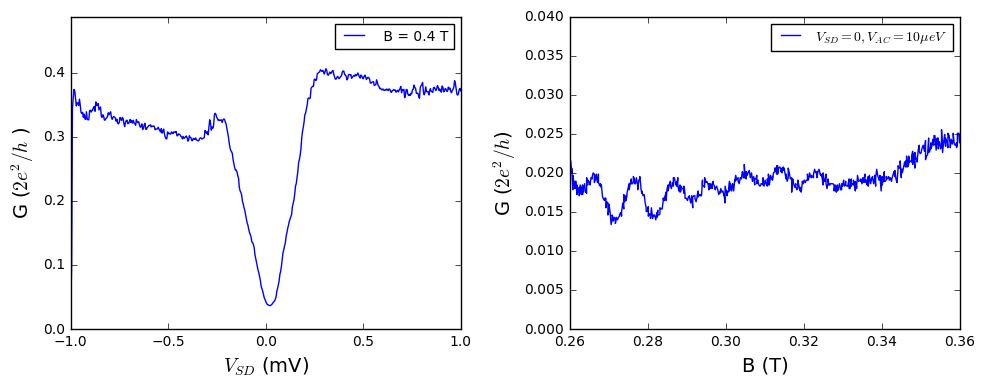

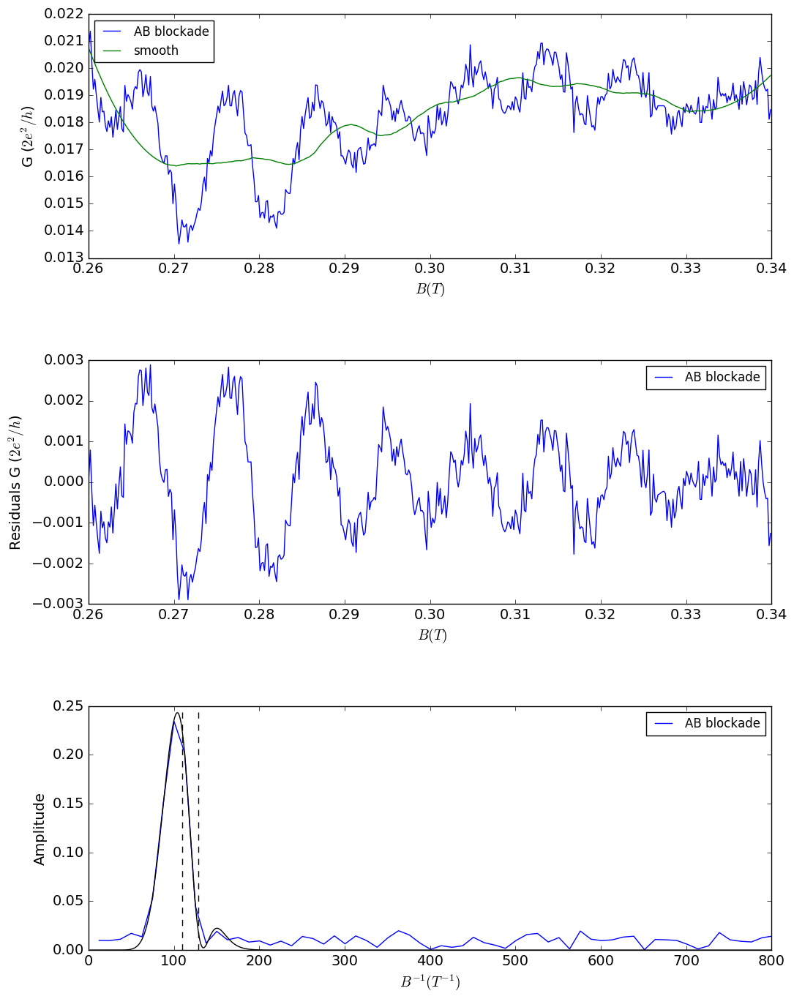

In [1387]:


inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_173.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_172.dat'




conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.4 T'


conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'

B_min = 0.26
B_max = 0.36
G_min = 0.
G_max = 0.04

plot_name = 'cotunneling_173_172'


cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]
labels =  ['AB blockade' ] 
windows = [101]
orders = [2]

plot_name = 'AB_coulomb_blockade_1'
B_min = 0.26
B_max = 0.34
#magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max,plot = True); 

T = '16 mK'
A_min = 0.16
A_max = 0.807
A_center = 0.406




plot_name  = 'cotunneling_AB_2'

magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = True , fitting = True)


#magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);



# Comparison between cotunneling and open loop AB effect

In [ ]:

#importing cotunneling data 1
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_173.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_172.dat'
conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.4 T'
conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'
B_min = 0.26
B_max = 0.36
G_min = 0.
G_max = 0.04
plot_name = 'cotunneling_blockade'
cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)
inputFiles = [inputFile_AB]
labels =  ['AB blockade' ] 
windows = [101]
orders = [2]
B_min = 0.26
B_max = 0.34
T = '16 mK'
A_min = 0.16
A_max = 0.807
A_center = 0.406
plot_name  = 'cotunneling_AB_1'
freq_all, fft_all, x1s, A1s, B1s, x2s, A2s, B2s, x1errs, A1errs, B1errs, x2errs, A2errs, B2errs = magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = False , fitting = True)
freq_cotunneling_1 =  freq_all[0]
fft_cotunneling_1 = fft_all[0]



#importing cotunneling data 2
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_58.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_59.dat'
inputFiles = [inputFile_AB]
conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.1 T'
conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'
B_min = 0.1
B_max = 0.175
G_min = 0.
G_max = 0.2
plot_name = 'cotunneling_blockade'
#cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
#            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)
A_min = 0.16
A_max = 0.807
A_center = 0.406
plot_name  = 'cotunneling_AB_2'
freq_all, fft_all, x1s, A1s, B1s, x2s, A2s, B2s, x1errs, A1errs, B1errs, x2errs, A2errs, B2errs = magnetoconductance_range_special(inputFiles, windows, orders, labels, plot_name, B_min, B_max, plot = False , fitting = True)
freq_cotunneling_2 =  freq_all[0]
fft_cotunneling_2 = fft_all[0]


#importing cotunneling data 3
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_55.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_56.dat'
inputFiles = [inputFile_AB]
conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.3 T'
conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'
B_min = 0.2
B_max = 0.3
G_min = 0.
G_max = 0.07
plot_name = 'cotunneling_AB_3'
#cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
#            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)
inputFiles = [inputFile_AB]
labels =  ['AB blockade' ] 
windows = [101]
orders = [2]
plot_name = 'cotunneling blockade'
B_min = 0.2
B_max = 0.3
#magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max,plot = True); 
A_min = 0.16
A_max = 0.807
A_center = 0.406
plot_name  = 'cotunneling_AB_3'
freq_all, fft_all, x1s, A1s, B1s, offsets, x1errs, A1errs, B1errs, offseterrs = magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);
freq_cotunneling_3 =  freq_all
fft_cotunneling_3 = fft_all


#importing cotunneling data 4
inputFile_bias = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_55.dat'
inputFile_AB = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_Bsweep_blockade_54.dat'
inputFiles = [inputFile_AB]
conversions_bias_x = 1e-3
conversions_bias_y = 12906.0
label_bias = ' B = 0.3 T'
conversions_AB_x = 1.
conversions_AB_y = 12906.0
label_AB = '$ V_{SD} = 0,  V_{AC} = 10  \mu eV $'
B_min = 0.3
B_max = 0.45
G_min = 0.
G_max = 0.2
plot_name = 'cotunneling_blockade'
#cotunneling(inputFile_bias, inputFile_AB, conversions_bias_x, conversions_bias_y, label_bias,  
#            conversions_AB_x, conversions_AB_y, label_AB, B_min, B_max, G_min, G_max, plot_name)

inputFiles = [inputFile_AB]
labels =  ['cotunnneling blockade' ] 
windows = [101]
orders = [2]
plot_name = 'AB_blockade'
B_min = 0.3
B_max = 0.45
#magnetoconductance_range(inputFiles, windows, orders, labels, plot_name, B_min, B_max,plot = True);
A_min = 0.16
A_max = 0.807
A_center = 0.406
freq_all, fft_all, x1s, A1s, B1s, offsets, x1errs, A1errs, B1errs, offseterrs = magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);
freq_cotunneling_4 =  freq_all
fft_cotunneling_4 = fft_all


#importing the data from open loop at 80 mK
inputFile80mk_1 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_1.dat'
inputFile80mk_2 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_2.dat'
inputFile80mk_3 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_3.dat'
inputFile80mk_4 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_4.dat'
inputFile80mk_5 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_5.dat'
inputFile80mk_6 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_6.dat'
inputFile80mk_7 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_7.dat'
inputFile80mk_8 ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_temperature_scan_80mk_8.dat'

#inputFiles80mk = [inputFile80mk_1, inputFile80mk_2, inputFile80mk_3, inputFile80mk_4, inputFile80mk_5,
#                  inputFile80mk_6, inputFile80mk_7, inputFile80mk_8]

inputFiles80mk = [inputFile80mk_7]
T = 0.080
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 51
windows = [window, window,  window, window,  window,  window,  window,  window]
orders = [2, 2, 2, 2, 2, 2, 2, 2]
plot_name = 'temperature_dependence_80mk'
parameters = magnetoconductance_range(inputFiles80mk, windows, orders, labels, plot_name, plot = True)
A_min = 0.160
A_center = 0.406
A_max = 0.807

average_80mk_loop2 =magnetconductance_average(inputFiles80mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
freq_all_average_80mk, fft_all_average_80mk, A1_80mk, A2_80mk, mean1_80mk, mean2_80mk,  sigma1_80mk, sigma2_80mk, offset_80mk, A1err_80mk, A2err_80mk = average_80mk_loop2

freq_open = freq_all_average_80mk
fft_open = fft_all_average_80mk


fig = plt.figure(figsize=(6,6))
ax1 = plt.subplot2grid((1,1), (0,0), colspan=1)
ax1.set_xlabel( '$ B^{-1} (T^{-1})  $', fontsize=axes_font)
ax1.set_ylabel(' Amplitude ', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_xlim(0,1000)
ax1.plot(freq_open, fft_open + 1.0, linewidth=1, label = 'open regime', color = 'black')
ax1.plot(freq_cotunneling_1, fft_cotunneling_1, linewidth=1, label = ' $ < G_{cot} > = 0.02 \cdot e^2 /2h $ ', color = '0.75')
ax1.plot(freq_cotunneling_3, fft_cotunneling_3, linewidth=1, label = ' $ < G_{cot} > = 0.035 \cdot e^2 /2h $ ', color = '0.50')
ax1.plot(freq_cotunneling_2, fft_cotunneling_2, linewidth=1, label = ' $ < G_{cot} > = 0.07 \cdot e^2 /2h $ ', color = '0.25')
ax1.plot(freq_cotunneling_4, fft_cotunneling_4, linewidth=1, label =  ' $ < G_{cot} > = 0.12 \cdot e^2 /2h $ ', color = '0.05')
ax1.legend(loc=0)
fig.savefig('comparison.eps',format='eps', transparent = False)
fig.savefig('comparison.png',format='png', transparent = False)



# Weak antilocalization measurements

# Phase shift of AB by weak gate tuning

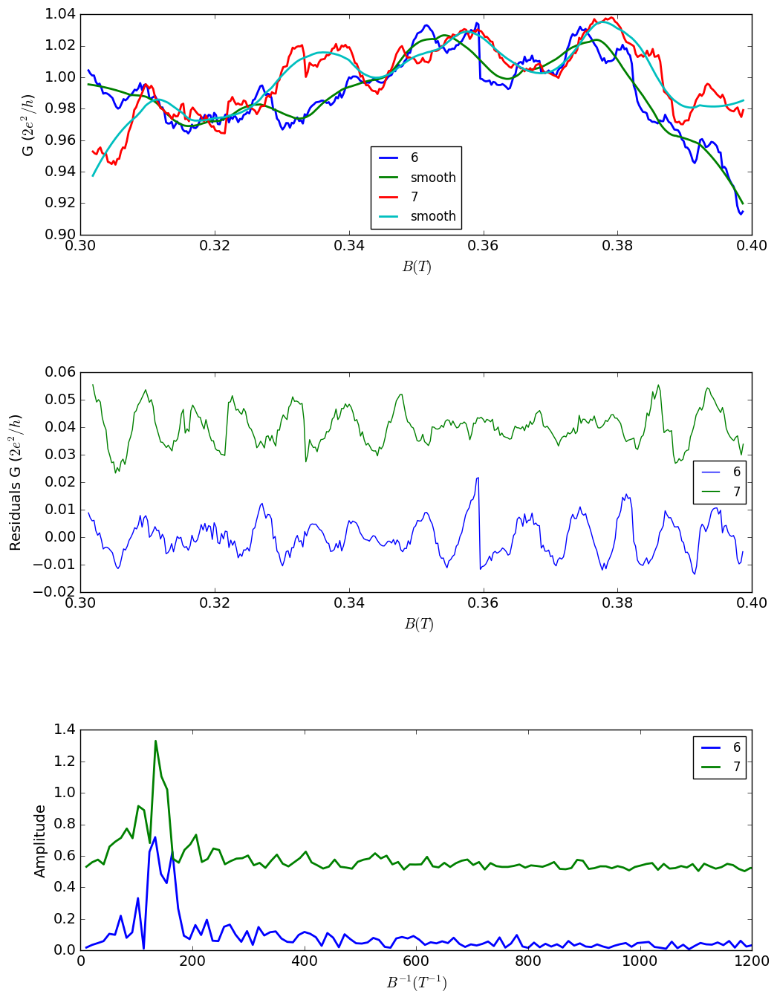

In [536]:
inputFile_pert_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_1.dat'
inputFile_pert_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_2.dat'
inputFile_pert_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_3.dat'
inputFile_pert_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_4.dat'
inputFile_pert_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_5.dat'
inputFile_pert_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_6.dat'
inputFile_pert_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_7.dat'


inputFiles = [ inputFile_pert_6, inputFile_pert_7]

labels = (   '6', '7' )
windows = ( 47, 47)
orders = (  2,2 )
plot_name = 'perturbation_gate_1'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True);

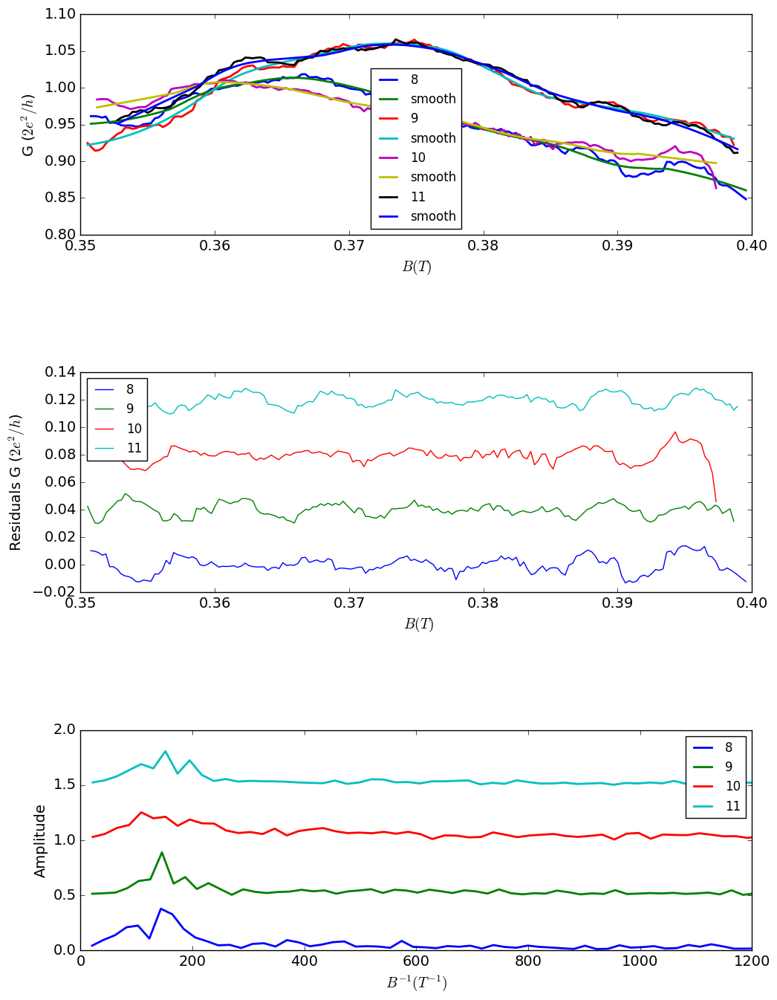

In [541]:
inputFile_pert_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_8.dat'
inputFile_pert_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_9.dat'
inputFile_pert_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_10.dat'
inputFile_pert_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_11.dat'

inputFiles = [ inputFile_pert_8, inputFile_pert_9, inputFile_pert_10,  inputFile_pert_11]

labels = (   '8', '9', '10', '11' )
windows = ( 43, 43, 43, 43)
orders = (  2, 2, 2, 2 )
plot_name = 'perturbation_gate_2'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True);

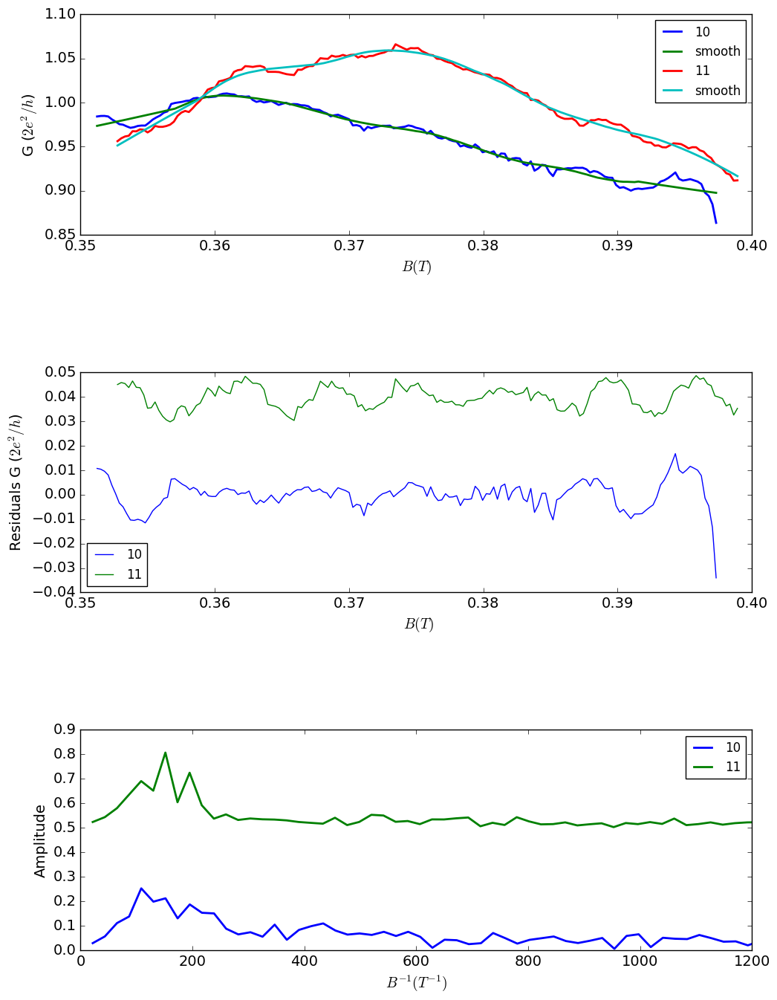

In [542]:

inputFile_pert_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_10.dat'
inputFile_pert_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_11.dat'

inputFiles = [ inputFile_pert_10,  inputFile_pert_11]

labels = (   '10', '11' )
windows = (  43, 43)
orders = (   2, 2 )
plot_name = 'perturbation_gate_3'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True);

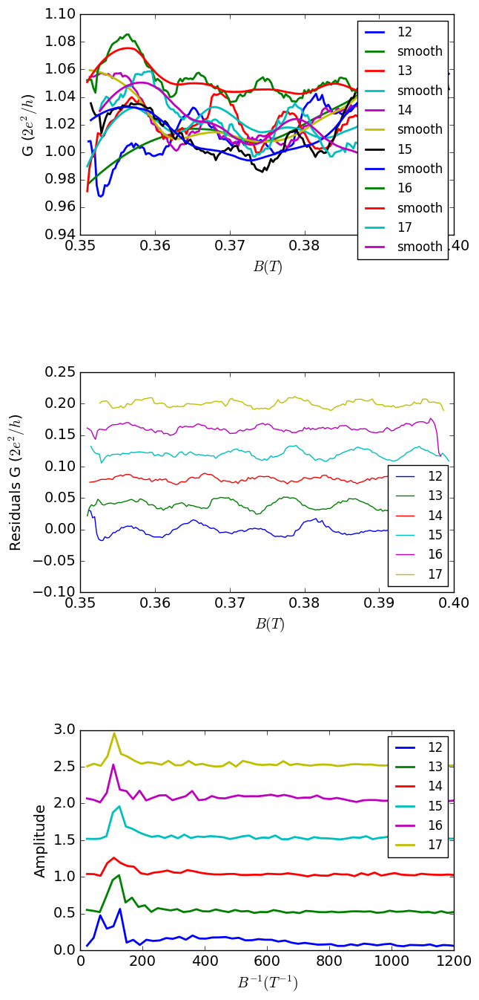

In [573]:
#same gate voltage RG 100 (x5) mV

inputFile_pert_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_12.dat'
inputFile_pert_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_13.dat'
inputFile_pert_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_14.dat'
inputFile_pert_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_15.dat'
inputFile_pert_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_16.dat'
inputFile_pert_17 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_17.dat'



inputFiles = [ inputFile_pert_12, inputFile_pert_13, inputFile_pert_14, inputFile_pert_15, inputFile_pert_16, inputFile_pert_17 ]

labels = (   '12', '13' , '14', '15', '16', '17')
windows = ( 81, 47, 47, 47, 47, 47)
orders = (  2, 2,  2, 2, 2, 2 )
plot_name = 'perturbation_gate_3'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True);


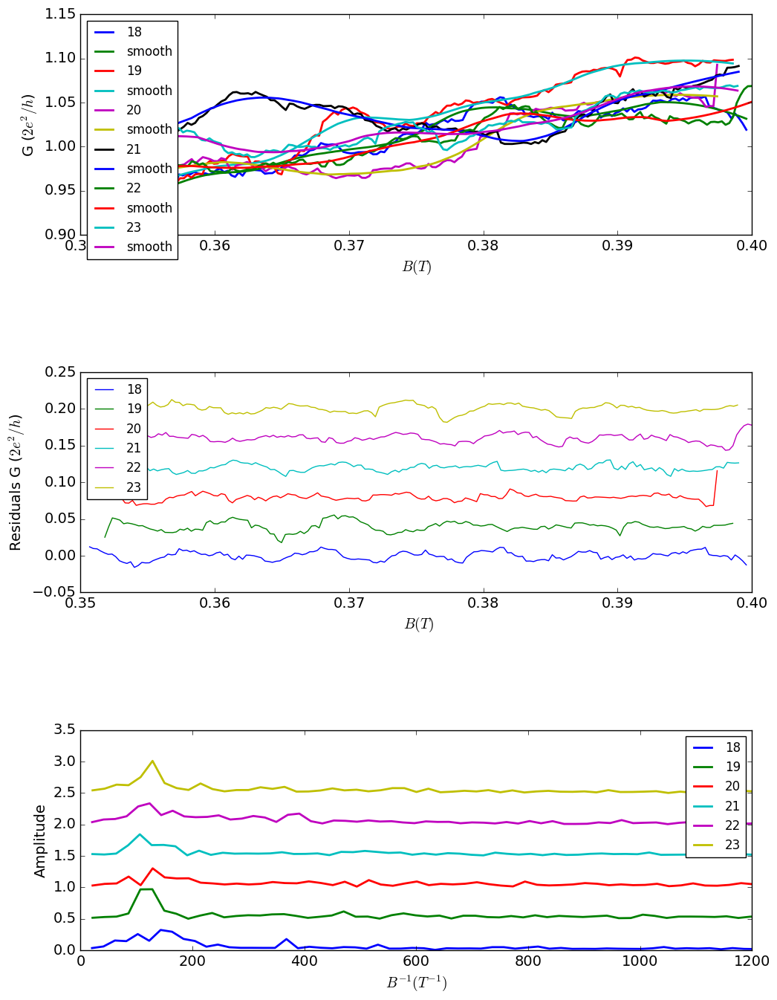

In [545]:
#same gate voltage RG 200 (x5) mV

inputFile_pert_18 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_18.dat'
inputFile_pert_19 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_19.dat'
inputFile_pert_20 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_20.dat'
inputFile_pert_21 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_21.dat'
inputFile_pert_22 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_22.dat'
inputFile_pert_23 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_gate_perturbation_23.dat'



inputFiles = [ inputFile_pert_18, inputFile_pert_19, inputFile_pert_20, inputFile_pert_21, inputFile_pert_22, inputFile_pert_23 ]

labels = (   '18', '19' , '20', '21', '22', '23')
windows = ( 47, 47, 47, 47, 47, 47)
orders = (  2, 2,  2, 2, 2, 2 )
plot_name = 'perturbation_gate_3'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True);

# AB oscillations around zero


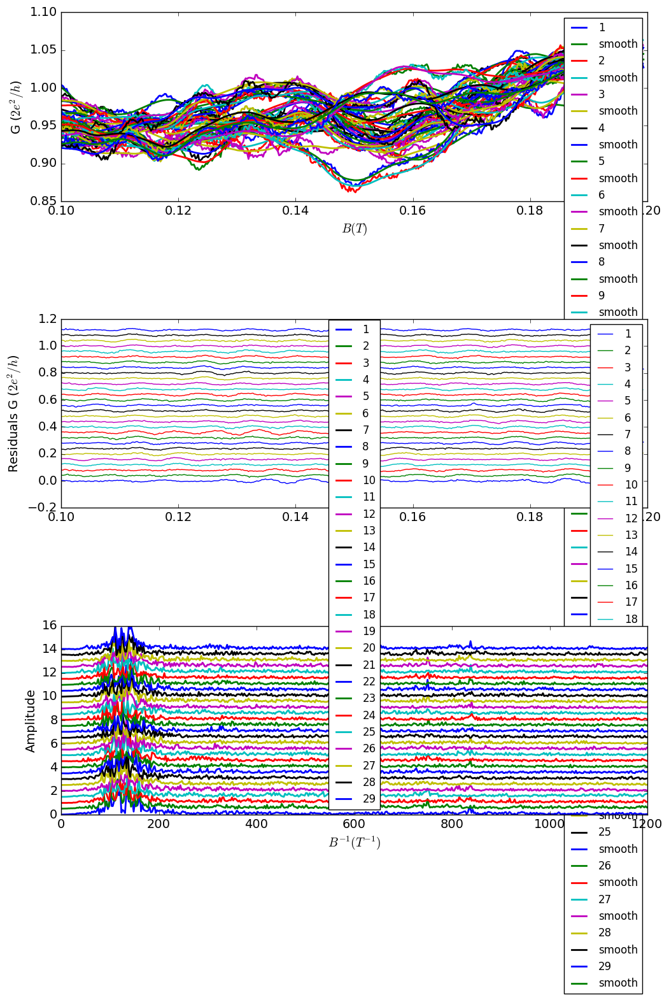

In [563]:
inputFile_around_zero_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_1.dat'
inputFile_around_zero_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_2.dat'
inputFile_around_zero_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_3.dat'
inputFile_around_zero_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_4.dat'
inputFile_around_zero_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_5.dat'
inputFile_around_zero_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_6.dat'
inputFile_around_zero_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_7.dat'
inputFile_around_zero_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_8.dat'
inputFile_around_zero_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_9.dat'
inputFile_around_zero_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_10.dat'
inputFile_around_zero_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_11.dat'
inputFile_around_zero_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_12.dat'
inputFile_around_zero_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_13.dat'
inputFile_around_zero_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_14.dat'
inputFile_around_zero_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_15.dat'
inputFile_around_zero_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_16.dat'
inputFile_around_zero_17 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_17.dat'
inputFile_around_zero_18 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_18.dat'
inputFile_around_zero_19 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_19.dat'
inputFile_around_zero_20 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_20.dat'
inputFile_around_zero_21 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_21.dat'
inputFile_around_zero_22 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_22.dat'
inputFile_around_zero_23 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_23.dat'
inputFile_around_zero_24 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_24.dat'
inputFile_around_zero_25 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_25.dat'
inputFile_around_zero_26 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_26.dat'
inputFile_around_zero_27 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_27.dat'
inputFile_around_zero_28 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_28.dat'
inputFile_around_zero_29 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_29.dat'
inputFile_around_zero_30 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_AB_around_zero_30.dat'

window = 65
inputFiles = [ inputFile_around_zero_1, inputFile_around_zero_2, inputFile_around_zero_3, inputFile_around_zero_4,
             inputFile_around_zero_5, inputFile_around_zero_6, inputFile_around_zero_7, inputFile_around_zero_8,
             inputFile_around_zero_9, inputFile_around_zero_10, 
             inputFile_around_zero_11, inputFile_around_zero_12 ,
              inputFile_around_zero_13, inputFile_around_zero_14,
             inputFile_around_zero_15, inputFile_around_zero_16,
             inputFile_around_zero_17, inputFile_around_zero_18,
             inputFile_around_zero_19, inputFile_around_zero_20,
             inputFile_around_zero_21, inputFile_around_zero_22 ,
              inputFile_around_zero_23, inputFile_around_zero_24,
             inputFile_around_zero_25, inputFile_around_zero_26,
             inputFile_around_zero_27, inputFile_around_zero_28,
             inputFile_around_zero_29]
labels = ( '1', '2', '3', '4', '5', '6', '7', '8', '9', '10',
         '11', '12', '13', '14', '15', '16', '17', '18', '19', '20',
         '21', '22', '23', '24', '25', '26', '27', '28', '29')
windows = ( window, window, window, window, window, window, window, window, window, window,
          window, window, window, window, window, window, window, window, window, window,
          window, window, window, window, window, window, window, window, window)
orders = (  3 , 3, 3, 3, 3, 3, 3, 3, 3, 3,  3 , 3, 3, 3, 3, 3, 3, 3, 3, 3 , 3 , 3, 3, 3, 3, 3, 3, 3, 3 )
plot_name = 'around_zero'

magnetoconductance(inputFiles , windows, orders, labels, plot_name, plot= True);

(array([    2.51481857,     5.02963714,     7.54445571,    10.05927427,
           12.57409284,    15.08891141,    17.60372998,    20.11854855,
           22.63336712,    25.14818568,    27.66300425,    30.17782282,
           32.69264139,    35.20745996,    37.72227853,    40.23709709,
           42.75191566,    45.26673423,    47.7815528 ,    50.29637137,
           52.81118994,    55.32600851,    57.84082707,    60.35564564,
           62.87046421,    65.38528278,    67.90010135,    70.41491992,
           72.92973848,    75.44455705,    77.95937562,    80.47419419,
           82.98901276,    85.50383133,    88.01864989,    90.53346846,
           93.04828703,    95.5631056 ,    98.07792417,   100.59274274,
          103.1075613 ,   105.62237987,   108.13719844,   110.65201701,
          113.16683558,   115.68165415,   118.19647272,   120.71129128,
          123.22610985,   125.74092842,   128.25574699,   130.77056556,
          133.28538413,   135.80020269,   138.31502126,   140.82

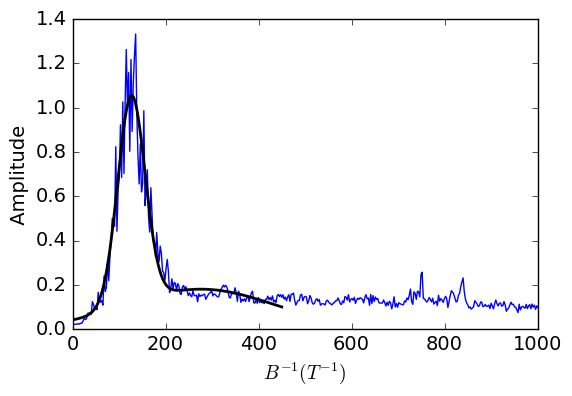

In [559]:
window = 65
inputFiles = [ inputFile_around_zero_1, inputFile_around_zero_2, inputFile_around_zero_3, inputFile_around_zero_4,
             inputFile_around_zero_5, inputFile_around_zero_6, inputFile_around_zero_7, inputFile_around_zero_8,
             inputFile_around_zero_9, inputFile_around_zero_10, 
             inputFile_around_zero_11, inputFile_around_zero_12 ,
              inputFile_around_zero_13, inputFile_around_zero_14,
             inputFile_around_zero_15, inputFile_around_zero_16,
             inputFile_around_zero_17, inputFile_around_zero_18,
             inputFile_around_zero_19, inputFile_around_zero_20]
labels = ( '1', '2', '3', '4', '5', '6', '7', '8', '9', '10',
         '11', '12', '13', '14', '15', '16', '17', '18', '19', '20')
windows = ( window, window, window, window, window, window, window, window, window, window,
          window, window, window, window, window, window, window, window, window, window)
orders = (  3 , 3, 3, 3, 3, 3, 3, 3, 3, 3,  3 , 3, 3, 3, 3, 3, 3, 3, 3, 3 )
plot_name = 'around_zero_average'
T= 0.017
magnetconductance_average(inputFiles, windows, orders, labels, T, plot_name);

# AB oscillations as a function of BG

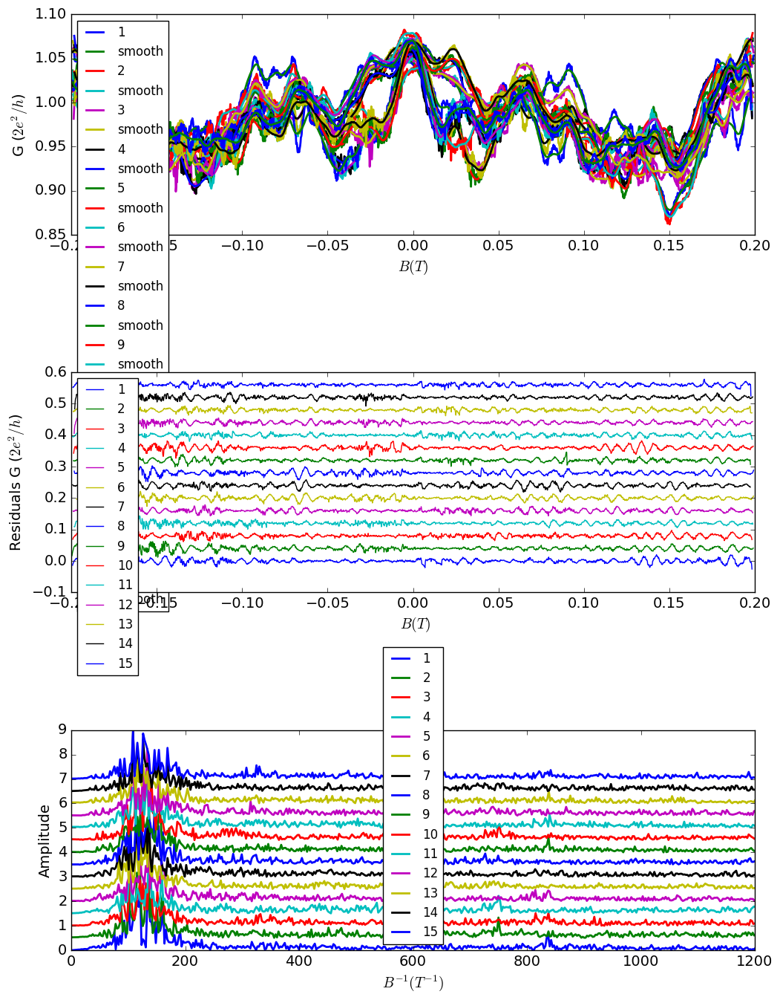

In [571]:
inputFile_oscillations_BG_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_1.dat'
inputFile_oscillations_BG_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_2.dat'
inputFile_oscillations_BG_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_3.dat'
inputFile_oscillations_BG_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_4.dat'
inputFile_oscillations_BG_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_5.dat'
inputFile_oscillations_BG_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_6.dat'
inputFile_oscillations_BG_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_7.dat'
inputFile_oscillations_BG_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_8.dat'
inputFile_oscillations_BG_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_9.dat'
inputFile_oscillations_BG_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_10.dat'
inputFile_oscillations_BG_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_11.dat'
inputFile_oscillations_BG_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_12.dat'
inputFile_oscillations_BG_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_13.dat'
inputFile_oscillations_BG_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_14.dat'
inputFile_oscillations_BG_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops7491\\loop2_oscillations_BG_15.dat'


window = 67
inputFiles = [ inputFile_around_zero_1, inputFile_around_zero_2, inputFile_around_zero_3, inputFile_around_zero_4,
             inputFile_around_zero_5, inputFile_around_zero_6, inputFile_around_zero_7, inputFile_around_zero_8,
             inputFile_around_zero_9, inputFile_around_zero_10, 
             inputFile_around_zero_11, inputFile_around_zero_12,
             inputFile_around_zero_13, inputFile_around_zero_14, inputFile_around_zero_15]

labels = ( '1', '2', '3', '4', '5', '6', '7', '8', '9', '10',
         '11', '12', '13', '14', '15')
windows = ( window, window, window, window, window, window, window, window, window, window,
          window, window, window, window, window)
orders = (  3 , 3, 3, 3, 3, 3, 3, 3, 3, 3,  3 , 3, 3 , 3 , 3)
plot_name = 'BG'

magnetoconductance(inputFiles , windows, orders, labels, plot_name, plot= True);



# Device 8382


# Loop 1 8382

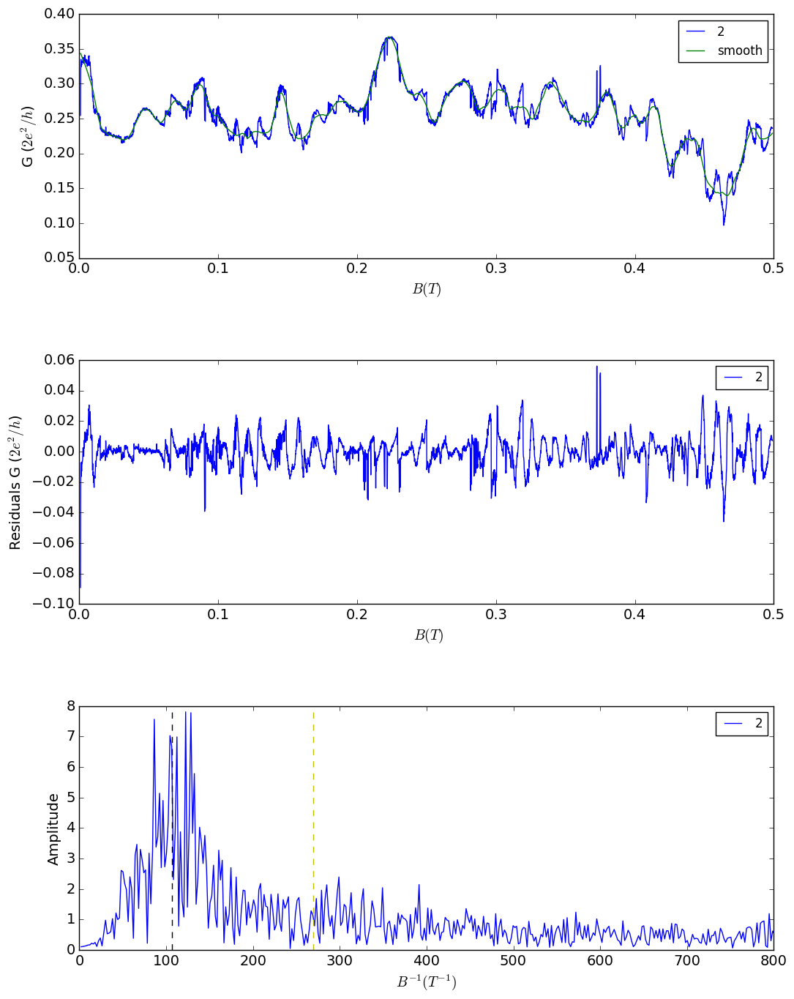

In [650]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop1_sweep_Bx_1.dat'
inputFiles = [inputFile]
labels =  ['2']
windows = [175]
#105
orders = [2]
plot_name = 'AB_long_range'
B_min = 0
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

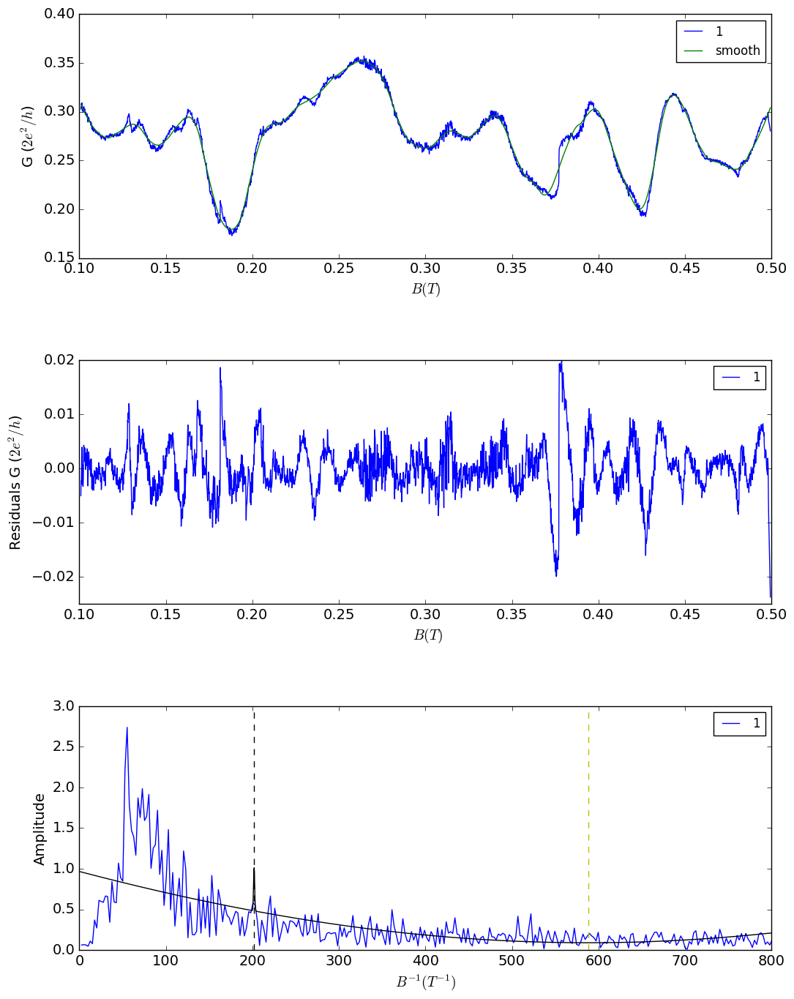

In [2074]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop1_17mk_1.dat'
inputFiles = [inputFile]
labels =  ['1']
windows = [175]
#105
orders = [2]
plot_name = 'loop1_8382'
B_min = 0.1
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

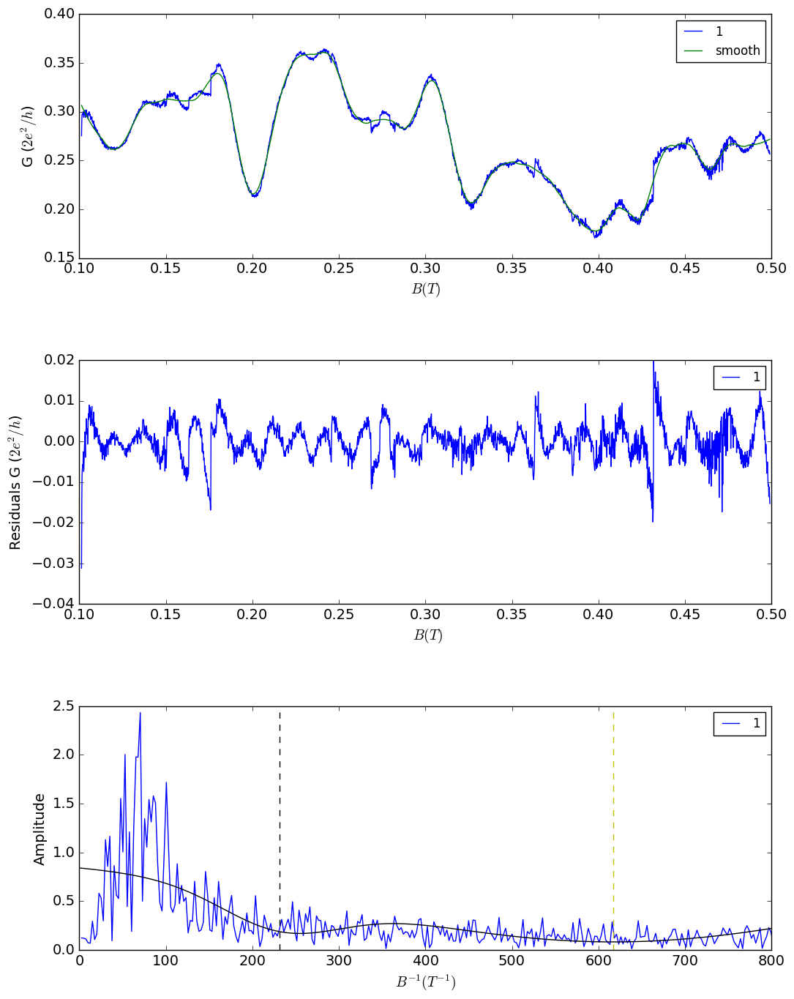

In [2075]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop1_17mk_2.dat'
inputFiles = [inputFile]
labels =  ['1']
windows = [175]
#105
orders = [2]
plot_name = 'loop1_8382'
B_min = 0.1
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

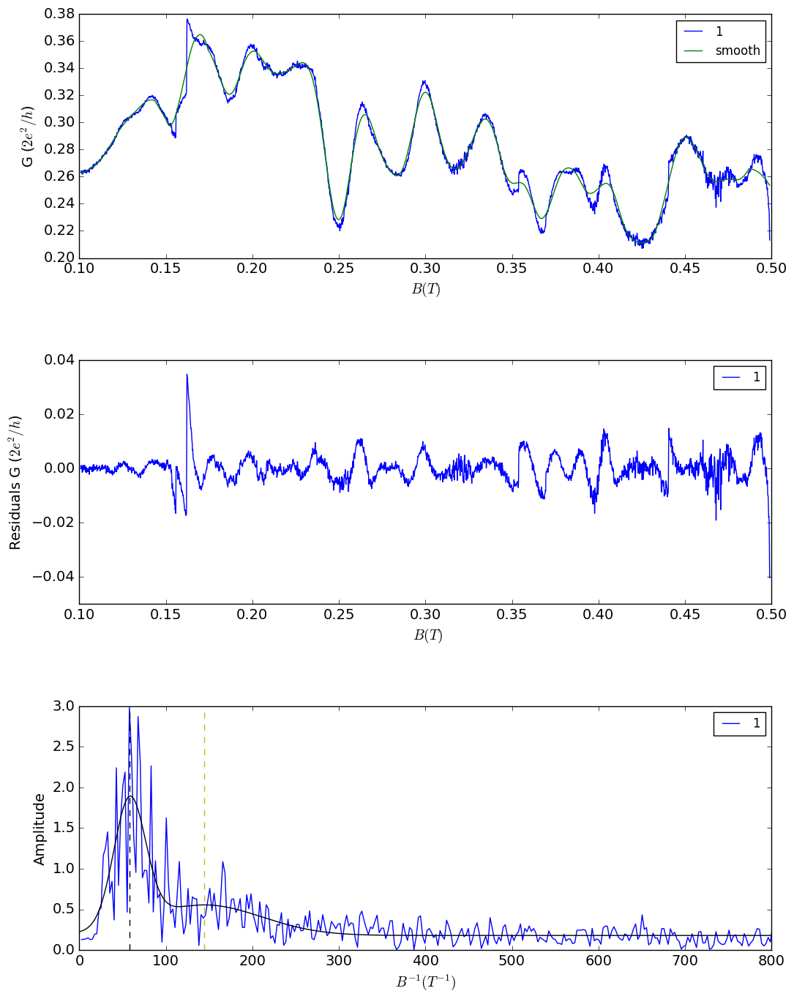

In [2076]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop1_17mk_3.dat'
inputFiles = [inputFile]
labels =  ['1']
windows = [175]
#105
orders = [2]
plot_name = 'loop1_8382'
B_min = 0.1
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

# Loop 2

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 65.8459957841 1.12424639179
Amplitude: 64.9037032906 4.88594126029
B parameter: 0.421642586111 0.0697280547348
FIT PARAMETERS FOR AAS:
f: 124.656322045 10.8728746246
Amplitude: 29.8348951712 3.25955244002
B parameter: 0.0528272093203 0.010417830954
offset: 0.450256491591 0.0787511446772


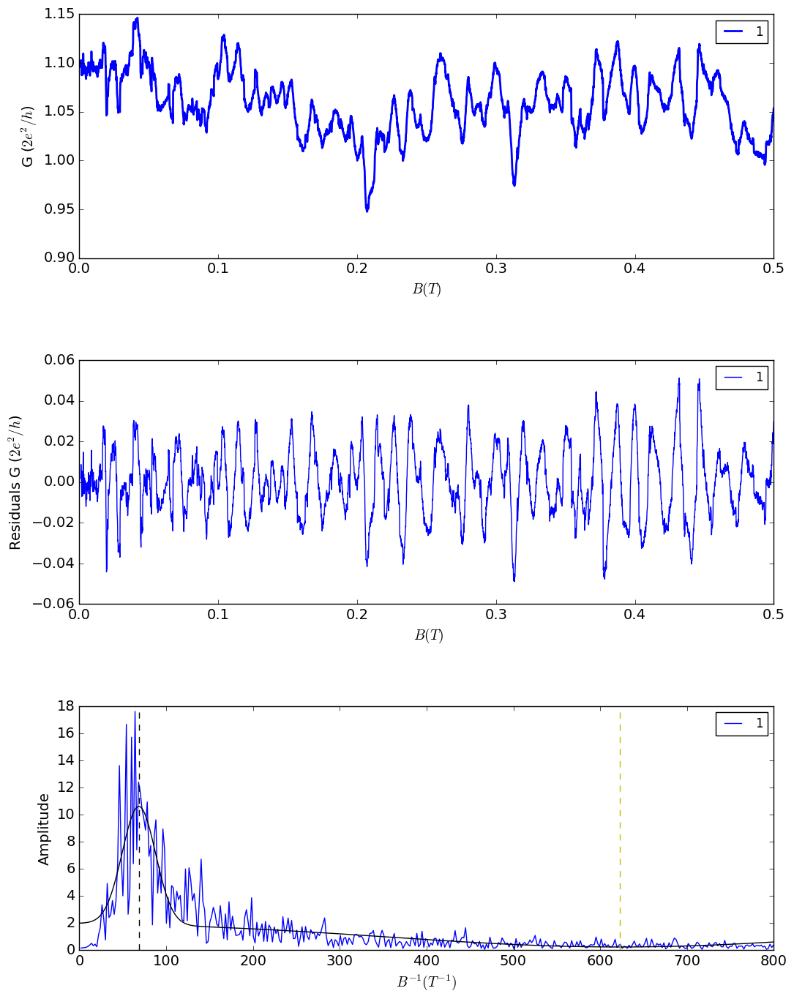

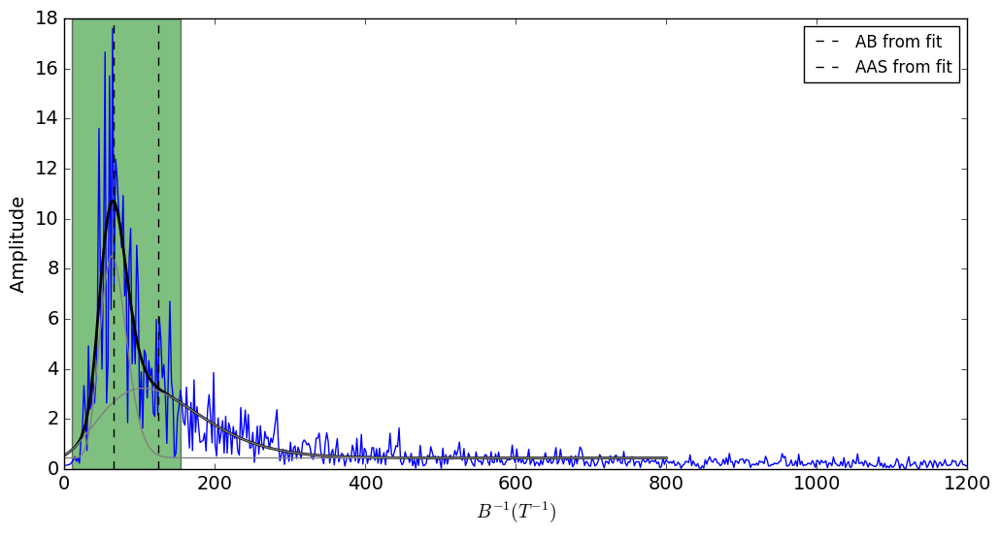

In [2093]:
inputFile_oscillations_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_1.dat'
inputFiles = [inputFile_oscillations_1 ]
labels =  ['1']
windows = [301]
#105
orders = [2]
plot_name = 'AB_AAS'
B_min = 0.0
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


plot_name = 'loop2_17mk_AAS'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.0
B_max = 0.5
T = 0.017
average17mk_1 = magnetconductance_average_special(inputFiles , windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);
plot_name = 'loop2_17mk_firstsweep_1'
#average17mk_2 = magnetconductance_average_special_singlepeak(inputFiles , windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

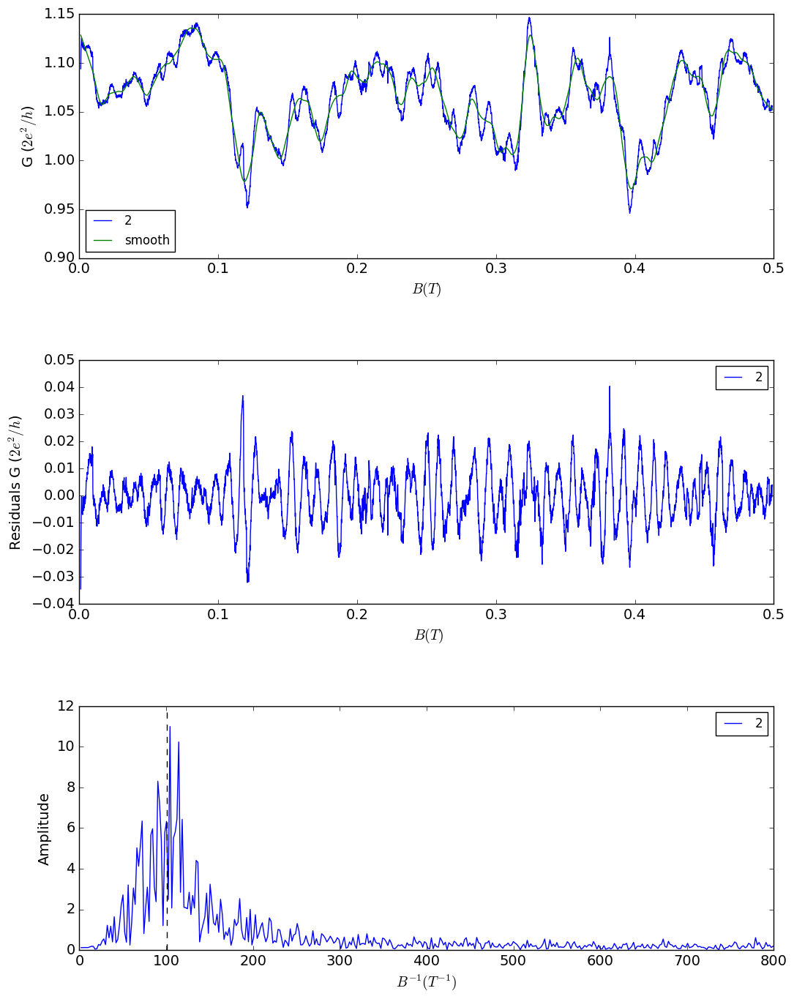

In [647]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_2.dat'
inputFiles = [inputFile]
labels =  ['2']
windows = [175]
#105
orders = [2]
plot_name = 'AB_long_range'
B_min = 0
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

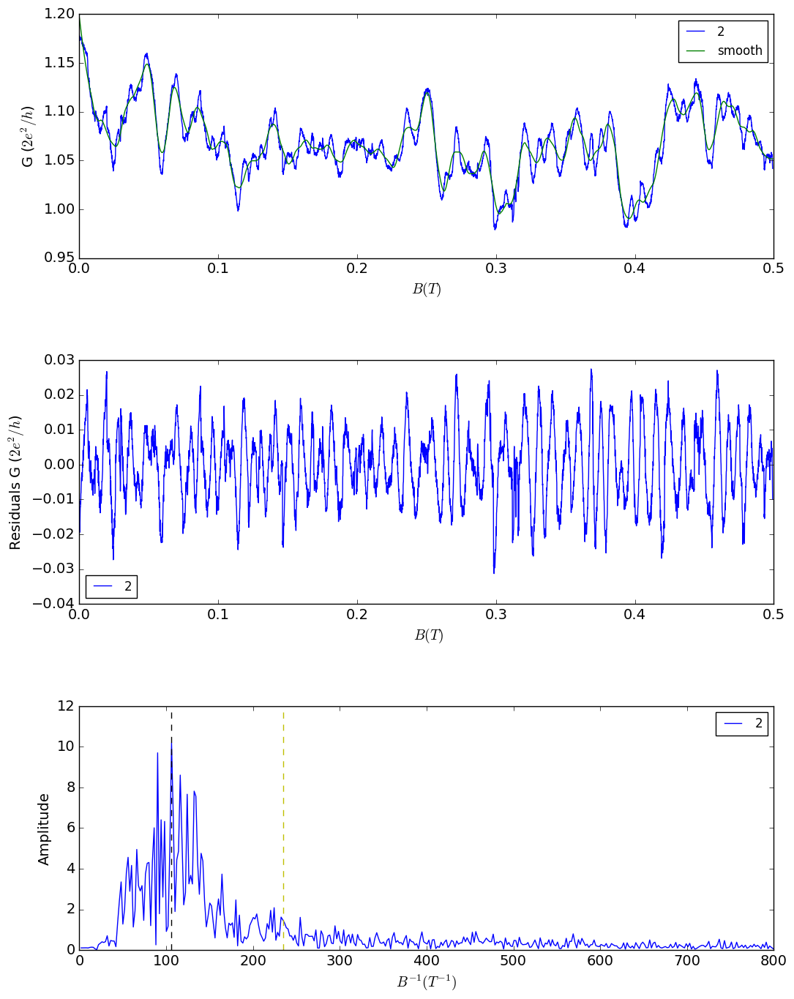

In [649]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_3.dat'
inputFiles = [inputFile]
labels =  ['2']
windows = [175]
#105
orders = [2]
plot_name = 'AB_AAS_2'
B_min = 0
B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 62.521492735 0.198207332674
Amplitude: 31.4030086968 2.04784480327
B parameter: 15.989667287 2.6161795298
FIT PARAMETERS FOR AAS:
f: 84.8042723385 2.50664184988
Amplitude: 12.5257347134 0.609917286384
B parameter: 0.0776876354343 0.00763756855763


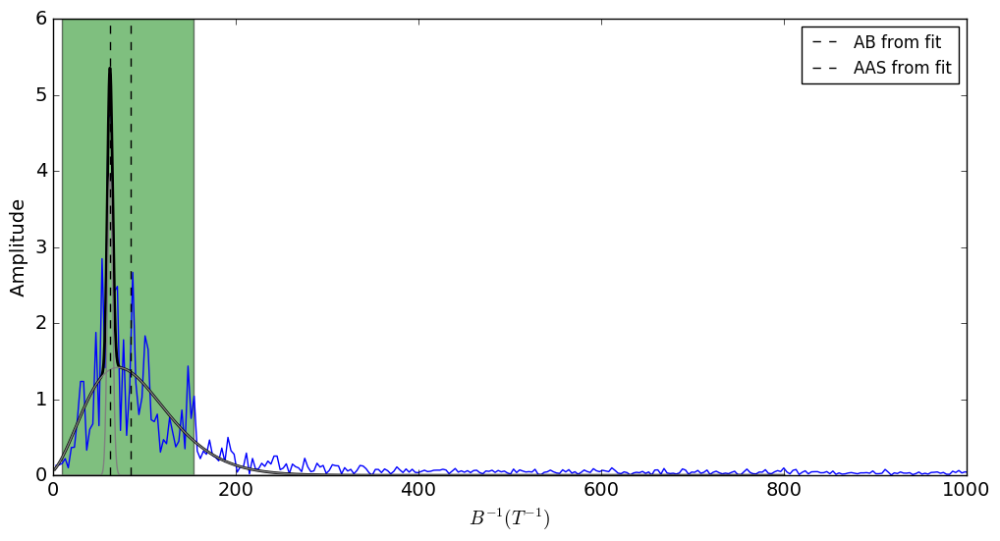

In [1173]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_1.dat'

inputFiles = [inputFile]
labels =  ['2']
windows = [169]
#105
orders = [2]
plot_name = '17mK_trace'
B_min = 0.2
B_max = 0.5
#magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True); 
T = '0.017'

A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
average17mk_1 = magnetconductance_average_special(inputFiles , windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


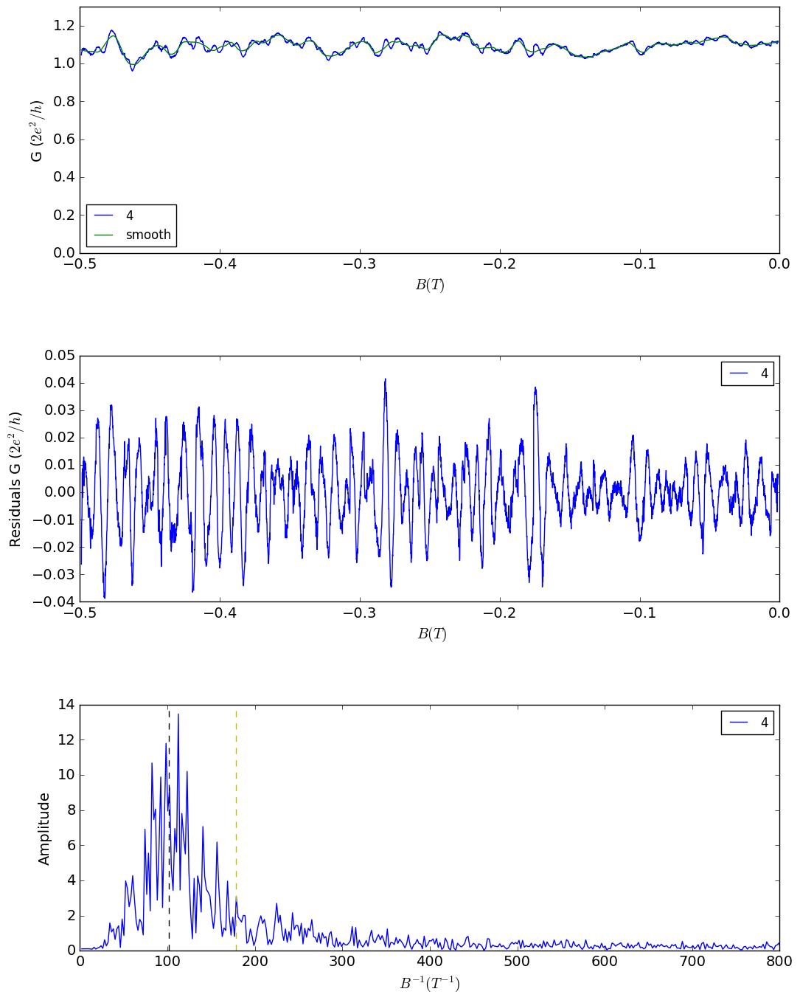

In [639]:
inputFile = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_4.dat'
inputFiles = [inputFile]
labels =  ['4']
windows = [175]
#105
orders = [2]
plot_name = 'AB_AAS_4'
B_min = -0.5
B_max = 0.
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);

# Temperature dependence - Loop 2

# T = 17 mk

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 71.5902170051 1.63124694391
Amplitude: 26.2151933881 6.01574760285
B parameter: 0.223399190062 0.0465950030067
FIT PARAMETERS FOR AAS:
f: 131.257636724 26.1804780284
Amplitude: 12.4388229279 2.95673790209
B parameter: 0.0720334652713 0.029434124139
offset: 0.155428624534 0.0207831261433


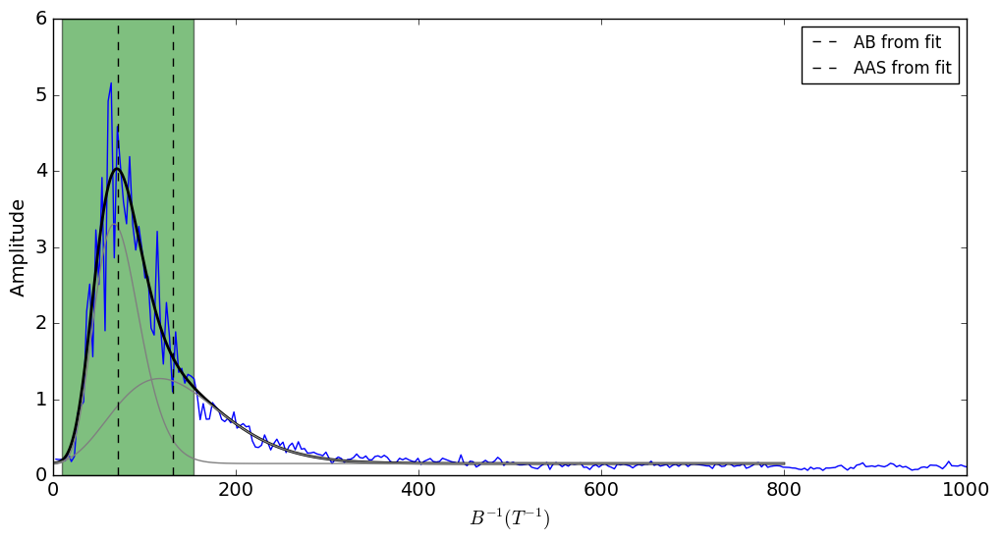

In [1818]:
T = '17 mk'
inputFile17mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_1.dat'
inputFile17mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_2.dat'
inputFile17mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_3.dat'
inputFile17mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_4.dat'
inputFile17mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_5.dat'
inputFile17mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_6.dat'
inputFile17mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_7.dat'
inputFile17mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_8.dat'
inputFile17mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_9.dat'
inputFile17mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_10.dat'
inputFile17mk_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_11.dat'
inputFile17mk_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_17mk_12.dat'
inputFile17mk_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_3.dat'
inputFile17mk_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_2.dat'
inputFile17mk_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_sweep_Bx_1.dat'


#bad: inputFile17mk_10,  inputFile17mk_11,

inputFiles17mk = [ inputFile17mk_3,inputFile17mk_4,
             inputFile17mk_6, inputFile17mk_8,
            inputFile17mk_12,
             inputFile17mk_14, inputFile17mk_15]
labels =  ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11','12', '13', '14', '15']
window = 169
windows = [window, window, window, window, window, window,
          window, window, window, window, window, window, window, window, window]
order = 2
orders = [order, order, order, order, order, order,
         order, order, order, order, order, order, order, order, order]

B_min = 0.2
B_max = 0.5


plot_name = 'loop2_17mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
average17mk_8382_2 = magnetconductance_average_special(inputFiles17mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 40 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 66.1557562185 2.89336957958
Amplitude: 24.951447156 7.25141888754
B parameter: 0.221244203573 0.0428879159813
FIT PARAMETERS FOR AAS:
f: 128.790848688 42.6574247149
Amplitude: 8.43835520558 2.9100079266
B parameter: 0.0899644802499 0.0776481901346
offset: 0.0828447220098 0.0169877121525


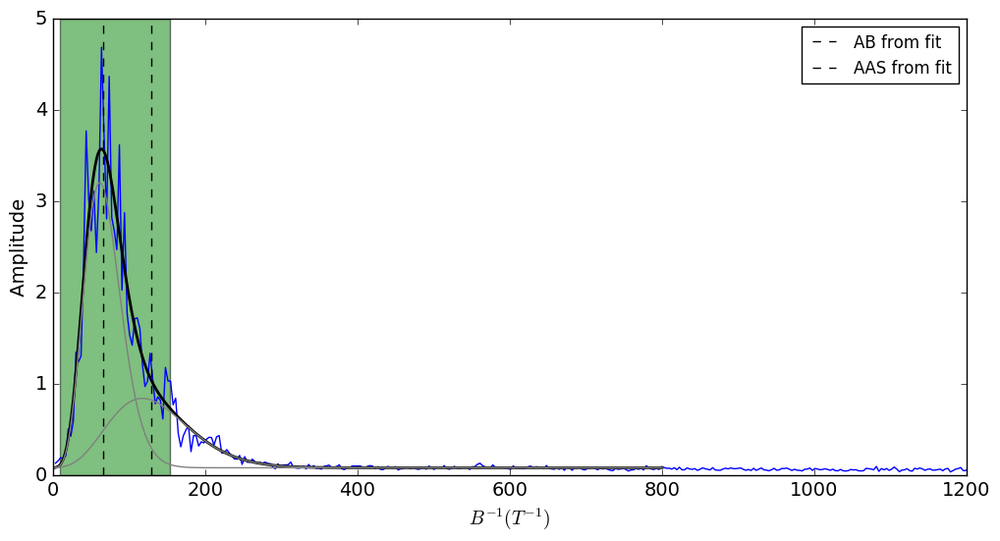

In [2094]:

inputFile40mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_1.dat'
inputFile40mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_2.dat'
inputFile40mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_3.dat'
inputFile40mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_4.dat'
inputFile40mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_5.dat'
inputFile40mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_6.dat'
inputFile40mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_7.dat'
inputFile40mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_8.dat'


inputFiles40mk = [inputFile40mk_1, inputFile40mk_2, inputFile40mk_3,inputFile40mk_4,
             inputFile40mk_5, inputFile40mk_6, inputFile40mk_7, inputFile40mk_8]

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169

windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]
plot_name = 'Temperature_dependence_loop2_40mk'
B_min = 0.2
B_max = 0.5

#magnetoconductance_range(inputFiles40mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


plot_name = 'average_loop2_40mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
plot_name = 'loop2_40mk'
#average40mk = magnetconductance_average(inputFiles40mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);

average40mk_8382_2 = magnetconductance_average_special(inputFiles40mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max)


# T = 60 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 62.7507728867 1.13797166329
Amplitude: 24.9737782356 3.26502041632
B parameter: 0.312480326819 0.0559145175843
FIT PARAMETERS FOR AAS:
f: 115.937819217 19.7295063486
Amplitude: 8.73927526175 1.746732931
B parameter: 0.0734389476915 0.0264873375972
offset: 0.101115183596 0.0226551081842


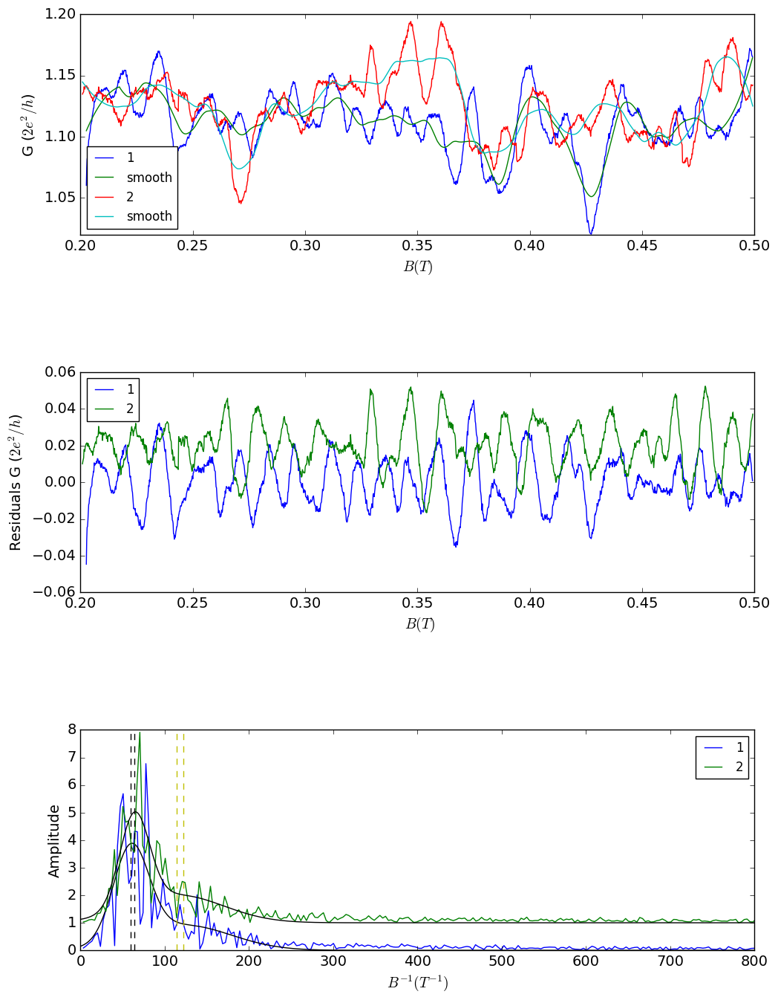

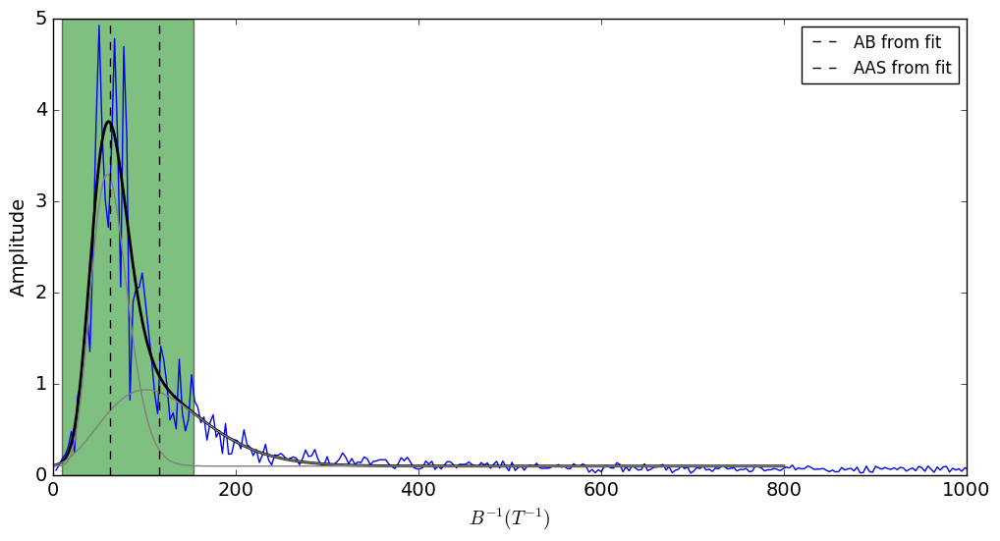

In [1820]:
inputFile40mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_9.dat'
inputFile40mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_10.dat'
inputFile40mk_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_11.dat'
inputFile40mk_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_12.dat'
inputFile40mk_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_13.dat'
inputFile40mk_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_14.dat'
inputFile40mk_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_15.dat'
inputFile40mk_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_40mk_16.dat'

#bad 12
inputFiles60mk = [ inputFile40mk_10, inputFile40mk_14]

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]
plot_name = 'Temperature_dependence_loop2_60mk'
B_min = 0.2
B_max = 0.5

magnetoconductance_range(inputFiles60mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


plot_name = 'average_loop2_60mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
plot_name = 'loop2_60mk'
#average60mk = magnetconductance_average(inputFiles60mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
plot_name = 'special_function_single_peak'
average60mk_8382_2 = magnetconductance_average_special(inputFiles60mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max)

# T = 80 mk

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 72.4691714234 1.90153928436
Amplitude: 20.9649902557 2.55090407866
B parameter: 0.210514178379 0.0380224772024
FIT PARAMETERS FOR AAS:
f: 121.453473163 23.7580987737
Amplitude: 6.21571258936 2.21114540439
B parameter: 0.0500510906499 0.0160915416298
offset: 0.0950835582911 0.0239826235085


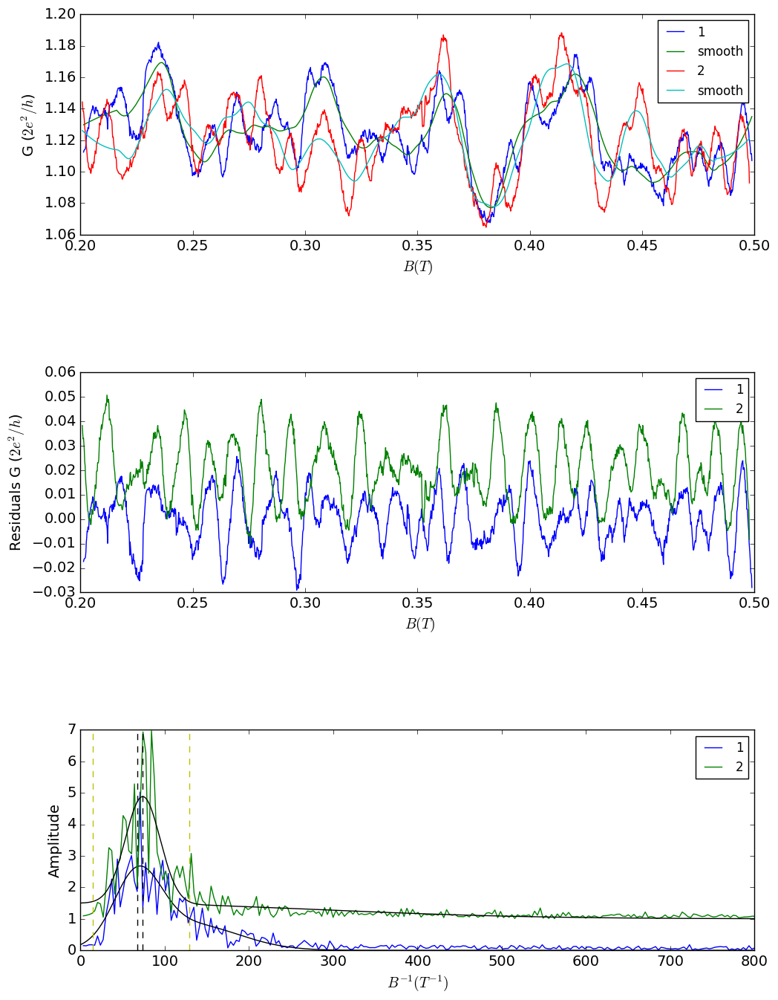

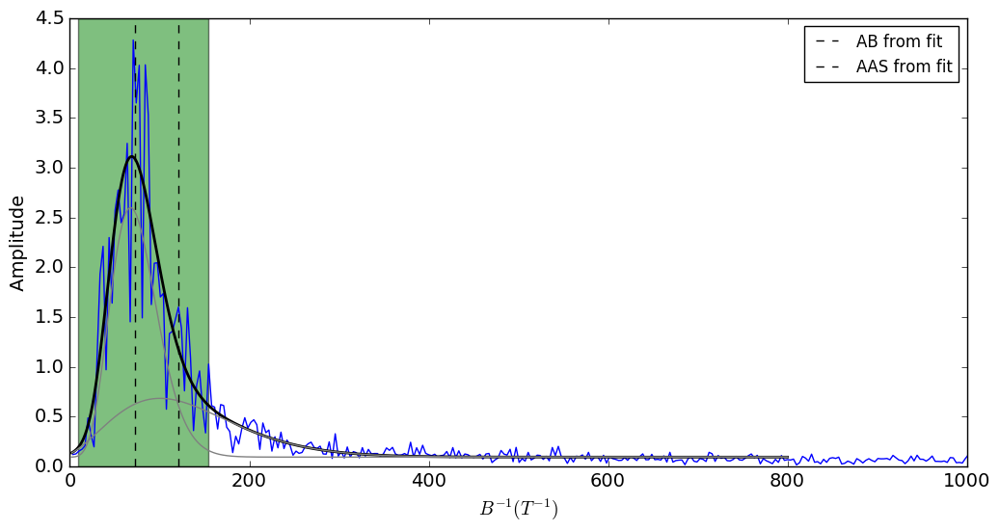

In [1823]:
T = '80 mk'
inputFile90mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_1.dat'
inputFile90mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_2.dat'
inputFile90mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_3.dat'
inputFile90mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_4.dat'
inputFile90mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_5.dat'
inputFile90mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_6.dat'
inputFile90mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_7.dat'
inputFile90mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_8.dat'
inputFile90mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_9.dat'
inputFile90mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_10.dat'


#bad 3
inputFiles90mk = [ inputFile90mk_6, inputFile90mk_7]

labels =  ['1', '2', '3', '4', '5', '6', '7']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order]
plot_name = 'Temperature_dependence_loop2_80mk'
B_min = 0.2
B_max = 0.5

magnetoconductance_range(inputFiles90mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


plot_name = 'average_loop2_90mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
plot_name = 'loop2_80mk'
#average90mk = magnetconductance_average(inputFiles90mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
plot_name = 'special_function_single_peak'
average80mk_8382_2 = magnetconductance_average_special(inputFiles90mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);




# T = 100 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 65.470907475 4.68444215545
Amplitude: 19.3549333447 2.15719910145
B parameter: 0.225472601705 0.051949965871
FIT PARAMETERS FOR AAS:
f: 143.728984092 21.6917629637
Amplitude: 7.35383041916 1.37912951984
B parameter: 0.163818988805 0.134953432263
offset: 0.0728542425665 0.026162385998


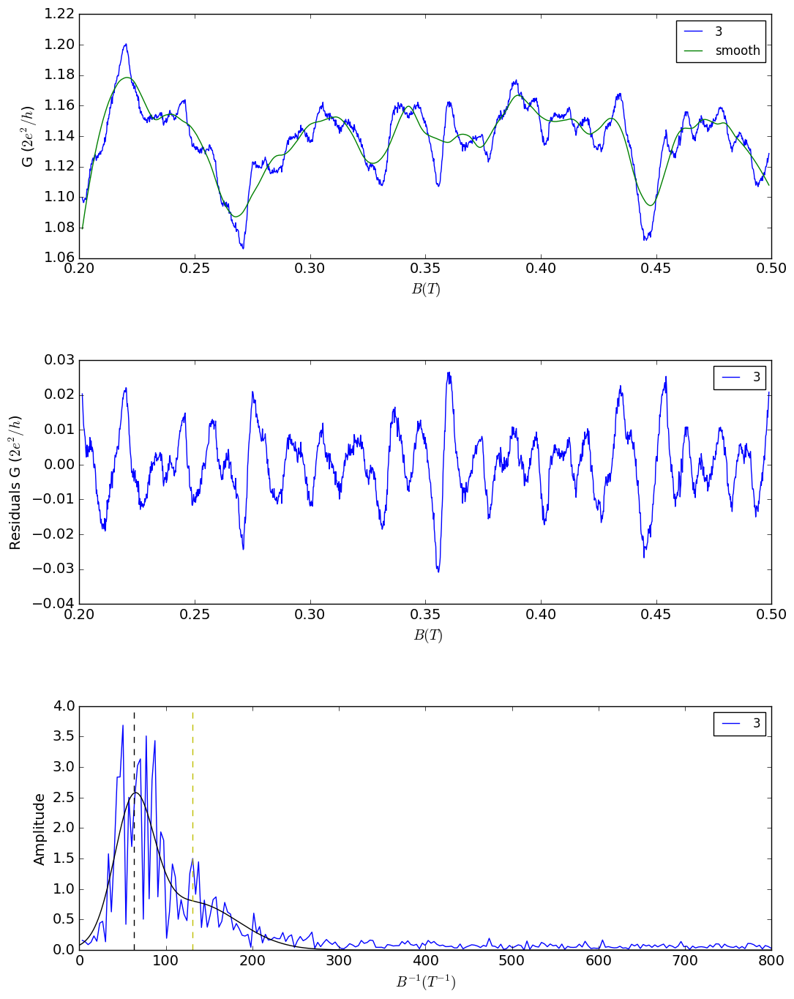

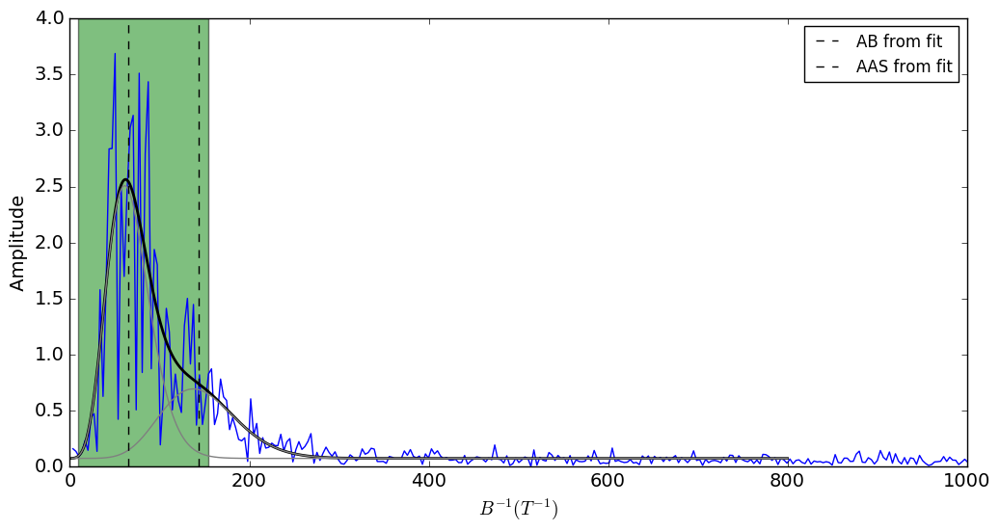

In [1822]:
T = '100 mk'

inputFile100mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_3.dat'
inputFile100mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_4.dat'
inputFile100mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_5.dat'
inputFile100mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_6.dat'
inputFile100mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_7.dat'
inputFile100mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_8.dat'



#bad 5
inputFiles100mk = [ inputFile100mk_3]

labels =  [ '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window]
order = 2
orders = [order, order, order, order, order]
plot_name = 'Temperature_dependence_loop2_100mk'
B_min = 0.2
B_max = 0.5

magnetoconductance_range(inputFiles100mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


plot_name = 'average_loop2_100mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
plot_name = 'loop2_80mk'
#average90mk = magnetconductance_average(inputFiles90mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
plot_name = 'special_function_single_peak'
average100mk_8382_2 = magnetconductance_average_special(inputFiles100mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);




# T = 150 mk

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 62.965182907 2.12861806924
Amplitude: 16.354673927 3.82428860056
B parameter: 0.266011106383 0.0583003476871
FIT PARAMETERS FOR AAS:
f: 129.506701997 46.1300497421
Amplitude: 4.3690083201 1.2257835779
B parameter: 0.0830889593038 0.0887632795932
offset: 0.122557250977 0.015446821956


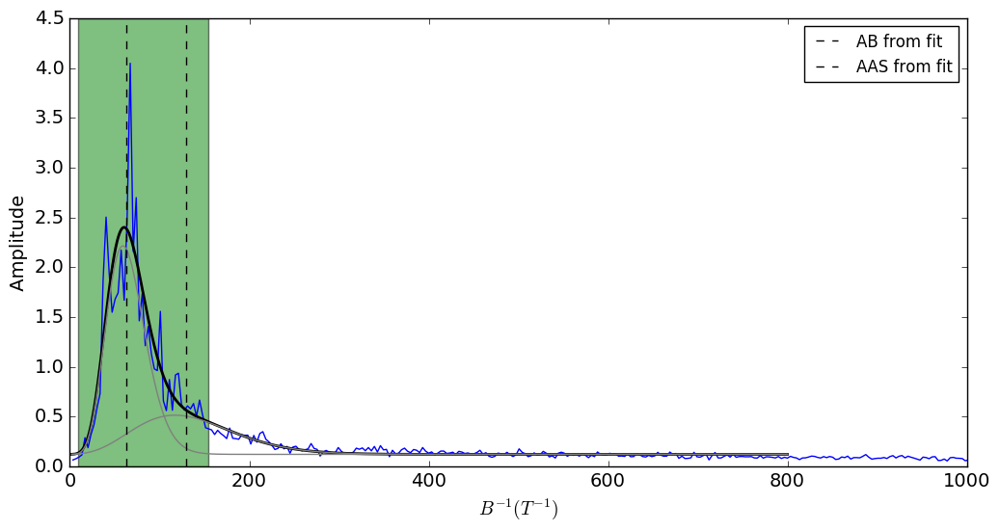

In [1824]:
T = '150 mk'
inputFile150mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_1.dat'
inputFile150mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_2.dat'
inputFile150mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_3.dat'
inputFile150mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_4.dat'
inputFile150mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_5.dat'
inputFile150mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_6.dat'
inputFile150mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_7.dat'
inputFile150mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_8.dat'
inputFile150mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_9.dat'
inputFile150mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_10.dat'
inputFile150mk_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_150mk_11.dat'

inputFiles150mk = [inputFile150mk_1, inputFile150mk_2, inputFile150mk_3,inputFile150mk_4,
             inputFile150mk_5, inputFile150mk_6, inputFile150mk_7,  inputFile150mk_8,
             inputFile150mk_9, inputFile150mk_10, inputFile150mk_11]

labels =  ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11']
window = 181
#169
windows = [window, window, window, window, window, 
          window, window, window, window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order, order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_150mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average150mk = magnetconductance_average_special_singlepeak(inputFiles150mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);
average150mk_8382_2 = magnetconductance_average_special(inputFiles150mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);



# T = 200 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 69.4838952646 1.65634630813
Amplitude: 11.2312880813 1.39250680147
B parameter: 0.25834767722 0.0461652391413
FIT PARAMETERS FOR AAS:
f: 105.334636144 16.202758609
Amplitude: 3.65759388969 1.31590433233
B parameter: 0.0601062446137 0.0176751637486
offset: 0.0716626592748 0.0113420942332


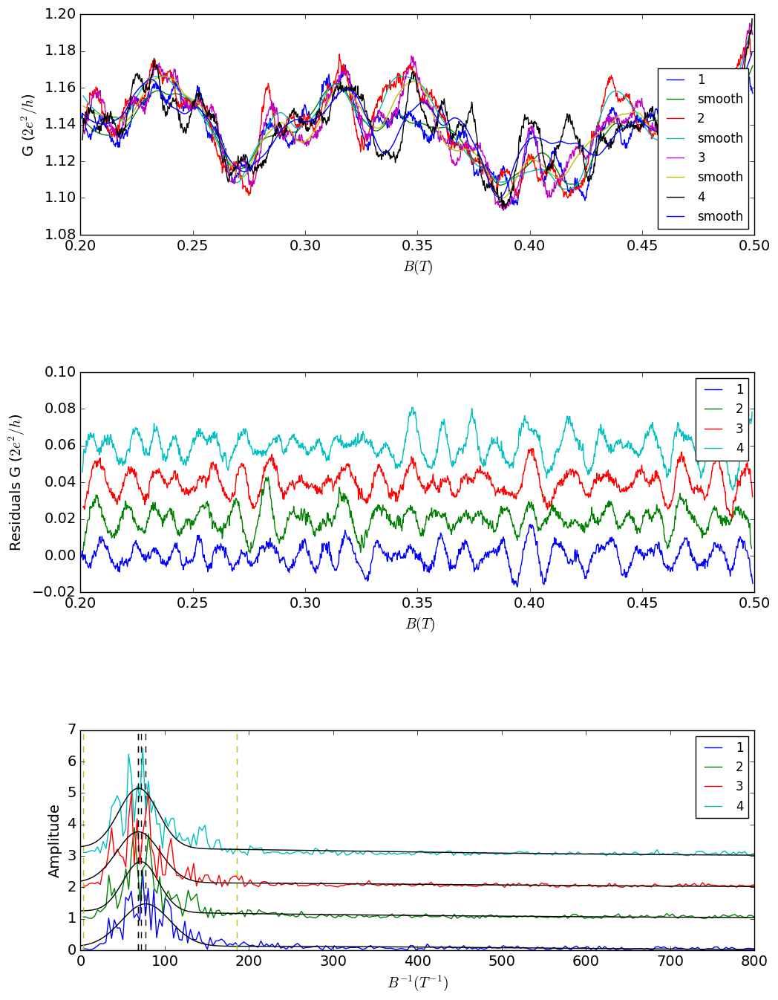

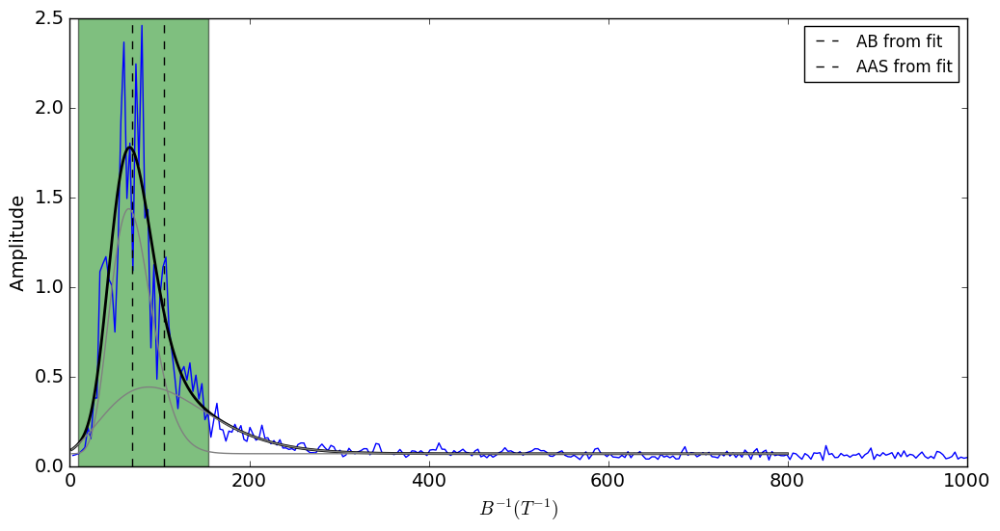

In [1825]:
T = '200 mk'

inputFile100mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_9.dat'
inputFile100mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_10.dat'
inputFile100mk_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_11.dat'
inputFile100mk_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_12.dat'
inputFile100mk_13 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_13.dat'
inputFile100mk_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_14.dat'
inputFile100mk_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_15.dat'
inputFile100mk_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_100mk_16.dat'



#bad 15
inputFiles100mk = [  inputFile100mk_10,  inputFile100mk_13, inputFile100mk_14, inputFile100mk_16]

labels =  [ '1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window,  window, window, window]
order = 2
orders = [order, order, order, order, order, order, order, order]
plot_name = 'Temperature_dependence_loop2_200mk'
B_min = 0.2
B_max = 0.5

magnetoconductance_range(inputFiles100mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


plot_name = 'average_loop2_200mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
plot_name = 'loop2_200mk'

average200mk_8382_2 = magnetconductance_average_special(inputFiles100mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max)

# T = 250 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 60.6326778308 1.45216410689
Amplitude: 12.5130138953 1.67179266134
B parameter: 0.312670654743 0.0395757642043
FIT PARAMETERS FOR AAS:
f: 122.795277125 21.9767065323
Amplitude: 3.58086893116 0.510642893337
B parameter: 0.106724180237 0.0675221053973
offset: 0.0890817734444 0.00739367104775


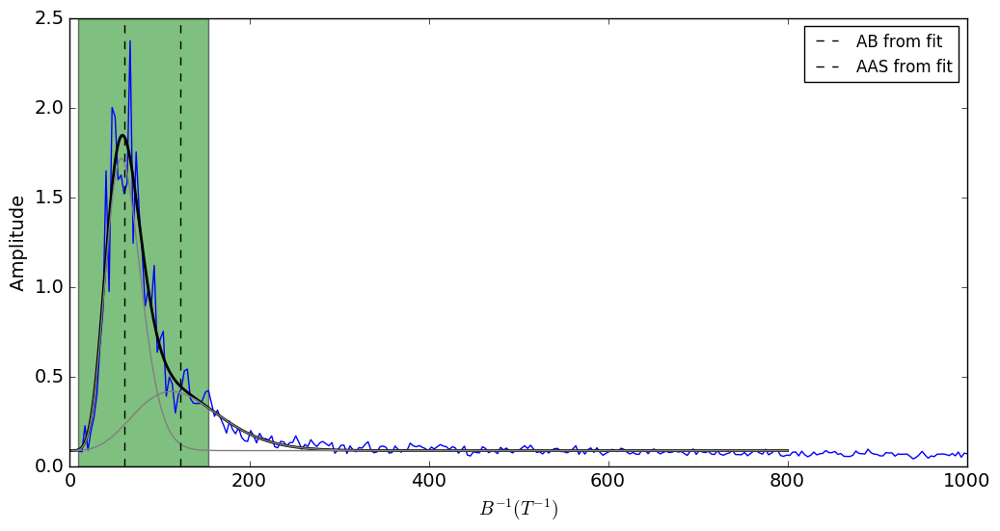

In [1826]:
T = '250 mk'
inputFile250mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_1.dat'
inputFile250mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_2.dat'
inputFile250mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_3.dat'
inputFile250mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_4.dat'
inputFile250mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_5.dat'
inputFile250mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_6.dat'
inputFile250mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_7.dat'
inputFile250mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_8.dat'


inputFiles250mk = [inputFile250mk_1, inputFile250mk_2, inputFile250mk_3,inputFile250mk_4,
             inputFile250mk_5, inputFile250mk_6, inputFile250mk_7,  inputFile250mk_8]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_250mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average250mk = magnetconductance_average_special_singlepeak(inputFiles250mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

average250mk_8382_2 = magnetconductance_average_special(inputFiles250mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 330 mk 

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 62.5521916171 1.43271475014
Amplitude: 9.99455306535 0.397039817518
B parameter: 0.320634992209 0.0292064714313
FIT PARAMETERS FOR AAS:
f: 126.932725863 8.72597871894
Amplitude: 2.76547717999 0.264547394055
B parameter: 0.229379440898 0.0987199112038
offset: 0.0801163121446 0.0049152750703


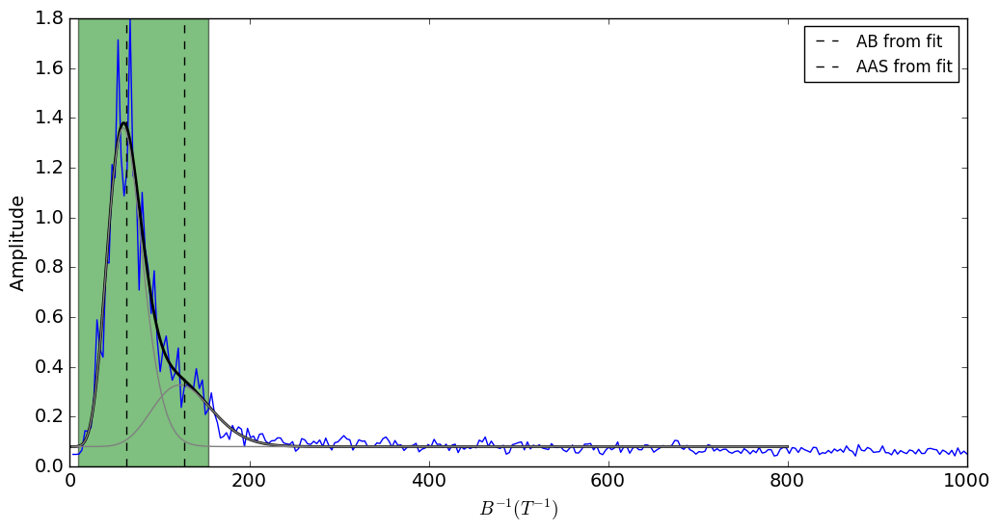

In [1827]:
T = '330 mk'
#despite the name, these correspond to 330 mK
inputFile250mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_9.dat'
inputFile250mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_10.dat'
inputFile250mk_11 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_11.dat'
inputFile250mk_12 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_12.dat'
inputFile250mk_13= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_13.dat'
inputFile250mk_14 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_14.dat'
inputFile250mk_15 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_15.dat'
inputFile250mk_16 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_16.dat'


inputFiles330mk = [inputFile250mk_9, inputFile250mk_10, inputFile250mk_11,
             inputFile250mk_13, inputFile250mk_14, inputFile250mk_15,  inputFile250mk_16]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_330mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average330mk = magnetconductance_average_special_singlepeak(inputFiles330mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

average330mk_8382_2 = magnetconductance_average_special(inputFiles330mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 400 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 61.630698888 0.977426617192
Amplitude: 6.89745475869 1.04741525744
B parameter: 0.313030324383 0.0475114694023
FIT PARAMETERS FOR AAS:
f: 117.206204372 24.3053646456
Amplitude: 2.03161198826 0.398474508659
B parameter: 0.0905677473184 0.0495768739058
offset: 0.0775056814978 0.00397122994535


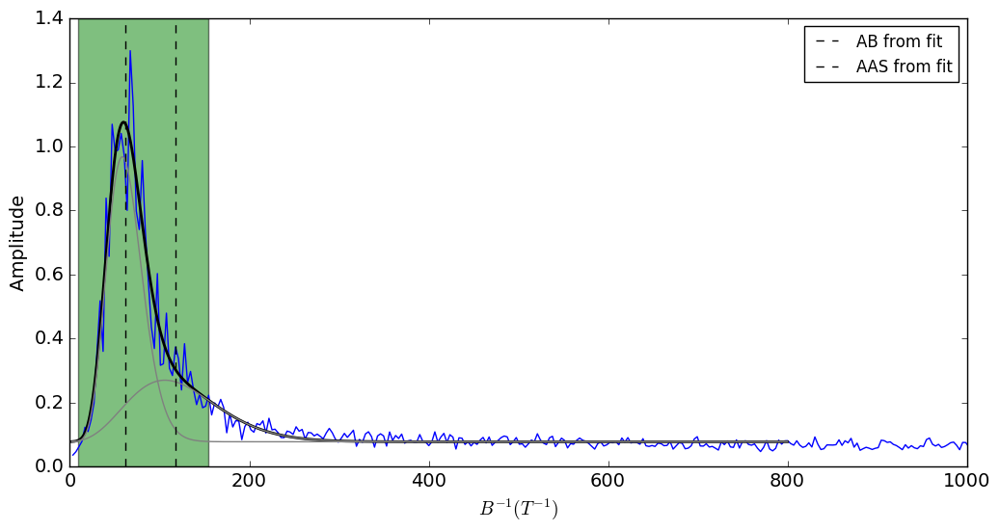

In [1830]:
T = '400 mk'
#despite the name, these correspond to 400 mK
inputFile250mk_17 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_17.dat'
inputFile250mk_18 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_18.dat'
inputFile250mk_19 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_19.dat'
inputFile250mk_20 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_20.dat'
inputFile250mk_21= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_21.dat'
inputFile250mk_22 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_22.dat'
inputFile250mk_23 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_23.dat'
inputFile250mk_24 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_24.dat'


inputFiles400mk = [inputFile250mk_17, inputFile250mk_18, inputFile250mk_19, inputFile250mk_20,
             inputFile250mk_21, inputFile250mk_22, inputFile250mk_23,  inputFile250mk_24]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_400mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average400mk = magnetconductance_average_special_singlepeak(inputFiles400mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


average400mk_8382_2 = magnetconductance_average_special(inputFiles400mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 480 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 61.8714983519 1.42107278179
Amplitude: 6.91812046122 0.19577197261
B parameter: 0.290008541887 0.0298326774068
FIT PARAMETERS FOR AAS:
f: 128.139256382 7.42080309176
Amplitude: 1.8737544219 0.223619957228
B parameter: 0.315020808586 0.145602273039
offset: 0.0750503459365 0.00417730859326


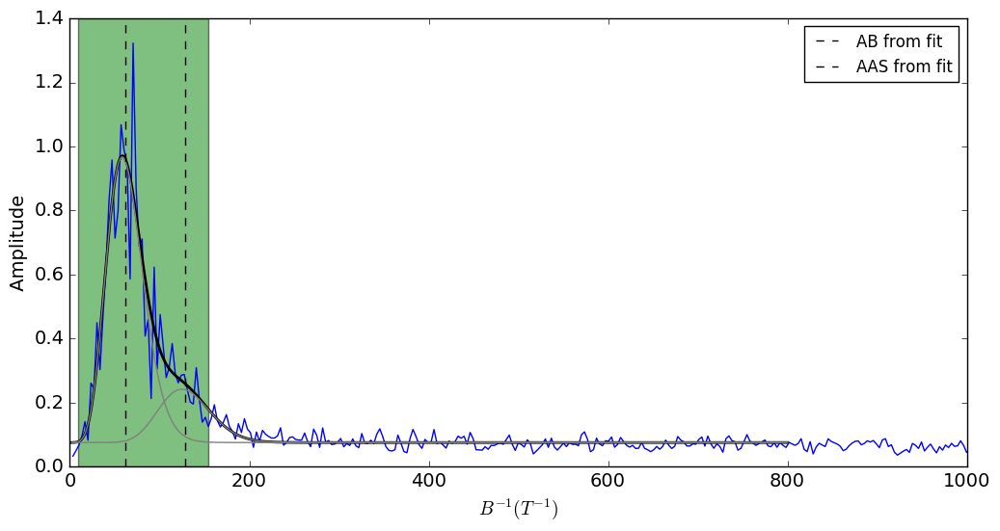

In [1831]:
T = '480 mk'
#despite the name, these correspond to 480 mK
inputFile250mk_25 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_25.dat'
inputFile250mk_29 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_29.dat'
inputFile250mk_30 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_30.dat'
inputFile250mk_31 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_31.dat'
inputFile250mk_32= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_32.dat'
inputFile250mk_33 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_33.dat'
inputFile250mk_34 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_34.dat'
inputFile250mk_35 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_35.dat'


inputFiles480mk = [ inputFile250mk_33, inputFile250mk_25, inputFile250mk_29, inputFile250mk_35]
             
    

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_480mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average480mk = magnetconductance_average_special_singlepeak(inputFiles480mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

average480mk_8382_2 = magnetconductance_average_special(inputFiles480mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 525 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 64.5891331428 2.2297890483
Amplitude: 6.96981219905 0.496517646494
B parameter: 0.263002777351 0.0284017726578
FIT PARAMETERS FOR AAS:
f: 131.302279681 23.2933066712
Amplitude: 1.22951836146 0.270388686809
B parameter: 0.178486150797 0.15417715497
offset: 0.0654632021862 0.00380450785658


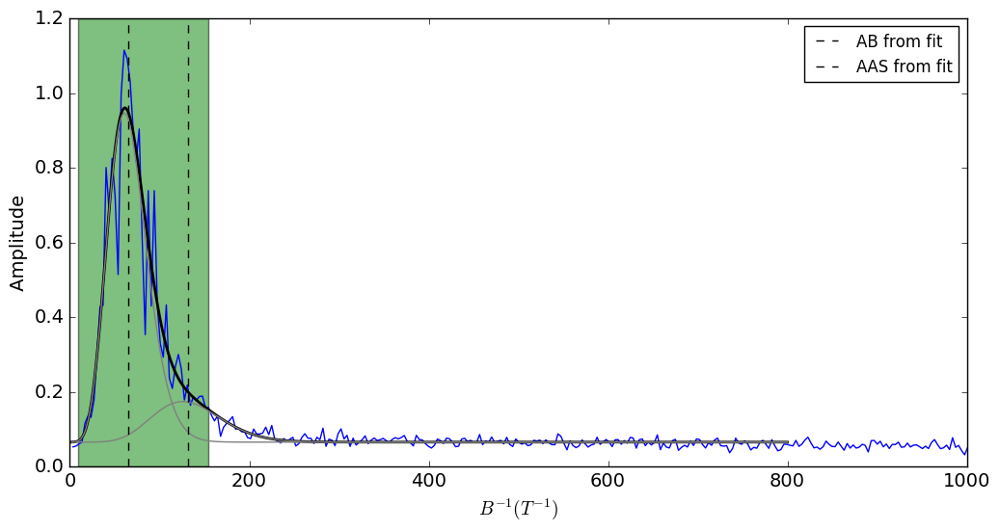

In [1833]:
T = '525 mk'
#despite the name, these correspond to 480 mK
inputFile250mk_36 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_36.dat'
inputFile250mk_37 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_37.dat'
inputFile250mk_38 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_38.dat'
inputFile250mk_39 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_39.dat'
inputFile250mk_40= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_40.dat'
inputFile250mk_41 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_41.dat'
inputFile250mk_42 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_42.dat'
inputFile250mk_43 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_43.dat'


inputFiles525mk = [inputFile250mk_36, inputFile250mk_37, inputFile250mk_38, inputFile250mk_39,
             inputFile250mk_40, inputFile250mk_41, inputFile250mk_42,  inputFile250mk_43]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_525mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average525mk = magnetconductance_average_special_singlepeak(inputFiles525mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

average525mk_8382_2 = magnetconductance_average_special(inputFiles525mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 600 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 62.5826116441 1.39888352068
Amplitude: 7.73591817903 0.277187574395
B parameter: 0.406151632283 0.0565637690327
FIT PARAMETERS FOR AAS:
f: 112.739237067 5.32210680004
Amplitude: 2.31602540455 0.398693540985
B parameter: 0.721695280403 0.395718499339
offset: 0.0730230755123 0.00598840416668


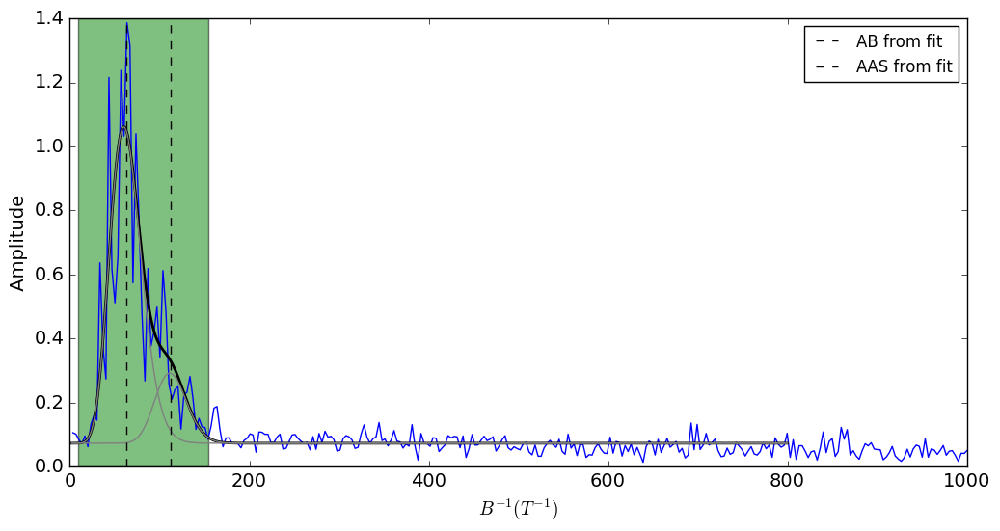

In [1928]:
T = '600 mk'
inputFile600mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_1.dat'
inputFile600mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_2.dat'
inputFile600mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_3.dat'
inputFile600mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_4.dat'
inputFile600mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_5.dat'
inputFile600mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_6.dat'
inputFile600mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_7.dat'
inputFile600mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_8.dat'
inputFile600mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_9.dat'
inputFile600mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_600mk_10.dat'



#inputFiles600mk = [ inputFile600mk_1, inputFile600mk_2, inputFile600mk_3, inputFile600mk_4, inputFile600mk_5, inputFile600mk_6, inputFile600mk_7, inputFile600mk_8]
inputFiles600mk = [ inputFile600mk_1, inputFile600mk_2]
labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order]
plot_name = 'Temperature_dependence_loop2_600mk'
B_min = 0.2
B_max = 0.5




plot_name = 'average_loop2_600mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5
plot_name = 'loop2_600mk'
#average600mk = magnetconductance_average(inputFiles600mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max);
plot_name = 'special_function_single_peak'
average600mk_8382_2 = magnetconductance_average_special(inputFiles600mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 680 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 57.4476033839 2.29125980897
Amplitude: 3.9973177346 0.37604243527
B parameter: 0.406085027913 0.0674014006671
FIT PARAMETERS FOR AAS:
f: 112.519822806 11.7883236334
Amplitude: 1.47936819598 0.191839109266
B parameter: 0.23742521111 0.145313543151
offset: 0.0733241278263 0.00345222949453


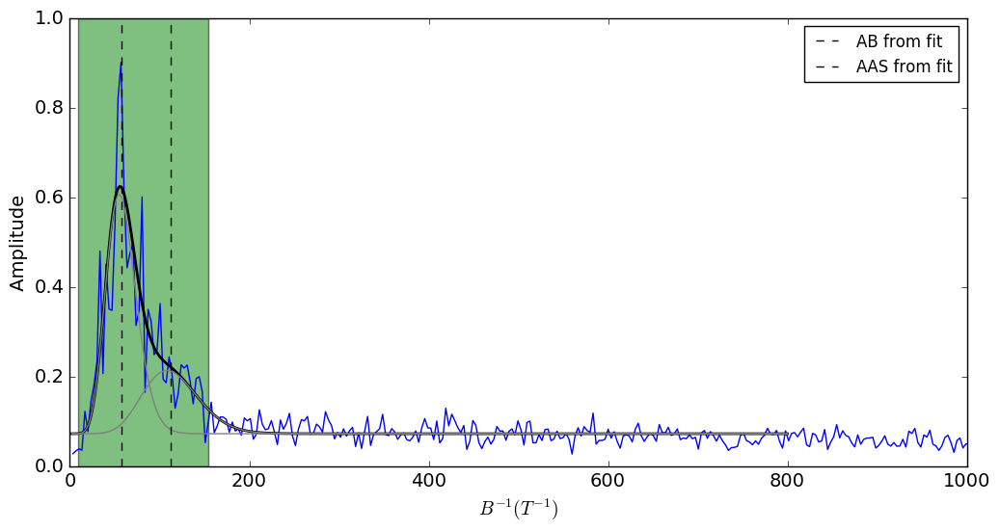

In [1834]:
T = '680 mk'
#despite the name, these correspond to 480 mK
inputFile250mk_44 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_44.dat'
inputFile250mk_45 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_45.dat'
inputFile250mk_46 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_46.dat'
inputFile250mk_47 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_47.dat'
inputFile250mk_48= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_48.dat'
inputFile250mk_49 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_49.dat'
inputFile250mk_50 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_50.dat'
inputFile250mk_51 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_51.dat'


inputFiles680mk = [inputFile250mk_45,  inputFile250mk_47,
            inputFile250mk_50,  inputFile250mk_51]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_680mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average680mk = magnetconductance_average_special_singlepeak(inputFiles680mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

average680mk_8382_2 = magnetconductance_average_special(inputFiles680mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 750 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 63.3506062185 1.67880983362
Amplitude: 4.40619916547 0.4764068898
B parameter: 0.469186759088 0.0676338408635
FIT PARAMETERS FOR AAS:
f: 119.826160926 16.1653682546
Amplitude: 1.22159479963 0.170145252072
B parameter: 0.182773272141 0.132167067925
offset: 0.0700272142232 0.00332226080787


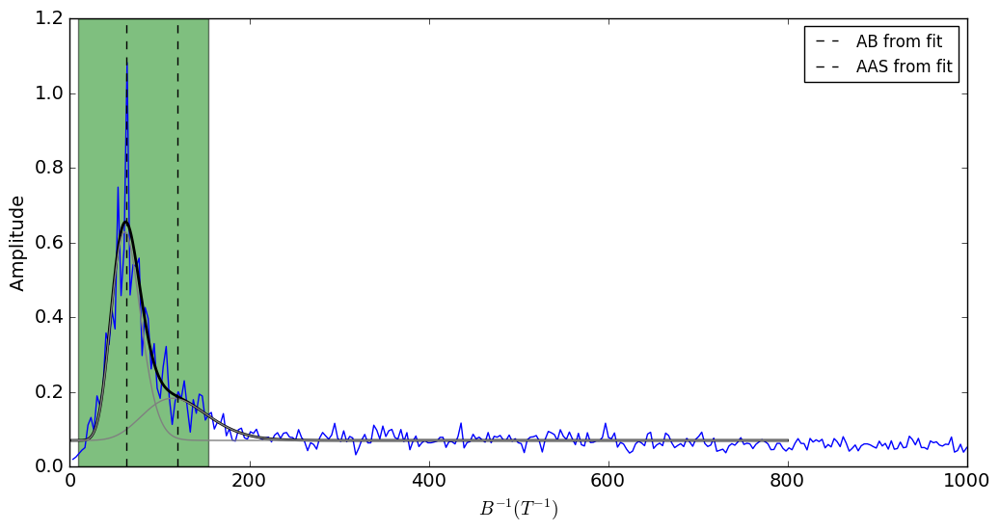

In [1835]:
T = '750 mk'
#despite the name, these correspond to 750 mK
inputFile250mk_52 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_52.dat'
inputFile250mk_53 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_53.dat'
inputFile250mk_54 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_54.dat'
inputFile250mk_55 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_55.dat'
inputFile250mk_56= 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_59.dat'
inputFile250mk_57 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_57.dat'
inputFile250mk_58 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_58.dat'
inputFile250mk_59 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_250mk_59.dat'


inputFiles750mk = [inputFile250mk_52, inputFile250mk_53, inputFile250mk_54, 
             inputFile250mk_59]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']
window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_750mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average750mk = magnetconductance_average_special_singlepeak(inputFiles750mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

average750mk_8382_2 = magnetconductance_average_special(inputFiles750mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# T = 850 mK

f AB from design: 60.4741170779
f_AAS from design: 120.948234156
limit from design for AB effect 9.43396226415 154.088050314
FIT PARAMETERS FOR AB:
f: 64.0980214152 0.775498277802
Amplitude: 4.34478119752 0.264880578758
B parameter: 0.381134697807 0.0458350469647
FIT PARAMETERS FOR AAS:
f: 128.39894317 25.8944924869
Amplitude: 0.675117118481 0.147348614912
B parameter: 0.0562329513106 0.0276941952967
offset: 0.0740356480949 0.00359144610774


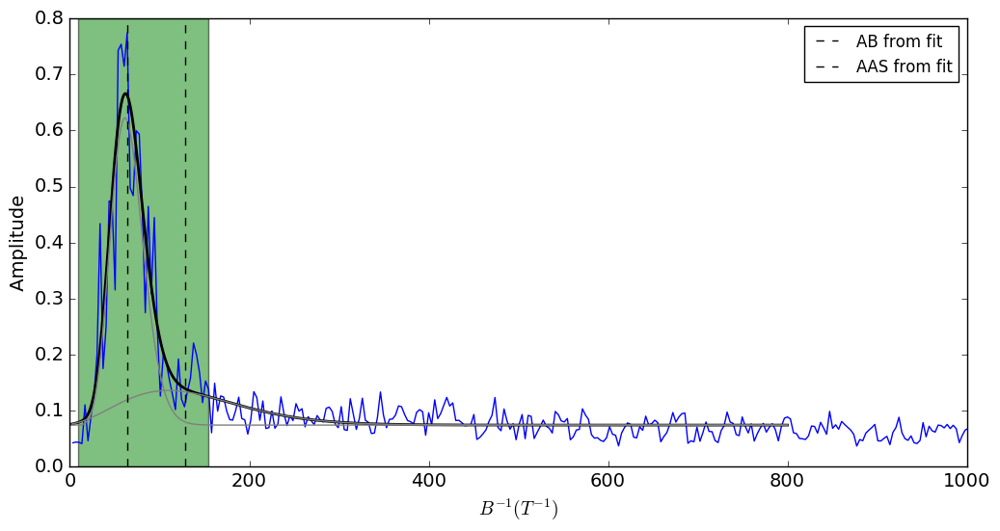

In [1836]:
T = '850 mk'

inputFile850mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_1.dat'
inputFile850mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_2.dat'
inputFile850mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_3.dat'
inputFile850mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_4.dat'
inputFile850mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_5.dat'
inputFile850mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_6.dat'
inputFile850mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_7.dat'
inputFile850mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_850mk_8.dat'


inputFiles850mk = [inputFile850mk_1,  inputFile850mk_3, inputFile850mk_4,
              inputFile850mk_6]
             

labels =  ['1', '2', '3', '4', '5', '6', '7', '8']

window = 169
#169
windows = [window, window, window, window, window, 
          window, window, window]
order = 2
orders = [order, order, order, order, order, 
         order, order, order]

B_min = 0.2
B_max = 0.5
plot_name = 'average_loop2_850mk'
A_min = 0.039
A_center = 0.250
A_max = 0.637
B_min = 0.2
B_max = 0.5

#average850mk = magnetconductance_average_special_singlepeak(inputFiles850mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);
average850mk_8382_2 = magnetconductance_average_special(inputFiles850mk, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Summary T dependance - loop 2 8382


In [1924]:
Ts = [0.017, 0.040, 0.060, 0.080, 0.100, 0.150, 0.200, 0.250, 0.330, 0.400, 0.480, 0.525, 0.680, 0.750, 0.850]
T_AAS = [0.017, 0.040, 0.060, 0.080, 0.100,  0.150, 0.200, 0.250, 0.330, 0.400, 0.480, 0.525, 0.680, 0.750, 0.850]




freq_all_average_17mk, fft_all_average_17mk, x1_17mk, A1_17mk, B1_17mk, x2_17mk, A2_17mk, B2_17mk, offset_17mk, x1err_17mk, A1err_17mk, B1err_17mk, x2err_17mk, A2err_17mk, B2err_17mk, offseterr_17mk  =  average17mk_8382_2
freq_all_average_40mk, fft_all_average_40mk, x1_40mk, A1_40mk, B1_40mk, x2_40mk, A2_40mk, B2_40mk, offset_40mk, x1err_40mk, A1err_40mk, B1err_40mk, x2err_40mk, A2err_40mk, B2err_40mk,  offseterr_40mk =  average40mk_8382_2
freq_all_average_60mk, fft_all_average_60mk, x1_60mk, A1_60mk, B1_60mk, x2_60mk, A2_60mk, B2_60mk, offset_60mk, x1err_60mk, A1err_60mk, B1err_60mk, x2err_60mk, A2err_60mk, B2err_60mk , offseterr_60mk =  average60mk_8382_2
freq_all_average_80mk, fft_all_average_80mk, x1_80mk, A1_80mk, B1_80mk, x2_80mk, A2_80mk, B2_80mk, offset_80mk,x1err_80mk, A1err_80mk, B1err_80mk, x2err_80mk, A2err_80mk, B2err_80mk , offseterr_80mk =  average80mk_8382_2
freq_all_average_100mk, fft_all_average_100mk, x1_100mk, A1_100mk, B1_100mk, x2_100mk, A2_100mk, B2_100mk, offset_100mk,x1err_100mk, A1err_100mk, B1err_100mk, x2err_100mk, A2err_100mk, B2err_100mk , offseterr_100mk=average100mk_8382_2
freq_all_average_150mk, fft_all_average_150mk, x1_150mk, A1_150mk, B1_150mk, x2_150mk, A2_150mk, B2_150mk, offset_150mk, x1err_150mk, A1err_150mk, B1err_150mk, x2err_150mk, A2err_150mk, B2err_150mk, offseterr_150mk   = average150mk_8382_2
freq_all_average_200mk, fft_all_average_200mk, x1_200mk, A1_200mk, B1_200mk, x2_200mk, A2_200mk, B2_200mk, offset_200mk, x1err_200mk, A1err_200mk, B1err_200mk, x2err_200mk, A2err_200mk, B2err_200mk, offseterr_200mk   = average200mk_8382_2
freq_all_average_250mk, fft_all_average_250mk, x1_250mk, A1_250mk, B1_250mk,  x2_250mk, A2_250mk, B2_250mk, offset_250mk, x1err_250mk, A1err_250mk, B1err_250mk, x2err_250mk, A2err_250mk, B2err_250mk, offseterr_250mk  = average250mk_8382_2
freq_all_average_330mk, fft_all_average_330mk, x1_330mk, A1_330mk, B1_330mk,  x2_330mk, A2_330mk, B2_330mk, offset_330mk, x1err_330mk, A1err_330mk, B1err_330mk, x2err_330mk, A2err_330mk, B2err_330mk, offseterr_330mk  = average330mk_8382_2
freq_all_average_400mk, fft_all_average_400mk, x1_400mk, A1_400mk, B1_400mk,  x2_400mk, A2_400mk, B2_400mk, offset_400mk, x1err_400mk, A1err_400mk, B1err_400mk, x2err_400mk, A2err_400mk, B2err_400mk, offseterr_400mk  = average400mk_8382_2
freq_all_average_480mk, fft_all_average_480mk, x1_480mk, A1_480mk, B1_480mk,  x2_480mk, A2_480mk, B2_480mk, offset_480mk, x1err_480mk, A1err_480mk, B1err_480mk, x2err_480mk, A2err_480mk, B2err_480mk, offseterr_480mk  = average480mk_8382_2
freq_all_average_525mk, fft_all_average_525mk, x1_525mk, A1_525mk, B1_525mk,  x2_525mk, A2_525mk, B2_525mk, offset_525mk, x1err_525mk, A1err_525mk, B1err_525mk, x2err_525mk, A2err_525mk, B2err_525mk, offseterr_525mk  = average525mk_8382_2
freq_all_average_680mk, fft_all_average_680mk, x1_680mk, A1_680mk, B1_680mk,  x2_680mk, A2_680mk, B2_680mk, offset_680mk, x1err_680mk, A1err_680mk, B1err_680mk, x2err_680mk, A2err_680mk, B2err_680mk, offseterr_680mk  = average680mk_8382_2
freq_all_average_750mk, fft_all_average_750mk, x1_750mk, A1_750mk, B1_750mk,  x2_750mk, A2_750mk, B2_750mk, offset_750mk, x1err_750mk, A1err_750mk, B1err_750mk, x2err_750mk, A2err_750mk, B2err_750mk, offseterr_750mk  = average750mk_8382_2
freq_all_average_850mk, fft_all_average_850mk, x1_850mk, A1_850mk, B1_850mk,  x2_850mk, A2_850mk, B2_850mk, offset_850mk, x1err_850mk, A1err_850mk, B1err_850mk, x2err_850mk, A2err_850mk, B2err_850mk, offseterr_850mk  = average850mk_8382_2







freqs = [freq_all_average_17mk, freq_all_average_40mk, freq_all_average_60mk,  freq_all_average_80mk, freq_all_average_100mk, freq_all_average_150mk, freq_all_average_200mk, freq_all_average_250mk, freq_all_average_330mk, freq_all_average_400mk,
        freq_all_average_480mk, freq_all_average_525mk, freq_all_average_680mk, freq_all_average_750mk , freq_all_average_850mk]


ffts = [fft_all_average_17mk, fft_all_average_40mk,  fft_all_average_60mk, fft_all_average_80mk, fft_all_average_100mk, fft_all_average_150mk, fft_all_average_200mk,  fft_all_average_250mk, fft_all_average_330mk, fft_all_average_400mk,
        fft_all_average_480mk, fft_all_average_525mk, fft_all_average_680mk, fft_all_average_750mk, fft_all_average_850mk]

x1s = [x1_17mk, x1_40mk, x1_60mk, x1_80mk, x1_100mk, x1_150mk, x1_200mk, x1_250mk, x1_330mk, x1_400mk, x1_480mk, x1_525mk, x1_680mk, x1_750mk, x1_850mk ]
x1errs = [x1err_17mk, x1err_40mk, x1err_60mk, x1err_80mk,  x1err_100mk, x1err_150mk, x1err_200mk, x1err_250mk, x1err_330mk, x1err_400mk, x1err_480mk, x1err_525mk, x1err_680mk, x1err_750mk, x1err_850mk ]

A1s = [A1_17mk,  A1_40mk,  A1_60mk, A1_80mk, A1_100mk, A1_150mk,  A1_200mk, A1_250mk, A1_330mk, A1_400mk, A1_480mk, A1_525mk, A1_680mk, A1_750mk, A1_850mk ]
A1errs = [A1err_17mk, A1err_40mk, A1err_60mk, A1err_80mk, A1err_100mk, A1err_150mk, A1err_200mk, A1err_250mk, A1err_330mk, A1err_400mk, A1err_480mk, A1err_525mk, A1err_680mk, A1err_750mk , A1err_850mk]


B1s = [B1_17mk, B1_40mk, B1_60mk, B1_80mk, B1_100mk, B1_150mk, B1_200mk, B1_250mk, B1_330mk, B1_400mk, B1_480mk, B1_525mk, B1_680mk, B1_750mk, B1_850mk ]
B1errs = [B1err_17mk, B1err_40mk, B1err_60mk,B1err_80mk, B1err_100mk, B1err_150mk, B1err_200mk, B1err_250mk, B1err_330mk, B1err_400mk, B1err_480mk, B1err_525mk, B1err_680mk, B1err_750mk, B1err_850mk ]

B2s = [B2_17mk, B2_40mk, B2_60mk, B2_80mk, B2_100mk, B2_150mk, B2_200mk, B2_250mk, B2_330mk, B2_400mk, B2_480mk, B2_525mk, B2_680mk, B2_750mk, B2_850mk ]
B2errs = [B2err_17mk, B2err_40mk, B2err_60mk,B2err_80mk, B2err_100mk, B2err_150mk, B2err_200mk, B2err_250mk, B2err_330mk, B2err_400mk, B2err_480mk, B2err_525mk, B2err_680mk, B2err_750mk, B2err_850mk ]



A2s = [A2_17mk, A2_40mk, A2_60mk, A2_80mk,  A2_100mk, A2_150mk, A2_200mk, A2_250mk, A2_330mk, A2_400mk , A2_480mk, A2_525mk, A2_680mk, A2_750mk, A2_850mk]
A2errs = [ A2err_17mk, A2err_40mk,  A2err_60mk, A2err_80mk, A2err_100mk, A2err_150mk, A2err_200mk, A2err_250mk, A2err_330mk, A2err_400mk, A2err_480mk, A2err_525mk, A2err_680mk, A2err_750mk, A2err_850mk]



x2s = [x2_17mk, x2_40mk,  x2_60mk, x2_80mk, x2_100mk,  x2_150mk, x2_200mk, x2_250mk, x2_330mk, x2_400mk, x2_480mk, x2_525mk, x2_680mk, x2_750mk, x2_850mk]
x2errs = [x2err_17mk, x2err_40mk, x2err_60mk, x2err_80mk , x2err_100mk, x2err_150mk, x2err_200mk, x2err_250mk, x2err_330mk, x2err_400mk, x2err_480mk, x2err_525mk, x2err_680mk, x2err_750mk, x2err_850mk]




T_fit = np.linspace(0.01, 2, 1000) 


#decay fit AB
A =1
alpha = 1
A_AB, alpha_AB, A_err_AB, alpha_err_AB = fitting_decay(Ts, A1s, A1errs, A, alpha)
fit_AB = decay(T_fit, A_AB, alpha_AB)

#decay fit AAS
A =1
alpha = 1
A_AAS, alpha_AAS, A_err_AAS, alpha_err_AAS = fitting_decay(T_AAS, A2s, A2errs, A, alpha)
fit_AAS = decay(T_fit, A_AAS, alpha_AAS)



#defining fitted function to plot in the big one
fit_17mk = special_function_twopeaks(freq_all_average_17mk, x1_17mk, A1_17mk,  B1_17mk, x2_17mk, A2_17mk,  B2_17mk, offset_17mk)
fit_40mk = special_function_twopeaks(freq_all_average_40mk, x1_40mk, A1_40mk,  B1_40mk, x2_40mk, A2_40mk,  B2_40mk, offset_40mk)
fit_60mk = special_function_twopeaks(freq_all_average_60mk, x1_60mk, A1_60mk,  B1_60mk, x2_60mk, A2_60mk,  B2_60mk, offset_60mk)
fit_80mk = special_function_twopeaks(freq_all_average_80mk, x1_80mk, A1_80mk,  B1_80mk, x2_80mk, A2_80mk,  B2_80mk, offset_80mk)
fit_150mk = special_function_twopeaks(freq_all_average_150mk, x1_150mk, A1_150mk,  B1_150mk, x2_150mk, A2_150mk,  B2_150mk, offset_150mk)
fit_400mk = special_function_twopeaks(freq_all_average_400mk, x1_400mk, A1_400mk,  B1_400mk, x2_400mk, A2_400mk,  B2_400mk, offset_400mk)
fit_525mk = special_function_twopeaks(freq_all_average_525mk, x1_525mk, A1_525mk,  B1_525mk, x2_525mk, A2_525mk,  B2_525mk, offset_525mk)
fit_750mk = special_function_twopeaks(freq_all_average_750mk, x1_750mk, A1_750mk,  B1_750mk, x2_750mk, A2_750mk,  B2_750mk, offset_750mk)


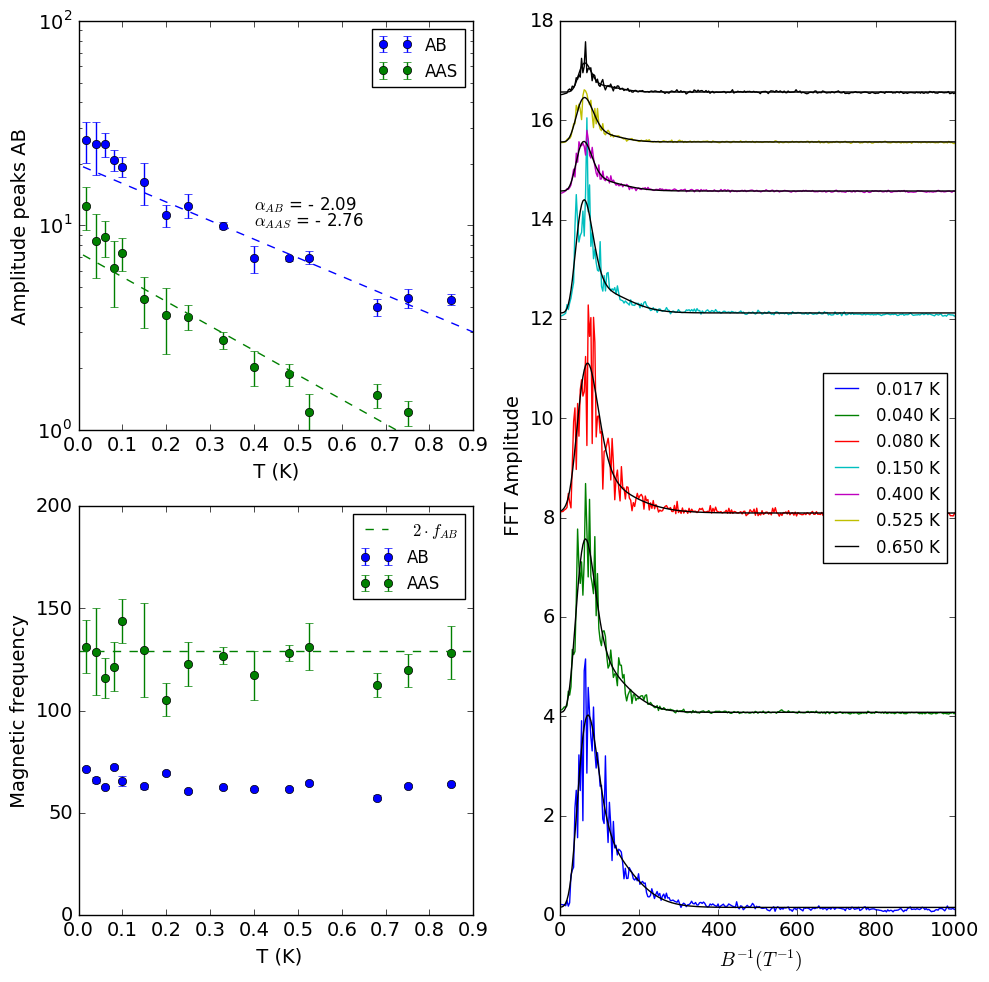

In [1925]:
fig = plt.figure(figsize=(10,10))
ax1 = plt.subplot2grid((2,2), (0,0), colspan=1)
ax2 = plt.subplot2grid((2,2), (1,0), colspan=1)
ax3 = plt.subplot2grid((2,2), (0,1), rowspan=2)        
    
ax1.set_xlabel( ' T (K) ', fontsize=axes_font)
ax1.set_ylabel(' Amplitude peaks AB ', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_ylim(1,1e2)
ax1.set_xlim(0, 0.9)
ax1.text( 0.4 , 12, '$\\alpha_{AB}$ = - ' + str(np.round(alpha_AB,2)), fontsize = 12 )
ax1.text( 0.4 , 10, '$\\alpha_{AAS}$ = - ' + str(np.round(alpha_AAS,2)), fontsize = 12 )
ax1.set_yscale('log')
        

                
ax2.set_xlabel( ' T (K)', fontsize=axes_font)
ax2.set_ylabel(' Magnetic frequency ', fontsize=axes_font)
ax2.tick_params(axis='both', which='major', labelsize=tick_font)
ax2.get_xaxis().get_major_formatter().set_useOffset(False)
ax2.set_ylim(0,200)

#ax2.set_ylim(0,500)
#ax2.set_xlim(0, 6)

ax3.set_xlabel( ' $ B ^{-1} ( T^{-1}) $', fontsize=axes_font)
ax3.set_ylabel(' FFT Amplitude', size=axes_font)
ax3.tick_params(axis='both', which='major', labelsize=tick_font)
ax3.get_xaxis().get_major_formatter().set_useOffset(False)
#ax3.set_ylim(0,3.3)
ax3.set_xlim(0, 1000)



ax1.errorbar(Ts, A1s, yerr = np.array(A1errs), fmt = 'o', label = 'AB')
ax1.plot(T_fit, fit_AB, linestyle = '--', color = 'b')

ax1.errorbar(T_AAS, A2s, yerr = np.array(A2errs), fmt = 'o', label = 'AAS')
ax1.plot(T_fit, fit_AAS, linestyle = '--', color = 'green')



ax2.errorbar(Ts, x1s, yerr = 0.5*np.array(x1errs), fmt = 'o', label = 'AB')
ax2.errorbar(T_AAS, x2s, yerr = 0.5*np.array(x2errs), fmt = 'o', label = 'AAS')
ax2.axhline(y = np.mean(x1s) * 2, linestyle = '--', color = 'green', label = ' $ 2 \cdot f_{AB} $')  

#for index in range(0, len(Ts)):
#    ax3.plot(freqs[index], ffts[index] + index , label = str(Ts[index]) + ' mK')

ax3.plot(freq_all_average_17mk, fft_all_average_17mk, label =  '0.017 K')
ax3.plot(freq_all_average_17mk, fit_17mk, color = 'black')

ax3.plot(freq_all_average_40mk, fft_all_average_40mk + 4, label =  '0.040 K')
ax3.plot(freq_all_average_40mk, fit_40mk + 4, color = 'black')

ax3.plot(freq_all_average_80mk, fft_all_average_80mk + 8, label =  '0.080 K')
ax3.plot(freq_all_average_80mk, fit_80mk + 8, color = 'black')


ax3.plot(freq_all_average_150mk, fft_all_average_150mk + 12, label =  '0.150 K')
ax3.plot(freq_all_average_150mk, fit_150mk + 12, color = 'black')


ax3.plot(freq_all_average_400mk, fft_all_average_400mk + 14.5, label =  '0.400 K')
ax3.plot(freq_all_average_400mk, fit_400mk + 14.5, color = 'black')


ax3.plot(freq_all_average_525mk, fft_all_average_525mk + 15.5, label =  '0.525 K')
ax3.plot(freq_all_average_525mk, fit_525mk + 15.5, color = 'black')

ax3.plot(freq_all_average_750mk, fft_all_average_750mk + 16.5, label =  '0.650 K')
ax3.plot(freq_all_average_750mk, fit_750mk + 16.5, color = 'black')


ax1.legend(loc=0)
ax2.legend(loc=0)
ax3.legend(loc=5)

fig.subplots_adjust(hspace=sub_hspace-7)    
fig.subplots_adjust(wspace=sub_wspace)   
fig.tight_layout() 

fig.savefig('loop2'+str(8382)+'.eps',format='eps',transparent = False)
fig.savefig('loop2'+str(8382)+'.png',format='png',transparent = False)




#plt.errorbar(Ts, B1s, yerr = B1errs)

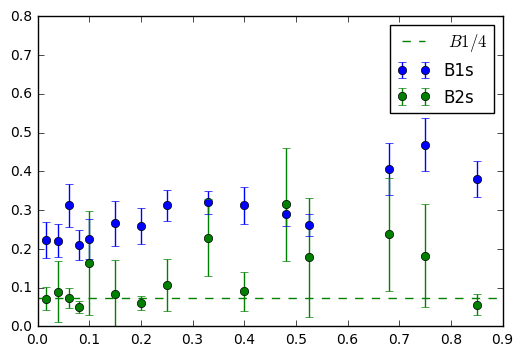

In [1839]:
plt.errorbar(Ts, B1s, yerr = B1errs, fmt = 'o', label = 'B1s')
plt.errorbar(Ts, B2s, yerr = B2errs, fmt = 'o', label = 'B2s')
plt.axhline(y = np.mean(B1s) /4 , linestyle = '--', color = 'green', label = ' $  B1 /4$')

plt.ylim(0, 0.8)
plt.legend(loc=0)

In [1840]:
L = 2.05
l_phi = L/(alpha_AAS * 0.08)
print l_phi
l_phi = 0.5*L/(alpha_AB * 0.08)
print l_phi

9.29019762832
6.12481830168


# Loop 1 - Device 8442

# Gates

Left arm

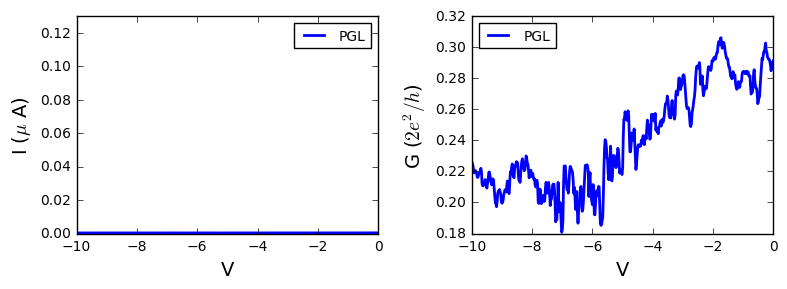

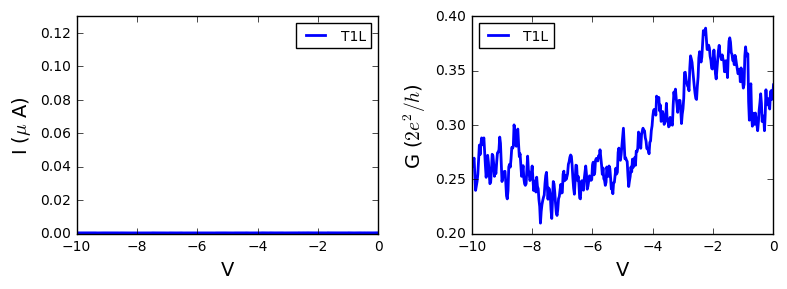

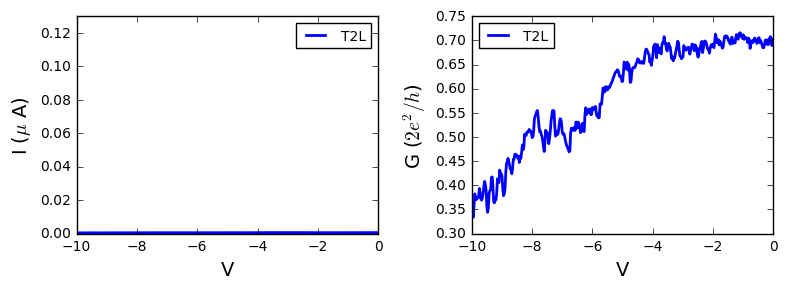

In [2226]:



#PGL
inputFilePGL ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_PGL_3.dat'
inputFilesPGL = [inputFilePGL]
gates = ['PGL fwd']
conversions = [0.005]
plot_name = '8442_PGL'
labels = ['PGL']
gate_dependance(inputFilesPGL, gates, conversions, labels, plot_name)

#T1L
inputFileT1L ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_T1L_4.dat'
inputFilesT1L = [inputFileT1L]
gates = ['T1L fwd']
conversions = [0.005]
plot_name = '8442_T1L'
labels = ['T1L']
gate_dependance(inputFilesT1L, gates, conversions, labels, plot_name)


#T2L
inputFileT2L ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_T2L_5.dat'
inputFilesT2L = [inputFileT2L]
gates = ['T2L fwd']
conversions = [0.005]
plot_name = '8442_T2L'
labels = ['T2L']
gate_dependance(inputFilesT2L, gates, conversions, labels, plot_name)


Right arm

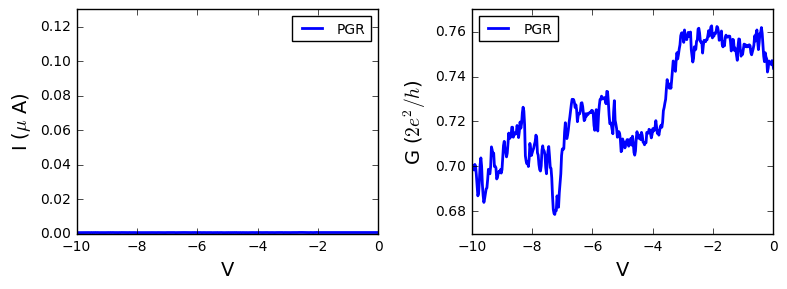

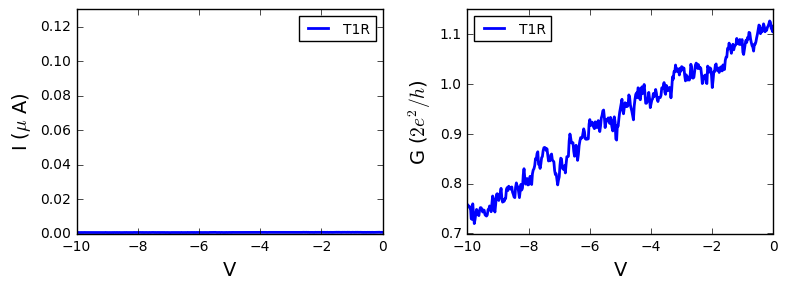

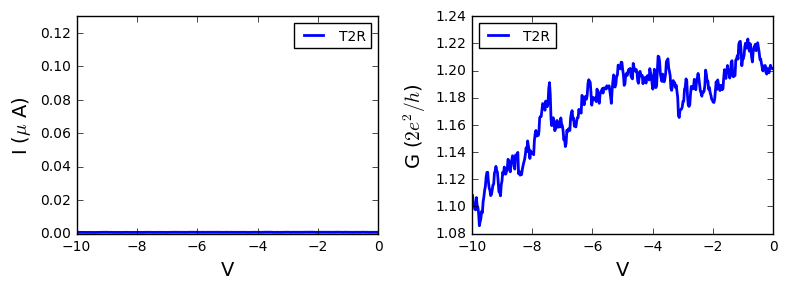

In [2227]:
#PGR
inputFilePGR ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_PGR_1.dat'
inputFilesPGR = [inputFilePGR]
gates = ['PGR fwd']
conversions = [0.005]
plot_name = '8442_PGR'
labels = ['PGR']
gate_dependance(inputFilesPGR, gates, conversions, labels, plot_name)

#T1R
inputFileT1R ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_T1R_8.dat'
inputFilesT1R = [inputFileT1R]
gates = ['T1R fwd']
conversions = [0.005]
plot_name = '8442_T1R'
labels = ['T1R']
gate_dependance(inputFilesT1R, gates, conversions, labels, plot_name)


#T2R
inputFileT2R ='D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_T2R_4.dat'
inputFilesT2R = [inputFileT2R]
gates = ['T2R fwd']
conversions = [0.005]
plot_name = '8442_T2R'
labels = ['T2R']
gate_dependance(inputFilesT2R, gates, conversions, labels, plot_name)

# Example big range scan

f AB from design: 44.5089501693
f_AAS from design: 89.0179003387
limit from design for AB effect 10.885341074 99.9032414127
FIT PARAMETERS FOR AB:
f: 58.4613884761 0.687145432991
Amplitude: 18.1375070148 0.419265040042
B parameter: 0.178828107424 0.0094353019158
offset: 0.153835608201


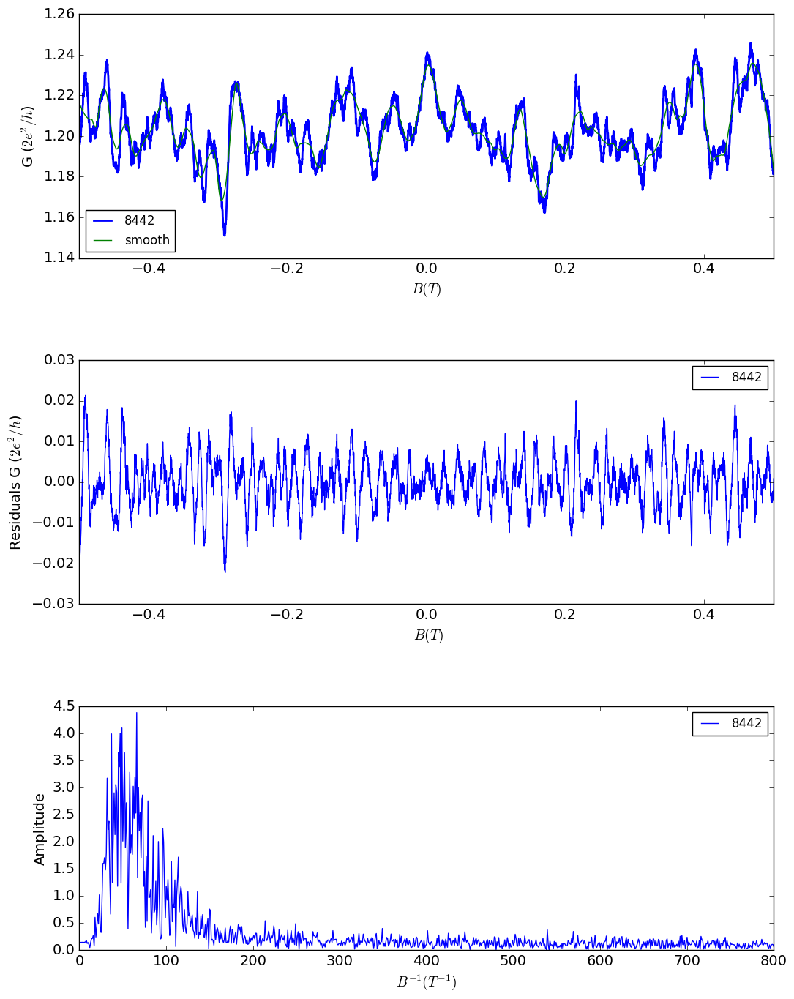

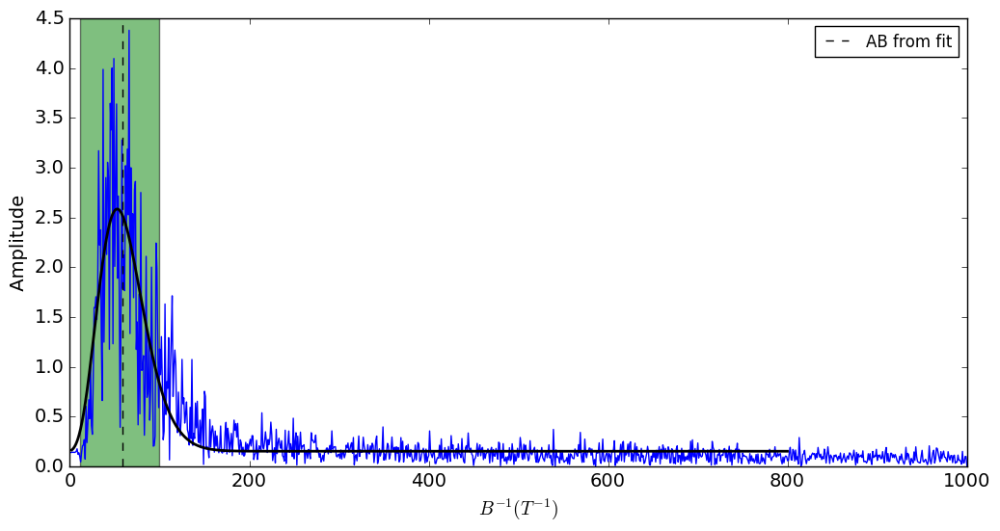

In [2297]:
inputFile_oscillations_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_2.dat'

inputFiles = [inputFile_oscillations_1 ]
labels =  ['8442']
windows = [171]
#105
orders = [2]
plot_name = 'AB_8442'
B_min = -0.5

B_max = 0.5
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


T = '17 mK'
A_min = 0.045
A_center = 0.184
A_max = 0.413


plot_name = 'AB_8442_fft'
magnetconductance_average_special_singlepeak(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Example big range scan in-plane

([], [])

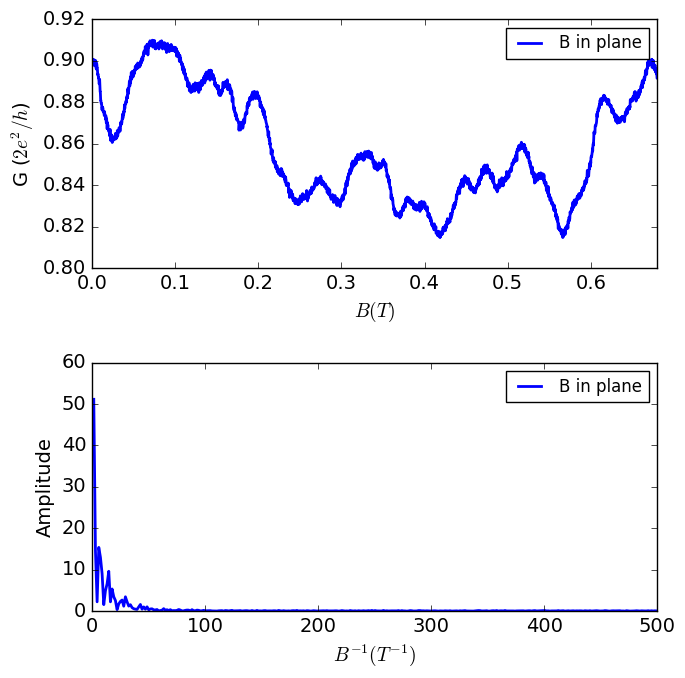

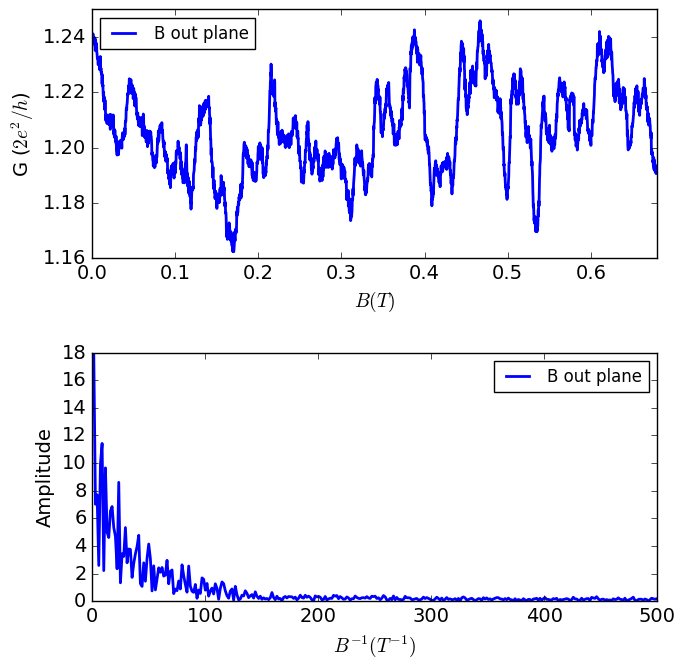

In [2305]:
inputFile_inplane = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_QPC_5.dat'
inputFile_outplane = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_2.dat'

inputFiles = [inputFile_inplane]
labels =  ['B in plane']
windows = [3]
#105
orders = [2]
plot_name = 'inplane_8442'
B_min = 0.0
B_max = 0.68
#magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True, fitting = False);
magnetoconductance_range_FFT(inputFiles,  labels, plot_name, B_min, B_max, plot = True )

inputFiles = [inputFile_outplane]
labels =  ['B out plane']
windows = [3]
#105
orders = [2]
plot_name = 'outplane_8442'
B_min = 0.0
B_max = 0.68
#magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True, fitting = False);
magnetoconductance_range_FFT(inputFiles,  labels, plot_name, B_min, B_max, plot = True )

# Example AAS

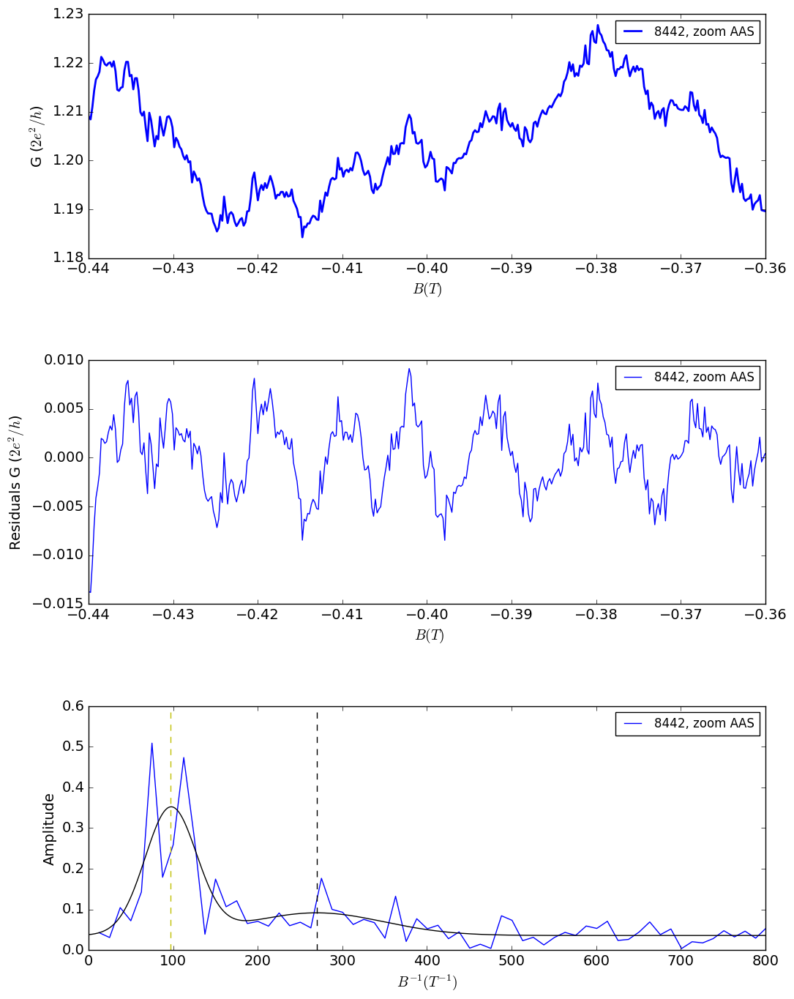

In [2259]:
inputFile_oscillations_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_2.dat'

inputFiles = [inputFile_oscillations_1 ]
labels =  ['8442, zoom AAS']
windows = [101]
#105
orders = [2]
plot_name = 'AAS_8442'
B_min = -0.44
B_max = -0.36
magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);


T = '17 mK'
A_min = 0.045
A_center = 0.184
A_max = 0.413



#magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Temperature dependence 8442

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 49.7755508708 0.886526984801
Amplitude: 10.0097908887 1.04737721194
B parameter: 0.384528043658 0.0562770774454
FIT PARAMETERS FOR AAS:
f: 80.9833026862 6.08696965756
Amplitude: 6.02427206548 0.824438271495
B parameter: 0.097317658147 0.0121521743959
offset: 0.0920515436706 0.00707548781789


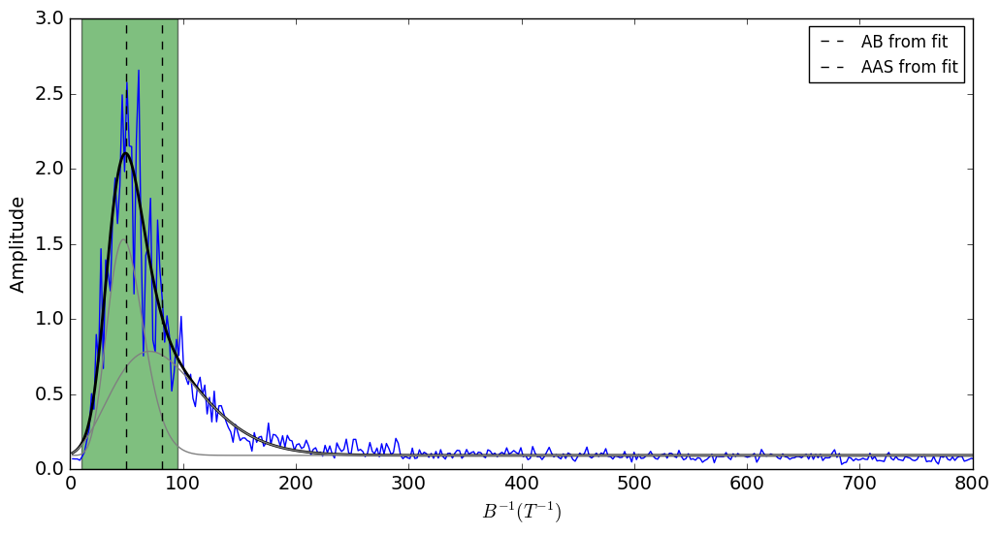

In [2403]:
T = '17 mk'

inputFile17mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_1.dat'
inputFile17mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_2.dat'
inputFile17mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_3.dat'
inputFile17mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_17mk_1.dat'
inputFile17mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_17mk_2.dat'


inputFiles17mk_8442 = [ inputFile17mk_1, inputFile17mk_2, inputFile17mk_3, inputFile17mk_4,inputFile17mk_5]
             

labels =  ['1', '2', '3', '4', '5']

window = 169
window1 = 155
#169
windows = [window, window, window, window1, window1]
order = 2
orders = [order, order, order, order, order]


plot_name = 'loop1_8442_17mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average17mk_8442 = magnetconductance_average_special(inputFiles17mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);



f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 40.3754611803 0.684704970431
Amplitude: 6.2508987121 0.558396627023
B parameter: 0.592478242796 0.0888803366096
FIT PARAMETERS FOR AAS:
f: 60.57801903 6.09918667998
Amplitude: 2.28133553805 0.516938629485
B parameter: 0.116219865054 0.0240532670006
offset: 0.0582212493593 0.00483035311245


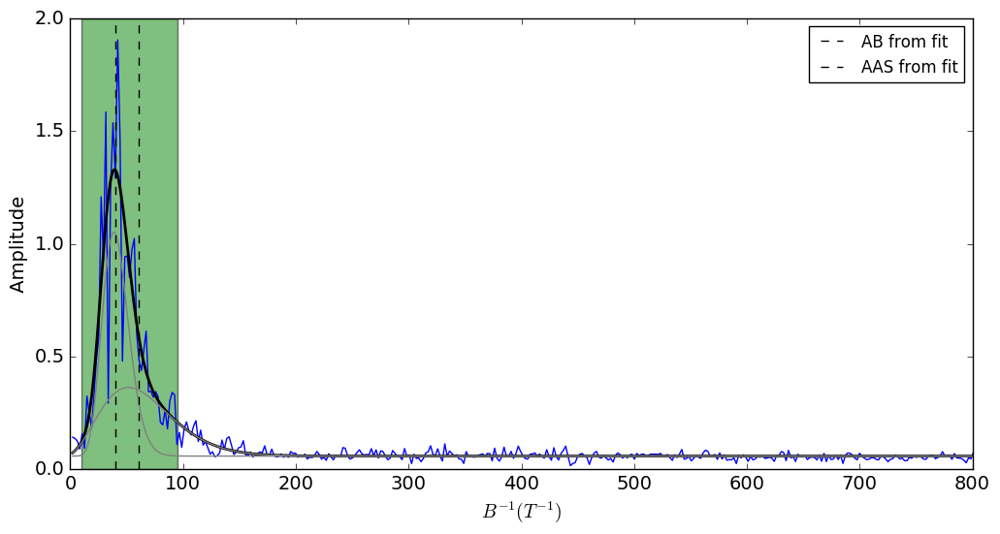

In [2388]:
T = '120 mk'

inputFile120mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_1.dat'
inputFile120mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_2.dat'
inputFile120mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_3.dat'
inputFile120mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_4.dat'


inputFiles120mk_8442 = [ inputFile120mk_1, inputFile120mk_2, inputFile120mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 155
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_120mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average120mk_8442 = magnetconductance_average_special(inputFiles120mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 38.9596437393 0.900091786633
Amplitude: 6.0618420797 0.330216610047
B parameter: 0.813998184597 0.113542863705
FIT PARAMETERS FOR AAS:
f: 77.1114603885 6.76477657779
Amplitude: 1.50239017611 0.241984501171
B parameter: 0.411647318787 0.284976934621
offset: 0.0630864122093 0.0048144934243


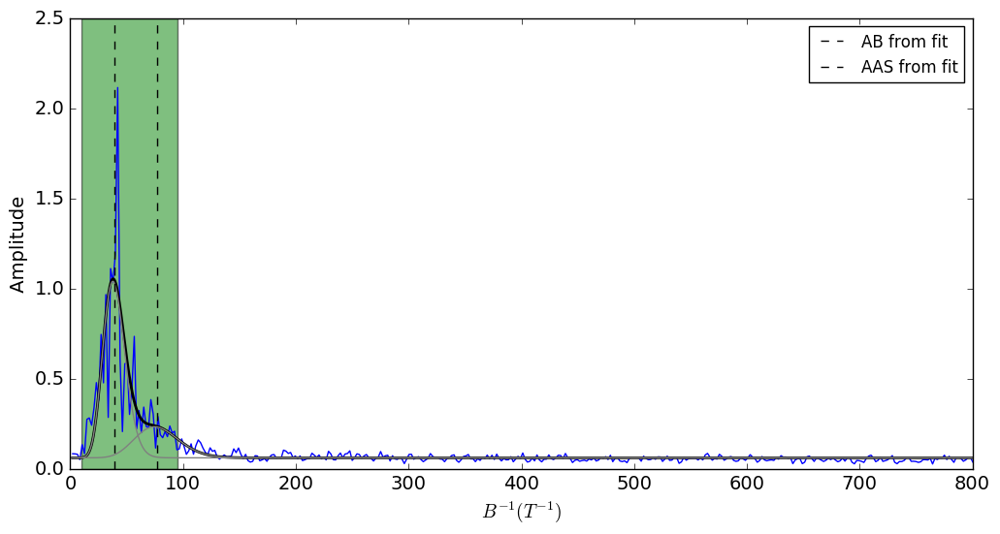

In [2389]:
T = '180 mk'

inputFile180mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_5.dat'
inputFile180mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_6.dat'
inputFile180mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_7.dat'
inputFile180mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_8.dat'


inputFiles180mk_8442 = [  inputFile180mk_1, inputFile180mk_2, inputFile180mk_3, inputFile180mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_180mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average180mk_8442 = magnetconductance_average_special(inputFiles180mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 41.8623934322 0.50447224334
Amplitude: 4.7641759514 0.168585619621
B parameter: 0.550972764468 0.044905477621
offset: 0.063294353088


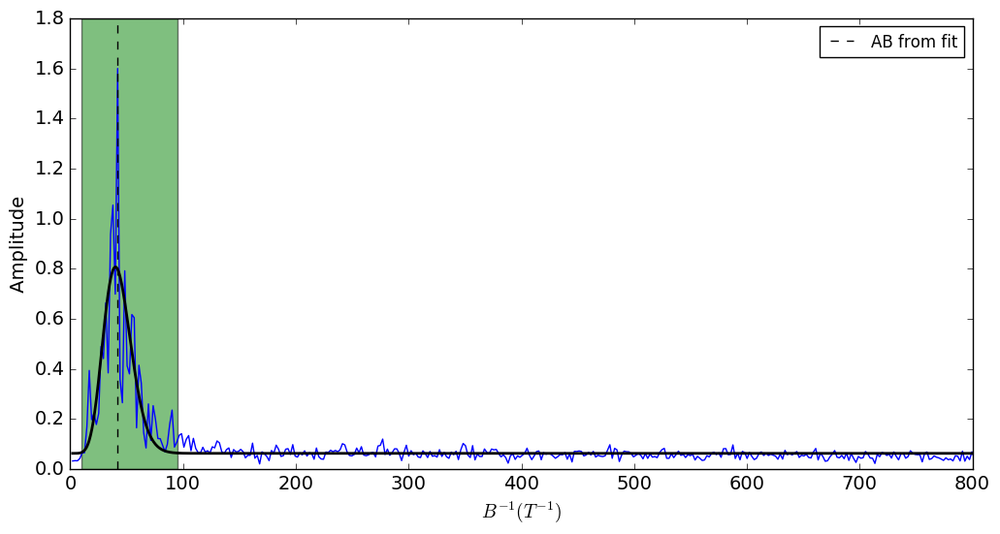

In [2390]:
T = '225 mk'

inputFile225mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_9.dat'
inputFile225mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_10.dat'
inputFile225mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_11.dat'
inputFile225mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_12.dat'


inputFiles225mk_8442 = [  inputFile225mk_1, inputFile225mk_2, inputFile225mk_3, inputFile225mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_225mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average225mk_8442 = magnetconductance_average_special_singlepeak(inputFiles225mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 42.4333017806 0.764917329705
Amplitude: 3.14863636781 0.125178682338
B parameter: 0.309254075774 0.0280921393008
offset: 0.0611511592916


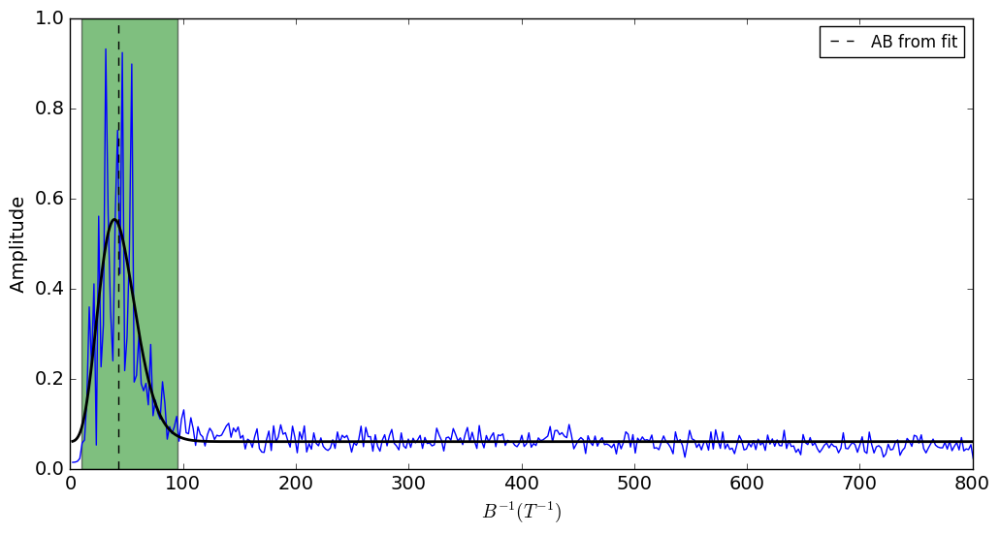

In [2391]:
T = '310 mk'

inputFile310mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_38.dat'
inputFile310mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_39.dat'
inputFile310mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_40.dat'
inputFile310mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_41.dat'


inputFiles310mk_8442 = [  inputFile310mk_1, inputFile310mk_2, inputFile310mk_3, inputFile310mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_310mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average310mk_8442 = magnetconductance_average_special_singlepeak(inputFiles310mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 45.5343963246 1.18352872618
Amplitude: 1.82634494341 0.0870136275659
B parameter: 0.201072417053 0.0216671406823
offset: 0.0597148738922


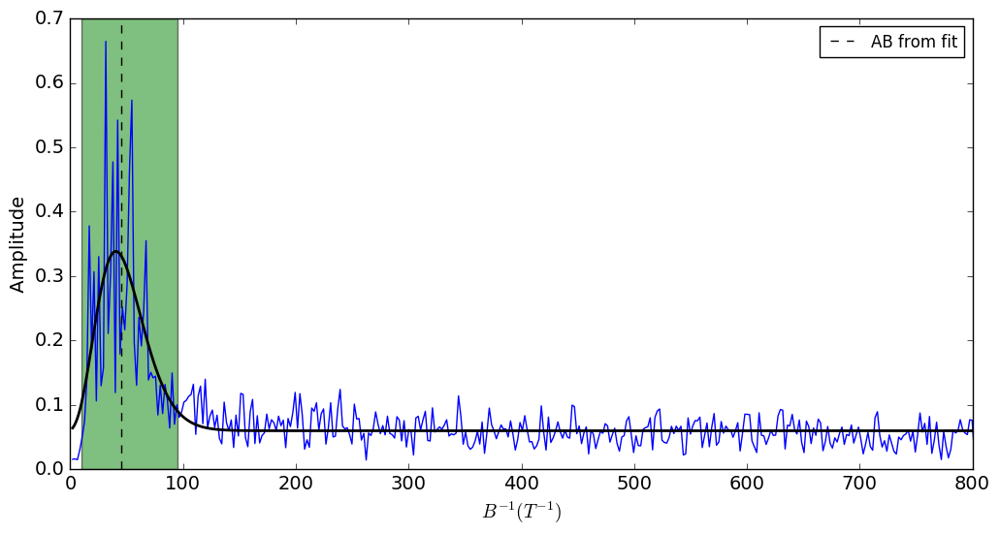

In [2392]:
T = '380 mk'

inputFile380mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_42.dat'
inputFile380mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_43.dat'
#inputFile380mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_44.dat'
#inputFile380mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_45.dat'


inputFiles380mk_8442 = [  inputFile380mk_1,  inputFile380mk_2 ]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_380mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average380mk_8442 = magnetconductance_average_special_singlepeak(inputFiles380mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 40.9598919364 0.576133848805
Amplitude: 2.14585458 0.0738681621596
B parameter: 0.393121895275 0.0310245706259
offset: 0.0618872785017


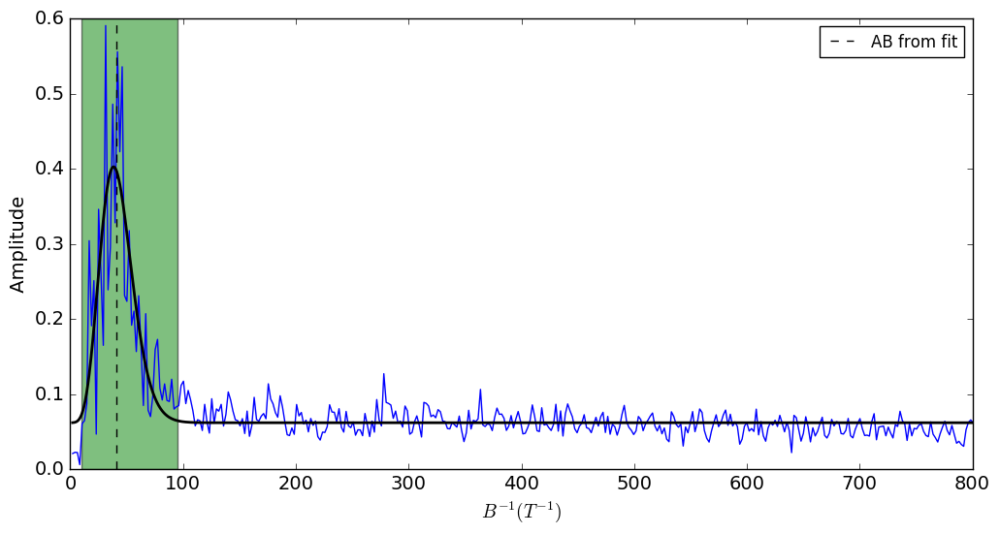

In [2393]:
T = '470 mk'

inputFile470mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_21.dat'
inputFile470mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_22.dat'
inputFile470mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_23.dat'
inputFile470mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_24.dat'


inputFiles470mk_8442 = [  inputFile470mk_1, inputFile470mk_2, inputFile470mk_3, inputFile470mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_470mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average470mk_8442 = magnetconductance_average_special_singlepeak(inputFiles470mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 43.9495535532 0.812525858228
Amplitude: 1.71000985029 0.0740557961275
B parameter: 0.335945280432 0.0333317336828
offset: 0.0625297093573


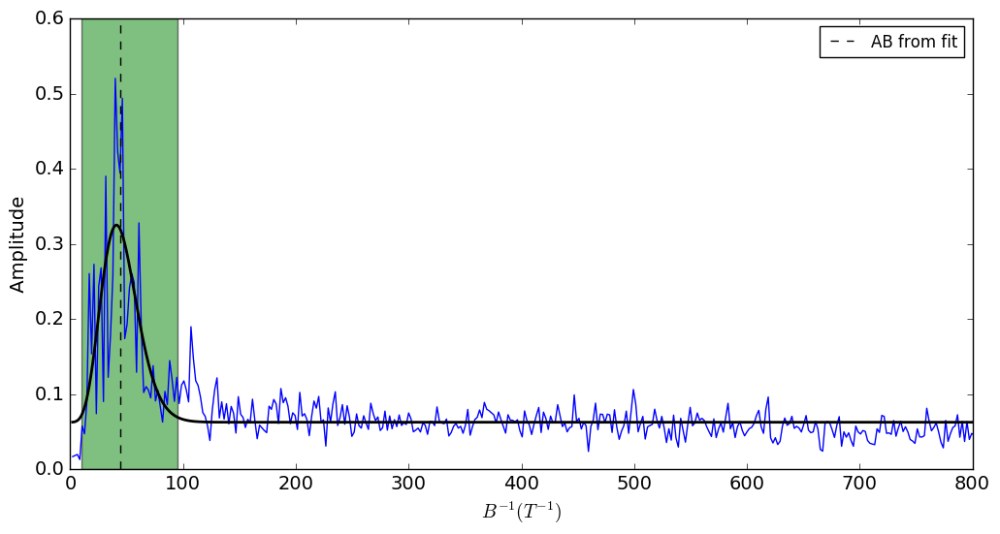

In [2394]:
T = '530 mk'

inputFile530mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_25.dat'
inputFile530mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_26.dat'
inputFile530mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_27.dat'
inputFile530mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_28.dat'


inputFiles530mk_8442 = [  inputFile530mk_1, inputFile530mk_2, inputFile530mk_3, inputFile530mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_530mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average530mk_8442 = magnetconductance_average_special_singlepeak(inputFiles530mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 48.2304521718 1.27079976607
Amplitude: 1.09683107451 0.0515055387555
B parameter: 0.179705288633 0.01905746179
offset: 0.0608220723896


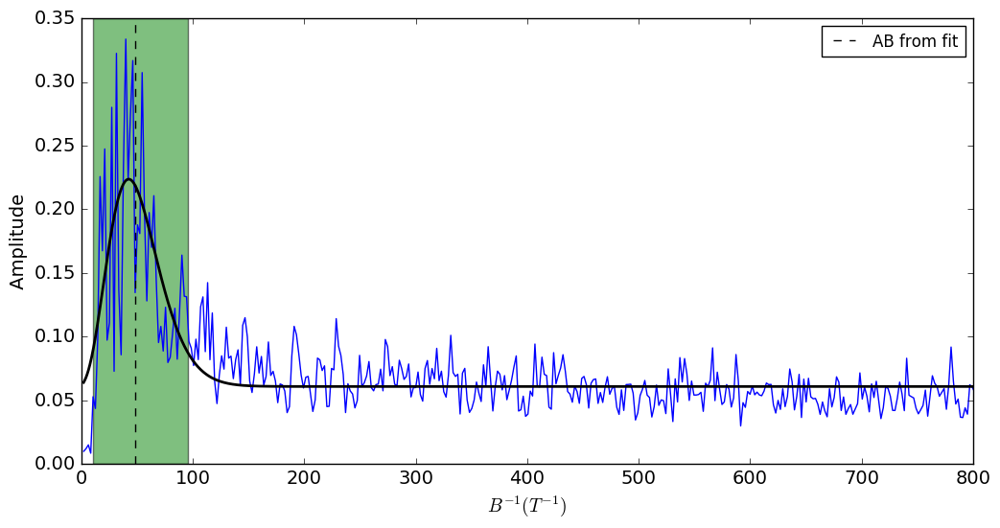

In [2395]:
T = '620 mk'

inputFile620mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_30.dat'
inputFile620mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_31.dat'
inputFile620mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_32.dat'
inputFile620mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_33.dat'


inputFiles620mk_8442 = [  inputFile620mk_1, inputFile620mk_2, inputFile620mk_3, inputFile620mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_620mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average620mk_8442 = magnetconductance_average_special_singlepeak(inputFiles620mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 46.4860897839 1.10126258388
Amplitude: 1.1193570996 0.0629320606848
B parameter: 0.325683221423 0.0419950686282
offset: 0.064060835916


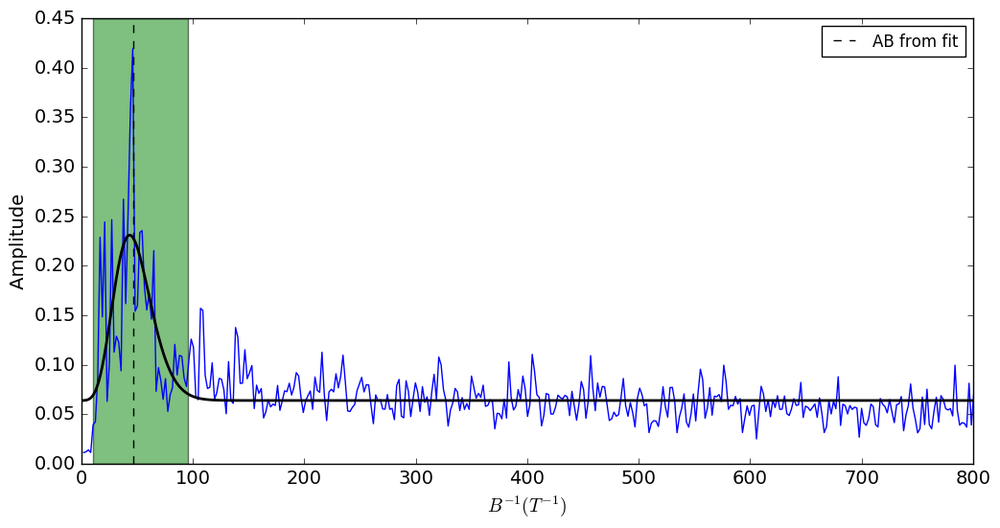

In [2396]:
T = '700 mk'

inputFile700mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_34.dat'
inputFile700mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_35.dat'
inputFile700mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_36.dat'
inputFile700mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_temperature_dependence_37.dat'


inputFiles700mk_8442 = [  inputFile700mk_1, inputFile700mk_2, inputFile700mk_3, inputFile700mk_4]
             

labels =  ['1', '2', '3', '4']


window1 = 157
#169
windows = [window1, window1, window1, window1]
order = 2
orders = [order, order, order, order]


plot_name = 'loop1_8442_700mK'
A_min = 0.042
A_center = 0.179
A_max = 0.394
B_min = 0.2
B_max = 0.68


average700mk_8442 = magnetconductance_average_special_singlepeak(inputFiles700mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Summary Temperature dependence - loop 1 8442

In [2404]:
Ts = [0.017, 0.120, 0.180, 0.225, 0.310, 0.380, 0.470, 0.530, 0.620, 0.700]
T_AAS = [0.017, 0.120, 0.180]




freq_all_average_17mk, fft_all_average_17mk, x1_17mk, A1_17mk, B1_17mk, x2_17mk, A2_17mk, B2_17mk, offset_17mk, x1err_17mk, A1err_17mk, B1err_17mk, x2err_17mk, A2err_17mk, B2err_17mk, offseterr_17mk  =  average17mk_8442
freq_all_average_120mk, fft_all_average_120mk, x1_120mk, A1_120mk, B1_120mk, x2_120mk, A2_120mk, B2_120mk, offset_120mk, x1err_120mk, A1err_120mk, B1err_120mk, x2err_120mk, A2err_120mk, B2err_120mk,  offseterr_120mk =  average120mk_8442
freq_all_average_180mk, fft_all_average_180mk, x1_180mk, A1_180mk, B1_180mk, x2_180mk, A2_180mk, B2_180mk, offset_180mk, x1err_180mk, A1err_180mk, B1err_180mk, x2err_180mk, A2err_180mk, B2err_180mk,  offseterr_180mk =  average180mk_8442


freq_all_average_225mk, fft_all_average_225mk, x1_225mk, A1_225mk, B1_225mk, offset_225mk, x1err_225mk, A1err_225mk, B1err_225mk, offset_err_225mk = average225mk_8442
freq_all_average_310mk, fft_all_average_310mk, x1_310mk, A1_310mk, B1_310mk, offset_310mk, x1err_310mk, A1err_310mk, B1err_310mk, offset_err_310mk = average310mk_8442
freq_all_average_380mk, fft_all_average_380mk, x1_380mk, A1_380mk, B1_380mk, offset_380mk, x1err_380mk, A1err_380mk, B1err_380mk, offset_err_380mk = average380mk_8442
freq_all_average_470mk, fft_all_average_470mk, x1_470mk, A1_470mk, B1_470mk, offset_470mk, x1err_470mk, A1err_470mk, B1err_470mk, offset_err_470mk = average470mk_8442
freq_all_average_530mk, fft_all_average_530mk, x1_530mk, A1_530mk, B1_530mk, offset_530mk, x1err_530mk, A1err_530mk, B1err_530mk, offset_err_530mk = average530mk_8442
freq_all_average_620mk, fft_all_average_620mk, x1_620mk, A1_620mk, B1_620mk, offset_620mk, x1err_620mk, A1err_620mk, B1err_620mk, offset_err_620mk = average620mk_8442
freq_all_average_700mk, fft_all_average_700mk, x1_700mk, A1_700mk, B1_700mk, offset_700mk, x1err_700mk, A1err_700mk, B1err_700mk, offset_err_700mk = average700mk_8442

freqs = [freq_all_average_17mk, freq_all_average_120mk, freq_all_average_180mk, freq_all_average_225mk, freq_all_average_310mk, freq_all_average_380mk, freq_all_average_470mk, 
         freq_all_average_530mk, freq_all_average_620mk,  freq_all_average_700mk  ]


ffts = [fft_all_average_17mk, fft_all_average_120mk, fft_all_average_180mk, fft_all_average_225mk, fft_all_average_310mk, fft_all_average_380mk, fft_all_average_470mk, 
         fft_all_average_530mk, fft_all_average_620mk,  fft_all_average_700mk ]

x1s = [x1_17mk, x1_120mk, x1_180mk, x1_225mk, x1_310mk, x1_380mk, x1_470mk, 
         x1_530mk, x1_620mk,  x1_700mk  ]

x1errs = [x1err_17mk, x1err_120mk, x1err_180mk, x1err_225mk, x1err_310mk, x1err_380mk, x1err_470mk, 
         x1err_530mk, x1err_620mk,  x1err_700mk  ]

A1s = [A1_17mk,  A1_120mk,  A1_180mk, A1_225mk, A1_310mk, A1_380mk, A1_470mk, 
         A1_530mk, A1_620mk,  A1_700mk ]

A1errs = [A1err_17mk, A1err_120mk, A1err_180mk, A1err_225mk, A1err_310mk, A1err_380mk, A1err_470mk, 
         A1err_530mk, A1err_620mk,  A1err_700mk ]


B1s = [B1_17mk, B1_120mk, B1_180mk, B1_225mk, B1_310mk, B1_380mk, B1_470mk, 
         B1_530mk, B1_620mk,  B1_700mk  ]

B1errs = [B1err_17mk, B1err_120mk, B1err_180mk, B1err_225mk, B1err_310mk, B1err_380mk, B1err_470mk, 
         B1err_530mk, B1err_620mk,  B1err_700mk  ]

B2s = [B2_17mk, B2_120mk, B2_180mk  ]
B2errs = [B2err_17mk, B2err_120mk, B2err_180mk ]



A2s = [A2_17mk, A2_120mk, A2_180mk ]
A2errs = [ A2err_17mk, A2_120mk, A2_180mk ]



x2s = [x2_17mk, x2_120mk, x2_180mk]
x2errs = [x2err_17mk, x2err_120mk, x2err_180mk]

offsets = [offset_17mk, offset_120mk,  offset_180mk,  offset_225mk,  offset_310mk,  offset_380mk,  offset_470mk,  offset_530mk,  offset_620mk,  offset_700mk ]


T_fit = np.linspace(0.01, 2, 1000) 


#decay fit AB
A =1
alpha = 1
A_AB, alpha_AB, A_err_AB, alpha_err_AB = fitting_decay(Ts, A1s, A1errs, A, alpha)
fit_AB = decay(T_fit, A_AB, alpha_AB)

#decay fit AAS
A =1
alpha = 1
A_AAS, alpha_AAS, A_err_AAS, alpha_err_AAS = fitting_decay(T_AAS, A2s, A2errs, A, alpha)
fit_AAS = decay(T_fit, A_AAS, alpha_AAS)



#defining fitted function to plot in the big one
fit_17mk = special_function_twopeaks(freq_all_average_17mk, x1_17mk, A1_17mk,  B1_17mk, x2_17mk, A2_17mk,  B2_17mk, offset_17mk)
fit_120mk = special_function_twopeaks(freq_all_average_120mk, x1_120mk, A1_120mk,  B1_120mk, x2_120mk, A2_120mk,  B2_120mk, offset_120mk)
fit_180mk = special_function_twopeaks(freq_all_average_180mk, x1_180mk, A1_180mk,  B1_180mk, x2_180mk, A2_180mk,  B2_180mk, offset_180mk)
fit_225mk = special_function(freq_all_average_225mk, x1_225mk, A1_225mk,  B1_225mk, offset_225mk)
fit_310mk = special_function(freq_all_average_310mk, x1_310mk, A1_310mk,  B1_310mk, offset_310mk)
fit_380mk = special_function(freq_all_average_380mk, x1_380mk, A1_380mk,  B1_380mk, offset_380mk)
fit_470mk = special_function(freq_all_average_470mk, x1_470mk, A1_470mk,  B1_470mk, offset_470mk)
fit_530mk = special_function(freq_all_average_530mk, x1_530mk, A1_530mk,  B1_530mk, offset_530mk)
fit_620mk = special_function(freq_all_average_620mk, x1_620mk, A1_620mk,  B1_620mk, offset_620mk)
fit_700mk = special_function(freq_all_average_700mk, x1_700mk, A1_700mk,  B1_700mk, offset_700mk)



 

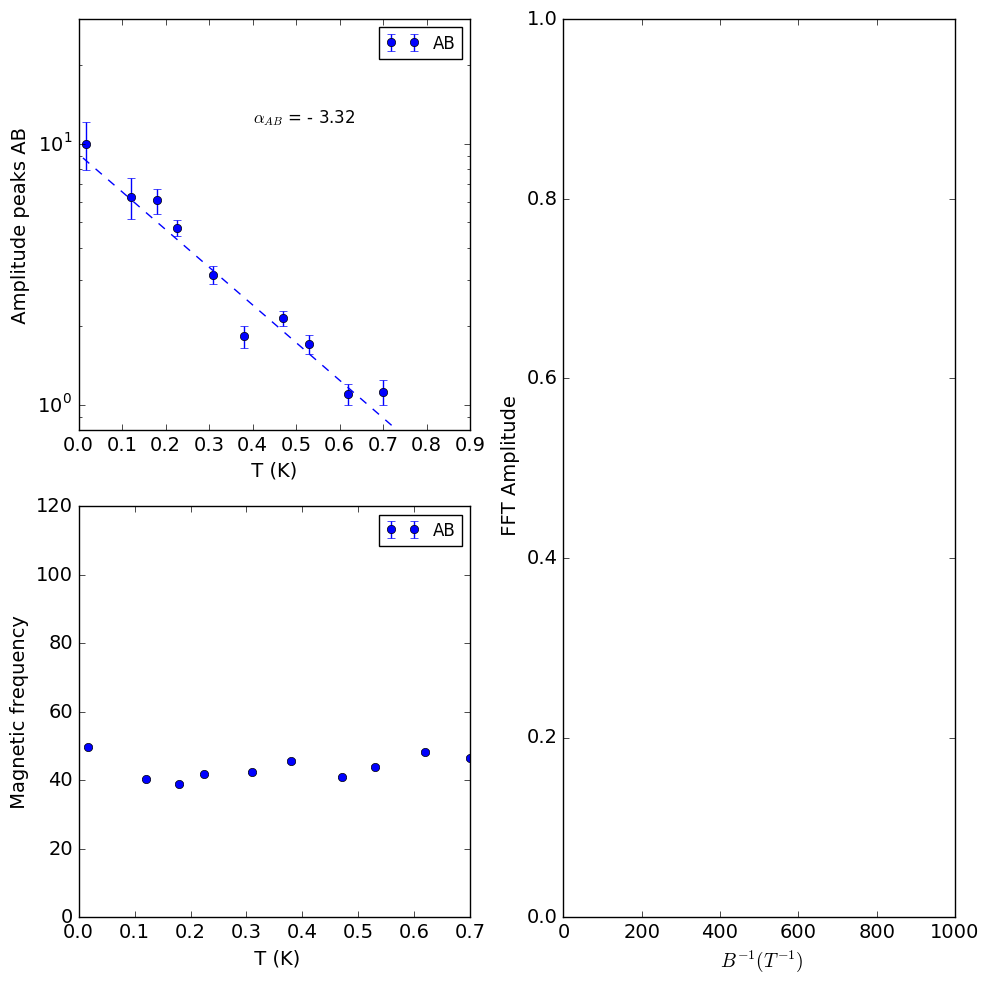

In [2405]:
fig = plt.figure(figsize=(10,10))
ax1 = plt.subplot2grid((2,2), (0,0), colspan=1)
ax2 = plt.subplot2grid((2,2), (1,0), colspan=1)
ax3 = plt.subplot2grid((2,2), (0,1), rowspan=2)        
    
ax1.set_xlabel( ' T (K) ', fontsize=axes_font)
ax1.set_ylabel(' Amplitude peaks AB ', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_ylim(0.8, 3e1)
ax1.set_xlim(0, 0.9)
ax1.text( 0.4 , 12, '$\\alpha_{AB}$ = - ' + str(np.round(alpha_AB,2)), fontsize = 12 )
#ax1.text( 0.4 , 10, '$\\alpha_{AAS}$ = - ' + str(np.round(alpha_AAS,2)), fontsize = 12 )
ax1.set_yscale('log')
        

                
ax2.set_xlabel( ' T (K)', fontsize=axes_font)
ax2.set_ylabel(' Magnetic frequency ', fontsize=axes_font)
ax2.tick_params(axis='both', which='major', labelsize=tick_font)
ax2.get_xaxis().get_major_formatter().set_useOffset(False)
ax2.set_ylim(0,120)

#ax2.set_ylim(0,500)
#ax2.set_xlim(0, 6)

ax3.set_xlabel( ' $ B ^{-1} ( T^{-1}) $', fontsize=axes_font)
ax3.set_ylabel(' FFT Amplitude', size=axes_font)
ax3.tick_params(axis='both', which='major', labelsize=tick_font)
ax3.get_xaxis().get_major_formatter().set_useOffset(False)
#ax3.set_ylim(0,3.3)
ax3.set_xlim(0, 1000)



ax1.errorbar(Ts, A1s, yerr = 2*np.array(A1errs), fmt = 'o', label = 'AB')
ax1.plot(T_fit, fit_AB, linestyle = '--', color = 'b')

#ax1.errorbar(T_AAS, A2s, yerr = np.array(A2errs), fmt = 'o', label = 'AAS')
#ax1.plot(T_fit, fit_AAS, linestyle = '--', color = 'green')



ax2.errorbar(Ts, x1s, yerr = 0.5*np.array(x1errs), fmt = 'o', label = 'AB')
#ax2.errorbar(T_AAS, x2s, yerr = 0.5*np.array(x2errs), fmt = 'o', label = 'AAS')
#ax2.axhline(y = np.mean(x1s) * 2, linestyle = '--', color = 'green', label = ' $ 2 \cdot f_{AB} $')  




ax1.legend(loc=0)
ax2.legend(loc=0)
ax3.legend(loc=5)

fig.subplots_adjust(hspace=sub_hspace-7)    
fig.subplots_adjust(wspace=sub_wspace)   
fig.tight_layout() 

fig.savefig('loop8442_0V.eps',format='eps',transparent = False)
fig.savefig('loop8442_0V.png', format='png',transparent = False)



# Temperature dependence 8442 gates -6 V


f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 41.603434482 0.538201188845
Amplitude: 9.30444601533 0.247453374387
B parameter: 0.275072217059 0.0166545664765
offset: 0.0753264918766


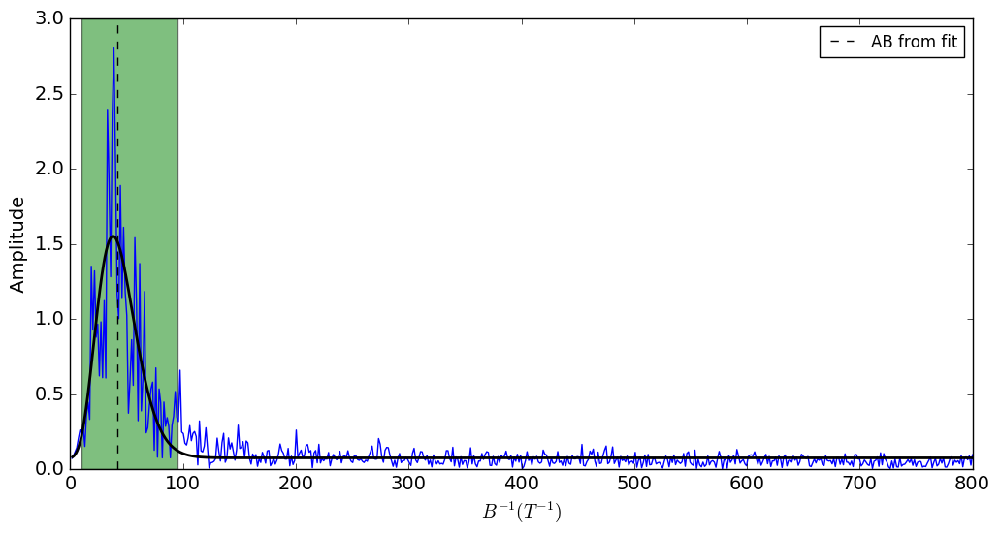

In [2400]:
T = '17 mk'

inputFile17mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_QPC_2.dat'
inputFiles17mk_8442 = [ inputFile17mk_1]
             

labels =  ['1']

window = 157
windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_17mk_-6V'

A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average17mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles17mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 44.7171533271 0.575844026857
Amplitude: 7.27904758173 0.196524806072
B parameter: 0.265680360686 0.0163616836439
offset: 0.0575568984192


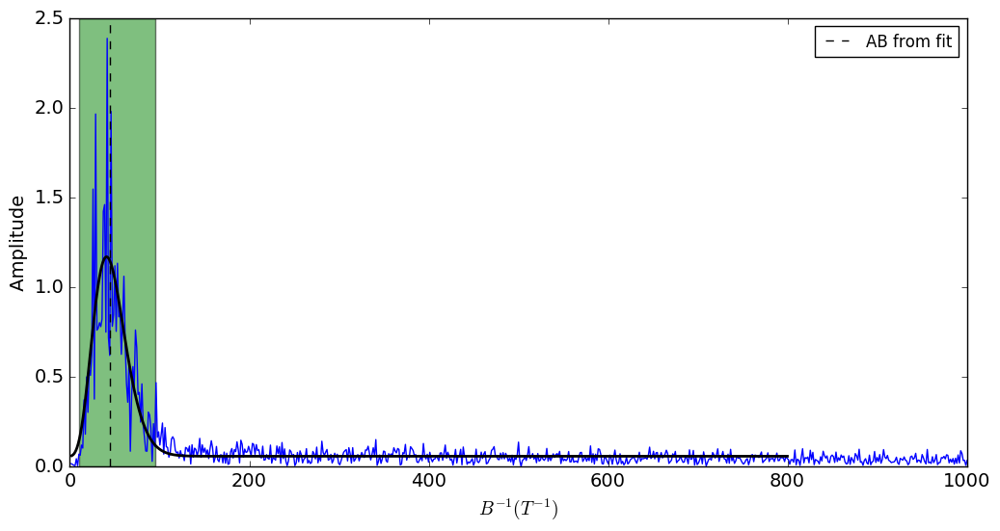

In [2350]:
T = '120 mk'

inputFile120mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_4.dat'
inputFiles120mk_8442 = [ inputFile120mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_120mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average120mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles120mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 42.3868513098 0.564868713405
Amplitude: 6.12126372936 0.179689867408
B parameter: 0.308808397088 0.0207125959876
offset: 0.0598682120224


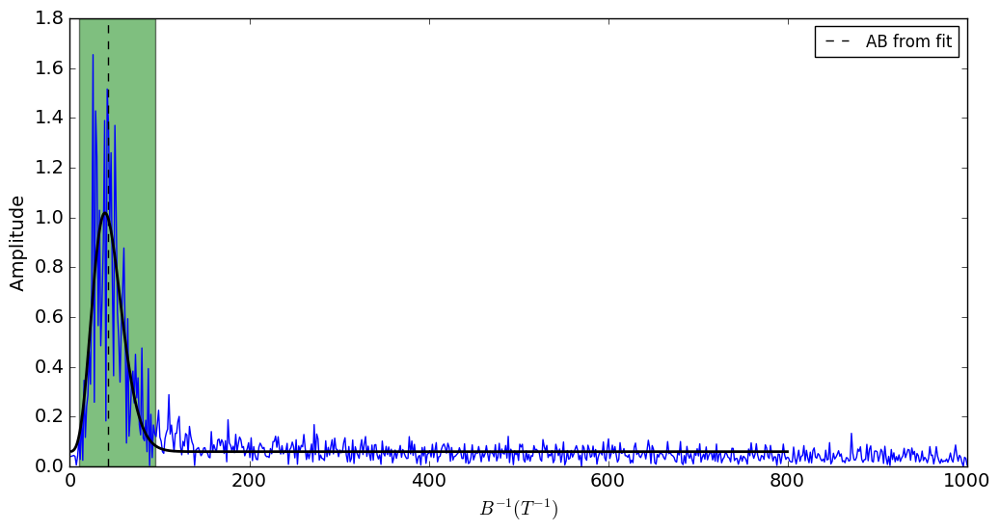

In [2351]:
T = '180 mk'

inputFile180mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_5.dat'
inputFiles180mk_8442 = [ inputFile180mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_180mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average180mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles180mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 41.3942182667 0.501438236785
Amplitude: 5.75634939234 0.153266738243
B parameter: 0.315024247818 0.0191555437215
offset: 0.0554259378811


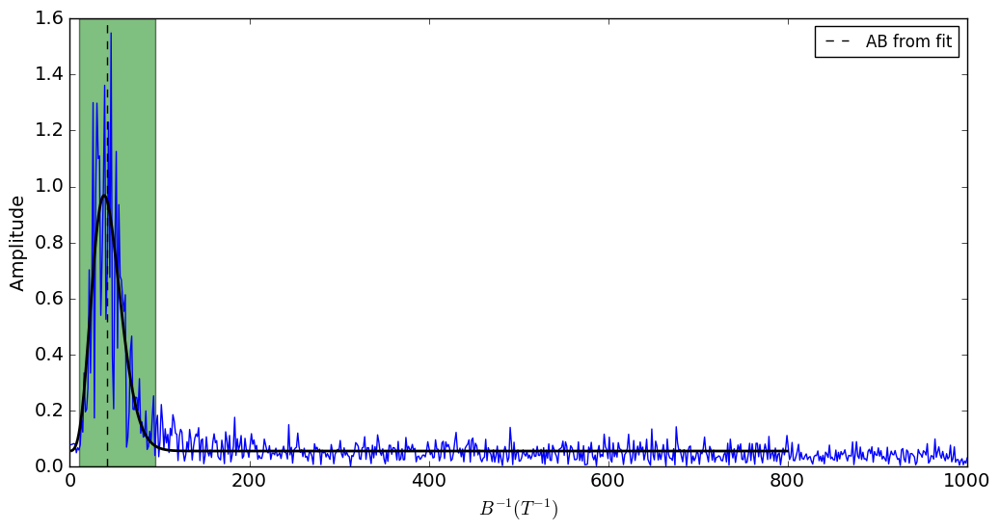

In [2352]:
T = '250 mk'

inputFile250mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_7.dat'
inputFiles250mk_8442 = [ inputFile250mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_250mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average250mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles250mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 42.0016561091 0.572966286297
Amplitude: 4.27659039995 0.130036381974
B parameter: 0.319010469935 0.0221705532625
offset: 0.0564391336745


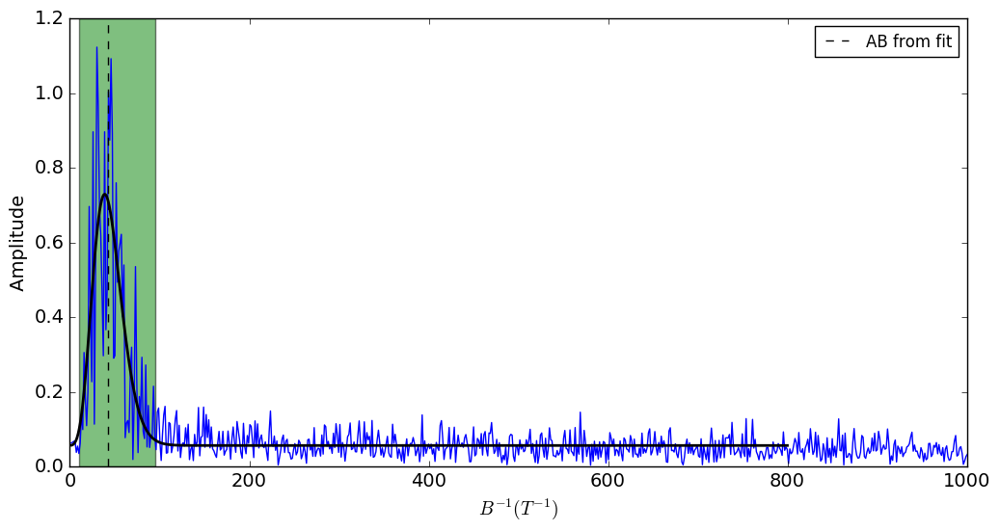

In [2353]:
T = '340 mk'

inputFile340mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_8.dat'
inputFiles340mk_8442 = [ inputFile340mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_340mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average340mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles340mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 42.4848363585 0.607209286278
Amplitude: 3.52700721257 0.113080693028
B parameter: 0.319303969899 0.0234083018917
offset: 0.0564105981377


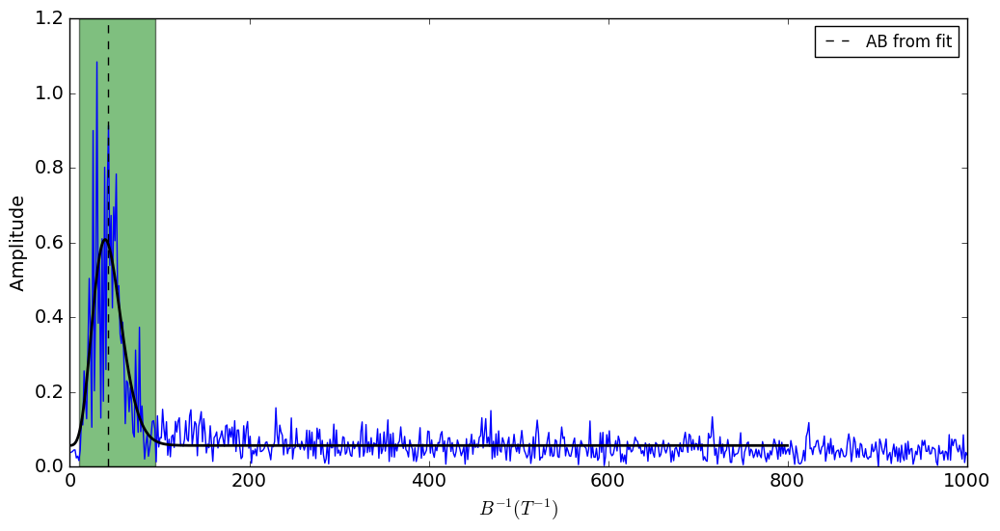

In [2354]:
T = '420 mk'

inputFile420mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_9.dat'
inputFiles420mk_8442 = [ inputFile420mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_420mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average420mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles420mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 41.7487451738 0.723316090258
Amplitude: 3.13704300662 0.12601032548
B parameter: 0.346707056037 0.0318777090873
offset: 0.0578737033482


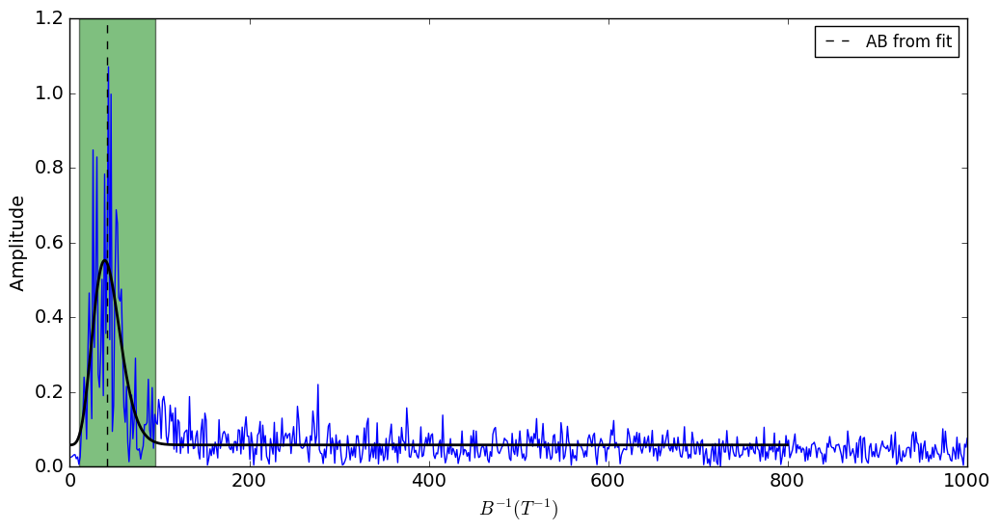

In [2360]:
T = '500 mk'

inputFile500mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_10.dat'
inputFiles500mk_8442 = [ inputFile500mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_500mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average500mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles500mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

f AB from design: 43.2994678278
f_AAS from design: 86.5989356555
limit from design for AB effect 10.1596516691 95.3072085148
FIT PARAMETERS FOR AB:
f: 42.5970137229 0.933479815111
Amplitude: 2.48845286806 0.108213071874
B parameter: 0.250798299285 0.024782765746
offset: 0.0603504825135


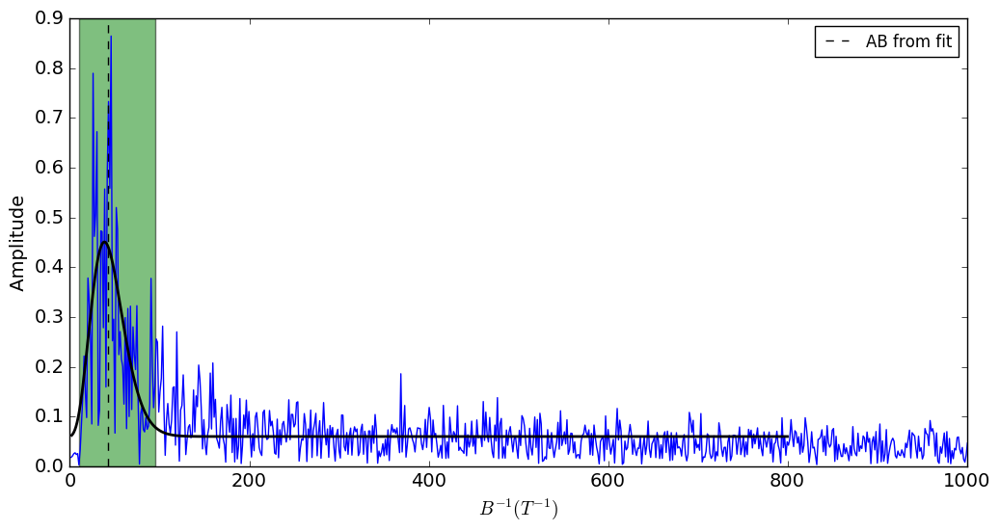

In [2358]:
T = '580 mk'

inputFile580mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_-6V_temperature_dependence_11.dat'
inputFiles580mk_8442 = [ inputFile580mk_1]           

labels =  ['1']

window = 157



windows = [window]
order = 2
orders = [order]
plot_name = 'loop1_8442_580mK_-6V'
A_min = 0.042
A_center = 0.179
A_max = 0.394

B_min = 0.1
B_max = 0.8


average580mk_8442_6V = magnetconductance_average_special_singlepeak(inputFiles580mk_8442, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

# Temperature dependence 8442 -6 V summary

In [2401]:
Ts = [0.017, 0.120, 0.180, 0.250, 0.340, 0.420, 0.500, 0.580]

freq_all_average_17mk, fft_all_average_17mk, x1_17mk, A1_17mk, B1_17mk, offset_17mk,  x1err_17mk, A1err_17mk, B1err_17mk, offseterr_17mk = average17mk_8442_6V
freq_all_average_120mk, fft_all_average_120mk, x1_120mk, A1_120mk, B1_120mk, offset_120mk,  x1err_120mk, A1err_120mk, B1err_120mk, offseterr_120mk = average120mk_8442_6V
freq_all_average_180mk, fft_all_average_180mk, x1_180mk, A1_180mk, B1_180mk, offset_180mk,  x1err_180mk, A1err_180mk, B1err_180mk, offseterr_180mk = average180mk_8442_6V
freq_all_average_250mk, fft_all_average_250mk, x1_250mk, A1_250mk, B1_250mk, offset_250mk,  x1err_250mk, A1err_250mk, B1err_250mk, offseterr_250mk = average250mk_8442_6V
freq_all_average_340mk, fft_all_average_340mk, x1_340mk, A1_340mk, B1_340mk, offset_340mk,  x1err_340mk, A1err_340mk, B1err_340mk, offseterr_340mk = average340mk_8442_6V
freq_all_average_420mk, fft_all_average_420mk, x1_420mk, A1_420mk, B1_420mk, offset_420mk,  x1err_420mk, A1err_420mk, B1err_420mk, offseterr_420mk = average420mk_8442_6V
freq_all_average_500mk, fft_all_average_500mk, x1_500mk, A1_500mk, B1_500mk, offset_500mk,  x1err_500mk, A1err_500mk, B1err_500mk, offseterr_500mk = average500mk_8442_6V
freq_all_average_580mk, fft_all_average_580mk, x1_580mk, A1_580mk, B1_580mk, offset_580mk,  x1err_580mk, A1err_580mk, B1err_580mk, offseterr_580mk = average580mk_8442_6V






freqs = [freq_all_average_17mk, freq_all_average_120mk, freq_all_average_180mk, freq_all_average_250mk, freq_all_average_340mk,
        freq_all_average_420mk, freq_all_average_500mk, freq_all_average_580mk]
ffts = [fft_all_average_17mk, fft_all_average_120mk, fft_all_average_180mk, fft_all_average_250mk, fft_all_average_340mk,
        fft_all_average_420mk, fft_all_average_500mk, fft_all_average_580mk]

x1s = [x1_17mk, x1_120mk, x1_180mk, x1_250mk, x1_340mk, x1_420mk, x1_500mk, x1_580mk]
A1s = [A1_17mk, A1_120mk, A1_180mk, A1_250mk, A1_340mk, A1_420mk, A1_500mk, A1_580mk]
B1s = [B1_17mk, B1_120mk, B1_180mk, B1_250mk, B1_340mk, B1_420mk, B1_500mk, B1_580mk]
offsets = [offset_17mk, offset_120mk, offset_180mk, offset_250mk, offset_340mk, offset_420mk, offset_500mk, offset_580mk]

x1errs = [x1err_17mk, x1err_120mk, x1err_180mk, x1err_250mk, x1err_340mk, x1err_420mk, x1err_500mk, x1err_580mk]
A1errs = [A1err_17mk, A1err_120mk, A1err_180mk, A1err_250mk, A1err_340mk, A1err_420mk, A1err_500mk, A1err_580mk]
B1errs = [B1err_17mk, B1err_120mk, B1err_180mk, B1err_250mk, B1err_340mk, B1err_420mk, B1err_500mk, B1err_580mk]
offseterrs = [offseterr_17mk, offseterr_120mk, offseterr_180mk, offseterr_250mk, offseterr_340mk, offseterr_420mk, offseterr_500mk, offseterr_580mk]



T_fit = np.linspace(0.01, 2, 1000) 


#decay fit
A =1
alpha = 1
A_AB, alpha_AB, A_err_AB, alpha_err_AB = fitting_decay(Ts, A1s, A1errs, A, alpha)
fit_AB = decay(T_fit, A_AB, alpha_AB)


#A_AAS, alpha_AAS, A_err_AAS, alpha_err_AAS = fitting_decay(Ts, A2s, A2errs, A, alpha)
#fit_AAS = decay(T_fit, A_AAS, alpha_AAS)

#power fit
#A =1
#B = 1
#A_AB_powerfit, B_AB_powerfit, A_AB_powerfit_err, B_AB_powerfit_err = fitting_power(Ts, A1s, A1errs, A, B)
#fit_AB_power = power(T_fit, A_AB_powerfit, B_AB_powerfit)


#defining fitted function to plot in the big one
fit_17mk = special_function(freq_all_average_17mk, x1_17mk, A1_17mk,  B1_17mk, offset_17mk)
fit_120mk = special_function(freq_all_average_120mk, x1_120mk, A1_120mk,  B1_120mk, offset_120mk)
fit_180mk = special_function(freq_all_average_180mk, x1_180mk, A1_180mk,  B1_180mk, offset_180mk)
fit_250mk = special_function(freq_all_average_250mk, x1_250mk, A1_250mk,  B1_250mk, offset_250mk)
fit_340mk = special_function(freq_all_average_340mk, x1_340mk, A1_340mk,  B1_340mk, offset_340mk)
fit_420mk = special_function(freq_all_average_420mk, x1_420mk, A1_420mk,  B1_420mk, offset_420mk)
fit_500mk = special_function(freq_all_average_500mk, x1_500mk, A1_500mk,  B1_500mk, offset_500mk)
fit_580mk = special_function(freq_all_average_580mk, x1_580mk, A1_580mk,  B1_580mk, offset_580mk)




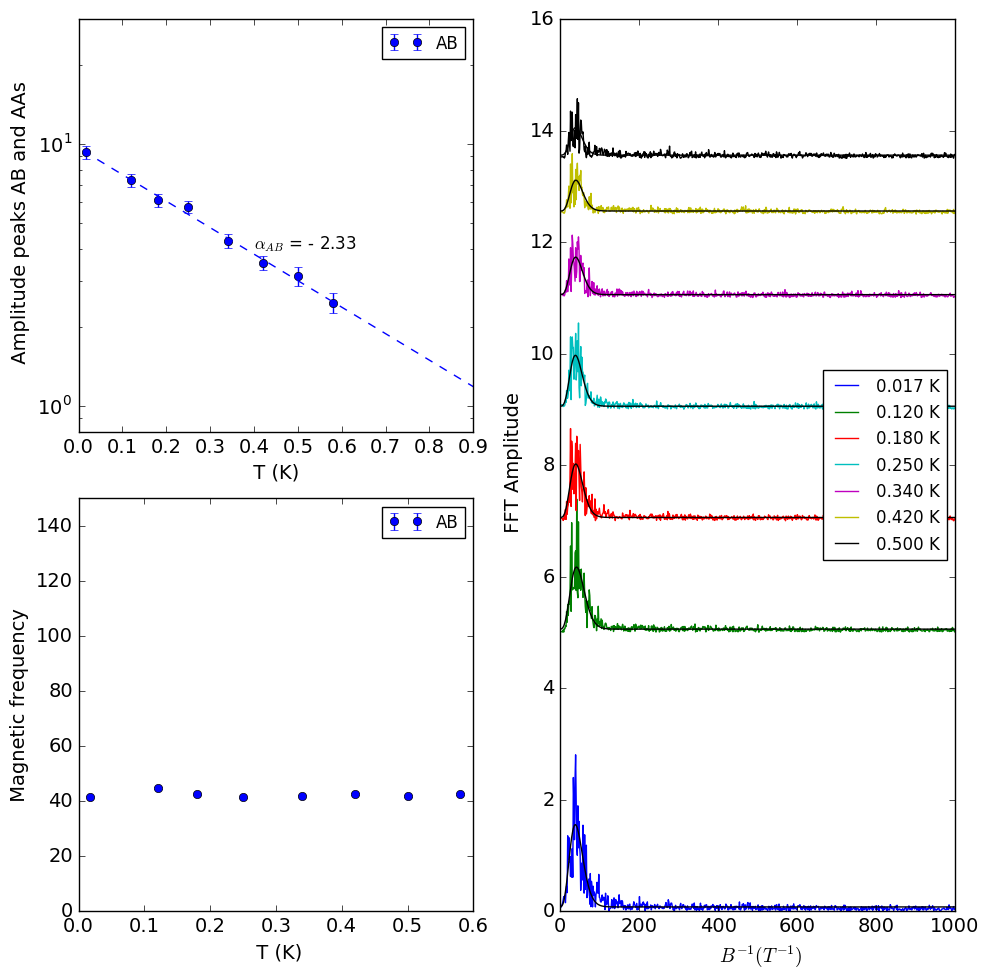

In [2402]:
fig = plt.figure(figsize=(10,10))
ax1 = plt.subplot2grid((2,2), (0,0), colspan=1)
ax2 = plt.subplot2grid((2,2), (1,0), colspan=1)
ax3 = plt.subplot2grid((2,2), (0,1), rowspan=2)        
    
ax1.set_xlabel( ' T (K) ', fontsize=axes_font)
ax1.set_ylabel(' Amplitude peaks AB and AAs', fontsize=axes_font)
ax1.tick_params(axis='both', which='major', labelsize=tick_font)
ax1.get_xaxis().get_major_formatter().set_useOffset(False)
ax1.set_ylim(0.8, 3e1)
ax1.set_xlim(0, 0.9)
ax1.text( 0.4 , 4, '$\\alpha_{AB}$ = - ' + str(np.round(alpha_AB,2)), fontsize = 12 )
ax1.set_yscale('log')
        

                
ax2.set_xlabel( ' T (K)', fontsize=axes_font)
ax2.set_ylabel(' Magnetic frequency ', fontsize=axes_font)
ax2.tick_params(axis='both', which='major', labelsize=tick_font)
ax2.get_xaxis().get_major_formatter().set_useOffset(False)
ax2.set_ylim(0,150)

#ax2.set_ylim(0,500)
#ax2.set_xlim(0, 6)

ax3.set_xlabel( ' $ B ^{-1} ( T^{-1}) $', fontsize=axes_font)
ax3.set_ylabel(' FFT Amplitude', size=axes_font)
ax3.tick_params(axis='both', which='major', labelsize=tick_font)
ax3.get_xaxis().get_major_formatter().set_useOffset(False)
#ax3.set_ylim(0,3.3)
ax3.set_xlim(0, 1000)



ax1.errorbar(Ts, A1s, yerr = 2*np.array(A1errs), fmt = 'o', label = 'AB')
ax1.plot(T_fit, fit_AB, linestyle = '--', color = 'b')
#ax1.plot(T_fit, fit_AAS, linestyle = '--', color = 'green')
#ax1.errorbar(Ts, A2s, yerr = 2*np.array(A2errs), fmt = 'o', label = 'AAS')

#ax1.plot(T_fit, fit_AB_power, linestyle = '--', color = 'r')

ax2.errorbar(Ts, x1s, yerr = np.array(x1errs)*0.5, fmt = 'o', label = 'AB')


ax3.plot(freq_all_average_17mk, fft_all_average_17mk, label =  '0.017 K')
ax3.plot(freq_all_average_17mk, fit_17mk, color = 'black')

ax3.plot(freq_all_average_120mk, fft_all_average_120mk + 5, label =  '0.120 K')
ax3.plot(freq_all_average_120mk, fit_120mk + 5, color = 'black')

ax3.plot(freq_all_average_180mk, fft_all_average_180mk + 7, label =  '0.180 K')
ax3.plot(freq_all_average_180mk, fit_180mk + 7, color = 'black')


ax3.plot(freq_all_average_250mk, fft_all_average_250mk + 9, label =  '0.250 K')
ax3.plot(freq_all_average_250mk, fit_250mk + 9, color = 'black')


ax3.plot(freq_all_average_340mk, fft_all_average_340mk + 11, label =  '0.340 K')
ax3.plot(freq_all_average_340mk, fit_340mk + 11, color = 'black')


ax3.plot(freq_all_average_420mk, fft_all_average_420mk + 12.5, label =  '0.420 K')
ax3.plot(freq_all_average_420mk, fit_420mk + 12.5, color = 'black')

ax3.plot(freq_all_average_500mk, fft_all_average_500mk + 13.5, label =  '0.500 K')
ax3.plot(freq_all_average_500mk, fit_500mk + 13.5, color = 'black')



ax1.legend(loc=0)
ax2.legend(loc=0)
ax3.legend(loc=5)

fig.subplots_adjust(hspace=sub_hspace-7)    
fig.subplots_adjust(wspace=sub_wspace)   
fig.tight_layout() 

fig.savefig('loop8442_-6V.eps',format='eps',transparent = False)
fig.savefig('loop8442_-6V.png',format='png',transparent = False)


# Loop 1781

# Comparison of AB for different gates

f AB from design: 44.5089501693
f_AAS from design: 89.0179003387
limit from design for AB effect 10.885341074 99.9032414127
FIT PARAMETERS FOR AB:
f: 50.6027799957 2.66068951557
Amplitude: 16.3378797141 4.75518664657
B parameter: 0.305338212304 0.0599378604192
FIT PARAMETERS FOR AAS:
f: 98.5050275738 26.6809549185
Amplitude: 6.60252286497 1.8695252957
B parameter: 0.132205210492 0.102848239204
offset: 0.132385448605 0.0119939547342
f AB from design: 44.5089501693
f_AAS from design: 89.0179003387
limit from design for AB effect 10.885341074 99.9032414127
FIT PARAMETERS FOR AB:
f: 46.4280766381 0.679195115435
Amplitude: 9.56222994268 0.709177393317
B parameter: 0.316770351173 0.0387654993997
FIT PARAMETERS FOR AAS:
f: 116.459025055 37.8955773926
Amplitude: 1.1577328115 0.27803805644
B parameter: 0.0564079463602 0.0502133602681
offset: 0.0670533602834 0.00786945169215


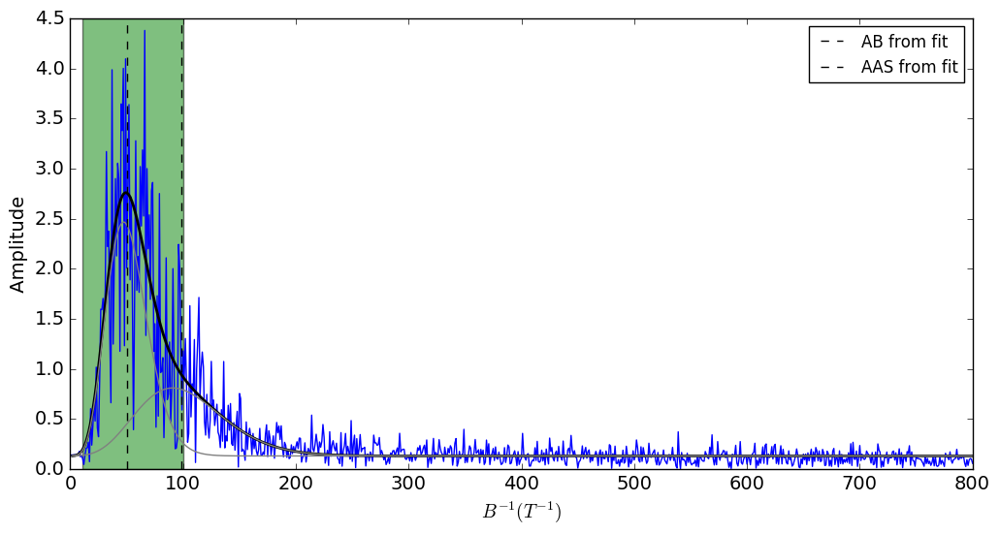

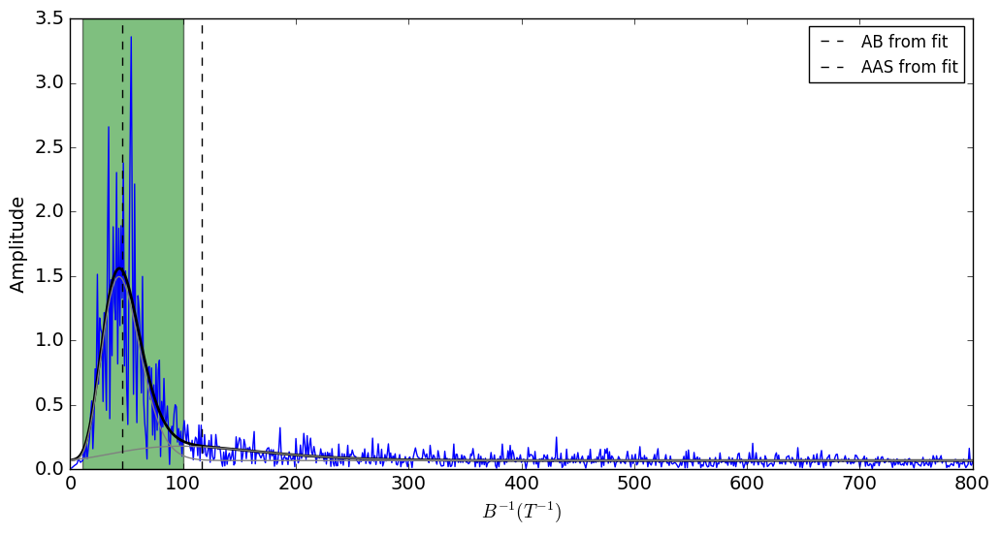

In [2316]:
inputFile_oscillations_0 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_Bx_sweep_2.dat'
inputFiles = [inputFile_oscillations_0]
labels =  ['0 V']
windows = [171]
#105
orders = [2]
plot_name = 'AB_0 V'
B_min = -0.5
B_max = 0.5
T = '17 mK'
A_min = 0.045
A_center = 0.184
A_max = 0.413
#magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True);
#plot_name = 'AB_8442_fft'
magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);


inputFile_oscillations_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8442\\loop1_QPC_2.dat'
inputFiles = [inputFile_oscillations_1]
labels =  ['-6 V']
windows = [143]
#105
orders = [2]
plot_name = 'AB_-6 V'
B_min = -0.5
B_max = +0.5
T = '17 mK'
A_min = 0.045
A_center = 0.184
A_max = 0.413
#magnetoconductance_range(inputFiles, windows, orders, labels,  plot_name, B_min, B_max, plot=True, fitting = True);
#plot_name = 'AB_8442_fft'
magnetconductance_average_special(inputFiles, windows, orders, labels, T, plot_name, A_min, A_center, A_max, B_min, B_max);

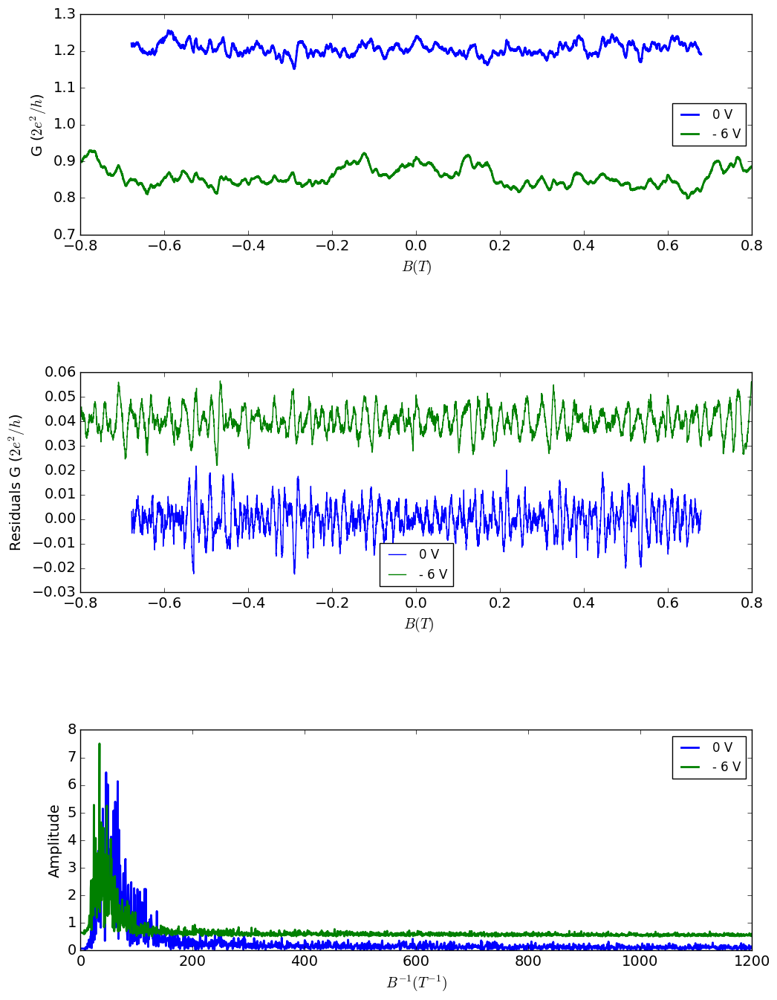

In [2319]:
inputFiles = [inputFile_oscillations_0,  inputFile_oscillations_1]
labels = ( '0 V', '- 6 V')
windows = (173, 173)
orders = (2, 2)
plot_name = '8442_comparison'

magnetoconductance(inputFiles, windows, orders, labels, plot_name, plot= True, fitting = False);

# Test functions

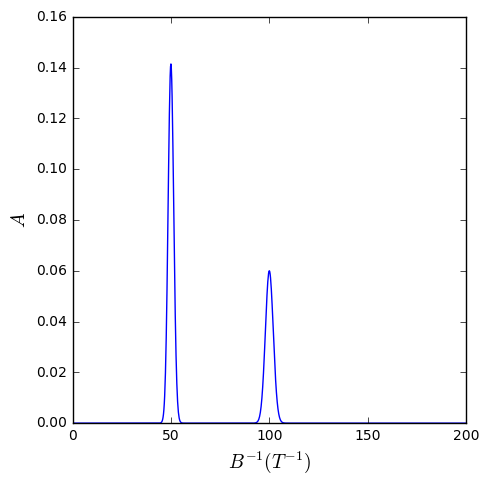

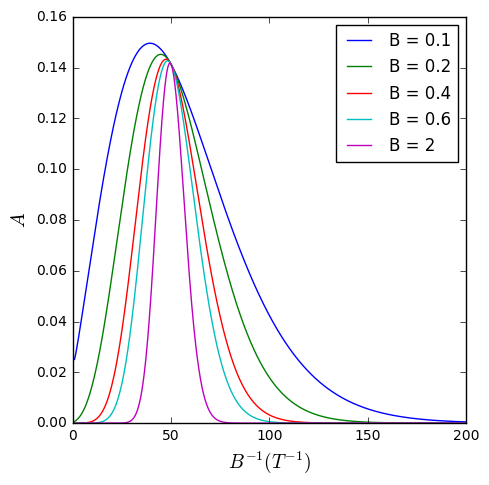

In [1140]:
def f(x, x_0, sigma):
    y = np.exp(-((np.sqrt(x)-np.sqrt(x_0))**2)/(2*sigma**2))*x**(-0.5)
    return y

def step(x, x1, x2):
    return 1 * (x > x1) * (x < x2)


def g(x, x1, x2):
    y = step(x, x1, x2) *x**(-0.5)
    return y

#when use this function, use length in meter.
def fit_function(x, x_0, A,  B):    
    y = A*np.exp(-B*(np.sqrt(x)-np.sqrt(x_0))**2)*x**(-0.5)
    return y

x =np.linspace(1, 200 ,1000)
x_0 = 50
sigma = 0.1
A = 1
B = 0.2
y1 = f(x, x_0, sigma) +0.6*f(x, 2*x_0, sigma)

y2 = fit_function(x, x_0, A, B/2.)
y3 = fit_function(x, x_0, A, B)
y4 = fit_function(x, x_0, A, B*2)
y5 = fit_function(x, x_0, A, B*3)
y6 = fit_function(x, x_0, A, B*10)
#y3 = fit_function(x, x_0, A, B) +  fit_function(x, 2*x_0, A/2., B) 


fig = plt.figure(figsize=(5,5))
plt.plot(x,y1)
plt.xlabel('$ B^{-1} (T^{-1}) $', fontsize=axes_font)
plt.ylabel('$ A $', fontsize=axes_font)
#plt.plot(x,y2)
#plt.plot(x,y3)
fig.tight_layout() 

fig.savefig('example_fit_gauss.eps',format='eps',transparent = False)
fig.savefig('example_fit_gauss.png',format='png',transparent = False)

fig_1 = plt.figure(figsize=(5,5))

plt.xlabel('$ B^{-1} (T^{-1}) $', fontsize=axes_font)
plt.ylabel('$ A $', fontsize=axes_font)
plt.plot(x,y2, label = 'B = 0.1')
plt.plot(x,y3, label = 'B = 0.2')
plt.plot(x,y4, label = 'B = 0.4')
plt.plot(x,y5, label = 'B = 0.6')
plt.plot(x,y6, label = 'B = 2')
plt.legend(loc=0)
fig_1.tight_layout() 

fig_1.savefig('example_fit_special.eps',format='eps',transparent = False)
fig_1.savefig('example_fit_special.png',format='png',transparent = False)





In [ ]:


T = '80 mk'
inputFile90mk_1 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_1.dat'
inputFile90mk_2 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_2.dat'
inputFile90mk_3 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_3.dat'
inputFile90mk_4 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_4.dat'
inputFile90mk_5 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_5.dat'
inputFile90mk_6 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_6.dat'
inputFile90mk_7 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_7.dat'
inputFile90mk_8 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_8.dat'
inputFile90mk_9 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_9.dat'
inputFile90mk_10 = 'D:\\data\\Francesco\\loops\\top_gated_loops\\loops8382\\loop2_temperature_dependence_90mk_10.dat'

inputFiles90mk = [inputFile90mk_3]

labels =  ['1']
window = 169
#169
windows = [window]
order = 2
orders = [order]
plot_name = 'Temperature_dependence_loop2_80mk_1'
B_min = 0.2
B_max = 0.5
magnetoconductance_range_special(inputFiles90mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);
magnetoconductance_range(inputFiles90mk, windows, orders, labels,  plot_name, B_min, B_max, plot=True);



# Convolution of A(f) with G(f)

(0, 100)

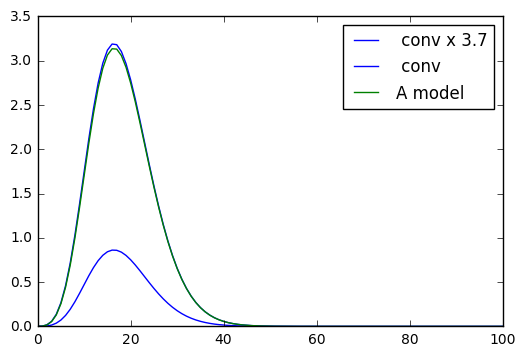

In [1926]:
def G(f, T):
    y = np.sin(3.1415*f*T)/(3.1415*f)
    return y

f = np.linspace(0.0001, 2000, 500)
x1 = 71
A1 = 26
B1 = 0.2
offset = 0
T = 0.3

G1 = G(f, T)
A = special_function(f, x1, A1,  B1, offset)

#conv = np.convolve(A, G1, mode='full')

conv = signal.fftconvolve(G1, A, mode='full')

plt.plot(np.abs(conv)*3.7, color = 'b', label= ' conv x 3.7')
plt.plot(np.abs(conv), color = 'b', label= ' conv')
plt.plot(A, color = 'g', label = 'A model')
plt.legend(loc = 0)
plt.xlim(0,100)